### Environment Setup

In [1]:
import pandas as pd
import datetime
import yfinance as yf
import backtrader as bt
import numpy as np
import warnings

warnings.filterwarnings("ignore")

### Parameters Setup

In [2]:
# Date range
start = '2013-01-01'
end = '2024-09-30'

benchmark_symbol = 'SPY'

# Tickers of assets
stocks_1 = ['JCI', 'TGT', 'CMCSA', 'CPB', 'MO', 'APA', 'MMC', 'JPM',
          'ZION', 'PSA', 'BAX', 'BMY', 'LUV', 'PCAR', 'TXT', 'TMO',
          'DE', 'MSFT', 'HPQ', 'SEE', 'VZ', 'CNP', 'NI', 'T', 'BA']
industry_1 =  ['Consumer Discretionary','Consumer Discretionary',
                              'Consumer Discretionary', 'Consumer Staples',
                              'Consumer Staples','Energy','Financials',
                              'Financials','Financials','Financials',
                              'Health Care','Health Care','Industrials','Industrials',
                              'Industrials','Health Care','Industrials',
                              'Information Technology','Information Technology',
                              'Materials','Telecommunications Services','Utilities',
                              'Utilities','Telecommunications Services','Financials']
stocks_2 = [
            'AMAT', 'AMD','AVGO',  
            'BAC','BKR','BMY','BSX',
            'C','CMCSA',
            'CSCO','CSX','CVS','CVX',
            'DIS','DVN',
            'FCX','FNF','GEN','GILD',
            'GM','HAL','HPQ','INTC',
            'IPG','JNJ','KDP',
            'KKR','KMI','KO',
            'MDLZ','MO','MRK','MRO',
            'MRVL','MSFT','MU','NEM',
]

industry_2 = [
        'Technology','Technology','Technology',
        'Financial Services','Energy','Healthcare','Healthcare',
        'Financial Services','Communication Services',
        'Technology','Industrials','Healthcare','Energy',
        'Communication Services','Energy',
        'Basic Materials','Financial Services','Technology','Healthcare',
        'Consumer Cyclical','Energy','Technology','Technology',
        'Communication Services','Healthcare','Consumer Defensive',
        'Financial Services','Energy','Consumer Defensive',
        'Consumer Defensive','Consumer Defensive','Healthcare','Energy',
        'Technology','Technology','Technology','Basic Materials',
]

ETF_BOND = ['HYG','LQD','TLT',
           ]
industry_BOND = ['Bond','Bond','Bond',
                ]

ETF_COMM = [
    'DBA','GLD','SLV','XLE','XME','XOP',
]

industry_COMM=[
    'Commodity','Commodity','Commodity','Commodity','Commodity','Commodity',
]

ETF_list = ['HYG','LQD','TLT',
           'DBA',
           'GLD','SLV','XLE','XME','XOP','XBI','EFA',
            'EWW','EWZ','VNQ','XHB',
            'IWM','QQQ']
industry_etf =  ['Bond','Bond','Bond',
               'Commodity',
               'Commodity','Commodity','Commodity','Commodity','Commodity',
               'Healthcare',
               'International','International','International',
               'Real Estate','Real Estate',
               'US Major','US Major',
               ]

assets = stocks_2 + ETF_BOND + ETF_COMM + [benchmark_symbol]

asset_classes_dict = {'Assets': stocks_2 + ETF_BOND + ETF_COMM, 
                 'Industry': industry_2+industry_BOND+industry_COMM}


assets.sort()

### Download Data
Full data download from yfinance to **prices** dataframe

In [3]:
# Downloading data
prices = yf.download(assets, start=start, end=end)
prices = prices.dropna()

[*********************100%***********************]  47 of 47 completed


In [4]:
display(prices)

Price                       Adj Close                                     \
Ticker                           AMAT         AMD        AVGO        BAC   
Date                                                                       
2013-01-02 00:00:00+00:00    9.993252    2.530000    2.395675   9.721241   
2013-01-03 00:00:00+00:00    9.967932    2.490000    2.408192   9.664675   
2013-01-04 00:00:00+00:00    9.967932    2.590000    2.392731   9.785888   
2013-01-07 00:00:00+00:00    9.849769    2.670000    2.379478   9.769727   
2013-01-08 00:00:00+00:00    9.714723    2.670000    2.363282   9.680834   
...                               ...         ...         ...        ...   
2024-09-23 00:00:00+00:00  194.039993  156.750000  172.940002  39.869999   
2024-09-24 00:00:00+00:00  196.779999  158.320007  174.839996  39.450001   
2024-09-25 00:00:00+00:00  197.309998  162.020004  175.520004  39.250000   
2024-09-26 00:00:00+00:00  209.610001  167.490005  178.089996  39.520000   
2024-09-27 00:00:00+00:00  204.919998  164.350006  172.690002  39.400002   

Price                                                                  \
Ticker                           BKR        BMY        BSX          C   
Date                                                                    
2013-01-02 00:00:00+00:00  22.552677  22.751945   5.890000  31.802671   
2013-01-03 00:00:00+00:00  22.777506  23.120602   5.950000  31.910606   
2013-01-04 00:00:00+00:00  23.302118  23.197111   5.920000  32.712418   
2013-01-07 00:00:00+00:00  23.023758  23.231894   5.980000  32.743248   
2013-01-08 00:00:00+00:00  22.675802  23.294493   6.120000  32.735538   
...                              ...        ...        ...        ...   
2024-09-23 00:00:00+00:00  36.450001  49.456383  84.000000  62.580002   
2024-09-24 00:00:00+00:00  36.340000  50.376087  83.510002  61.369999   
2024-09-25 00:00:00+00:00  36.049999  49.397049  83.500000  60.380001   
2024-09-26 00:00:00+00:00  34.770000  49.565163  83.080002  61.709999   
2024-09-27 00:00:00+00:00  36.180000  50.346420  83.349998  61.869999   

Price                                            ...    Volume            \
Ticker                         CMCSA       CSCO  ...      MRVL      MSFT   
Date                                             ...                       
2013-01-02 00:00:00+00:00  15.049654  14.095157  ...  18853200  52899300   
2013-01-03 00:00:00+00:00  14.881656  14.171391  ...  14383500  48294400   
2013-01-04 00:00:00+00:00  14.873837  14.192177  ...  17510700  52521100   
2013-01-07 00:00:00+00:00  14.807421  14.060510  ...  11854900  37110400   
2013-01-08 00:00:00+00:00  14.908998  14.074372  ...  14706300  44703100   
...                              ...        ...  ...       ...       ...   
2024-09-23 00:00:00+00:00  40.427212  51.794170  ...  14430600  15128900   
2024-09-24 00:00:00+00:00  41.042599  52.121670  ...   7702100  17015800   
2024-09-25 00:00:00+00:00  40.288250  52.250683  ...   9341100  13396400   
2024-09-26 00:00:00+00:00  40.715054  52.449162  ...  11715300  14492000   
2024-09-27 00:00:00+00:00  41.330444  52.617874  ...  12366900  14896100   

Price                                                                         \
Ticker                            MU      NEM       SLV        SPY       TLT   
Date                                                                           
2013-01-02 00:00:00+00:00   29556500  7254500  15631200  192059000   7472700   
2013-01-03 00:00:00+00:00   39091500  6017100  20462300  144761800  10004300   
2013-01-04 00:00:00+00:00   18802700  5834100  18624800  116817700   9574600   
2013-01-07 00:00:00+00:00   31133300  4853400   7443300  110002500   4193100   
2013-01-08 00:00:00+00:00   30791800  6373500   9075100  121265100   4380900   
...                              ...      ...       ...        ...       ...   
2024-09-23 00:00:00+00:00   23394100  8437400  24206300   44116900  35703900   
2024-09-24 00:00:00+00:00   23043200  9532600  

In [5]:
#  all test is from the 1004th day and finish at the last testdata day.
#
start_test = 1004
end_test = prices.shape[0] - 1
test_size = 1000
print(f" Testing data from {start_test} to {end_test}")

 Testing data from 1004 to 2954


### Building the Backtest Function with Backtrader

In [6]:
############################################################
# Defining the backtest function 
############################################################

def backtest(datas, strategy, start, end, plot=False, **kwargs):
    cerebro = bt.Cerebro()

    # print(datas)
    print(f"start={start} - end={end}")
    # Here we add transaction costs and other broker costs
    cerebro.broker.setcash(1000000.0)
    cerebro.broker.setcommission(commission=0.005) # Commission 0.5%
    cerebro.broker.set_slippage_perc(0.005, # Slippage 0.5%
                                     slip_open=True,
                                     slip_limit=True,
                                     slip_match=True,
                                     slip_out=False)
    for data in datas:
        cerebro.adddata(data)

    # Here we add the indicators that we are going to store
    cerebro.addanalyzer(bt.analyzers.TimeReturn, timeframe=bt.TimeFrame.Days)
    cerebro.addanalyzer(bt.analyzers.SharpeRatio, riskfreerate=0.0)
    cerebro.addanalyzer(bt.analyzers.Returns)
    cerebro.addanalyzer(bt.analyzers.DrawDown)
    cerebro.addstrategy(strategy, **kwargs)
    cerebro.addobserver(bt.observers.Value)
    cerebro.addobserver(bt.observers.DrawDown)
    results = cerebro.run(stdstats=False)
    if plot:
        print(f"backtest.plot: {start}-{end}")
        cerebro.plot(iplot=False, start=start, end=end)
    return results[0]


### Building Data Feeds for Backtesting
**asset_prices** = list of all asset except 'SPY' in the bt.feeds of *OHLC + Volume*    
**benchmark**  = 'SPY' *OHLC+Volume* in bt.feeds

In [7]:
############################################################
# Create objects that contain the prices of assets
############################################################

# Creating Assets bt.feeds
assets_prices = []
for i in assets:
    if i != benchmark_symbol:
        prices_ = prices.drop(columns='Adj Close').loc[:, (slice(None), i)].dropna()
        prices_.columns = ['Close', 'High', 'Low', 'Open', 'Volume']
        print(f"{i}: \n", prices_)
        assets_prices.append(bt.feeds.PandasData(dataname=prices_, plot=False))
        
print(assets_prices)

# Creating Benchmark bt.feeds        
prices_ = prices.drop(columns='Adj Close').loc[:, (slice(None), benchmark_symbol)].dropna()
prices_.columns = ['Close', 'High', 'Low', 'Open', 'Volume']
display(benchmark_symbol)
display(prices_)
benchmark = bt.feeds.PandasData(dataname=prices_, plot=False)

display(prices_.head())

AMAT: 
                                 Close        High         Low        Open  \
Date                                                                        
2013-01-02 00:00:00+00:00   11.840000   11.840000   11.610000   11.640000   
2013-01-03 00:00:00+00:00   11.810000   11.900000   11.700000   11.840000   
2013-01-04 00:00:00+00:00   11.810000   11.870000   11.710000   11.820000   
2013-01-07 00:00:00+00:00   11.670000   11.710000   11.390000   11.470000   
2013-01-08 00:00:00+00:00   11.510000   11.650000   11.480000   11.580000   
...                               ...         ...         ...         ...   
2024-09-23 00:00:00+00:00  194.039993  195.639999  192.690002  194.419998   
2024-09-24 00:00:00+00:00  196.779999  197.850006  193.759995  196.509995   
2024-09-25 00:00:00+00:00  197.309998  200.289993  195.289993  195.289993   
2024-09-26 00:00:00+00:00  209.610001  212.149994  202.500000  210.820007   
2024-09-27 00:00:00+00:00  204.919998  211.330002  204.000000  211.0

'SPY'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02 00:00:00+00:00,146.059998,146.149994,144.729996,145.110001,192059000
2013-01-03 00:00:00+00:00,145.729996,146.369995,145.339996,145.990005,144761800
2013-01-04 00:00:00+00:00,146.369995,146.610001,145.669998,145.970001,116817700
2013-01-07 00:00:00+00:00,145.970001,146.110001,145.429993,145.850006,110002500
2013-01-08 00:00:00+00:00,145.550003,145.910004,144.979996,145.710007,121265100
...,...,...,...,...,...
2024-09-23 00:00:00+00:00,569.669983,570.330017,568.099976,569.340027,44116900
2024-09-24 00:00:00+00:00,571.299988,571.359985,567.599976,570.479980,46805700
2024-09-25 00:00:00+00:00,570.039978,571.890015,568.909973,571.140015,38428600


,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02 00:00:00+00:00,146.059998,146.149994,144.729996,145.110001,192059000
2013-01-03 00:00:00+00:00,145.729996,146.369995,145.339996,145.990005,144761800
2013-01-04 00:00:00+00:00,146.369995,146.610001,145.669998,145.970001,116817700
2013-01-07 00:00:00+00:00,145.970001,146.110001,145.429993,145.850006,110002500
2013-01-08 00:00:00+00:00,145.550003,145.910004,144.979996,145.710007,121265100


In [8]:
(slice(None), benchmark_symbol)

(slice(None, None, None), 'SPY')

In [9]:
tt = prices.drop(columns='Adj Close').loc[:, (slice(None), benchmark_symbol)].dropna()
display(tt.columns)
display(prices_)

MultiIndex([( 'Close', 'SPY'),
            (  'High', 'SPY'),
            (   'Low', 'SPY'),
            (  'Open', 'SPY'),
            ('Volume', 'SPY')],
           names=['Price', 'Ticker'])

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02 00:00:00+00:00,146.059998,146.149994,144.729996,145.110001,192059000
2013-01-03 00:00:00+00:00,145.729996,146.369995,145.339996,145.990005,144761800
2013-01-04 00:00:00+00:00,146.369995,146.610001,145.669998,145.970001,116817700
2013-01-07 00:00:00+00:00,145.970001,146.110001,145.429993,145.850006,110002500
2013-01-08 00:00:00+00:00,145.550003,145.910004,144.979996,145.710007,121265100
...,...,...,...,...,...
2024-09-23 00:00:00+00:00,569.669983,570.330017,568.099976,569.340027,44116900
2024-09-24 00:00:00+00:00,571.299988,571.359985,567.599976,570.479980,46805700
2024-09-25 00:00:00+00:00,570.039978,571.890015,568.909973,571.140015,38428600


### Buy and Hold for the BenchMark 

In [10]:
############################################################
# Building the Buy and Hold strategy
############################################################

class BuyAndHold(bt.Strategy):

    def __init__(self):
        self.counter = 0

    def next(self):
        if self.counter >= start_test:
            if self.getposition(self.data).size == 0:
                self.order_target_percent(self.data, target=0.99)
        self.counter += 1 

In [11]:
print(start_test, end_test,benchmark )

1004 2954 <backtrader.feeds.pandafeed.PandasData object at 0x7f417c1fa190>


start=1004 - end=2954
backtest.plot: 1004-2954


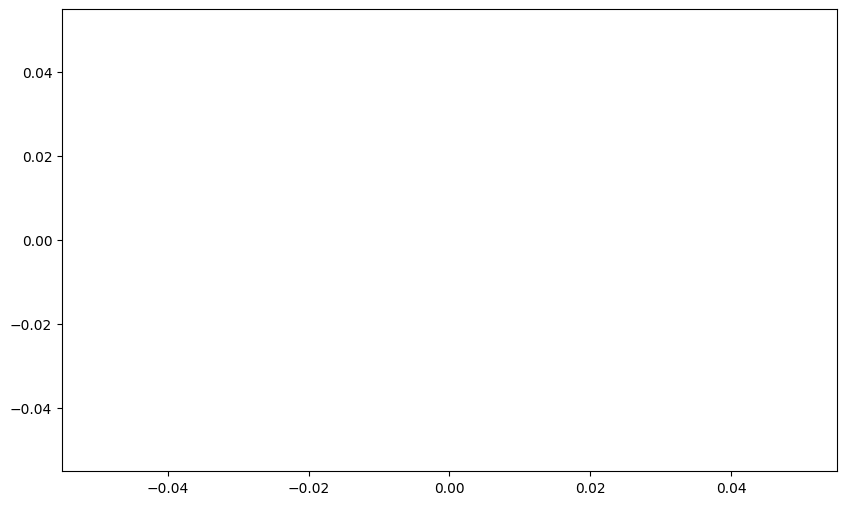

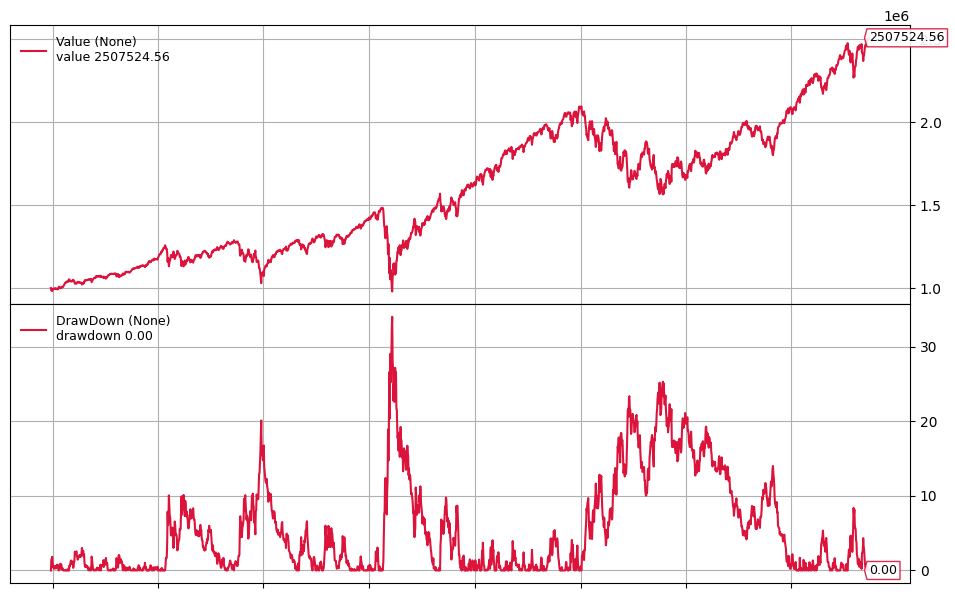

In [12]:
############################################################
# Run the backtest for the bench mark
############################################################
%matplotlib inline

import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (10, 6) # (w, h)
plt.plot() # We need to do this to avoid errors in inline plot

# dd, cagr, sharpe = backtest([benchmark],
benchmark0 = backtest([benchmark],
                            BuyAndHold,
                            start=start_test,
                            end=end_test,
                            plot=True)

In [13]:
def RetreiveStats(bt_result, rm, obj, r_int):
    dd = bt_result.analyzers.drawdown.get_analysis()['max']['drawdown']
    cagr= bt_result.analyzers.returns.get_analysis()['rnorm100']
    sharpe =bt_result.analyzers.sharperatio.get_analysis()['sharperatio']

    return {'Risk_measure':rm, 'Objective':obj, 'R_Interval': r_int, 'Max DrawDown':dd/100.0, 'CAGR': cagr/100.0, 'Sharpe Ratio':sharpe}

In [14]:
metric_list = []

metric_list.append(RetreiveStats(benchmark0, benchmark_symbol, 'N/A', 'N/A'))
display(metric_list)

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343}]

In [15]:
#
# Retreive Daily Return from bt
#
def RetreiveDailyReturn(bt_result, s_name):
    tret_analyzer = bt_result.analyzers.getbyname('timereturn')
    ret_ = tret_analyzer.get_analysis()
    return pd.DataFrame(ret_.items(), columns=['Date', s_name])


In [16]:
BM_ret = RetreiveDailyReturn(benchmark0, benchmark_symbol)
print(BM_ret)
BM_ret.to_csv(f"{benchmark_symbol}_ret.csv", index=False)

           Date       SPY
0    2013-01-02  0.000000
1    2013-01-03  0.000000
2    2013-01-04  0.000000
3    2013-01-07  0.000000
4    2013-01-08  0.000000
...         ...       ...
2950 2024-09-23  0.002495
2951 2024-09-24  0.002857
2952 2024-09-25 -0.002202
2953 2024-09-26  0.003959
2954 2024-09-27 -0.001448

[2955 rows x 2 columns]


### Rebalancing Monthly, Quarterly, Semiannually using Riskfolio-Lib

In [17]:
############################################################
# Calculate assets returns
############################################################

pd.options.display.float_format = '{:.4%}'.format

data = prices.loc[:, ('Adj Close', slice(None))]
data.columns = assets
data = data.drop(columns=[benchmark_symbol]).dropna()
returns = data.pct_change().dropna()
display(returns.index[0], returns.index[-1])

Timestamp('2013-01-03 00:00:00+0000', tz='UTC')

Timestamp('2024-09-27 00:00:00+0000', tz='UTC')

In [18]:
############################################################
# Selecting Dates for Rebalancing
############################################################

def SelectIndex(price_in, mode="Q"):
    # Selecting last day of month of available data
    index_Month = price_in.groupby([price_in.index.year, price_in.index.month]).tail(1).index
    # print("Monthly: ", index_Month)
    index_daily = price_in.index
    # print("Daily: ", index_daily)

    # Quarterly Dates
    index_Quater = [x for x in index_Month if float(x.month) % 3.0 == 0 ] 
    # print("Quarterly: ", index_Quater)

    # Semi-Annually Dates
    index_Semi = [x for x in index_Month if float(x.month) % 6.0 == 0 ] 
    # print("Semi-Annually: ", index_Semi)

    match mode:
        case "Q": index=index_Quater
        case "M": index = index_Month
        case "D": index = index_daily
        case "S": index = index_Semi
    # Dates where the strategy will be backtested
    index_ = [index_daily.get_loc(x) for x in index if index_daily.get_loc(x) >= start_test]
    return index_

In [19]:
rebalance_index = {}

In [20]:
rebalance_index["M"] = SelectIndex(returns, mode="M")
rebalance_index["Q"] = SelectIndex(returns, mode="Q")
rebalance_index["S"] = SelectIndex(returns, mode="S")

In [21]:
ret = returns.reset_index()
display(ret.iloc[rebalance_index["M"]])

,Date,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,2016-12-30 00:00:00+00:00,-1.1941%,-2.1570%,-1.7234%,0.4545%,0.3862%,-0.7810%,-0.3226%,0.0842%,-1.0957%,...,-1.4798%,-1.7009%,-1.2083%,-1.5716%,-3.4023%,-1.3708%,0.1513%,-0.2913%,-3.0293%,-0.5999%
1026,2017-01-31 00:00:00+00:00,-0.2621%,-2.2620%,-1.8305%,-1.3508%,2.0382%,0.9653%,0.8805%,-1.3778%,0.1062%,...,1.3309%,-0.2683%,-0.7370%,-0.2895%,3.7460%,2.4646%,0.6959%,0.0411%,0.3607%,-0.1992%
1045,2017-02-28 00:00:00+00:00,-0.5764%,-4.8684%,-1.1019%,0.4477%,0.0498%,0.2652%,-1.0480%,-0.3499%,-0.2931%,...,0.9464%,-2.6217%,-0.3892%,-1.3468%,0.7948%,0.5790%,0.3710%,-0.3072%,-0.0926%,-0.8121%
1068,2017-03-31 00:00:00+00:00,0.0257%,3.5587%,-0.4908%,-1.1730%,0.8599%,-1.7702%,1.7178%,-1.1403%,0.2133%,...,-0.3154%,-1.8650%,0.2283%,-0.2416%,0.0911%,0.5831%,0.2907%,-0.3422%,0.7618%,1.3535%
1087,2017-04-28 00:00:00+00:00,-1.7421%,-2.3495%,-1.0220%,-1.3108%,-0.4694%,0.6826%,0.7639%,-0.4546%,-1.0103%,...,-0.0672%,-0.4639%,0.2783%,0.1448%,2.7347%,-0.4276%,0.2212%,0.0737%,-0.3678%,-0.8511%
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2871,2024-05-31 00:00:00+00:00,-0.6742%,0.0900%,-2.6047%,3.5206%,3.0788%,2.0870%,0.7600%,0.6136%,2.9843%,...,2.6586%,-10.4619%,0.1109%,-1.0215%,0.1194%,-2.3223%,0.6790%,2.4851%,0.8137%,2.0271%
2890,2024-06-28 00:00:00+00:00,1.4880%,1.7182%,1.1893%,1.3248%,2.1790%,0.0482%,0.0130%,3.1032%,2.2989%,...,0.3149%,1.7023%,-1.3029%,-0.5294%,0.0717%,0.4537%,-1.8606%,0.3855%,1.6621%,0.1790%
2912,2024-07-31 00:00:00+00:00,7.8581%,4.3629%,11.9565%,-2.3498%,1.2552%,-3.0377%,-0.2026%,-1.5030%,1.1272%,...,1.4834%,6.6561%,-1.0806%,7.0788%,3.5014%,2.1680%,1.0229%,0.4202%,2.6524%,0.8196%
2934,2024-08-30 00:00:00+00:00,2.2178%,2.1101%,3.7533%,1.4439%,-0.2552%,0.4626%,1.3884%,1.2282%,0.2788%,...,-0.6932%,9.1638%,0.9731%,0.7011%,0.3949%,-1.7158%,-1.0663%,0.3739%,0.0334%,-0.2217%


In [22]:
display(ret.iloc[rebalance_index["Q"]])

,Date,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,2016-12-30 00:00:00+00:00,-1.1941%,-2.1570%,-1.7234%,0.4545%,0.3862%,-0.7810%,-0.3226%,0.0842%,-1.0957%,...,-1.4798%,-1.7009%,-1.2083%,-1.5716%,-3.4023%,-1.3708%,0.1513%,-0.2913%,-3.0293%,-0.5999%
1068,2017-03-31 00:00:00+00:00,0.0257%,3.5587%,-0.4908%,-1.1730%,0.8599%,-1.7702%,1.7178%,-1.1403%,0.2133%,...,-0.3154%,-1.8650%,0.2283%,-0.2416%,0.0911%,0.5831%,0.2907%,-0.3422%,0.7618%,1.3535%
1131,2017-06-30 00:00:00+00:00,-0.3137%,-0.9524%,-0.4230%,-0.2467%,1.8498%,-0.1792%,-0.3595%,-0.1493%,0.5373%,...,1.1955%,-1.4907%,0.6424%,-5.1160%,0.4964%,-0.1271%,-0.2312%,0.4487%,-0.0334%,0.6940%
1194,2017-09-29 00:00:00+00:00,2.9040%,0.0785%,-0.1646%,-0.4322%,-1.1072%,1.1586%,1.4962%,0.1239%,1.7451%,...,0.2217%,-0.3896%,0.8393%,3.6091%,-0.2924%,-1.1307%,0.2249%,-0.0146%,0.3117%,-0.3216%
1257,2017-12-29 00:00:00+00:00,-1.1601%,-2.5592%,-1.3517%,-0.9396%,0.7643%,-0.7933%,-1.5879%,-0.8924%,-0.5957%,...,-0.8202%,-1.9187%,-0.2100%,-1.6503%,0.0267%,0.6927%,0.1579%,-0.2898%,-0.0824%,-1.1695%
1318,2018-03-29 00:00:00+00:00,2.8672%,2.4465%,-0.4352%,2.0415%,-1.0688%,1.0868%,2.3988%,-1.1134%,2.6743%,...,5.2872%,2.3392%,2.1032%,1.2624%,1.7713%,0.3255%,0.4863%,2.1055%,2.9643%,2.8021%
1382,2018-06-29 00:00:00+00:00,1.9872%,-2.0901%,-0.9228%,-1.6742%,0.2428%,0.0723%,0.6154%,0.0598%,0.5517%,...,0.7729%,-1.5158%,-0.0203%,-1.3173%,1.9189%,0.5309%,-0.3439%,0.6228%,0.5956%,0.3496%
1445,2018-09-28 00:00:00+00:00,0.7823%,-5.2163%,0.1136%,-1.6032%,0.0000%,0.2098%,0.4173%,-1.6586%,0.5395%,...,2.4197%,3.1534%,-0.0350%,0.5334%,0.7339%,2.3863%,-0.2637%,-0.2765%,0.1760%,0.2083%
1508,2018-12-31 00:00:00+00:00,1.1118%,3.5915%,0.2721%,1.0250%,0.2799%,2.0416%,1.9325%,0.4437%,-0.3220%,...,1.8466%,3.4505%,1.1754%,0.5068%,0.5222%,0.6935%,0.3800%,0.5259%,0.0000%,0.6068%
1569,2019-03-29 00:00:00+00:00,2.9862%,1.8356%,0.5484%,0.9513%,2.0619%,-0.2717%,1.2131%,0.3872%,-1.0886%,...,-0.6540%,2.4202%,0.8638%,5.0585%,0.5622%,0.7818%,-0.0948%,-0.1510%,0.4060%,-0.1948%


In [23]:
display(ret.iloc[rebalance_index["S"]])

,Date,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,2016-12-30 00:00:00+00:00,-1.1941%,-2.1570%,-1.7234%,0.4545%,0.3862%,-0.7810%,-0.3226%,0.0842%,-1.0957%,...,-1.4798%,-1.7009%,-1.2083%,-1.5716%,-3.4023%,-1.3708%,0.1513%,-0.2913%,-3.0293%,-0.5999%
1131,2017-06-30 00:00:00+00:00,-0.3137%,-0.9524%,-0.4230%,-0.2467%,1.8498%,-0.1792%,-0.3595%,-0.1493%,0.5373%,...,1.1955%,-1.4907%,0.6424%,-5.1160%,0.4964%,-0.1271%,-0.2312%,0.4487%,-0.0334%,0.6940%
1257,2017-12-29 00:00:00+00:00,-1.1601%,-2.5592%,-1.3517%,-0.9396%,0.7643%,-0.7933%,-1.5879%,-0.8924%,-0.5957%,...,-0.8202%,-1.9187%,-0.2100%,-1.6503%,0.0267%,0.6927%,0.1579%,-0.2898%,-0.0824%,-1.1695%
1382,2018-06-29 00:00:00+00:00,1.9872%,-2.0901%,-0.9228%,-1.6742%,0.2428%,0.0723%,0.6154%,0.0598%,0.5517%,...,0.7729%,-1.5158%,-0.0203%,-1.3173%,1.9189%,0.5309%,-0.3439%,0.6228%,0.5956%,0.3496%
1508,2018-12-31 00:00:00+00:00,1.1118%,3.5915%,0.2721%,1.0250%,0.2799%,2.0416%,1.9325%,0.4437%,-0.3220%,...,1.8466%,3.4505%,1.1754%,0.5068%,0.5222%,0.6935%,0.3800%,0.5259%,0.0000%,0.6068%
1632,2019-06-28 00:00:00+00:00,0.4923%,-1.2036%,0.7525%,2.8004%,-0.2430%,0.5543%,2.5042%,2.7586%,0.6667%,...,0.0704%,-0.0837%,-0.1417%,1.3659%,1.0242%,0.3501%,-0.0677%,1.1591%,1.7569%,1.7931%
1760,2019-12-31 00:00:00+00:00,0.1805%,0.7469%,0.8167%,0.1992%,0.0000%,0.7218%,0.5112%,0.4779%,-0.4648%,...,1.1923%,0.5680%,0.0698%,1.0712%,-0.6857%,-0.3584%,-0.9794%,0.5695%,0.4458%,1.4555%
1885,2020-06-30 00:00:00+00:00,2.3535%,4.6341%,1.8820%,1.5391%,3.6364%,1.7301%,1.3276%,1.6107%,0.6975%,...,2.6846%,4.4696%,2.5549%,4.8220%,3.6950%,2.1622%,-0.4856%,2.2973%,1.5333%,2.7570%
2013,2020-12-31 00:00:00+00:00,-0.7818%,-0.6285%,0.6945%,1.1007%,-1.6973%,0.9767%,1.1252%,1.3145%,2.3238%,...,-1.9118%,0.0842%,0.3338%,4.5328%,-0.8280%,-0.7674%,0.1461%,-0.8373%,0.1197%,-1.3823%
2137,2021-06-30 00:00:00+00:00,0.3382%,4.9263%,-0.0650%,0.8315%,0.8378%,0.8299%,-1.0872%,1.5356%,0.8490%,...,2.1756%,-0.7318%,-0.1842%,2.4720%,1.2784%,1.3813%,0.4453%,1.2404%,1.7486%,1.8969%


In [24]:
###########################################################
# Building Constraints
############################################################



asset_classes = pd.DataFrame(asset_classes_dict)
asset_classes = asset_classes.sort_values(by=['Assets'])
# print(asset_classes)
print(asset_classes['Industry'].unique())

constraints = {'Disabled': [False, False, True],
               'Type': ['All Assets', 'All Classes', 'All Classes'],
               'Set': ['', 'Industry', 'Industry'],
               'Position': ['', '', ''],
               'Sign': ['<=', '<=', '>='],
               'Weight': [0.10, 0.20, 0.03],
               'Type Relative': ['', '', ''],
               'Relative Set': ['', '', ''],
               'Relative': ['', '', ''],
               'Factor': ['', '', '']}

constraints = pd.DataFrame(constraints)

display(constraints)

['Technology' 'Financial Services' 'Energy' 'Healthcare'
 'Communication Services' 'Industrials' 'Commodity' 'Basic Materials'
 'Consumer Cyclical' 'Bond' 'Consumer Defensive']


,Disabled,Type,Set,Position,Sign,Weight,Type Relative,Relative Set,Relative,Factor
0,False,All Assets,,,<=,10.0000%,,,,
1,False,All Classes,Industry,,<=,20.0000%,,,,
2,True,All Classes,Industry,,>=,3.0000%,,,,


In [25]:
############################################################
# Building constraint matrixes for Riskfolio Lib
############################################################

import riskfolio as rp

A, B = rp.assets_constraints(constraints, asset_classes)

In [26]:
Y = returns.iloc[start_test-test_size:start_test,:]
print(Y.index[0], Y.index[-1])
print(Y.columns)

2013-01-09 00:00:00+00:00 2016-12-27 00:00:00+00:00
Index(['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO',
       'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD',
       'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR',
       'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU',
       'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP'],
      dtype='object')


* The optimization is based on the returns of previous 1000 days from last date of each quarter, which is about 4 years

In [27]:
plotFlag = True

# Risk measure
rms = ['MV', 'MAD', 'MSV', 'FLPM', 'SLPM',
       'CVaR', 'WR', 'MDD', 'ADD', 'CDaR']

# rms = ['MV', 'CVaR', 'WR']

# Objective Functions 
objectivves = ['Sharpe', 'MinRisk', 'MaxRet']
# objectivves = ['Sharpe', 'MaxRet']

# rebalance interval: Monthly, Quarterly, Semiannually
reb_interval = ["M","Q","S"]
# reb_interval = ["Q","S"]

In [28]:
%%time
############################################################
# Building a loop that estimate optimal portfolios on
# rebalancing dates
############################################################

models = {}

for obj in objectivves:
    models[obj] = {}
    for r in reb_interval:
        models[obj][r] = {}
        for rm in rms:
            
            weights = pd.DataFrame([])
        
            for i in rebalance_index[r]:
                Y = returns.iloc[i-test_size:i,:] # taking last 4 years (250 trading days per year)
        #         print("from ", Y.index[0], " to ", Y.index[-1])
        #         print(Y)
                # Building the portfolio object
                port = rp.Portfolio(returns=Y)
                
                # Add portfolio constraints
                port.ainequality = A
                port.binequality = B
                
                # Calculating optimum portfolio
        
                # Select method and estimate input parameters:
        
                method_mu='hist' # Method to estimate expected returns based on historical data.
                method_cov='hist' # Method to estimate covariance matrix based on historical data.
        
                port.assets_stats(method_mu=method_mu, method_cov=method_cov)
                
                # Estimate optimal portfolio:
                
        #         port.solvers = ['MOSEK']
                port.alpha = 0.05
                model='Classic' # Could be Classic (historical), BL (Black Litterman) or FM (Factor Model)
                # rm = j # Risk measure used, this time will be variance
                # obj = 'Sharpe' # Objective function, could be MinRisk, MaxRet, Utility or Sharpe
                hist = True # Use historical scenarios for risk measures that depend on scenarios
                rf = 0 # Risk free rate
                l = 0 # Risk aversion factor, only useful when obj is 'Utility'
        
        #         print(f"Optm(model={model}, rm={rm}, obj={obj}, solvers={port.solvers})")
                w = port.optimization(model=model, rm=rm, obj=obj, rf=rf, l=l, hist=hist)
        
                if w is None:
                    w = weights.tail(1).T
                # display(w)
                weights = pd.concat([weights, w.T], axis = 0)
            
            models[obj][r][rm] = weights.copy()
            models[obj][r][rm].index = rebalance_index[r]

CPU times: user 20min 57s, sys: 59min 45s, total: 1h 20min 43s
Wall time: 9min 54s


In [29]:
for obj in objectivves:
    for r in reb_interval:
        for rm in rms:
            wght = models[obj][r][rm]
            display(f'obj={obj}, int={r}, rm={rm}')
            display(wght.index)
            display(wght.head(5))

'obj=Sharpe, int=M, rm=MV'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.6124%,3.6730%,10.0000%,0.0000%,0.0000%,1.1842%,10.0000%,0.0000%,3.7581%,0.0000%,...,0.0000%,0.0000%,4.7368%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1026,0.0000%,3.5097%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,7.2822%,0.0000%,...,0.0000%,0.0000%,6.1181%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,4.8521%,10.0000%,1.2023%,0.0000%,0.0000%,10.0000%,0.0000%,3.1142%,0.0000%,...,0.0000%,0.0000%,5.1478%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,1.2057%,4.6682%,10.0000%,1.0434%,0.0000%,0.0000%,10.0000%,0.0000%,3.9061%,0.0000%,...,0.0000%,0.0000%,4.1262%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1087,3.4941%,2.7622%,10.0000%,0.2770%,0.0000%,0.0000%,10.0000%,0.0000%,6.9196%,0.0000%,...,0.0000%,0.0000%,2.5161%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=M, rm=MAD'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.6904%,2.2538%,10.0000%,2.3764%,0.0000%,1.1228%,10.0000%,0.0000%,4.0150%,0.0000%,...,0.0000%,0.0000%,6.5819%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1026,0.0000%,2.3869%,10.0000%,2.6263%,0.0000%,0.0000%,10.0000%,0.0000%,5.9660%,0.0000%,...,0.0000%,0.0000%,7.3661%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,4.5975%,10.0000%,2.9170%,0.0000%,1.2104%,8.2198%,0.0000%,2.3365%,0.0000%,...,0.0000%,0.0000%,5.4025%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.2351%,4.0243%,10.0000%,3.2210%,0.0000%,0.0000%,10.0000%,0.0000%,2.5374%,0.0000%,...,0.0000%,0.0000%,5.7406%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1087,3.0667%,2.0741%,10.0000%,2.3439%,0.0000%,0.0000%,10.0000%,0.0000%,2.8705%,0.0000%,...,0.0000%,0.0000%,4.8592%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=M, rm=MSV'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,3.6042%,10.0000%,1.2441%,0.0000%,1.7234%,10.0000%,0.0000%,5.5357%,0.0000%,...,0.0000%,0.0000%,6.3958%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1026,0.0000%,3.1518%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,7.5174%,0.0000%,...,0.0000%,0.0000%,6.8482%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,5.3153%,10.0000%,2.2623%,0.0000%,0.0000%,10.0000%,0.0000%,3.7991%,0.0000%,...,0.0000%,0.0000%,4.6847%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,5.2435%,10.0000%,2.5147%,0.0000%,0.0000%,10.0000%,0.0000%,5.0957%,0.0000%,...,0.0000%,0.0000%,4.7565%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1087,2.7219%,2.4628%,10.0000%,1.1836%,0.0000%,0.0000%,10.0000%,0.0000%,6.5121%,0.0000%,...,0.0000%,0.0000%,3.8303%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=M, rm=FLPM'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,2.8327%,10.0000%,2.1523%,0.0000%,1.0729%,10.0000%,0.0000%,3.0786%,0.0000%,...,0.0000%,0.0000%,6.6489%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1026,0.0000%,2.2661%,10.0000%,2.7431%,0.0000%,0.0000%,10.0000%,0.0000%,4.1485%,0.0000%,...,0.0000%,0.0000%,7.3892%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,4.2408%,10.0000%,3.5042%,0.0000%,0.3695%,9.2561%,0.0000%,2.8265%,0.0000%,...,0.0000%,0.0000%,5.7592%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,4.0871%,10.0000%,2.8383%,0.0000%,0.0000%,10.0000%,0.0000%,3.3156%,0.0000%,...,0.0000%,0.0000%,5.9129%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1087,2.9321%,1.7379%,10.0000%,2.4370%,0.0000%,0.0000%,10.0000%,0.0000%,5.1026%,0.0000%,...,0.0000%,0.0000%,5.0344%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=M, rm=SLPM'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,3.7271%,10.0000%,0.9615%,0.0000%,1.8422%,10.0000%,0.0000%,5.8000%,0.0000%,...,0.0000%,0.0000%,6.2729%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1026,0.0000%,3.1926%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,7.9254%,0.0000%,...,0.0000%,0.0000%,6.8074%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,5.4009%,10.0000%,1.8631%,0.0000%,0.0000%,10.0000%,0.0000%,3.8309%,0.0000%,...,0.0000%,0.0000%,4.5991%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,5.3587%,10.0000%,2.1764%,0.0000%,0.0000%,10.0000%,0.0000%,5.1376%,0.0000%,...,0.0000%,0.0000%,4.6413%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1087,2.8087%,2.4848%,10.0000%,0.8015%,0.0000%,0.0000%,10.0000%,0.0000%,6.9190%,0.0000%,...,0.0000%,0.0000%,3.7295%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=M, rm=CVaR'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,4.7791%,10.0000%,0.0000%,0.1906%,1.7663%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,3.3734%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1026,0.0000%,4.2059%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,5.3144%,0.4797%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,6.7242%,10.0000%,0.0000%,0.0000%,0.4494%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,3.2758%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,6.2332%,10.0000%,0.9017%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,3.7668%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1087,2.5474%,2.4102%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=M, rm=WR'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,8.6935%,10.0000%,5.8831%,0.0000%,0.0000%,10.0000%,0.0000%,0.0002%,0.0000%,...,0.0000%,0.0000%,0.0000%,1.3065%,0.0000%,0.0000%,3.3172%,0.0000%,0.0000%,0.0000%
1026,0.0000%,0.6709%,10.0000%,8.0558%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,9.3291%,0.0000%,0.0000%,8.8188%,0.0000%,0.0000%,0.0000%
1045,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,2.8474%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,4.1024%,0.0000%,0.0000%,0.0000%
1068,0.4014%,8.5324%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,2.1863%,0.0000%,...,0.0000%,1.0661%,0.0000%,0.0000%,0.0000%,0.0000%,3.2396%,0.0000%,0.0000%,0.0000%
1087,0.0000%,8.1687%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,4.7425%,0.0000%,...,0.0000%,0.0000%,0.0000%,1.8313%,0.0000%,0.0000%,3.0987%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=M, rm=MDD'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,3.2805%,10.0000%,3.9338%,0.0000%,0.0000%,10.0000%,0.0000%,9.4354%,0.0000%,...,0.0000%,0.0000%,0.4892%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1026,0.3493%,3.3415%,10.0000%,3.2792%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,3.7627%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,3.8481%,10.0000%,4.8829%,0.0000%,0.0000%,10.0000%,0.0000%,9.1454%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.3059%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.8857%,3.2571%,10.0000%,4.6331%,0.0000%,0.0000%,10.0000%,0.0000%,9.3140%,0.0000%,...,0.0000%,0.0000%,0.4197%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1087,0.8330%,3.2487%,10.0000%,4.7351%,0.0000%,0.0000%,10.0000%,0.0000%,9.2707%,0.0000%,...,0.0000%,0.0000%,0.1161%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=M, rm=ADD'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.2701%,10.0000%,2.6987%,0.0000%,0.0000%,10.0000%,0.0000%,9.7569%,0.0000%,...,0.0000%,0.0000%,9.7299%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1026,0.0000%,0.0000%,10.0000%,2.5741%,0.0000%,0.0000%,10.0000%,0.0000%,9.5450%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,0.9507%,10.0000%,4.5671%,0.0000%,0.0000%,10.0000%,0.0000%,8.9431%,0.0000%,...,0.0000%,0.0000%,9.0493%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,0.7827%,10.0000%,5.7195%,0.0000%,0.0000%,10.0000%,0.0000%,8.4268%,0.0000%,...,0.0000%,0.0000%,9.2173%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1087,0.0000%,0.6078%,10.0000%,4.1599%,0.0000%,0.0000%,10.0000%,0.0000%,9.8825%,0.0000%,...,0.0000%,0.0000%,9.3922%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=M, rm=CDaR'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0000%,10.0000%,0.2497%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1026,0.0000%,0.0000%,10.0000%,0.3564%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,0.0000%,10.0000%,2.2256%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,0.0000%,10.0000%,2.6357%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1087,0.0000%,0.0000%,10.0000%,3.1964%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=Q, rm=MV'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.6124%,3.6730%,10.0000%,0.0000%,0.0000%,1.1842%,10.0000%,0.0000%,3.7581%,0.0000%,...,0.0000%,0.0000%,4.7368%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,1.2057%,4.6682%,10.0000%,1.0434%,0.0000%,0.0000%,10.0000%,0.0000%,3.9061%,0.0000%,...,0.0000%,0.0000%,4.1262%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.8537%,2.0352%,10.0000%,2.6351%,0.0000%,0.0000%,8.3727%,0.0000%,2.6051%,0.0000%,...,0.0000%,0.0000%,0.8861%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1194,2.7222%,2.4897%,10.0000%,3.4592%,0.0000%,0.0000%,4.4058%,0.0000%,0.5006%,0.0000%,...,0.0000%,0.0000%,4.6398%,0.0000%,0.1370%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,3.0016%,1.2936%,10.0000%,5.5425%,0.0000%,0.0000%,0.0808%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,5.7047%,0.0000%,1.5473%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=Q, rm=MAD'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.6904%,2.2538%,10.0000%,2.3764%,0.0000%,1.1228%,10.0000%,0.0000%,4.0150%,0.0000%,...,0.0000%,0.0000%,6.5819%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.2351%,4.0243%,10.0000%,3.2210%,0.0000%,0.0000%,10.0000%,0.0000%,2.5374%,0.0000%,...,0.0000%,0.0000%,5.7406%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.5762%,1.3831%,10.0000%,5.1394%,0.0000%,0.0000%,7.8882%,0.0000%,0.0740%,0.0000%,...,0.0000%,0.0000%,3.5228%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1194,1.6773%,1.4358%,10.0000%,6.4136%,0.0000%,0.0000%,3.0281%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,6.8869%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,1.7004%,0.7946%,10.0000%,7.3807%,0.0000%,0.0000%,0.3946%,0.0000%,0.3347%,0.0000%,...,0.0000%,0.0000%,7.5050%,0.0000%,0.6357%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=Q, rm=MSV'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,3.6042%,10.0000%,1.2441%,0.0000%,1.7234%,10.0000%,0.0000%,5.5357%,0.0000%,...,0.0000%,0.0000%,6.3958%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,5.2435%,10.0000%,2.5147%,0.0000%,0.0000%,10.0000%,0.0000%,5.0957%,0.0000%,...,0.0000%,0.0000%,4.7565%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,1.0725%,10.0000%,3.9688%,0.0000%,0.0000%,9.9670%,0.0000%,0.8105%,0.0000%,...,0.0000%,0.0000%,0.6361%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1194,0.5666%,1.7120%,10.0000%,5.3028%,0.0000%,0.0000%,5.0893%,0.0000%,0.0294%,0.0000%,...,0.0000%,0.0000%,4.8340%,0.0000%,0.0897%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,2.0817%,0.4680%,10.0000%,6.5830%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,7.4503%,0.0000%,1.4271%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=Q, rm=FLPM'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,2.8327%,10.0000%,2.1523%,0.0000%,1.0729%,10.0000%,0.0000%,3.0786%,0.0000%,...,0.0000%,0.0000%,6.6489%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,4.0871%,10.0000%,2.8383%,0.0000%,0.0000%,10.0000%,0.0000%,3.3156%,0.0000%,...,0.0000%,0.0000%,5.9129%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.2580%,1.3005%,10.0000%,5.5703%,0.0000%,0.0000%,8.2390%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,2.9307%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1194,1.7139%,1.3782%,10.0000%,5.7795%,0.0000%,0.0000%,3.9942%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,6.9079%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,1.6713%,0.9577%,10.0000%,7.0863%,0.0000%,0.0000%,1.1277%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,7.3710%,0.0000%,0.8355%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=Q, rm=SLPM'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,3.7271%,10.0000%,0.9615%,0.0000%,1.8422%,10.0000%,0.0000%,5.8000%,0.0000%,...,0.0000%,0.0000%,6.2729%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,5.3587%,10.0000%,2.1764%,0.0000%,0.0000%,10.0000%,0.0000%,5.1376%,0.0000%,...,0.0000%,0.0000%,4.6413%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,1.0139%,10.0000%,3.7329%,0.0000%,0.0000%,10.0000%,0.0000%,1.0301%,0.0000%,...,0.0000%,0.0000%,0.4148%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1194,0.3799%,1.7299%,10.0000%,4.9937%,0.0000%,0.0000%,5.3940%,0.0000%,0.0318%,0.0000%,...,0.0000%,0.0000%,4.6896%,0.0000%,0.1301%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,2.1057%,0.4090%,10.0000%,6.4564%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,7.4853%,0.0000%,1.5211%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=Q, rm=CVaR'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,4.7791%,10.0000%,0.0000%,0.1906%,1.7663%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,3.3734%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,6.2332%,10.0000%,0.9017%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,3.7668%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,1.0313%,0.0000%,10.0000%,1.5320%,0.0000%,0.0000%,10.0000%,0.0000%,7.4367%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1194,2.3781%,0.4195%,10.0000%,2.7055%,0.0000%,0.0000%,7.7753%,0.0000%,5.7666%,0.0000%,...,0.0000%,0.0000%,1.0812%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,2.7484%,0.0000%,10.0000%,5.1917%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,7.2516%,0.0000%,4.1022%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=Q, rm=WR'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,8.6935%,10.0000%,5.8831%,0.0000%,0.0000%,10.0000%,0.0000%,0.0002%,0.0000%,...,0.0000%,0.0000%,0.0000%,1.3065%,0.0000%,0.0000%,3.3172%,0.0000%,0.0000%,0.0000%
1068,0.4014%,8.5324%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,2.1863%,0.0000%,...,0.0000%,1.0661%,0.0000%,0.0000%,0.0000%,0.0000%,3.2396%,0.0000%,0.0000%,0.0000%
1131,0.0000%,0.5442%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,1.8847%,0.0000%,...,0.0000%,0.0000%,0.0000%,9.4558%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1194,3.1339%,6.8661%,10.0000%,10.0000%,0.0000%,0.0000%,3.8726%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,3.5896%,6.4104%,10.0000%,9.9244%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=Q, rm=MDD'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,3.2805%,10.0000%,3.9338%,0.0000%,0.0000%,10.0000%,0.0000%,9.4354%,0.0000%,...,0.0000%,0.0000%,0.4892%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.8857%,3.2571%,10.0000%,4.6331%,0.0000%,0.0000%,10.0000%,0.0000%,9.3140%,0.0000%,...,0.0000%,0.0000%,0.4197%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.7067%,3.2863%,10.0000%,4.8376%,0.0000%,0.0000%,10.0000%,0.0000%,9.2489%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0792%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1194,0.7067%,3.2863%,10.0000%,4.8376%,0.0000%,0.0000%,10.0000%,0.0000%,9.2489%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0792%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,0.0726%,2.3212%,10.0000%,3.4426%,0.0000%,0.0000%,6.5574%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,7.6061%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=Q, rm=ADD'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.2701%,10.0000%,2.6987%,0.0000%,0.0000%,10.0000%,0.0000%,9.7569%,0.0000%,...,0.0000%,0.0000%,9.7299%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,0.7827%,10.0000%,5.7195%,0.0000%,0.0000%,10.0000%,0.0000%,8.4268%,0.0000%,...,0.0000%,0.0000%,9.2173%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,0.7836%,10.0000%,3.9657%,0.0000%,0.0000%,9.8467%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,9.2164%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1194,0.0000%,1.3934%,10.0000%,5.8887%,0.0000%,0.0000%,6.8902%,0.0000%,9.9776%,0.0000%,...,0.0000%,0.0000%,8.6066%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,1.0137%,10.0000%,7.3438%,0.0000%,0.0000%,5.1436%,0.0000%,6.4551%,0.0000%,...,0.0000%,0.0000%,8.9863%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=Q, rm=CDaR'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0000%,10.0000%,0.2497%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,0.0000%,10.0000%,2.6357%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,0.1799%,10.0000%,3.7042%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,9.8201%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1194,0.0000%,0.1727%,9.8273%,3.6058%,0.0000%,0.0000%,8.6065%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,0.5234%,9.4766%,3.2102%,0.0000%,0.0000%,1.3794%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=S, rm=MV'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.6124%,3.6730%,10.0000%,0.0000%,0.0000%,1.1842%,10.0000%,0.0000%,3.7581%,0.0000%,...,0.0000%,0.0000%,4.7368%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.8537%,2.0352%,10.0000%,2.6351%,0.0000%,0.0000%,8.3727%,0.0000%,2.6051%,0.0000%,...,0.0000%,0.0000%,0.8861%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,3.0016%,1.2936%,10.0000%,5.5425%,0.0000%,0.0000%,0.0808%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,5.7047%,0.0000%,1.5473%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,3.3477%,8.1855%,7.0176%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,8.4668%,0.0000%,1.6692%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,7.4099%,5.3365%,4.4886%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,7.2536%,0.0000%,7.0604%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=S, rm=MAD'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.6904%,2.2538%,10.0000%,2.3764%,0.0000%,1.1228%,10.0000%,0.0000%,4.0150%,0.0000%,...,0.0000%,0.0000%,6.5819%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.5762%,1.3831%,10.0000%,5.1394%,0.0000%,0.0000%,7.8882%,0.0000%,0.0740%,0.0000%,...,0.0000%,0.0000%,3.5228%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,1.7004%,0.7946%,10.0000%,7.3807%,0.0000%,0.0000%,0.3946%,0.0000%,0.3347%,0.0000%,...,0.0000%,0.0000%,7.5050%,0.0000%,0.6357%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,2.1292%,7.8708%,9.7760%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.4414%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,7.6431%,4.8904%,8.5989%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,7.4665%,0.0000%,5.8915%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=S, rm=MSV'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,3.6042%,10.0000%,1.2441%,0.0000%,1.7234%,10.0000%,0.0000%,5.5357%,0.0000%,...,0.0000%,0.0000%,6.3958%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,1.0725%,10.0000%,3.9688%,0.0000%,0.0000%,9.9670%,0.0000%,0.8105%,0.0000%,...,0.0000%,0.0000%,0.6361%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,2.0817%,0.4680%,10.0000%,6.5830%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,7.4503%,0.0000%,1.4271%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,2.3207%,9.1255%,7.6112%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,8.5538%,0.0000%,1.7122%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,8.4033%,5.7487%,4.6621%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,5.8480%,0.0000%,6.5911%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=S, rm=FLPM'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,2.8327%,10.0000%,2.1523%,0.0000%,1.0729%,10.0000%,0.0000%,3.0786%,0.0000%,...,0.0000%,0.0000%,6.6489%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.2580%,1.3005%,10.0000%,5.5703%,0.0000%,0.0000%,8.2390%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,2.9307%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,1.6713%,0.9577%,10.0000%,7.0863%,0.0000%,0.0000%,1.1277%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,7.3710%,0.0000%,0.8355%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,2.2784%,7.7216%,10.0000%,0.0000%,0.7335%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.8514%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,7.3321%,5.5333%,7.1814%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,7.1347%,0.0000%,5.0842%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=S, rm=SLPM'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,3.7271%,10.0000%,0.9615%,0.0000%,1.8422%,10.0000%,0.0000%,5.8000%,0.0000%,...,0.0000%,0.0000%,6.2729%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,1.0139%,10.0000%,3.7329%,0.0000%,0.0000%,10.0000%,0.0000%,1.0301%,0.0000%,...,0.0000%,0.0000%,0.4148%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,2.1057%,0.4090%,10.0000%,6.4564%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,7.4853%,0.0000%,1.5211%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,2.3439%,9.2568%,7.3257%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,8.3993%,0.0000%,1.8032%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,8.4314%,5.7862%,4.3631%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,5.7824%,0.0000%,6.6312%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=S, rm=CVaR'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,4.7791%,10.0000%,0.0000%,0.1906%,1.7663%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,3.3734%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,1.0313%,0.0000%,10.0000%,1.5320%,0.0000%,0.0000%,10.0000%,0.0000%,7.4367%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,2.7484%,0.0000%,10.0000%,5.1917%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,7.2516%,0.0000%,4.1022%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,1.9619%,10.0000%,4.6207%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,6.9582%,0.0000%,2.8731%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,8.4384%,8.1082%,3.9765%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,3.4534%,0.0000%,8.0783%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=S, rm=WR'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,8.6935%,10.0000%,5.8831%,0.0000%,0.0000%,10.0000%,0.0000%,0.0002%,0.0000%,...,0.0000%,0.0000%,0.0000%,1.3065%,0.0000%,0.0000%,3.3172%,0.0000%,0.0000%,0.0000%
1131,0.0000%,0.5442%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,1.8847%,0.0000%,...,0.0000%,0.0000%,0.0000%,9.4558%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,3.5896%,6.4104%,10.0000%,9.9244%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,7.8946%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,2.1054%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,10.0000%,7.7426%,7.2357%,0.0000%,0.0000%,7.5198%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,2.2574%,0.0000%,2.7643%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=S, rm=MDD'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,3.2805%,10.0000%,3.9338%,0.0000%,0.0000%,10.0000%,0.0000%,9.4354%,0.0000%,...,0.0000%,0.0000%,0.4892%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.7067%,3.2863%,10.0000%,4.8376%,0.0000%,0.0000%,10.0000%,0.0000%,9.2489%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0792%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,0.0726%,2.3212%,10.0000%,3.4426%,0.0000%,0.0000%,6.5574%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,7.6061%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,2.8681%,10.0000%,7.8214%,0.0000%,0.0000%,10.0000%,0.0000%,1.5678%,0.0000%,...,0.0000%,0.0000%,7.1319%,0.0000%,0.6108%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,8.8573%,6.8273%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,9.4248%,0.0000%,...,0.0000%,0.0000%,4.3155%,0.0000%,0.0000%,7.4704%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=S, rm=ADD'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.2701%,10.0000%,2.6987%,0.0000%,0.0000%,10.0000%,0.0000%,9.7569%,0.0000%,...,0.0000%,0.0000%,9.7299%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,0.7836%,10.0000%,3.9657%,0.0000%,0.0000%,9.8467%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,9.2164%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,1.0137%,10.0000%,7.3438%,0.0000%,0.0000%,5.1436%,0.0000%,6.4551%,0.0000%,...,0.0000%,0.0000%,8.9863%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,0.1872%,9.0764%,8.9845%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,2.5647%,7.4353%,6.0104%,0.0000%,0.0000%,10.0000%,0.0000%,0.8060%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=Sharpe, int=S, rm=CDaR'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0000%,10.0000%,0.2497%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,0.1799%,10.0000%,3.7042%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,9.8201%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,0.5234%,9.4766%,3.2102%,0.0000%,0.0000%,1.3794%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,0.0000%,10.0000%,5.5206%,0.0000%,0.0000%,10.0000%,0.0000%,2.1946%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,4.4044%,5.5956%,0.0353%,0.0000%,0.0000%,10.0000%,0.0000%,3.7757%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=M, rm=MV'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0000%,0.0000%,3.3350%,0.2246%,1.5573%,0.0000%,0.0000%,2.4885%,1.9586%,...,0.0000%,1.1780%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1026,0.0000%,0.0000%,0.0000%,3.5566%,0.2263%,1.3821%,0.0000%,0.0000%,2.9480%,1.8914%,...,0.0000%,1.2008%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,0.0000%,0.0000%,3.8173%,0.2468%,1.3161%,0.0000%,0.0000%,2.7525%,1.7764%,...,0.0000%,1.2081%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,0.0000%,0.0000%,3.8321%,0.1556%,1.1538%,0.0000%,0.0000%,2.8745%,1.7531%,...,0.0000%,1.1986%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1087,0.0000%,0.0000%,0.0000%,3.7583%,0.0750%,0.8465%,0.0000%,0.0000%,2.3027%,1.5210%,...,0.0000%,1.2514%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=M, rm=MAD'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0000%,0.0000%,3.3613%,0.0000%,2.4270%,0.0000%,0.0000%,3.0260%,2.8546%,...,0.0000%,1.5223%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1026,0.0000%,0.0000%,0.0000%,3.2494%,0.0000%,1.7307%,0.0000%,0.0000%,3.1261%,2.5757%,...,0.0000%,1.6518%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,0.0000%,0.0000%,4.1300%,0.0000%,1.7344%,0.0000%,0.0000%,3.4571%,2.0232%,...,0.0000%,1.4564%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,0.0000%,0.0000%,3.8595%,0.0000%,1.4756%,0.0000%,0.0000%,3.1270%,2.3537%,...,0.0000%,1.5295%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1087,0.0000%,0.0000%,0.0000%,3.5388%,0.0000%,1.1582%,0.0000%,0.0000%,2.6168%,2.8045%,...,0.0000%,1.3170%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=M, rm=MSV'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0000%,0.0000%,4.6230%,0.0000%,1.6744%,0.0000%,0.0000%,2.4634%,0.8445%,...,0.0000%,0.9982%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1026,0.0000%,0.0000%,0.0000%,4.4801%,0.0000%,1.8934%,0.0000%,0.0000%,2.5447%,0.7108%,...,0.0000%,0.9711%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,0.0000%,0.0000%,4.8380%,0.0197%,1.7689%,0.0000%,0.0000%,2.1844%,0.4447%,...,0.0000%,0.9834%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,0.0000%,0.0000%,4.9187%,0.0000%,1.6575%,0.0000%,0.0000%,2.3851%,0.4735%,...,0.0000%,0.9382%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1087,0.0000%,0.0000%,0.0000%,4.9123%,0.1283%,1.4472%,0.0000%,0.0000%,1.8171%,0.3857%,...,0.0000%,1.0297%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=M, rm=FLPM'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.2183%,0.0912%,0.2882%,4.9763%,0.0000%,2.5256%,0.2635%,0.0000%,1.3157%,1.6427%,...,0.0000%,1.5787%,1.1197%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1026,0.0000%,0.1050%,0.5514%,4.9013%,0.0000%,1.7833%,0.0000%,0.0000%,2.1594%,1.6559%,...,0.0000%,1.4833%,1.2691%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,0.1362%,0.4938%,5.4319%,0.0000%,1.9066%,0.0000%,0.0000%,1.4388%,2.3198%,...,0.0000%,1.3317%,1.2534%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,0.1188%,0.7028%,5.4378%,0.0000%,1.2231%,0.0000%,0.0000%,2.1893%,2.8185%,...,0.0000%,1.2361%,0.9833%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1087,0.1224%,0.0590%,0.6969%,5.1414%,0.0000%,1.1815%,0.0922%,0.0000%,2.1138%,2.9440%,...,0.0000%,0.9179%,0.4011%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=M, rm=SLPM'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0000%,0.0000%,4.8993%,0.0810%,1.8986%,0.0000%,0.0000%,2.4819%,0.5320%,...,0.0000%,1.0882%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1026,0.0000%,0.0000%,0.0000%,4.8235%,0.0000%,1.6218%,0.0000%,0.0000%,2.7153%,0.2771%,...,0.0000%,0.9749%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,0.0000%,0.0000%,5.2715%,0.0000%,1.7261%,0.0000%,0.0000%,2.2293%,0.2884%,...,0.0000%,0.9093%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,0.0000%,0.0000%,5.2643%,0.0000%,1.6507%,0.0000%,0.0000%,2.4065%,0.3151%,...,0.0000%,0.8995%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1087,0.0000%,0.0000%,0.0000%,5.1916%,0.1026%,1.5146%,0.0000%,0.0000%,1.9922%,0.3694%,...,0.0000%,0.9202%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=M, rm=CVaR'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0000%,0.0000%,4.0265%,0.7269%,0.0000%,0.0000%,0.0000%,5.3538%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1026,0.0000%,0.0000%,0.0000%,4.0265%,0.7269%,0.0000%,0.0000%,0.0000%,5.3538%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,0.0000%,0.0000%,4.3892%,0.6416%,0.1996%,0.0000%,0.0000%,5.1769%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,0.0000%,0.0000%,4.3892%,0.6416%,0.1996%,0.0000%,0.0000%,5.1769%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1087,0.0000%,0.0000%,0.0000%,4.2785%,0.6948%,0.7324%,0.0000%,0.0000%,5.2627%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=M, rm=WR'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0000%,5.4998%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,2.6546%,0.0000%,9.4779%,0.0000%,0.0000%,3.5258%,0.0000%,0.0000%,0.0000%
1026,0.0000%,0.0000%,5.4998%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,2.6546%,0.0000%,9.4779%,0.0000%,0.0000%,3.5258%,0.0000%,0.0000%,0.0000%
1045,0.0000%,0.0000%,5.4998%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,2.6546%,0.0000%,9.4779%,0.0000%,0.0000%,3.5258%,0.0000%,0.0000%,0.0000%
1068,0.0000%,0.0000%,5.4998%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,2.6546%,0.0000%,9.4779%,0.0000%,0.0000%,3.5258%,0.0000%,0.0000%,0.0000%
1087,0.0000%,0.0000%,5.0295%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,3.3704%,0.0000%,10.0000%,0.0000%,0.0000%,3.8937%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=M, rm=MDD'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0804%,0.0000%,8.8859%,0.0000%,1.1766%,8.3605%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1026,0.0000%,0.0804%,0.0000%,8.8859%,0.0000%,1.1766%,8.3605%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,0.0804%,0.0000%,8.8859%,0.0000%,1.1766%,8.3605%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,0.0804%,0.0000%,8.8859%,0.0000%,1.1766%,8.3605%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1087,0.0000%,0.0804%,0.0000%,8.8859%,0.0000%,1.1766%,8.3605%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=M, rm=ADD'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0911%,5.1625%,5.9074%,0.0000%,0.0000%,4.2571%,0.0000%,3.8699%,0.0000%,...,0.0000%,0.0000%,9.8363%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1026,0.0000%,0.1000%,5.1471%,5.8324%,0.0000%,0.0000%,4.3309%,0.0000%,3.8859%,0.0000%,...,0.0000%,0.0000%,9.8761%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,0.1820%,5.1856%,6.0067%,0.0000%,0.0000%,4.4127%,0.0000%,3.6949%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,0.0751%,5.3456%,5.7797%,0.0000%,0.0000%,4.5459%,0.0000%,3.3356%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1087,0.0000%,0.0904%,5.4732%,5.6309%,0.0000%,0.0000%,4.6988%,0.0000%,3.3013%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=M, rm=CDaR'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0000%,5.5008%,4.5571%,0.0000%,1.1794%,1.5965%,0.0000%,2.2256%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1026,0.0000%,0.0000%,5.5008%,4.5571%,0.0000%,1.1794%,1.5965%,0.0000%,2.2256%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,0.0000%,5.5008%,4.5571%,0.0000%,1.1794%,1.5965%,0.0000%,2.2256%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,0.0000%,5.5008%,4.5571%,0.0000%,1.1794%,1.5965%,0.0000%,2.2256%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1087,0.0000%,0.0000%,5.5008%,4.5571%,0.0000%,1.1794%,1.5965%,0.0000%,2.2256%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=Q, rm=MV'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0000%,0.0000%,3.3350%,0.2246%,1.5573%,0.0000%,0.0000%,2.4885%,1.9586%,...,0.0000%,1.1780%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,0.0000%,0.0000%,3.8321%,0.1556%,1.1538%,0.0000%,0.0000%,2.8745%,1.7531%,...,0.0000%,1.1986%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,0.0000%,0.0000%,3.7394%,0.0784%,0.9908%,0.0000%,0.0000%,1.9502%,0.4542%,...,0.0000%,1.0526%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1194,0.0000%,0.0000%,0.0000%,4.3380%,0.0220%,1.2598%,0.0000%,0.0000%,2.6936%,0.6011%,...,0.0000%,0.7515%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,0.0000%,0.0000%,4.6622%,0.4436%,1.6038%,0.0000%,0.0000%,2.3562%,0.0000%,...,0.0000%,0.9803%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=Q, rm=MAD'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0000%,0.0000%,3.3613%,0.0000%,2.4270%,0.0000%,0.0000%,3.0260%,2.8546%,...,0.0000%,1.5223%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,0.0000%,0.0000%,3.8595%,0.0000%,1.4756%,0.0000%,0.0000%,3.1270%,2.3537%,...,0.0000%,1.5295%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,0.0000%,0.0000%,4.0757%,0.0000%,1.4608%,0.0000%,0.0000%,2.2711%,1.1644%,...,0.0000%,1.3701%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1194,0.0000%,0.0000%,0.0000%,5.8992%,0.0000%,1.5536%,0.0000%,0.0000%,2.7749%,0.1360%,...,0.0000%,0.9447%,0.0209%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,0.0000%,0.0000%,5.4466%,0.4011%,1.4085%,0.0000%,0.0000%,1.9021%,0.1079%,...,0.0000%,1.4561%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=Q, rm=MSV'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0000%,0.0000%,4.6230%,0.0000%,1.6744%,0.0000%,0.0000%,2.4634%,0.8445%,...,0.0000%,0.9982%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,0.0000%,0.0000%,4.9187%,0.0000%,1.6575%,0.0000%,0.0000%,2.3851%,0.4735%,...,0.0000%,0.9382%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,0.0000%,0.0000%,4.8876%,0.1433%,1.6155%,0.0000%,0.0000%,1.3295%,0.0000%,...,0.0000%,0.7007%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1194,0.0000%,0.0000%,0.0000%,5.6014%,0.1088%,1.7167%,0.0000%,0.0000%,2.0518%,0.0000%,...,0.0000%,0.5272%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,0.0000%,0.0000%,5.7048%,0.6355%,2.0391%,0.0000%,0.0000%,1.9880%,0.0000%,...,0.0000%,0.8006%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=Q, rm=FLPM'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.2183%,0.0912%,0.2882%,4.9763%,0.0000%,2.5256%,0.2635%,0.0000%,1.3157%,1.6427%,...,0.0000%,1.5787%,1.1197%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,0.1188%,0.7028%,5.4378%,0.0000%,1.2231%,0.0000%,0.0000%,2.1893%,2.8185%,...,0.0000%,1.2361%,0.9833%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,0.0000%,0.7984%,5.3727%,0.0000%,1.7077%,0.2817%,0.0000%,2.0736%,0.0000%,...,0.0000%,1.2944%,0.7490%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1194,0.0000%,0.0000%,0.5935%,6.5410%,0.0000%,1.1644%,0.1037%,0.0000%,3.2213%,0.5946%,...,0.0000%,0.8861%,0.5971%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,0.0000%,0.3667%,7.0556%,0.0000%,1.5409%,0.0306%,0.0000%,1.6000%,0.1850%,...,0.0000%,1.2096%,1.7784%,0.0000%,0.0658%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=Q, rm=SLPM'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0000%,0.0000%,4.8993%,0.0810%,1.8986%,0.0000%,0.0000%,2.4819%,0.5320%,...,0.0000%,1.0882%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,0.0000%,0.0000%,5.2643%,0.0000%,1.6507%,0.0000%,0.0000%,2.4065%,0.3151%,...,0.0000%,0.8995%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,0.0000%,0.0000%,5.1645%,0.0000%,1.3634%,0.0000%,0.0000%,1.4621%,0.0000%,...,0.0000%,0.6015%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1194,0.0000%,0.0000%,0.0000%,5.8154%,0.0000%,1.5599%,0.0000%,0.0000%,2.1460%,0.0000%,...,0.0000%,0.5278%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,0.0000%,0.0000%,6.1355%,0.1196%,1.7438%,0.0000%,0.0000%,2.1136%,0.0000%,...,0.0000%,0.7714%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=Q, rm=CVaR'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0000%,0.0000%,4.0265%,0.7269%,0.0000%,0.0000%,0.0000%,5.3538%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,0.0000%,0.0000%,4.3892%,0.6416%,0.1996%,0.0000%,0.0000%,5.1769%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,0.0000%,0.0000%,4.0933%,1.3146%,0.0000%,0.0000%,0.0000%,2.7581%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1194,0.0000%,0.0000%,0.0000%,4.6931%,0.9492%,0.0000%,0.0000%,0.0000%,4.9938%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,0.0000%,0.0000%,4.3154%,0.5606%,0.0000%,0.0000%,0.0000%,5.0797%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=Q, rm=WR'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0000%,5.4998%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,2.6546%,0.0000%,9.4779%,0.0000%,0.0000%,3.5258%,0.0000%,0.0000%,0.0000%
1068,0.0000%,0.0000%,5.4998%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,2.6546%,0.0000%,9.4779%,0.0000%,0.0000%,3.5258%,0.0000%,0.0000%,0.0000%
1131,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,7.6434%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1194,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,7.6434%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,7.6434%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=Q, rm=MDD'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0804%,0.0000%,8.8859%,0.0000%,1.1766%,8.3605%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,0.0804%,0.0000%,8.8859%,0.0000%,1.1766%,8.3605%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,0.9071%,2.1250%,6.4880%,0.0000%,0.4859%,0.4967%,0.0000%,4.4907%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1194,0.0000%,0.9071%,2.1250%,6.4880%,0.0000%,0.4859%,0.4967%,0.0000%,4.4907%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,0.9071%,2.1250%,6.4880%,0.0000%,0.4859%,0.4967%,0.0000%,4.4907%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=Q, rm=ADD'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0911%,5.1625%,5.9074%,0.0000%,0.0000%,4.2571%,0.0000%,3.8699%,0.0000%,...,0.0000%,0.0000%,9.8363%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,0.0751%,5.3456%,5.7797%,0.0000%,0.0000%,4.5459%,0.0000%,3.3356%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,0.3133%,4.8547%,4.5988%,0.3297%,0.0000%,3.4658%,0.0000%,5.2167%,0.0000%,...,0.0000%,0.0000%,8.1076%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1194,0.0000%,1.4693%,1.9037%,5.9084%,2.0456%,0.0000%,2.5089%,0.0000%,7.0518%,0.0000%,...,0.0000%,0.0000%,6.8459%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,1.4966%,2.6295%,6.2012%,1.3688%,0.0000%,2.3024%,0.0000%,6.6743%,0.0000%,...,0.0000%,0.0000%,8.7358%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=Q, rm=CDaR'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0000%,5.5008%,4.5571%,0.0000%,1.1794%,1.5965%,0.0000%,2.2256%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,0.0000%,5.5008%,4.5571%,0.0000%,1.1794%,1.5965%,0.0000%,2.2256%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,0.2898%,3.9702%,3.2350%,0.0000%,0.0000%,2.4074%,0.0000%,5.3867%,0.0000%,...,0.0000%,0.0000%,9.5805%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1194,0.0000%,0.2898%,3.9702%,3.2350%,0.0000%,0.0000%,2.4074%,0.0000%,5.3867%,0.0000%,...,0.0000%,0.0000%,9.5805%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,0.2898%,3.9702%,3.2350%,0.0000%,0.0000%,2.4074%,0.0000%,5.3867%,0.0000%,...,0.0000%,0.0000%,9.5805%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=S, rm=MV'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0000%,0.0000%,3.3350%,0.2246%,1.5573%,0.0000%,0.0000%,2.4885%,1.9586%,...,0.0000%,1.1780%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,0.0000%,0.0000%,3.7394%,0.0784%,0.9908%,0.0000%,0.0000%,1.9502%,0.4542%,...,0.0000%,1.0526%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,0.0000%,0.0000%,4.6622%,0.4436%,1.6038%,0.0000%,0.0000%,2.3562%,0.0000%,...,0.0000%,0.9803%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,0.0000%,0.0000%,4.2023%,0.7243%,2.2831%,0.0000%,0.0000%,0.5327%,0.0000%,...,0.0000%,0.3514%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,0.0000%,0.0000%,4.3593%,0.9254%,2.1043%,0.0000%,0.0000%,0.4215%,0.0000%,...,0.0000%,0.2400%,0.0000%,0.0000%,0.6558%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=S, rm=MAD'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0000%,0.0000%,3.3613%,0.0000%,2.4270%,0.0000%,0.0000%,3.0260%,2.8546%,...,0.0000%,1.5223%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,0.0000%,0.0000%,4.0757%,0.0000%,1.4608%,0.0000%,0.0000%,2.2711%,1.1644%,...,0.0000%,1.3701%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,0.0000%,0.0000%,5.4466%,0.4011%,1.4085%,0.0000%,0.0000%,1.9021%,0.1079%,...,0.0000%,1.4561%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,0.0000%,0.0000%,6.8242%,0.8181%,1.7439%,0.0000%,0.0000%,1.3253%,0.0000%,...,0.0000%,0.1483%,0.0000%,0.0000%,0.2962%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,0.0000%,0.0492%,6.8488%,1.1801%,2.0395%,0.0000%,0.0000%,0.4711%,0.0000%,...,0.0000%,0.3756%,0.0000%,0.0000%,0.4412%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=S, rm=MSV'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0000%,0.0000%,4.6230%,0.0000%,1.6744%,0.0000%,0.0000%,2.4634%,0.8445%,...,0.0000%,0.9982%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,0.0000%,0.0000%,4.8876%,0.1433%,1.6155%,0.0000%,0.0000%,1.3295%,0.0000%,...,0.0000%,0.7007%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,0.0000%,0.0000%,5.7048%,0.6355%,2.0391%,0.0000%,0.0000%,1.9880%,0.0000%,...,0.0000%,0.8006%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,0.0000%,0.0000%,4.6884%,0.5535%,2.8227%,0.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.2289%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,0.0000%,0.0000%,5.2608%,0.6745%,2.4909%,0.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.3539%,0.0000%,0.0000%,1.1846%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=S, rm=FLPM'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.2183%,0.0912%,0.2882%,4.9763%,0.0000%,2.5256%,0.2635%,0.0000%,1.3157%,1.6427%,...,0.0000%,1.5787%,1.1197%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,0.0000%,0.7984%,5.3727%,0.0000%,1.7077%,0.2817%,0.0000%,2.0736%,0.0000%,...,0.0000%,1.2944%,0.7490%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,0.0000%,0.3667%,7.0556%,0.0000%,1.5409%,0.0306%,0.0000%,1.6000%,0.1850%,...,0.0000%,1.2096%,1.7784%,0.0000%,0.0658%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,0.0000%,1.2045%,8.2255%,0.0000%,1.7772%,1.3583%,0.0000%,0.0810%,0.0000%,...,0.0000%,0.4168%,0.4094%,0.0000%,0.3893%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,0.0103%,1.0568%,7.1776%,0.0000%,1.6687%,0.9973%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.3149%,0.3956%,0.0000%,0.9819%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=S, rm=SLPM'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0000%,0.0000%,4.8993%,0.0810%,1.8986%,0.0000%,0.0000%,2.4819%,0.5320%,...,0.0000%,1.0882%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,0.0000%,0.0000%,5.1645%,0.0000%,1.3634%,0.0000%,0.0000%,1.4621%,0.0000%,...,0.0000%,0.6015%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,0.0000%,0.0000%,6.1355%,0.1196%,1.7438%,0.0000%,0.0000%,2.1136%,0.0000%,...,0.0000%,0.7714%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,0.0000%,0.0185%,5.4316%,0.0000%,2.6151%,0.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.3481%,0.0000%,0.0000%,0.0740%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,0.0000%,0.1990%,6.1895%,0.0000%,1.9859%,0.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.1765%,0.0000%,0.0000%,1.6289%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=S, rm=CVaR'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0000%,0.0000%,4.0265%,0.7269%,0.0000%,0.0000%,0.0000%,5.3538%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,0.0000%,0.0000%,4.0933%,1.3146%,0.0000%,0.0000%,0.0000%,2.7581%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,0.0000%,0.0000%,4.3154%,0.5606%,0.0000%,0.0000%,0.0000%,5.0797%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,0.0000%,0.0000%,1.6452%,0.0000%,0.9486%,0.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.7009%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,0.0000%,0.0048%,4.2850%,0.0000%,3.4741%,0.0000%,0.0000%,0.4667%,0.0000%,...,0.0000%,1.4221%,0.0000%,0.0000%,3.2437%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=S, rm=WR'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0000%,5.4998%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,2.6546%,0.0000%,9.4779%,0.0000%,0.0000%,3.5258%,0.0000%,0.0000%,0.0000%
1131,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,7.6434%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,7.6434%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,9.6019%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,1.1662%,0.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,9.6255%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=S, rm=MDD'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0804%,0.0000%,8.8859%,0.0000%,1.1766%,8.3605%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,0.9071%,2.1250%,6.4880%,0.0000%,0.4859%,0.4967%,0.0000%,4.4907%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,0.9071%,2.1250%,6.4880%,0.0000%,0.4859%,0.4967%,0.0000%,4.4907%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,0.7940%,0.0000%,8.9543%,0.0000%,1.2271%,7.6272%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.3952%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,0.6093%,6.4811%,4.4847%,0.0000%,2.2356%,0.0000%,0.0000%,0.3091%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.5323%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=S, rm=ADD'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0911%,5.1625%,5.9074%,0.0000%,0.0000%,4.2571%,0.0000%,3.8699%,0.0000%,...,0.0000%,0.0000%,9.8363%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,0.3133%,4.8547%,4.5988%,0.3297%,0.0000%,3.4658%,0.0000%,5.2167%,0.0000%,...,0.0000%,0.0000%,8.1076%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,1.4966%,2.6295%,6.2012%,1.3688%,0.0000%,2.3024%,0.0000%,6.6743%,0.0000%,...,0.0000%,0.0000%,8.7358%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,0.3977%,5.0583%,8.0063%,0.0000%,0.0000%,5.2106%,0.0000%,0.4085%,0.0000%,...,0.0000%,0.0000%,7.7877%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,0.0000%,4.9820%,7.6595%,0.0000%,0.0000%,5.7135%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,8.9736%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MinRisk, int=S, rm=CDaR'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,0.0000%,5.5008%,4.5571%,0.0000%,1.1794%,1.5965%,0.0000%,2.2256%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,0.2898%,3.9702%,3.2350%,0.0000%,0.0000%,2.4074%,0.0000%,5.3867%,0.0000%,...,0.0000%,0.0000%,9.5805%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,0.2898%,3.9702%,3.2350%,0.0000%,0.0000%,2.4074%,0.0000%,5.3867%,0.0000%,...,0.0000%,0.0000%,9.5805%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,0.0000%,3.2576%,4.4050%,1.7374%,0.0000%,3.0516%,0.0000%,1.2245%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,0.0000%,8.0766%,2.8862%,0.0000%,0.1244%,0.0000%,0.0000%,3.2360%,0.0000%,...,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=M, rm=MV'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1026,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1087,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=M, rm=MAD'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1026,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1087,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=M, rm=MSV'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1026,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1087,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=M, rm=FLPM'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1026,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1087,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=M, rm=SLPM'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1026,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1087,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=M, rm=CVaR'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1026,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1087,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=M, rm=WR'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1026,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1087,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=M, rm=MDD'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1026,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1087,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=M, rm=ADD'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1026,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1087,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=M, rm=CDaR'

Index([1006, 1026, 1045, 1068, 1087, 1109, 1131, 1151, 1174, 1194, 1216, 1237,
       1257, 1278, 1297, 1318, 1339, 1361, 1382, 1403, 1426, 1445, 1468, 1489,
       1508, 1529, 1548, 1569, 1590, 1612, 1632, 1654, 1676, 1696, 1719, 1739,
       1760, 1781, 1800, 1822, 1843, 1863, 1885, 1907, 1928, 1949, 1971, 1991,
       2013, 2032, 2051, 2074, 2095, 2115, 2137, 2158, 2180, 2201, 2222, 2243,
       2265, 2285, 2304, 2327, 2347, 2368, 2389, 2409, 2432, 2453, 2474, 2495,
       2516, 2536, 2555, 2578, 2597, 2619, 2640, 2660, 2683, 2703, 2725, 2746,
       2766, 2787, 2807, 2827, 2849, 2871, 2890, 2912, 2934, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1026,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1045,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1087,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=Q, rm=MV'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1194,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=Q, rm=MAD'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1194,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=Q, rm=MSV'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1194,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=Q, rm=FLPM'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1194,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=Q, rm=SLPM'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1194,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=Q, rm=CVaR'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1194,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=Q, rm=WR'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1194,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=Q, rm=MDD'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1194,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=Q, rm=ADD'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1194,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=Q, rm=CDaR'

Index([1006, 1068, 1131, 1194, 1257, 1318, 1382, 1445, 1508, 1569, 1632, 1696,
       1760, 1822, 1885, 1949, 2013, 2074, 2137, 2201, 2265, 2327, 2389, 2453,
       2516, 2578, 2640, 2703, 2766, 2827, 2890, 2953],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1068,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1194,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=S, rm=MV'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=S, rm=MAD'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=S, rm=MSV'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=S, rm=FLPM'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=S, rm=SLPM'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=S, rm=CVaR'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=S, rm=WR'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=S, rm=MDD'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=S, rm=ADD'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


'obj=MaxRet, int=S, rm=CDaR'

Index([1006, 1131, 1257, 1382, 1508, 1632, 1760, 1885, 2013, 2137, 2265, 2389,
       2516, 2640, 2766, 2890],
      dtype='int64')

,AMAT,AMD,AVGO,BAC,BKR,BMY,BSX,C,CMCSA,CSCO,...,MRO,MRVL,MSFT,MU,NEM,SLV,TLT,XLE,XME,XOP
1006,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1131,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1257,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1382,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%
1508,0.0000%,10.0000%,10.0000%,10.0000%,0.0000%,0.0000%,10.0000%,0.0000%,10.0000%,0.0000%,...,0.0000%,0.0000%,0.0000%,0.0000%,10.0000%,0.0000%,0.0000%,0.0000%,0.0000%,0.0000%


In [30]:
############################################################
# Building the Asset Allocation Class
############################################################

class AssetAllocation(bt.Strategy):

    def __init__(self):
        print("AssetAllocation: ", assets)
        j = 0
        for i in assets:
            setattr(self, i, self.datas[j])
            # print(f"{j},{i}\n", self.datas[j])
            j += 1
        
        self.counter = 0
        
    def next(self):
        if self.counter in weights.index.tolist():
            for i in assets:
#                 print(f"counter: {self.counter},{i}")
#                 print(" weights size: ", weights.shape)
                w = weights.loc[self.counter, i]
                self.order_target_percent(getattr(self, i), target=w)
        self.counter += 1

start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


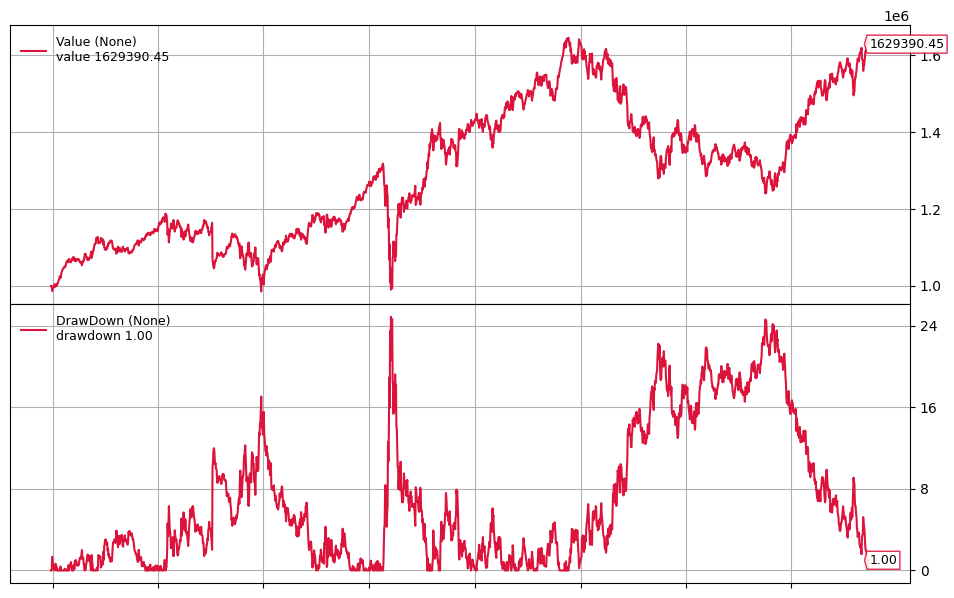

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139}]

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2776%
2951 2024-09-24  0.1099%
2952 2024-09-25 -0.4593%
2953 2024-09-26 -0.3285%
2954 2024-09-27  0.0803%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,1.4662%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,12.1805%
Financial Services,11.3852%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


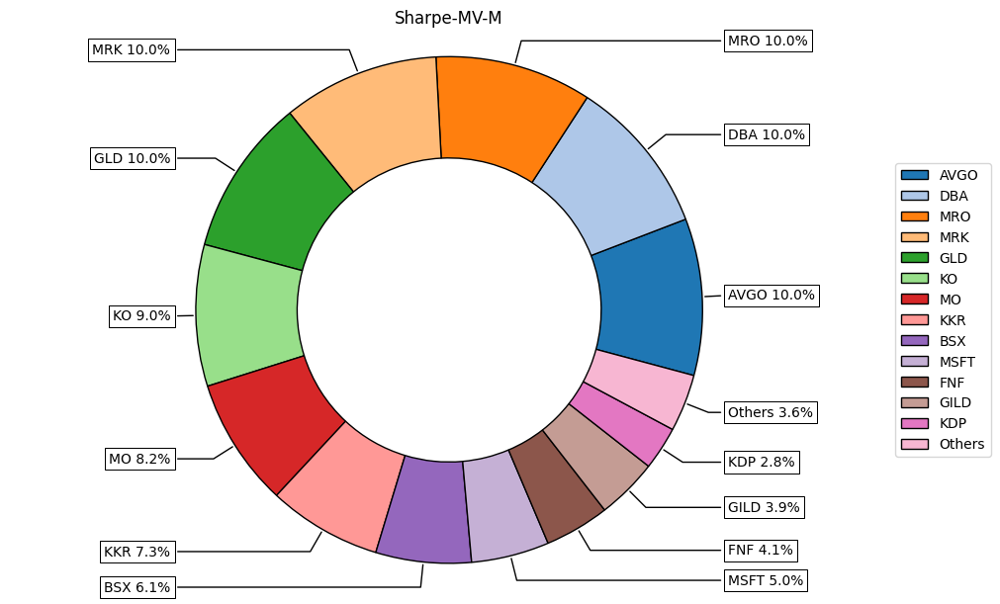

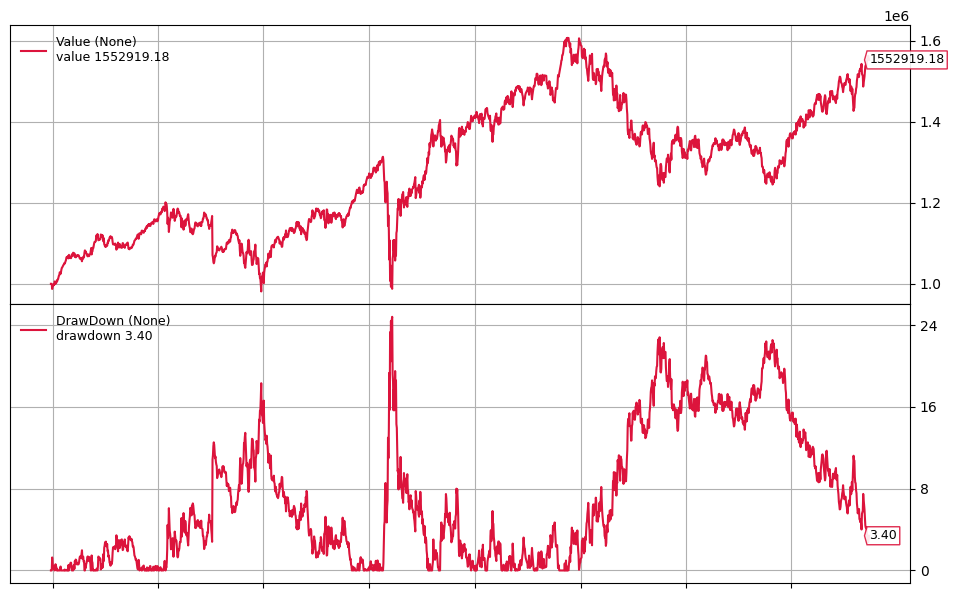

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943}]

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2575%
2951 2024-09-24  0.0494%
2952 2024-09-25 -0.3272%
2953 2024-09-26 -0.3171%
2954 2024-09-27  0.0352%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,11.0127%
Financial Services,11.8889%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


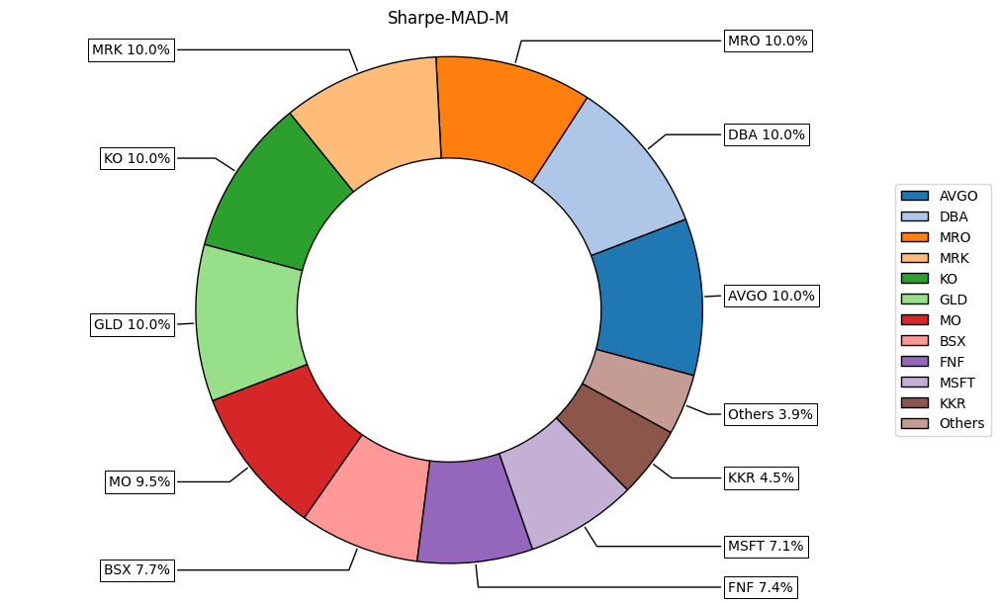

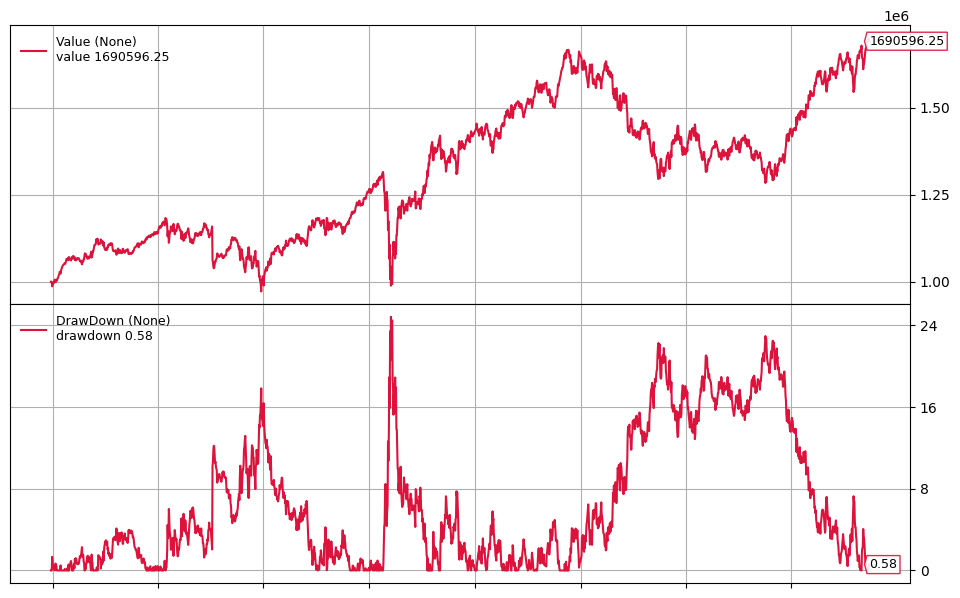

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401}]

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2647%
2951 2024-09-24  0.1304%
2952 2024-09-25 -0.3262%
2953 2024-09-26 -0.2501%
2954 2024-09-27 -0.1149%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,4.5247%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,12.1745%
Financial Services,9.6144%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


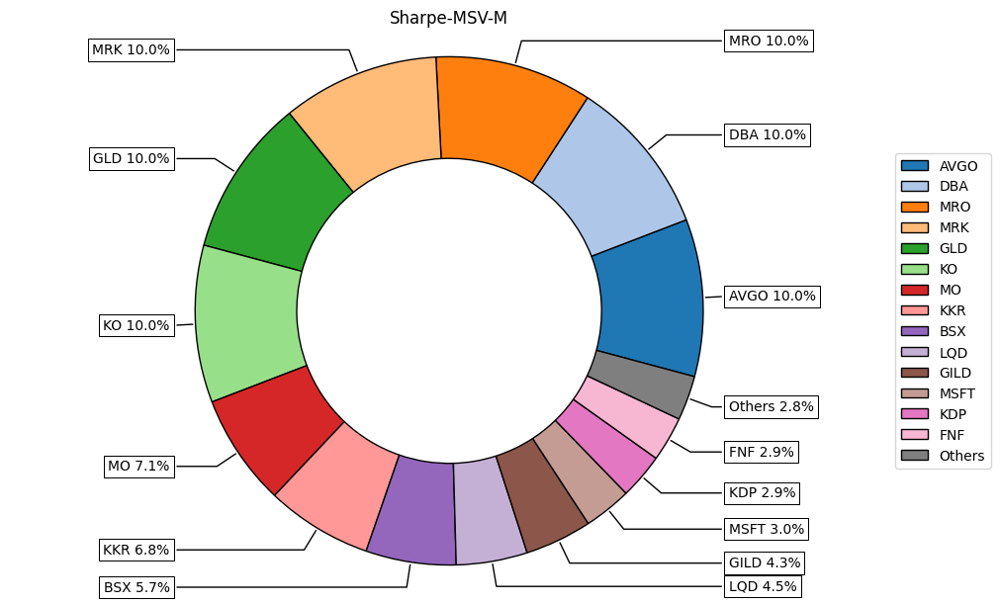

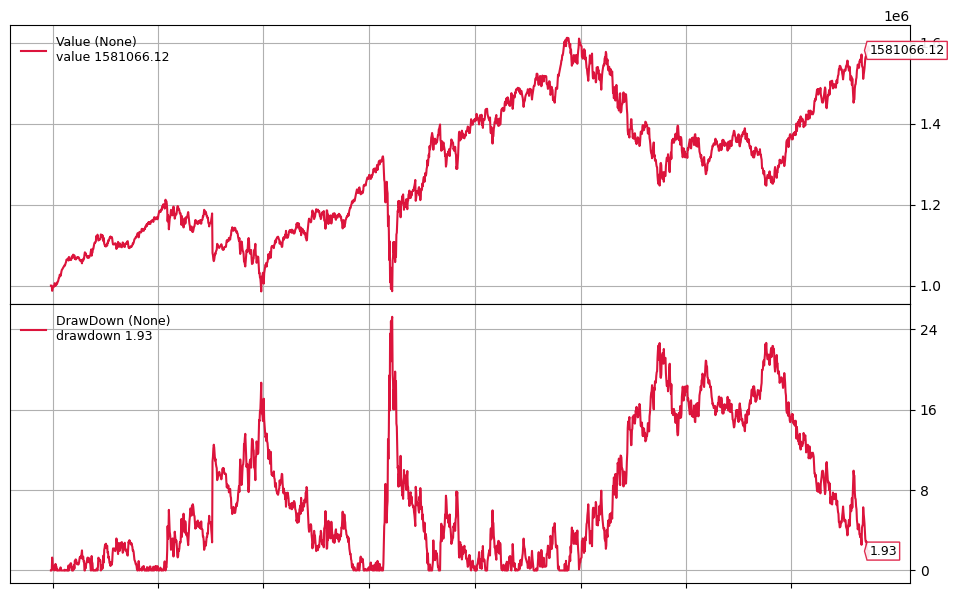

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412}]

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2604%
2951 2024-09-24  0.0654%
2952 2024-09-25 -0.3346%
2953 2024-09-26 -0.2918%
2954 2024-09-27 -0.0106%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,11.3922%
Financial Services,11.2045%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


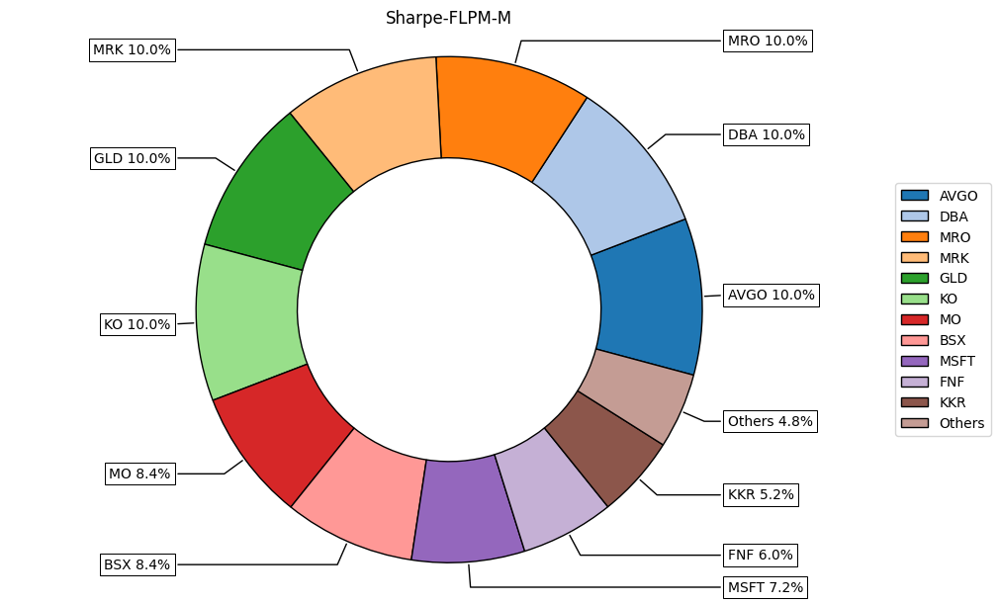

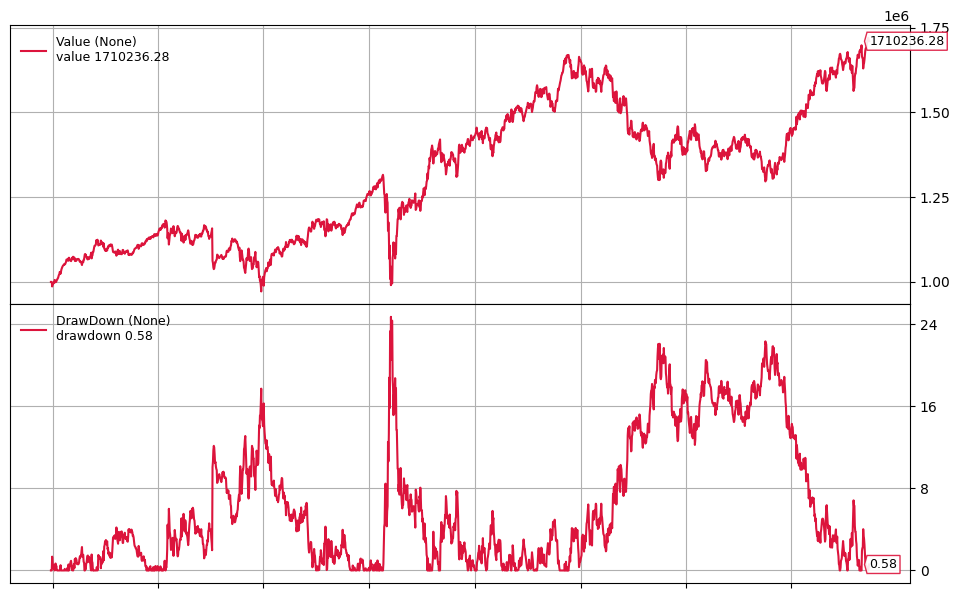

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2653%
2951 2024-09-24  0.1320%
2952 2024-09-25 -0.3360%
2953 2024-09-26 -0.2488%
2954 2024-09-27 -0.0996%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,5.1377%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,12.1721%
Financial Services,9.4525%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


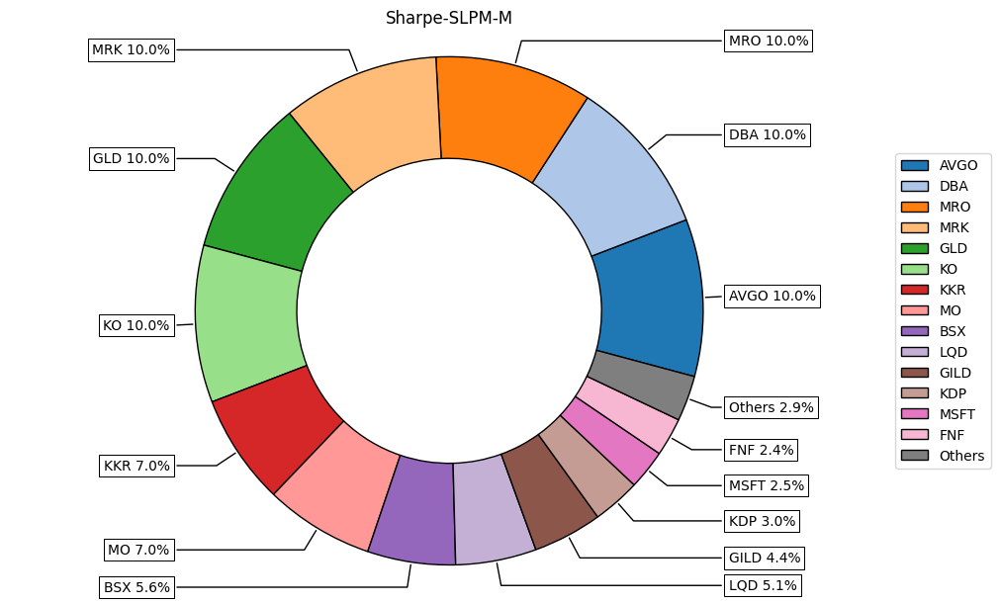

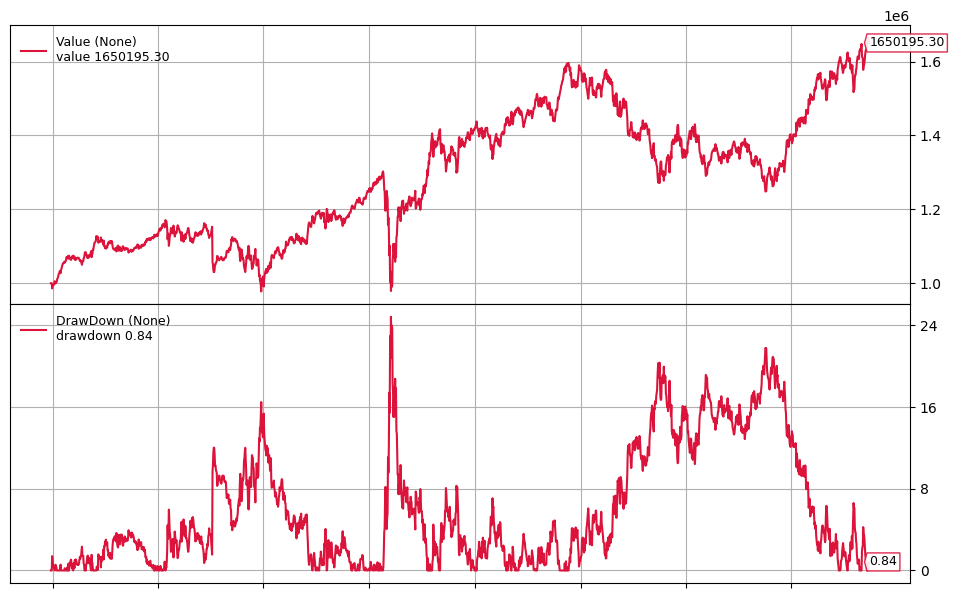

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.3162%
2951 2024-09-24  0.2182%
2952 2024-09-25 -0.5196%
2953 2024-09-26 -0.3195%
2954 2024-09-27 -0.1750%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,9.9191%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,13.2743%
Financial Services,5.9754%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


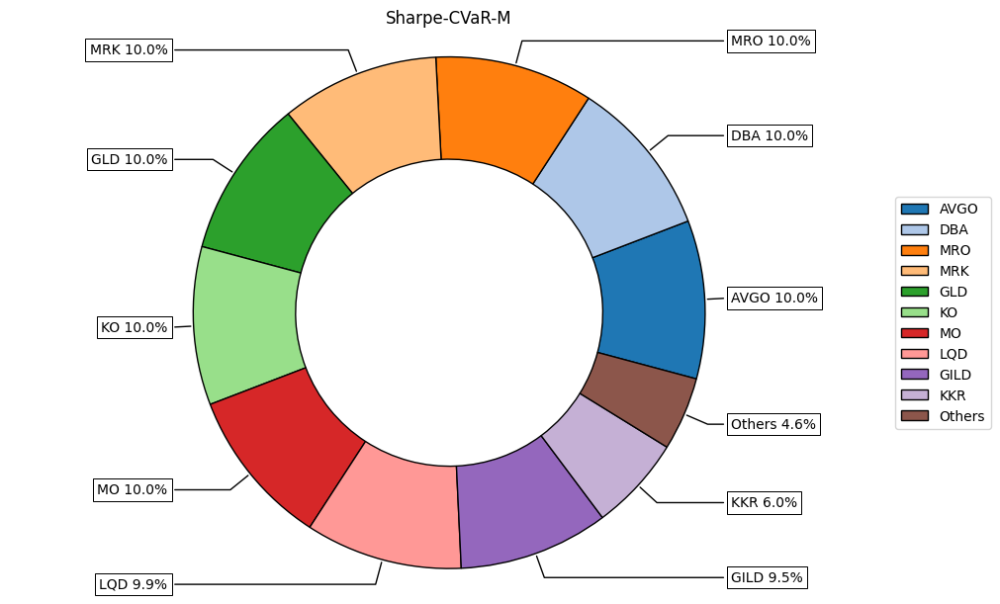

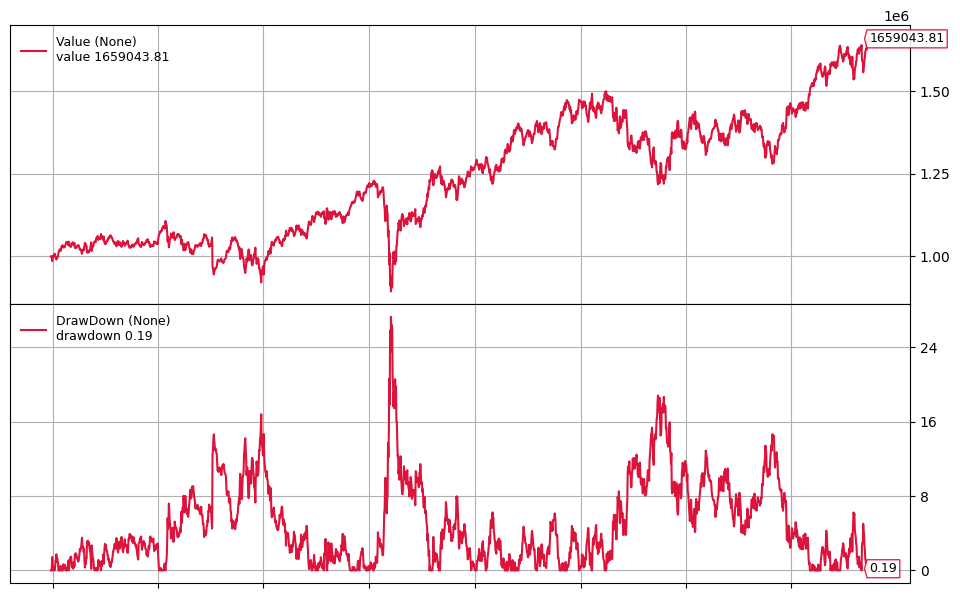

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.3497%
2951 2024-09-24  0.2945%
2952 2024-09-25 -0.4665%
2953 2024-09-26  0.2819%
2954 2024-09-27 -0.3306%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,0.0000%
Commodity,17.5686%
Communication Services,10.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,8.7450%
Energy,20.0000%
Financial Services,3.6864%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


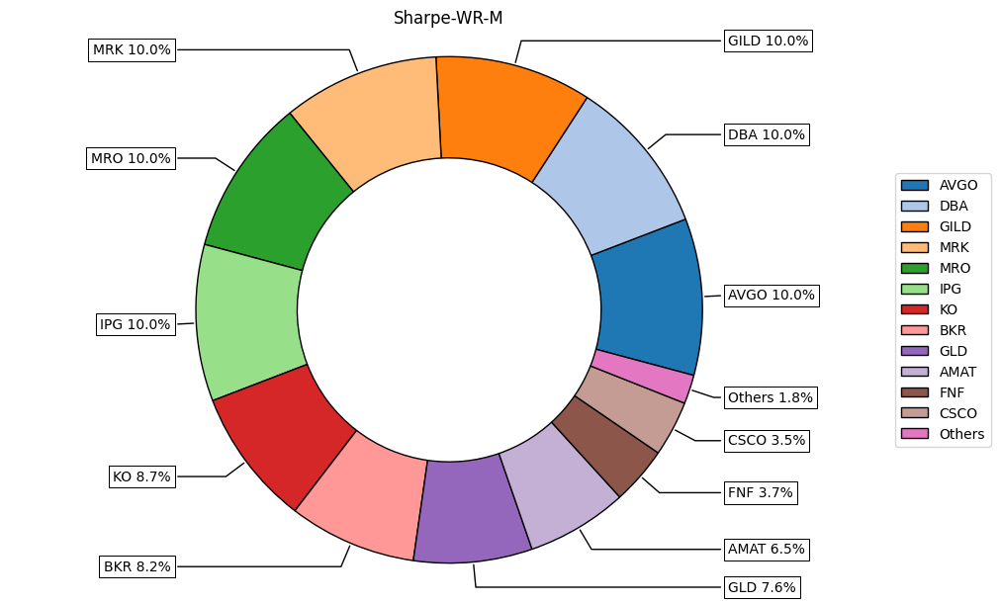

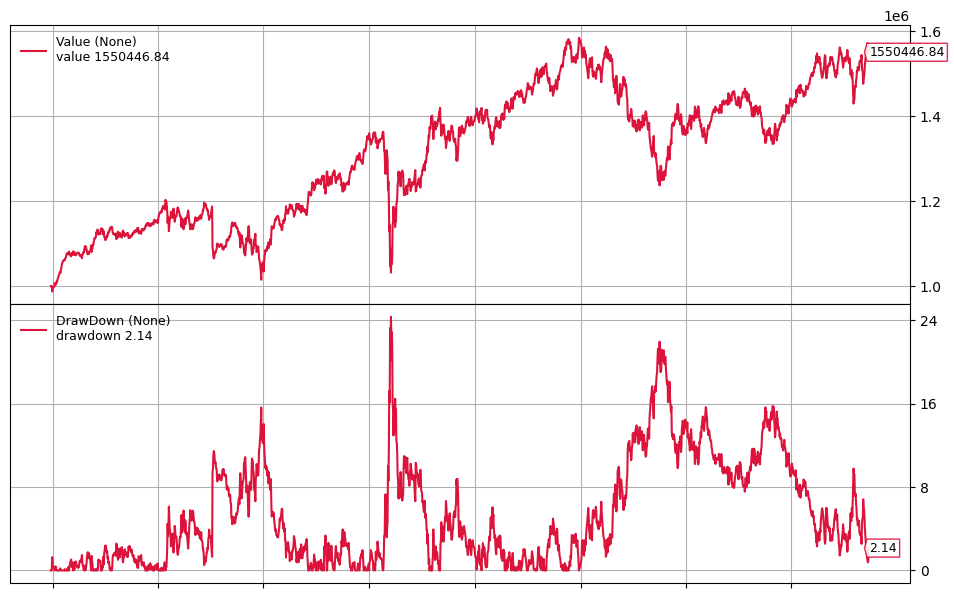

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2486%
2951 2024-09-24 -0.1714%
2952 2024-09-25 -0.7131%
2953 2024-09-26 -0.4941%
2954 2024-09-27  0.2382%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,0.0000%
Commodity,11.8267%
Communication Services,0.0000%
Consumer Cyclical,2.2558%
Consumer Defensive,19.9962%
Energy,15.9210%
Financial Services,10.0004%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


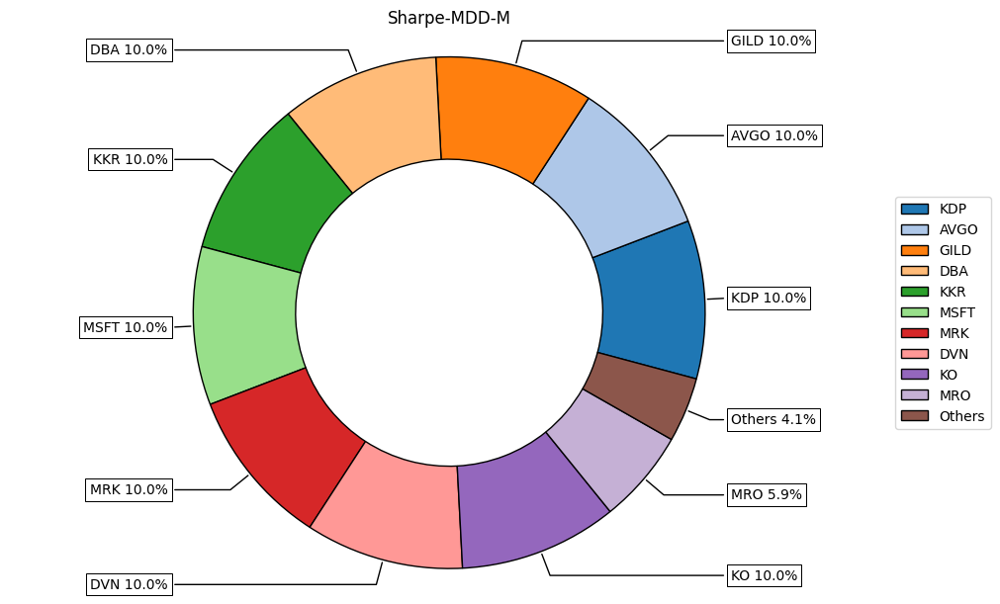

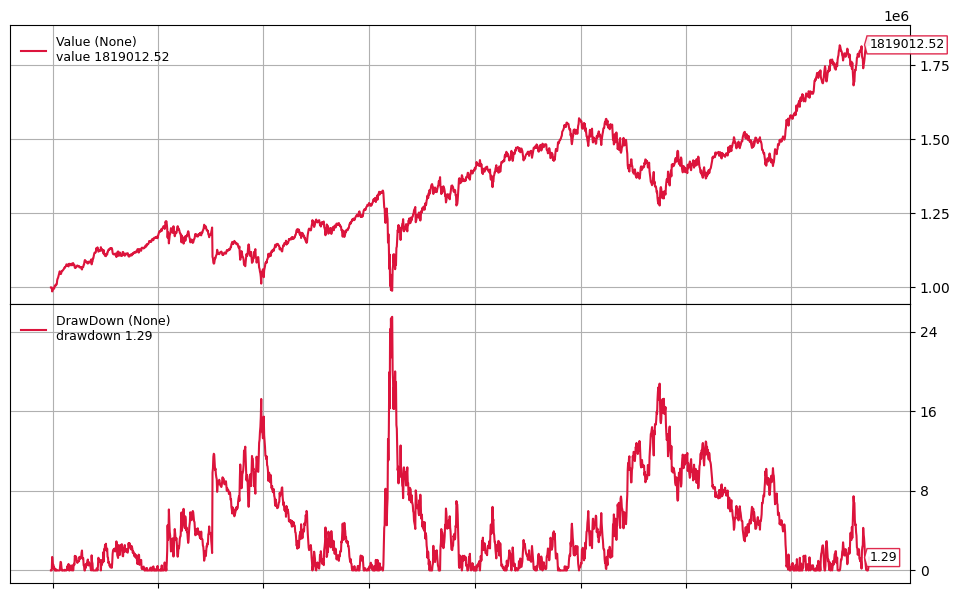

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2663%
2951 2024-09-24 -0.1722%
2952 2024-09-25 -0.5050%
2953 2024-09-26 -0.6221%
2954 2024-09-27 -0.0291%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,11.6785%
Financial Services,8.3215%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


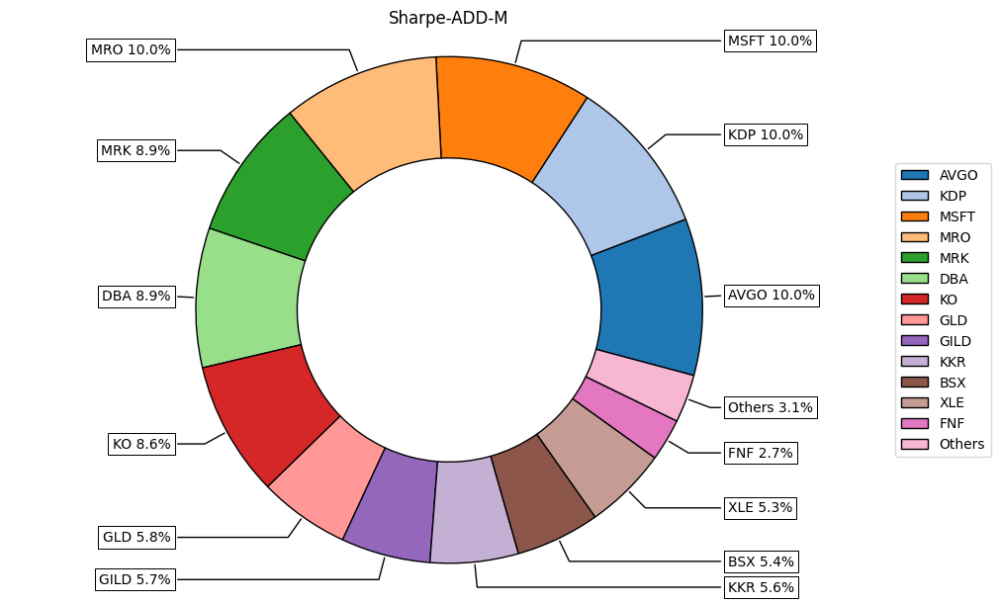

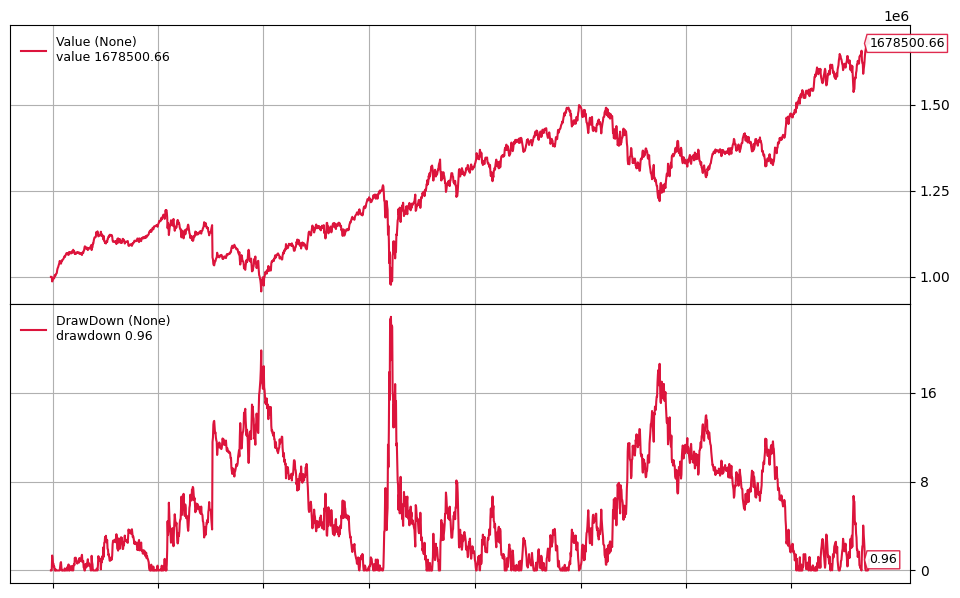

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.3200%
2951 2024-09-24 -0.0955%
2952 2024-09-25 -0.4949%
2953 2024-09-26 -0.3722%
2954 2024-09-27  0.0589%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,10.0000%
Financial Services,10.0000%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


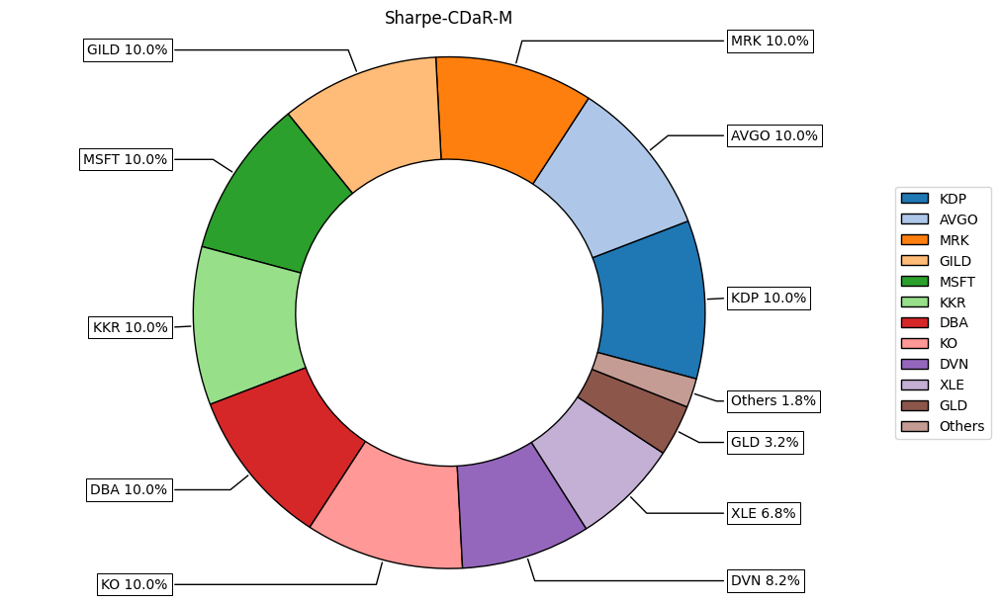

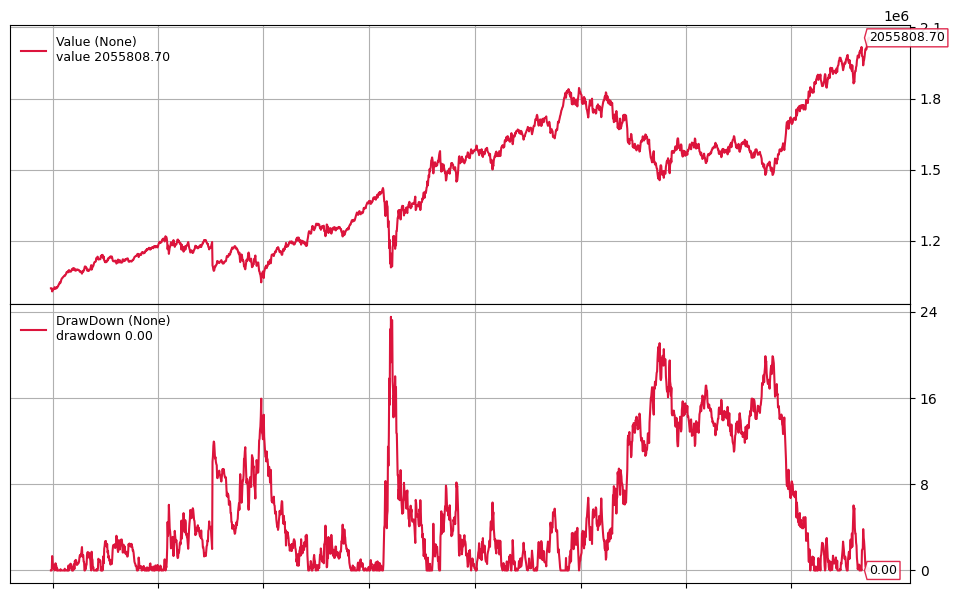

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.3916%
2951 2024-09-24  0.5313%
2952 2024-09-25 -0.2164%
2953 2024-09-26  0.2927%
2954 2024-09-27 -0.2617%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,1.4662%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,12.1805%
Financial Services,11.3852%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


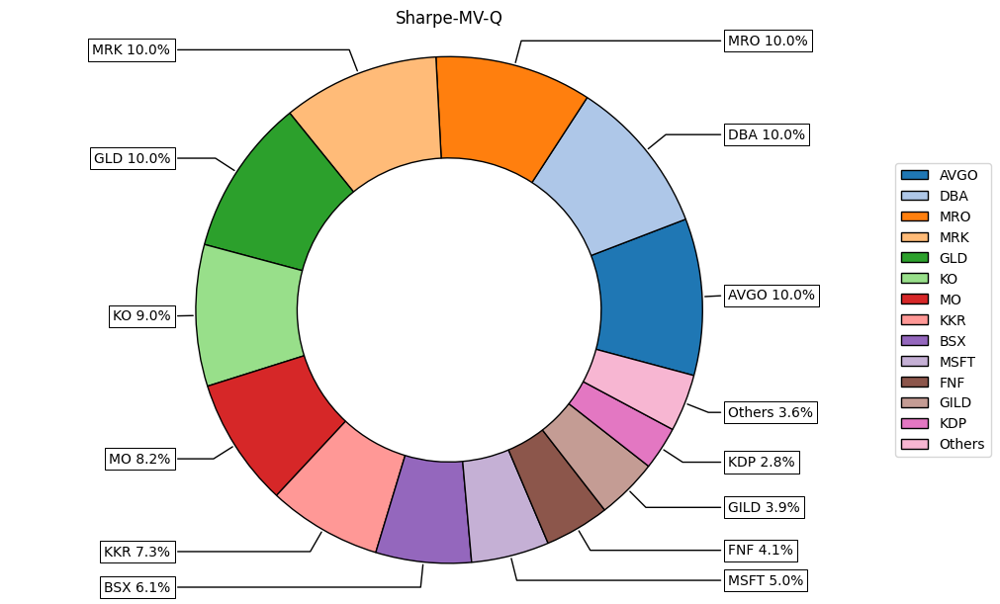

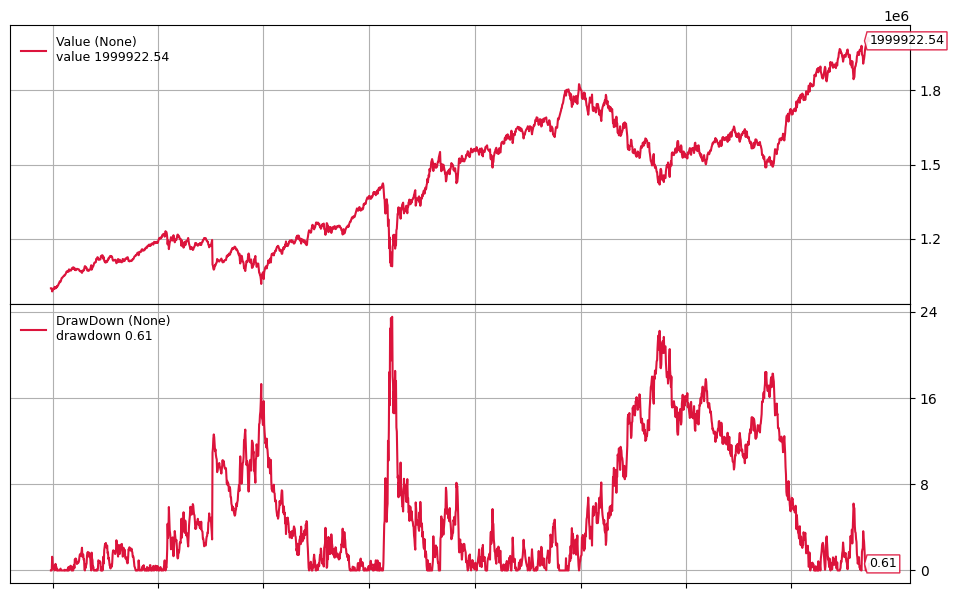

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2057%
2951 2024-09-24  0.0320%
2952 2024-09-25 -0.2607%
2953 2024-09-26 -0.3485%
2954 2024-09-27 -0.1963%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,11.0127%
Financial Services,11.8889%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


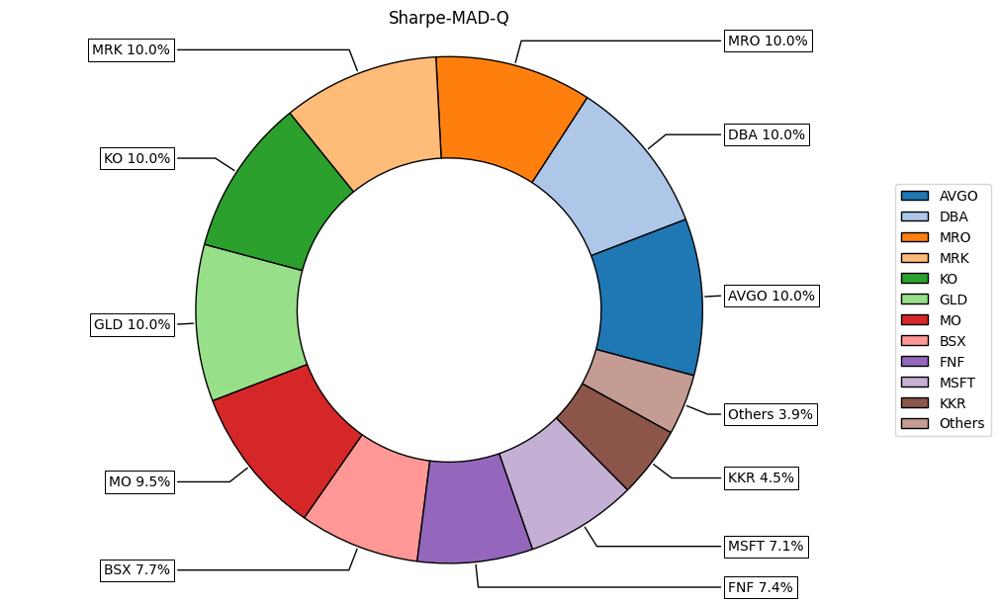

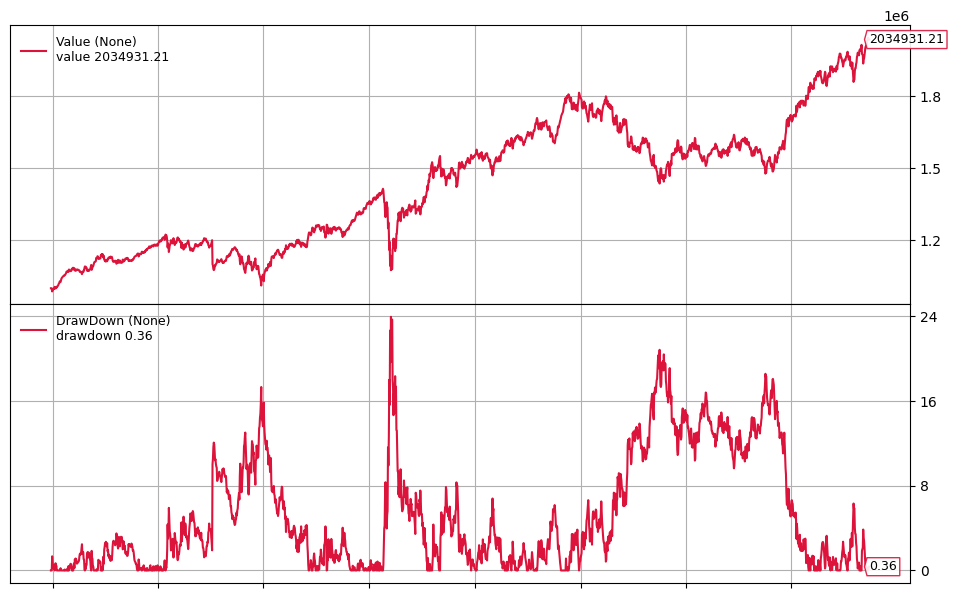

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2966%
2951 2024-09-24  0.1326%
2952 2024-09-25 -0.2480%
2953 2024-09-26 -0.1073%
2954 2024-09-27 -0.2129%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,4.5247%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,12.1745%
Financial Services,9.6144%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


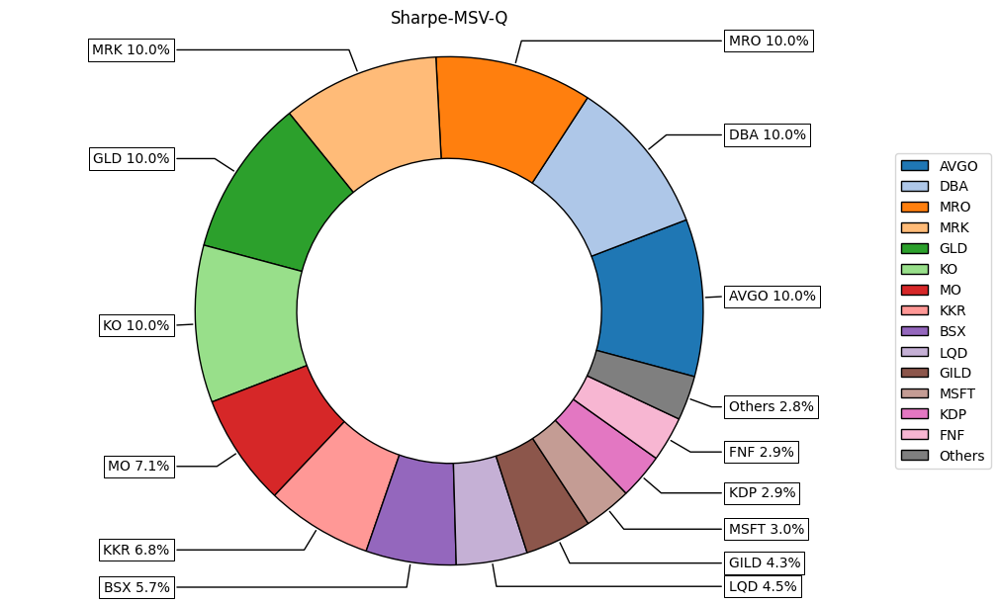

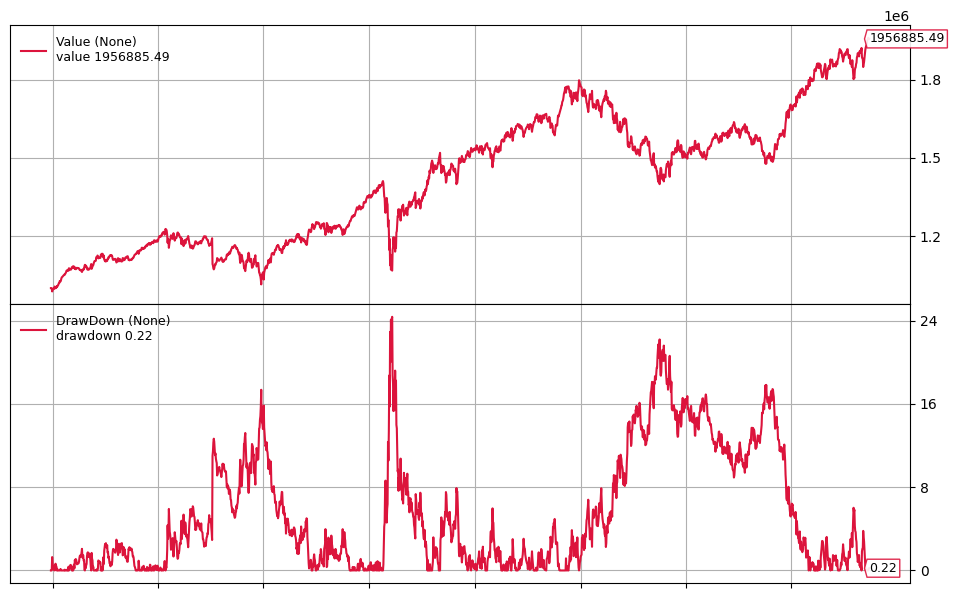

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.1776%
2951 2024-09-24  0.2394%
2952 2024-09-25 -0.1965%
2953 2024-09-26 -0.0187%
2954 2024-09-27 -0.2808%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,11.3922%
Financial Services,11.2045%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


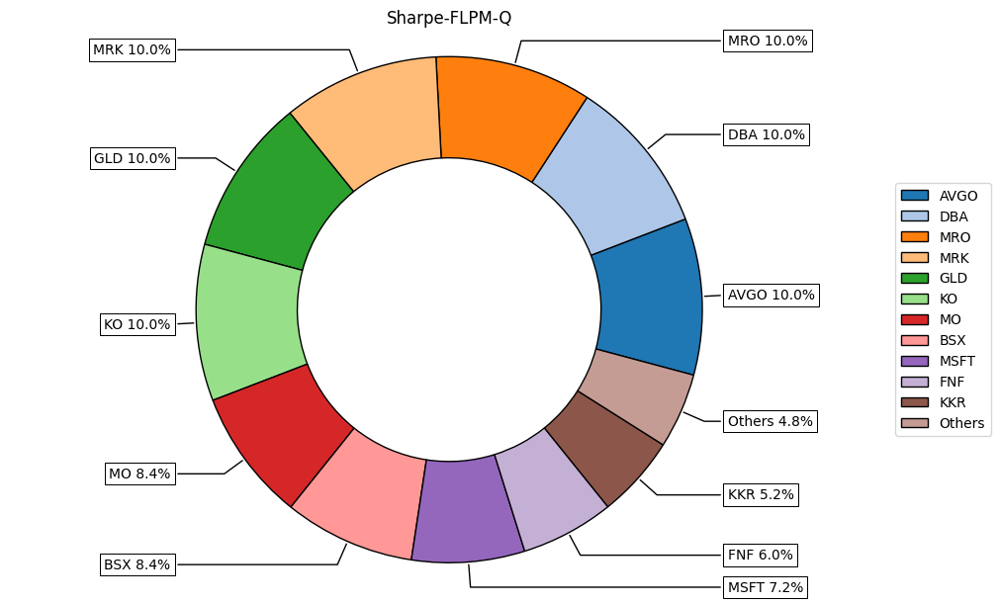

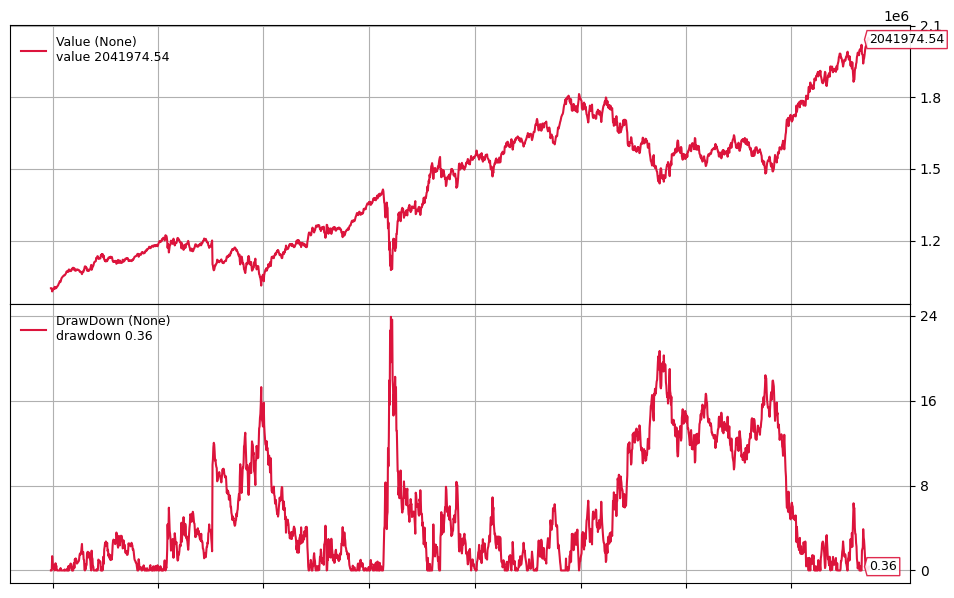

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2973%
2951 2024-09-24  0.1418%
2952 2024-09-25 -0.2558%
2953 2024-09-26 -0.1045%
2954 2024-09-27 -0.2194%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,5.1377%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,12.1721%
Financial Services,9.4525%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


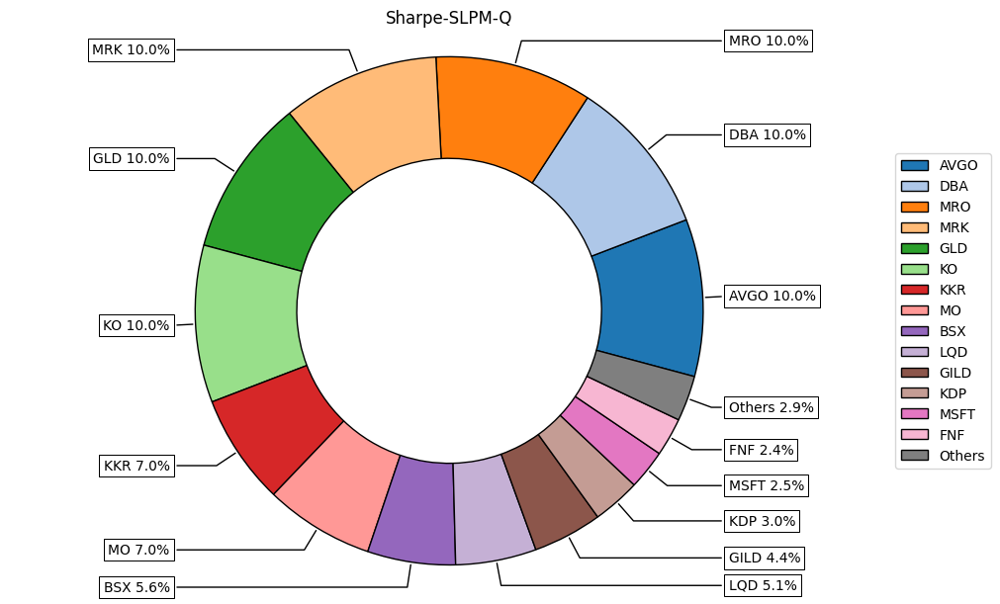

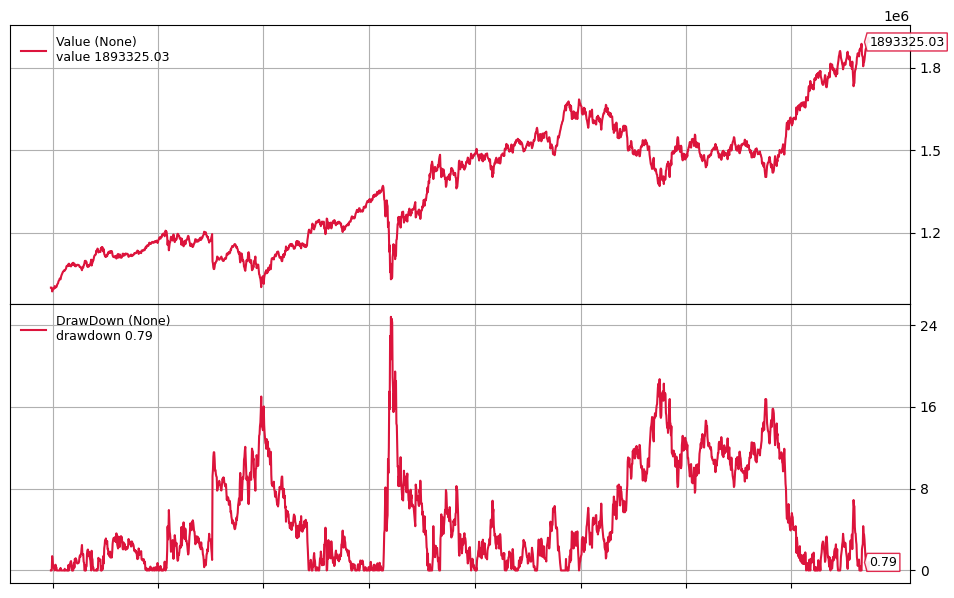

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.3071%
2951 2024-09-24  0.1739%
2952 2024-09-25 -0.4323%
2953 2024-09-26 -0.3605%
2954 2024-09-27 -0.3313%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,9.9191%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,13.2743%
Financial Services,5.9754%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


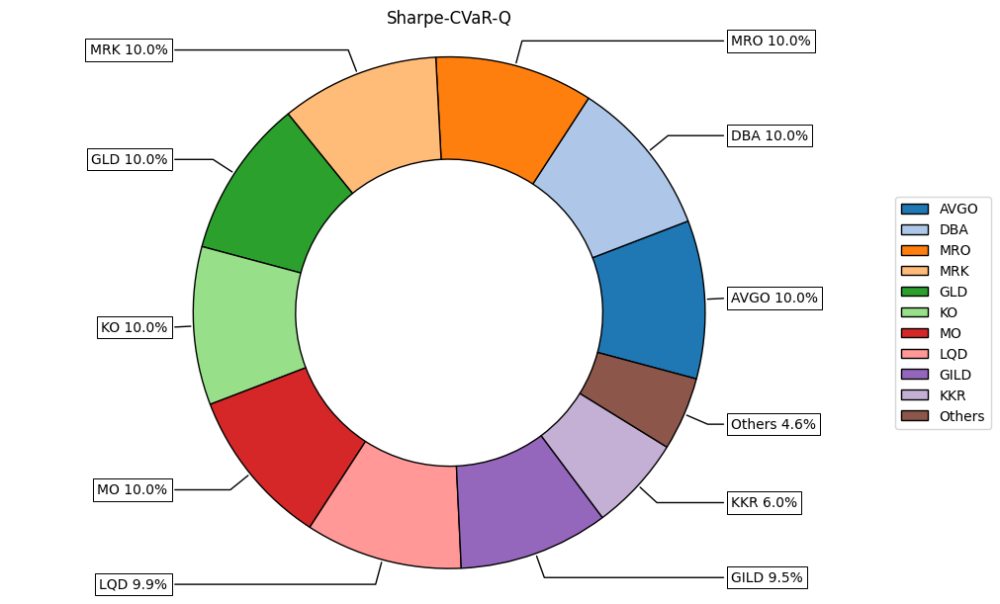

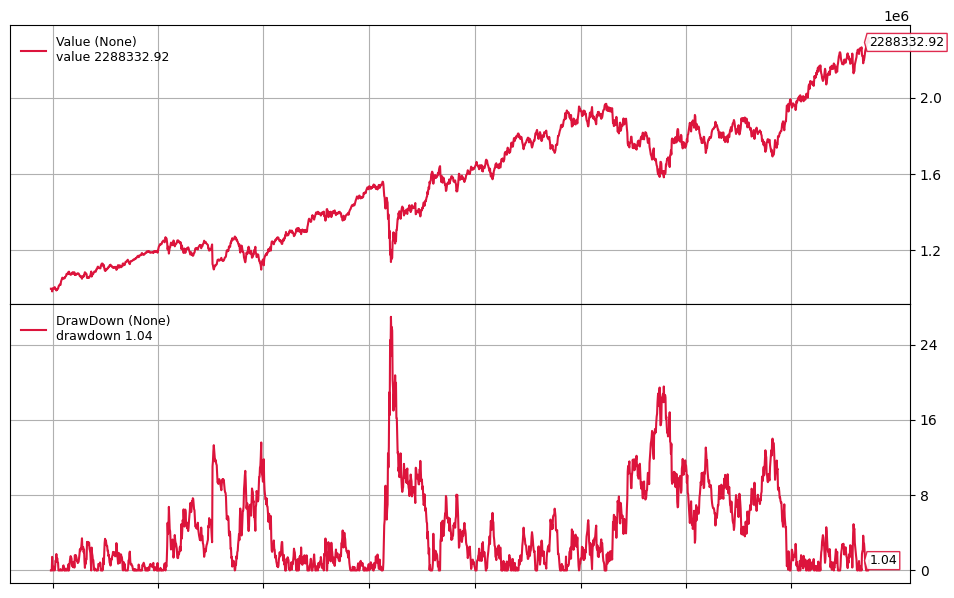

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.4185%
2951 2024-09-24  0.1970%
2952 2024-09-25 -0.6100%
2953 2024-09-26 -0.4369%
2954 2024-09-27 -0.3782%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,0.0000%
Commodity,17.5686%
Communication Services,10.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,8.7450%
Energy,20.0000%
Financial Services,3.6864%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


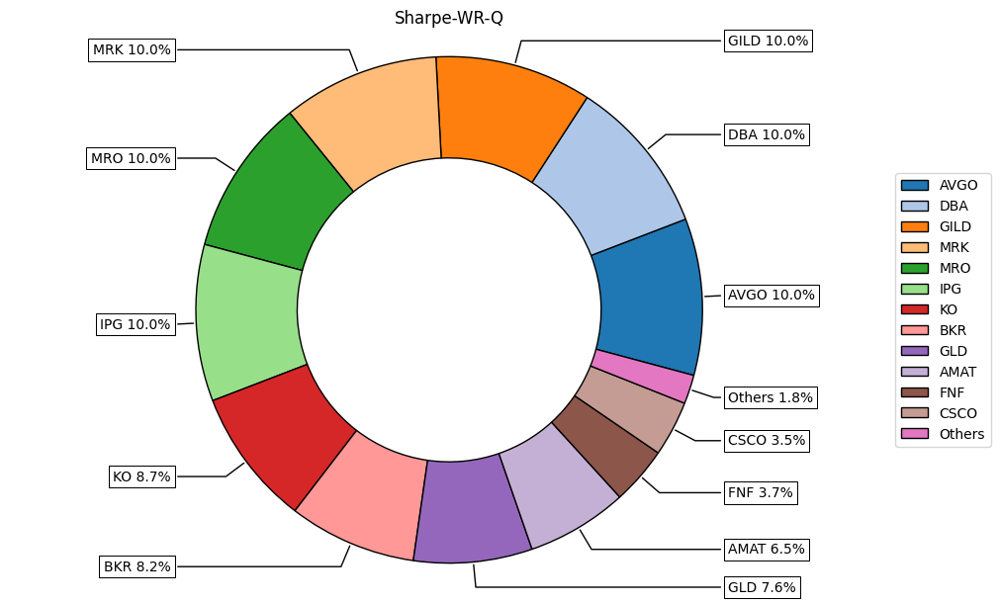

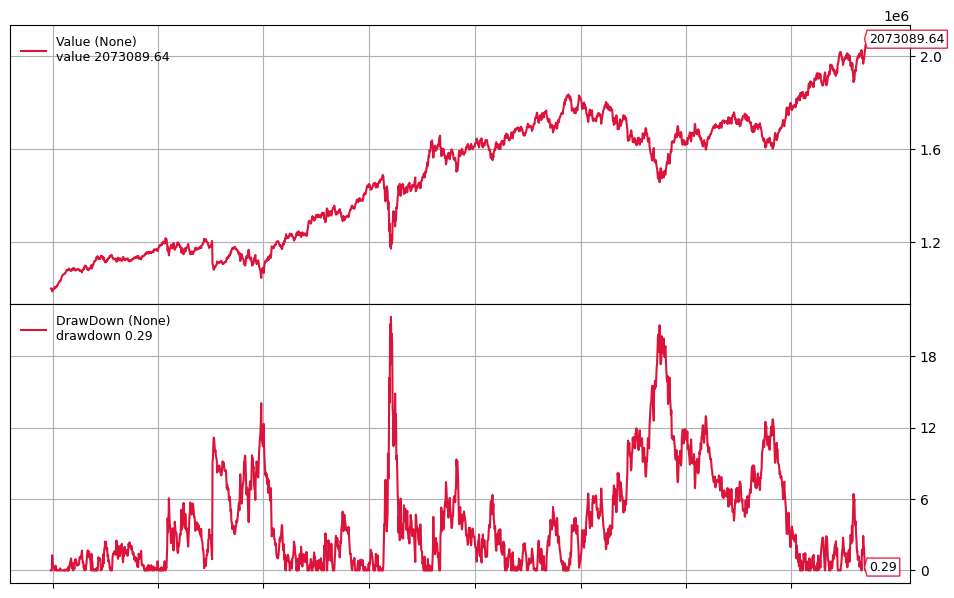

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.0949%
2951 2024-09-24 -0.0966%
2952 2024-09-25 -0.1217%
2953 2024-09-26 -0.0670%
2954 2024-09-27 -0.3692%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,0.0000%
Commodity,11.8267%
Communication Services,0.0000%
Consumer Cyclical,2.2558%
Consumer Defensive,19.9962%
Energy,15.9210%
Financial Services,10.0004%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


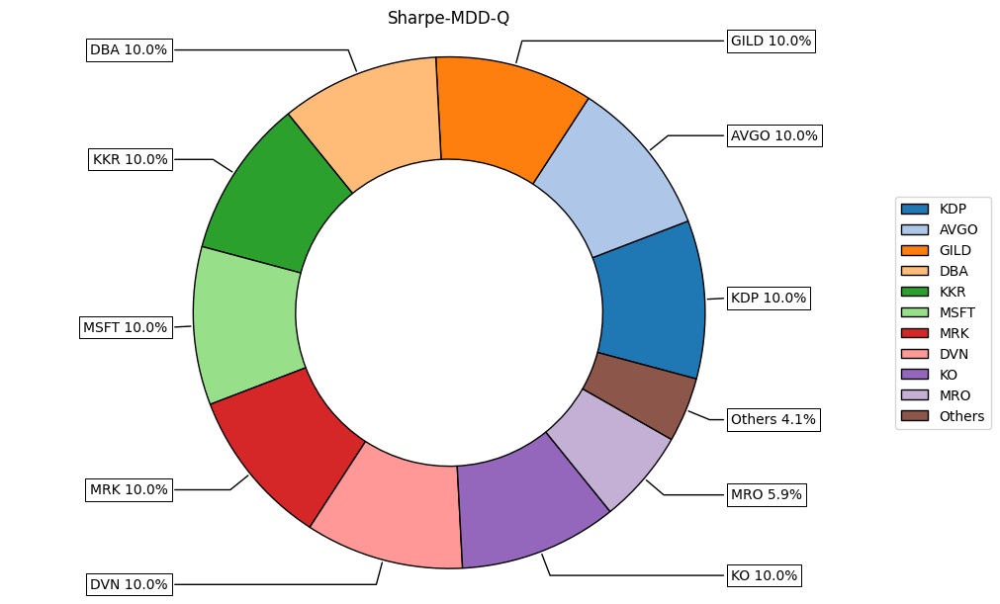

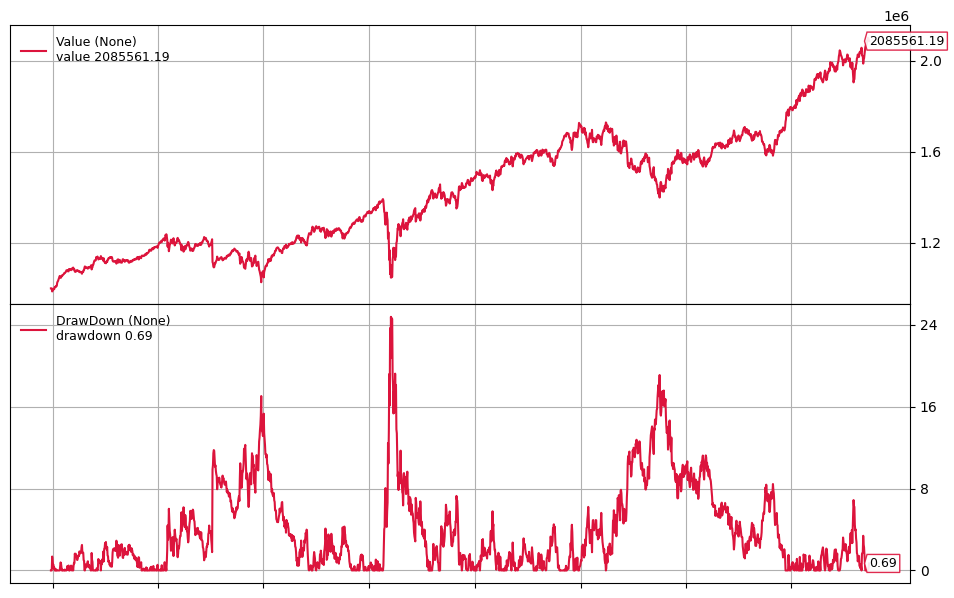

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.3838%
2951 2024-09-24 -0.0891%
2952 2024-09-25 -0.2158%
2953 2024-09-26 -0.3821%
2954 2024-09-27 -0.2468%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,11.6785%
Financial Services,8.3215%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


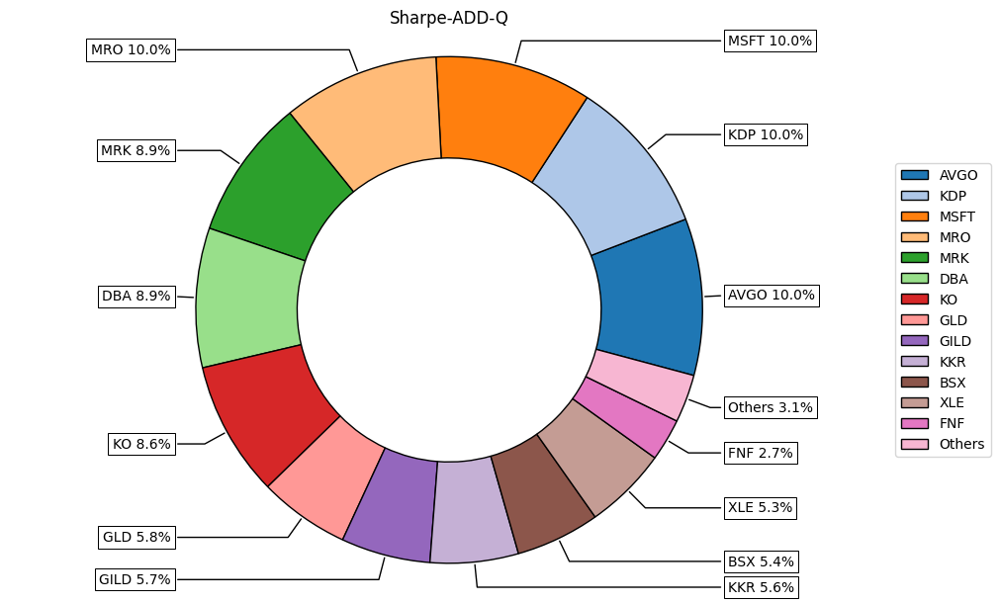

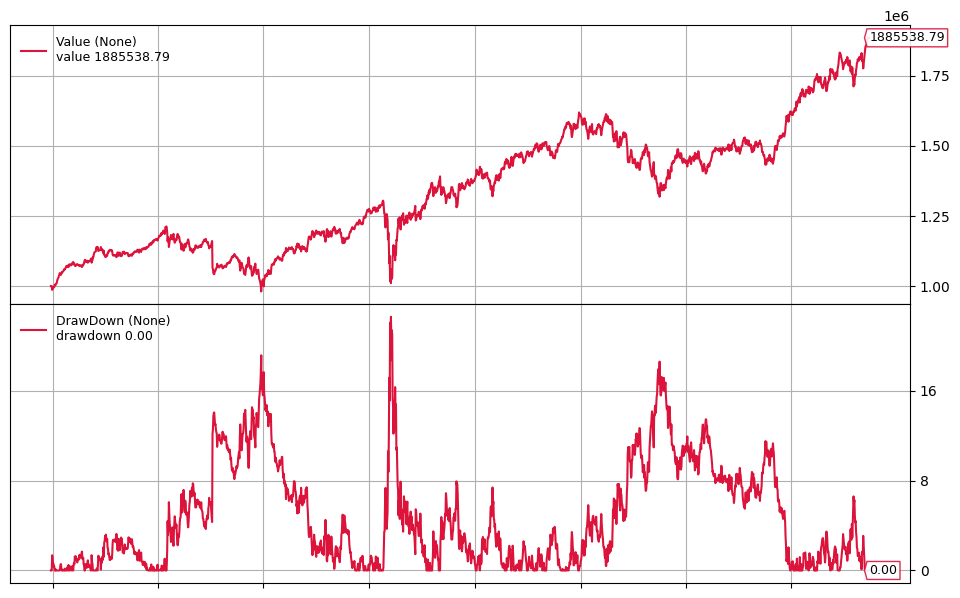

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2638%
2951 2024-09-24 -0.0145%
2952 2024-09-25  0.0183%
2953 2024-09-26  0.0109%
2954 2024-09-27 -0.4936%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,10.0000%
Financial Services,10.0000%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


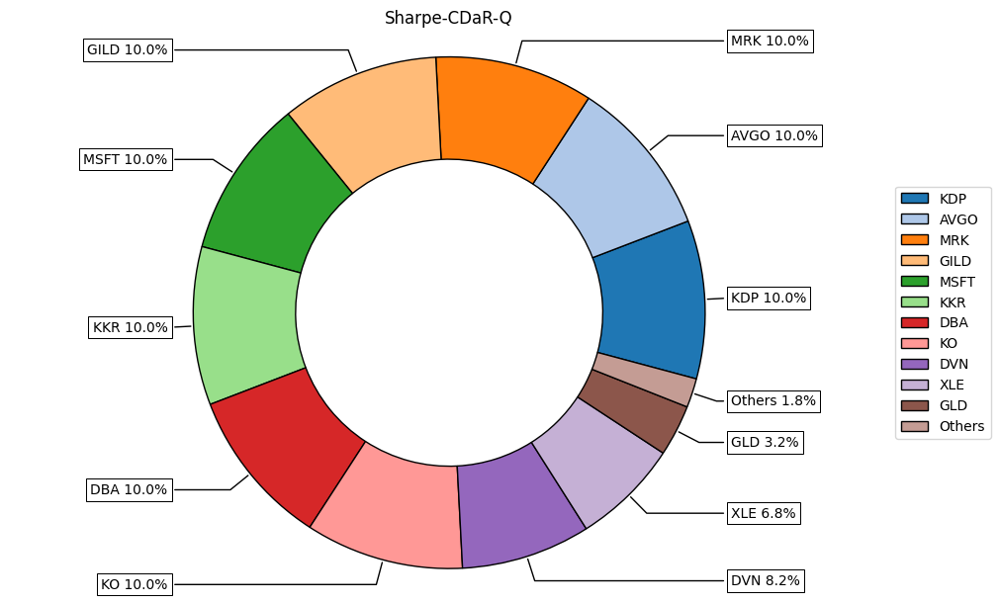

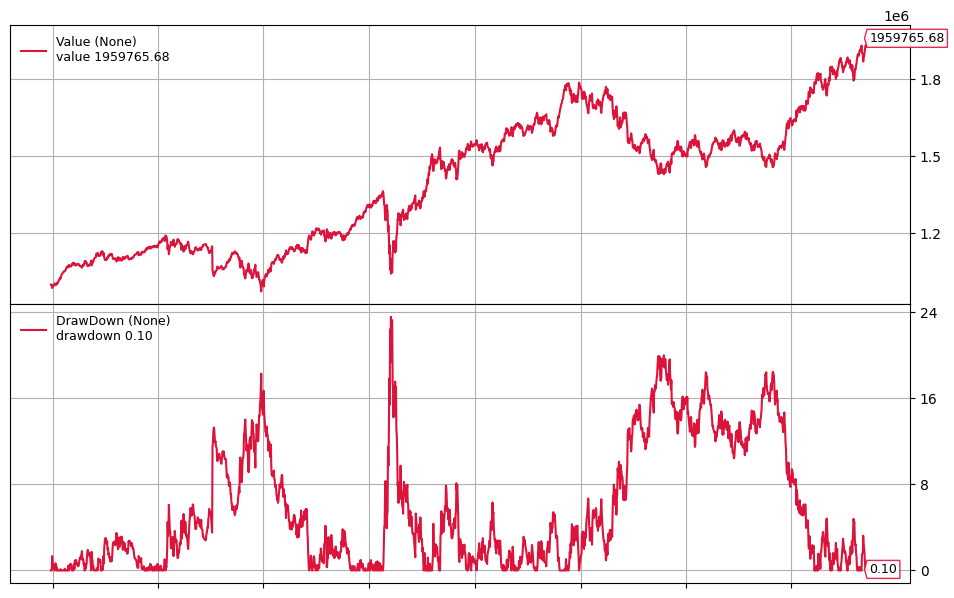

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.3139%
2951 2024-09-24  0.1812%
2952 2024-09-25 -0.1215%
2953 2024-09-26  0.0237%
2954 2024-09-27 -0.1214%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,13.3895%
Financial Services,7.4339%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


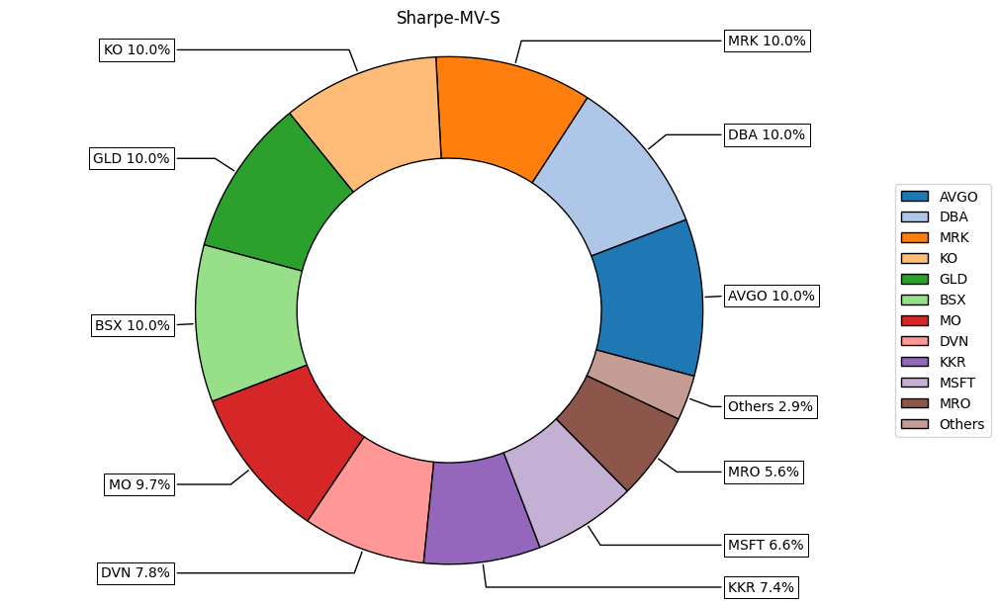

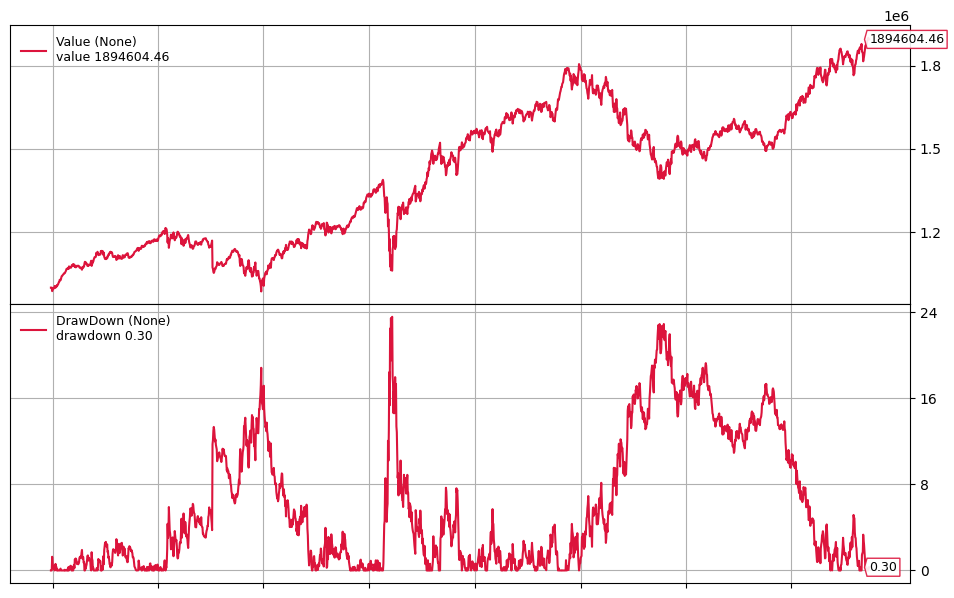

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2763%
2951 2024-09-24  0.1394%
2952 2024-09-25 -0.1758%
2953 2024-09-26 -0.1230%
2954 2024-09-27 -0.1158%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,13.7279%
Financial Services,6.2721%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


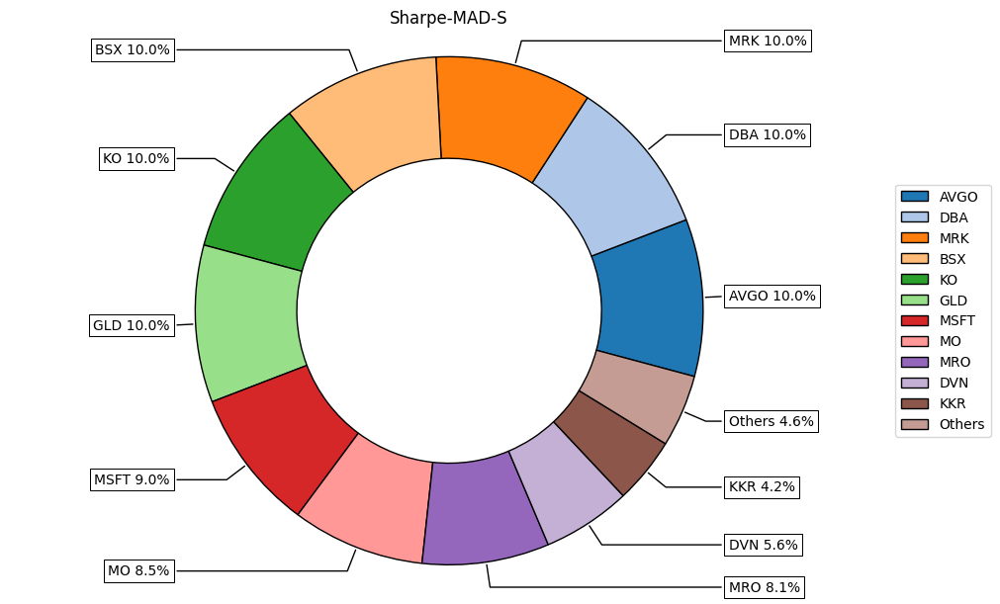

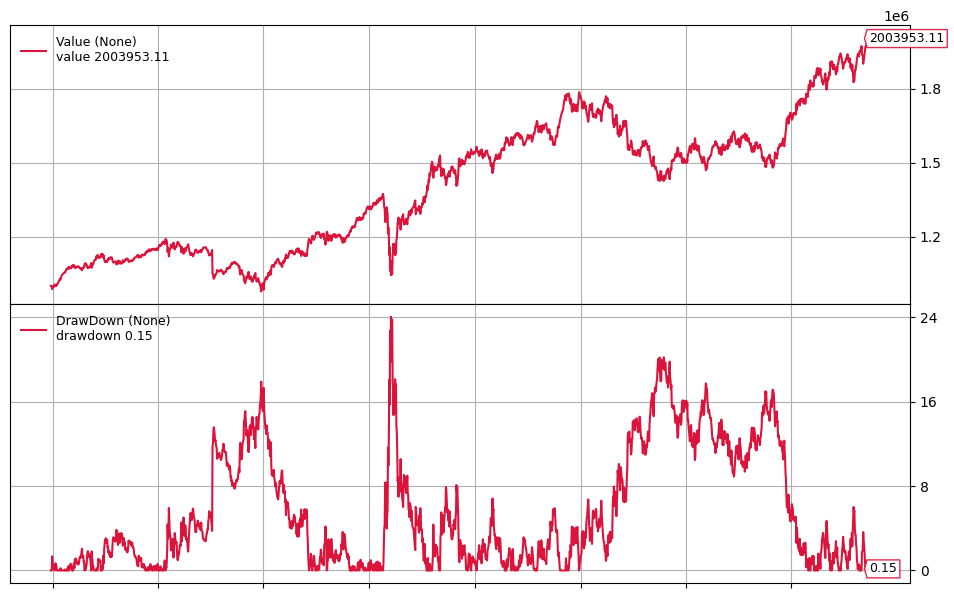

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2736%
2951 2024-09-24  0.1393%
2952 2024-09-25 -0.1675%
2953 2024-09-26  0.0198%
2954 2024-09-27 -0.1402%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,18.6565%
Energy,14.6457%
Financial Services,7.3492%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


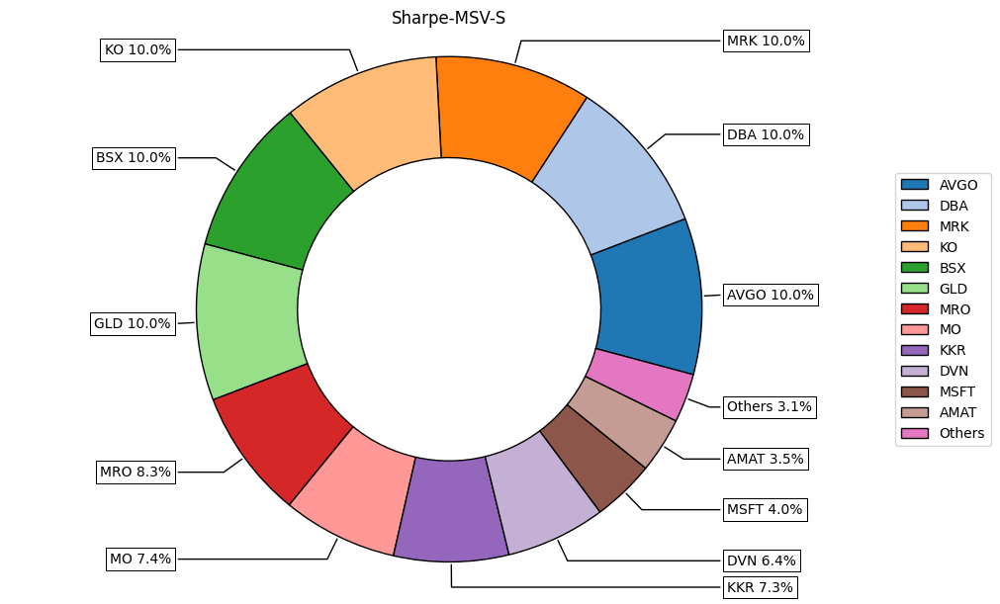

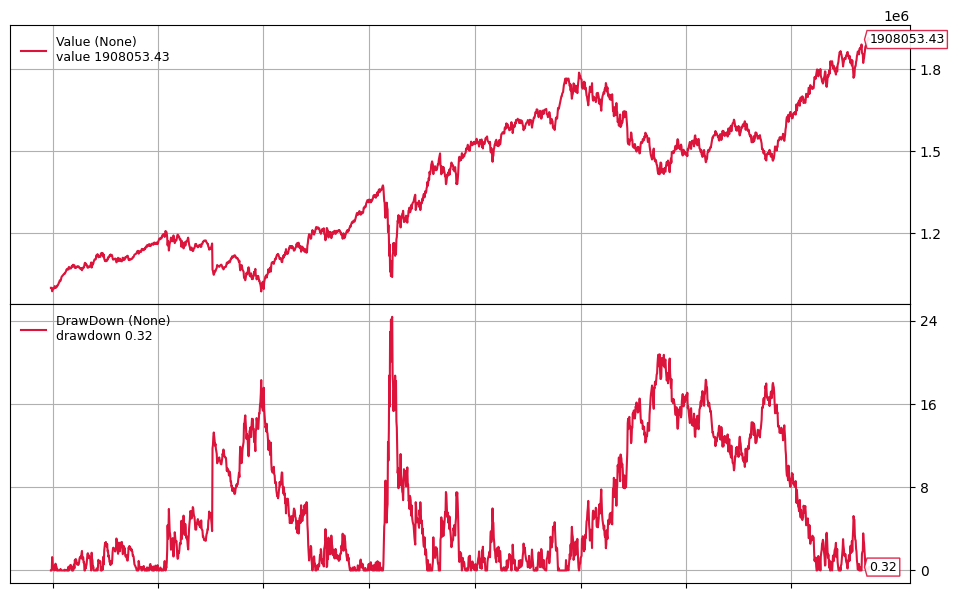

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2734%
2951 2024-09-24  0.1432%
2952 2024-09-25 -0.1952%
2953 2024-09-26 -0.1300%
2954 2024-09-27 -0.0948%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,13.4958%
Financial Services,6.5042%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


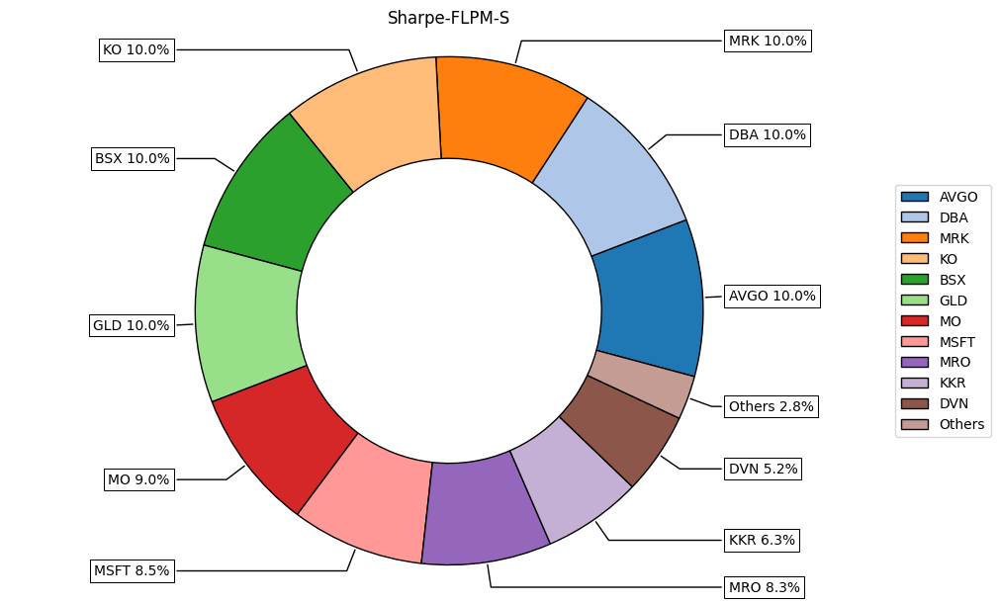

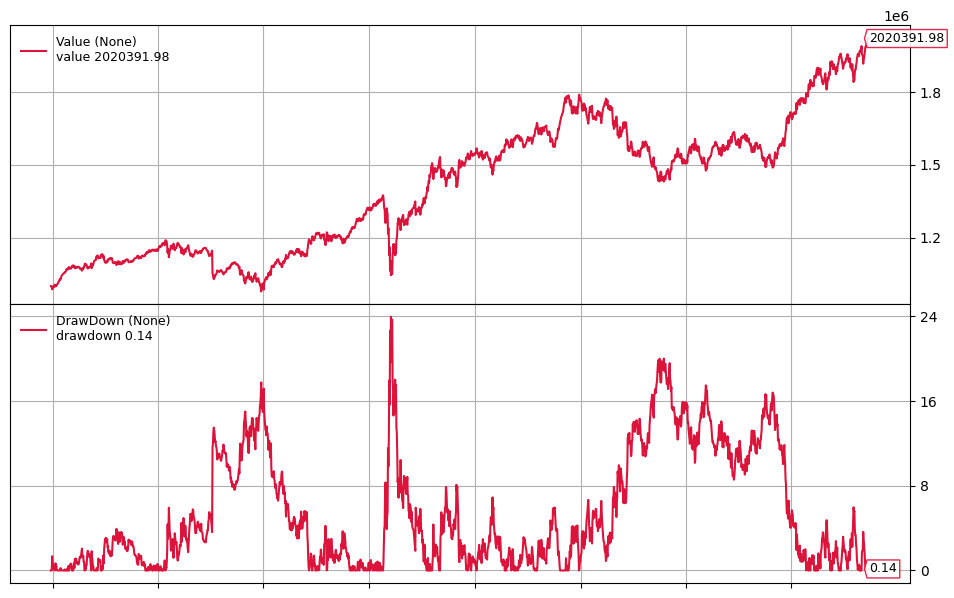

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2733%
2951 2024-09-24  0.1491%
2952 2024-09-25 -0.1714%
2953 2024-09-26  0.0290%
2954 2024-09-27 -0.1417%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,18.3132%
Energy,14.8192%
Financial Services,7.6507%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


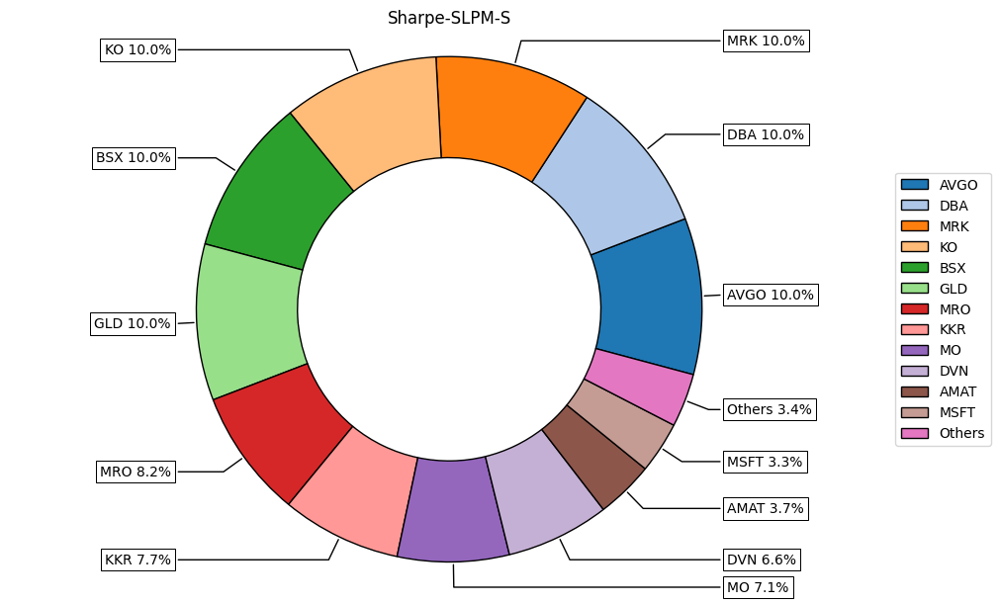

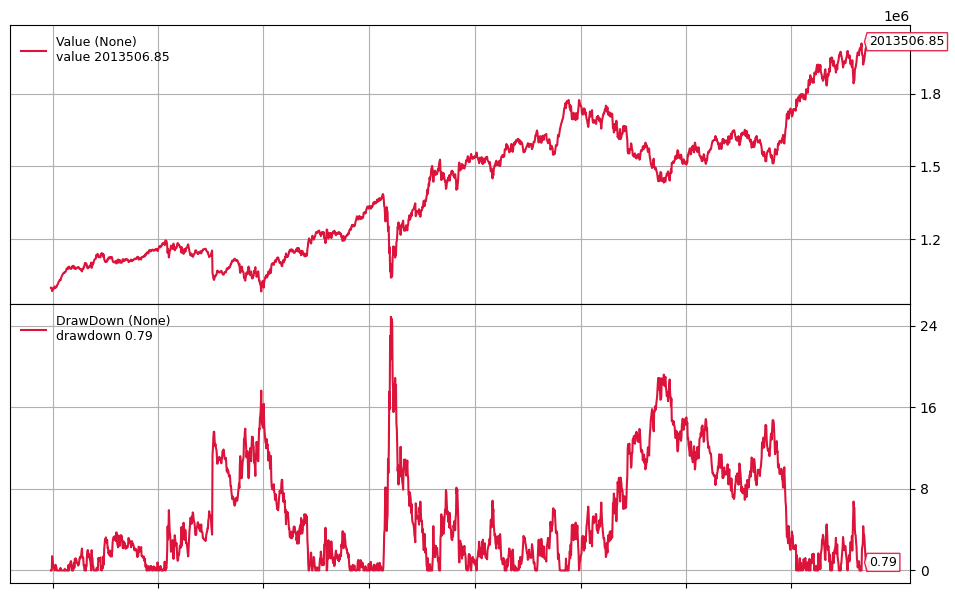

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.3072%
2951 2024-09-24  0.1740%
2952 2024-09-25 -0.4332%
2953 2024-09-26 -0.3625%
2954 2024-09-27  0.0627%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,16.2307%
Energy,17.4814%
Financial Services,9.7135%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


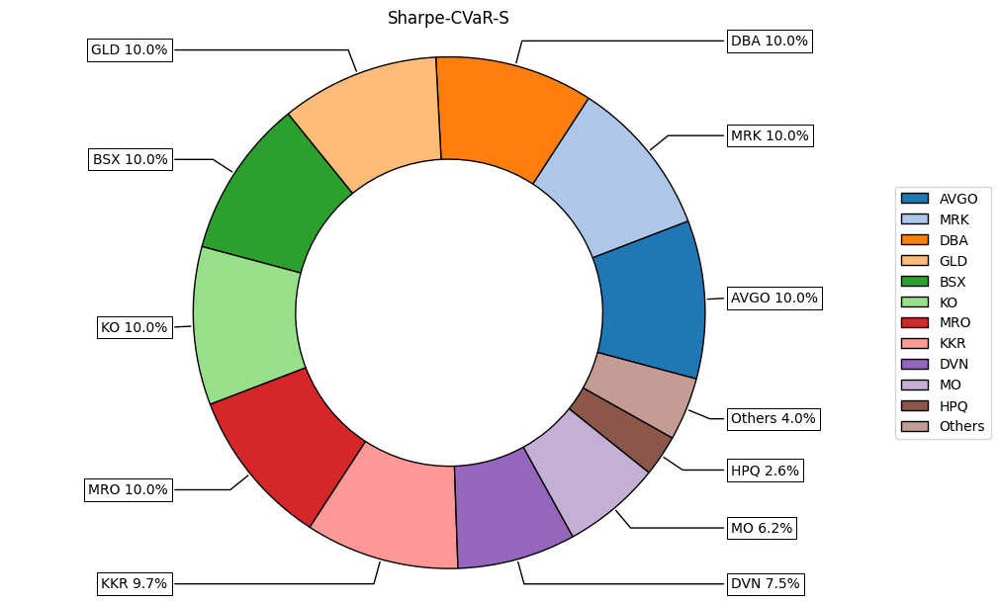

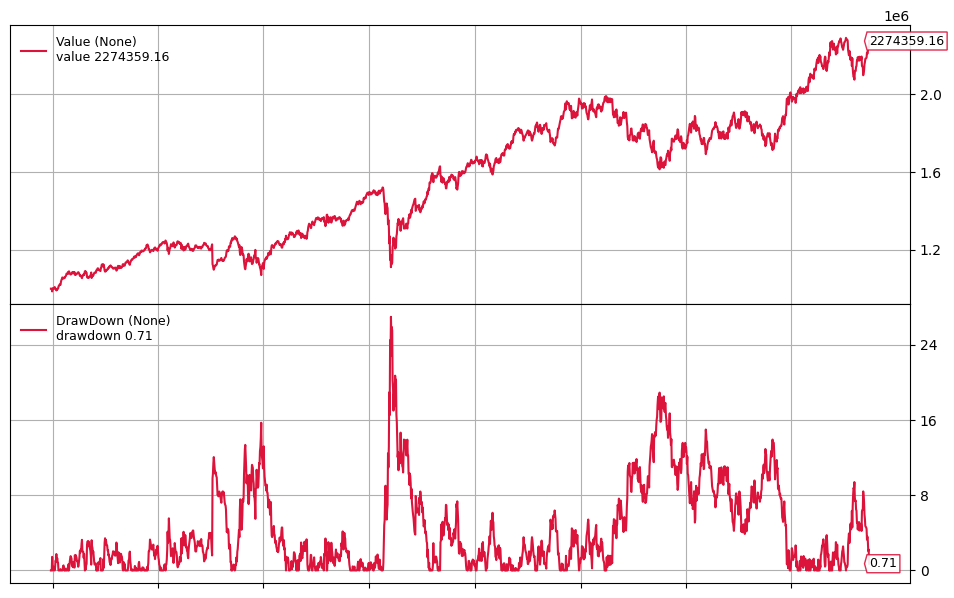

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.4861%
2951 2024-09-24  1.0927%
2952 2024-09-25 -0.1509%
2953 2024-09-26  1.5413%
2954 2024-09-27 -0.4735%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,0.0000%
Commodity,12.8560%
Communication Services,10.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,8.0764%
Energy,19.0568%
Financial Services,10.0109%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


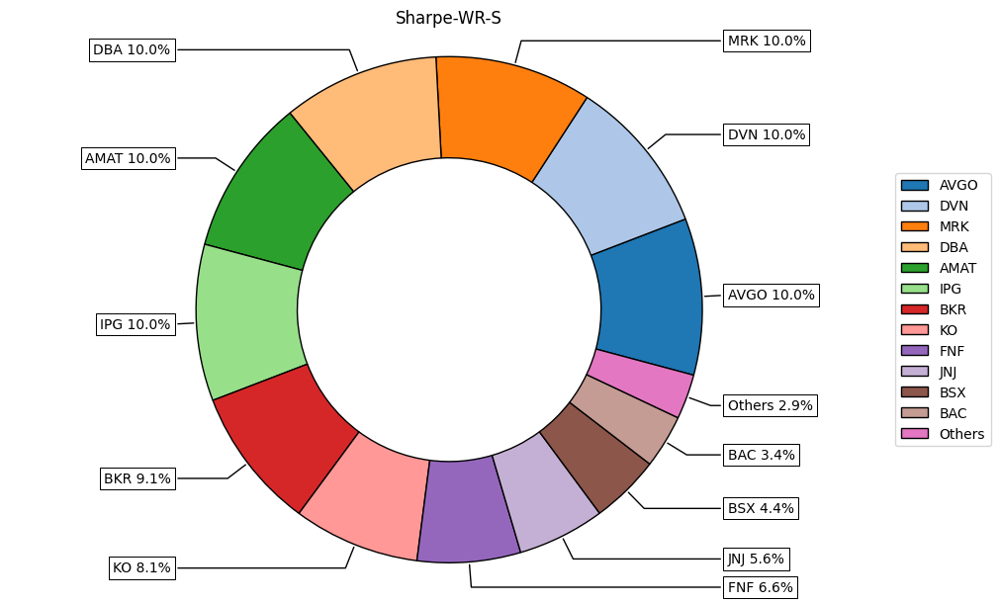

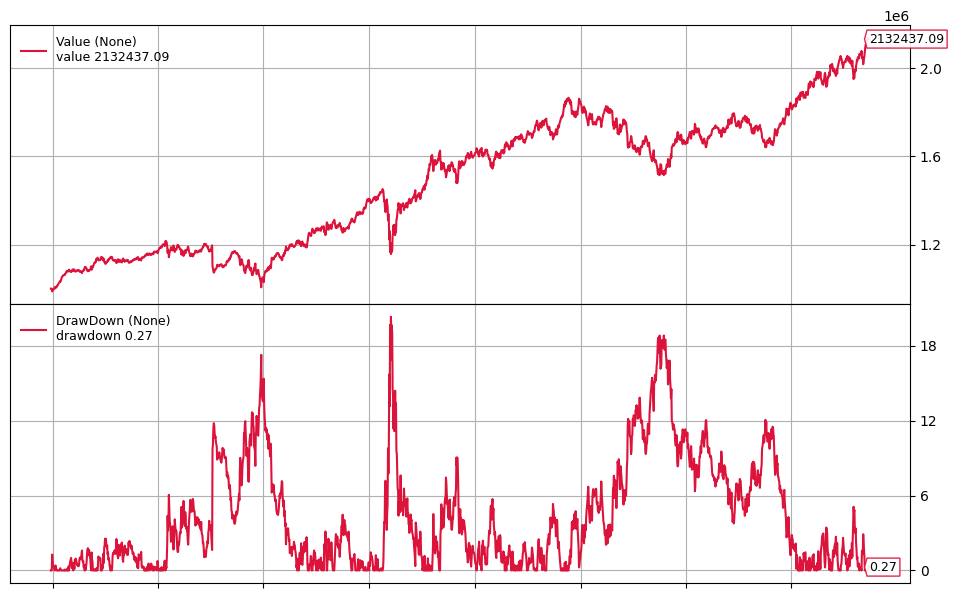

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.0937%
2951 2024-09-24 -0.0565%
2952 2024-09-25 -0.2860%
2953 2024-09-26  0.0737%
2954 2024-09-27 -0.0875%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,0.0000%
Commodity,12.2689%
Communication Services,0.0000%
Consumer Cyclical,2.1306%
Consumer Defensive,20.0000%
Energy,15.6005%
Financial Services,10.0000%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


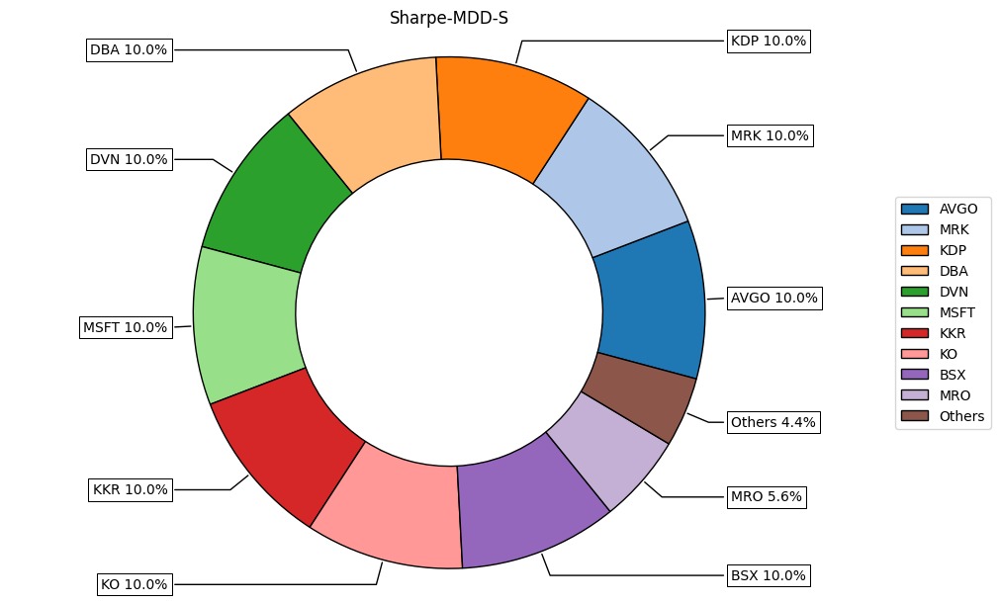

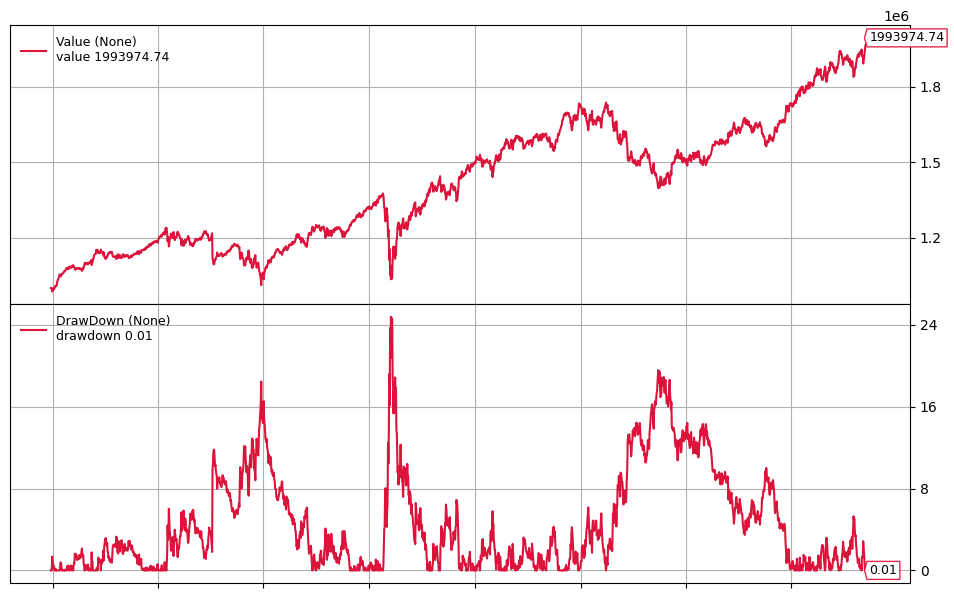

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.3276%
2951 2024-09-24  0.0306%
2952 2024-09-25 -0.0186%
2953 2024-09-26  0.0125%
2954 2024-09-27 -0.2537%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,0.0000%
Commodity,16.0679%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,14.4581%
Financial Services,9.4741%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


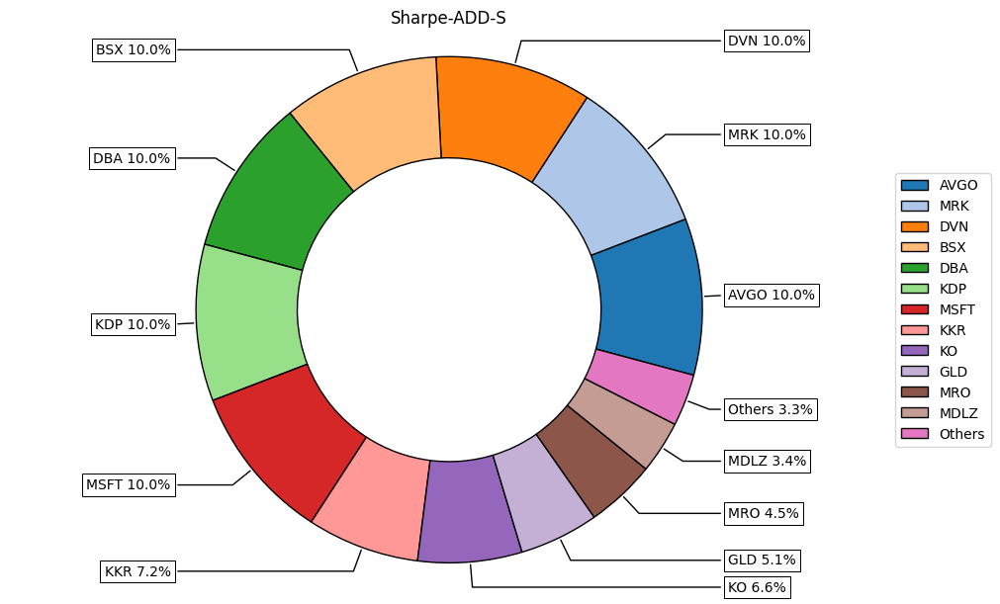

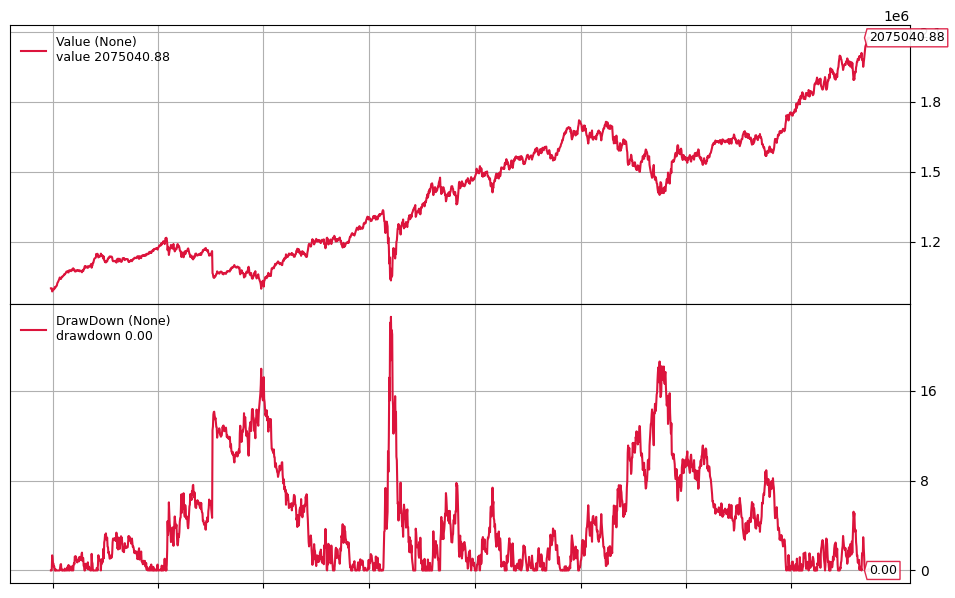

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2573%
2951 2024-09-24  0.0255%
2952 2024-09-25 -0.1458%
2953 2024-09-26  0.1488%
2954 2024-09-27 -0.2611%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,0.0000%
Commodity,15.2177%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,13.5224%
Financial Services,11.2599%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


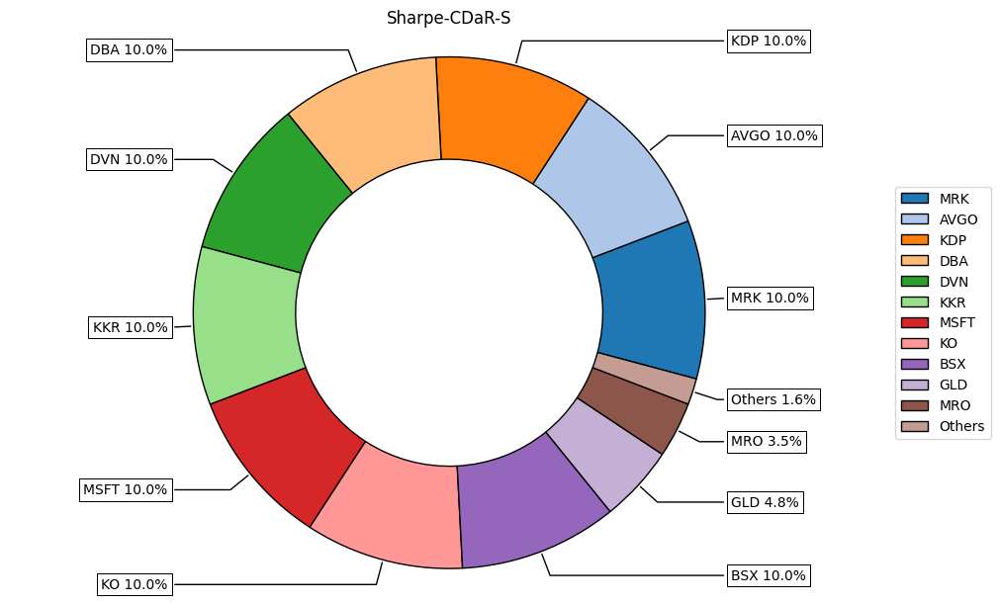

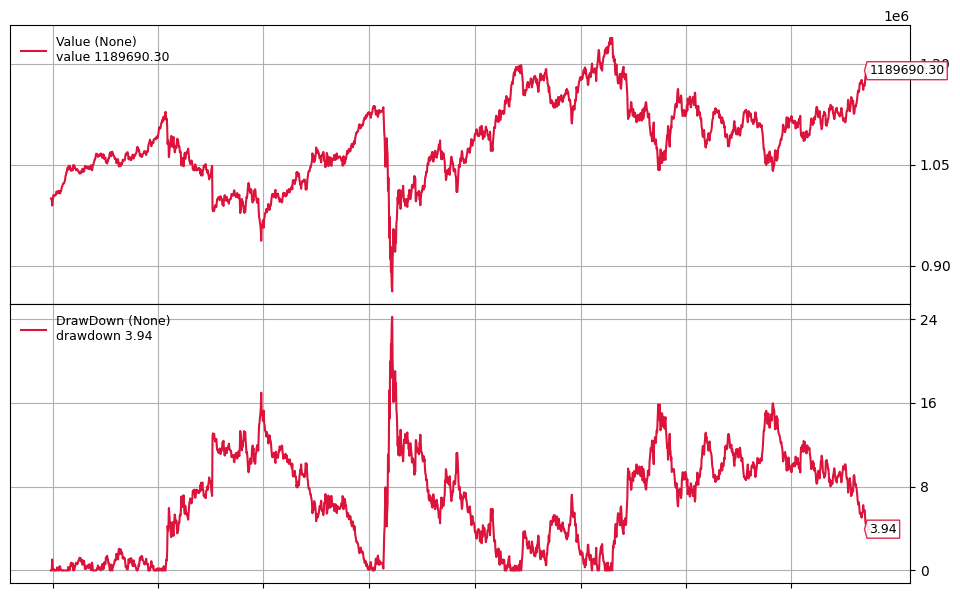

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.3954%
2951 2024-09-24  0.2109%
2952 2024-09-25 -0.4504%
2953 2024-09-26  0.1940%
2954 2024-09-27  0.2422%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,20.0000%
Commodity,20.0000%
Communication Services,3.3738%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,6.4097%
Financial Services,0.0000%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


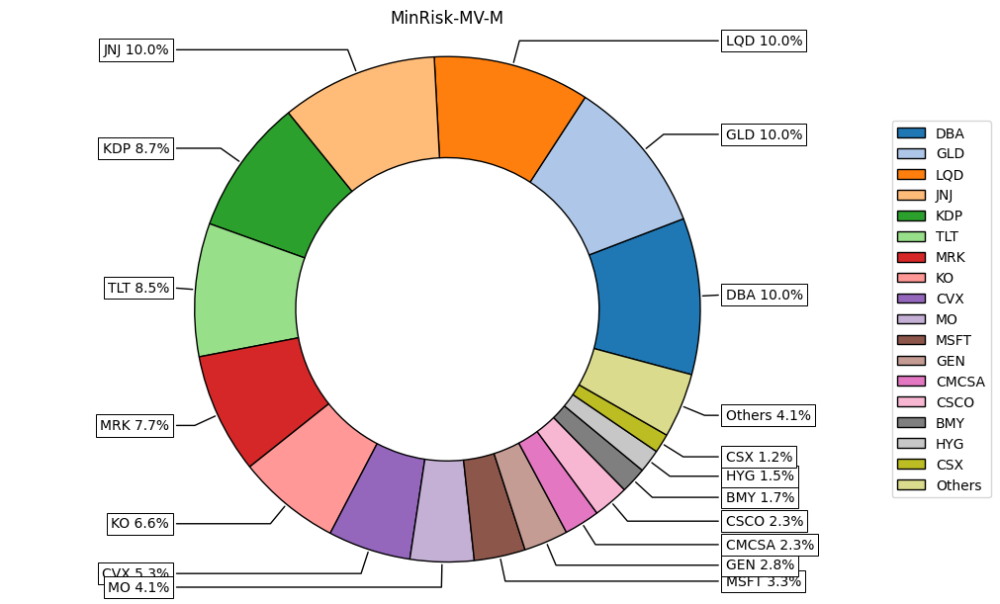

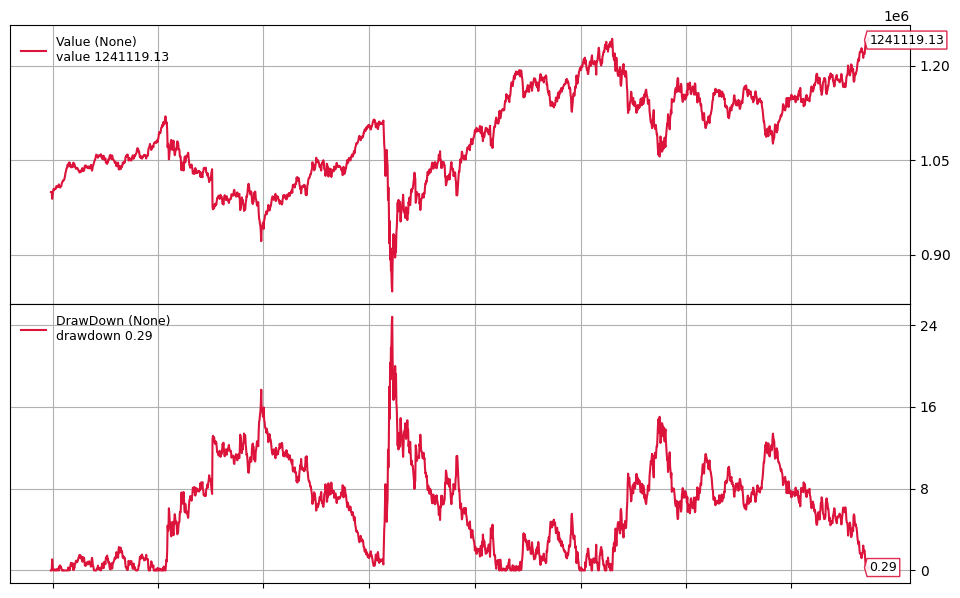

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2647%
2951 2024-09-24  0.1228%
2952 2024-09-25 -0.3718%
2953 2024-09-26  0.0854%
2954 2024-09-27  0.2511%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,20.0000%
Commodity,20.0000%
Communication Services,1.6715%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,6.5342%
Financial Services,2.0846%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


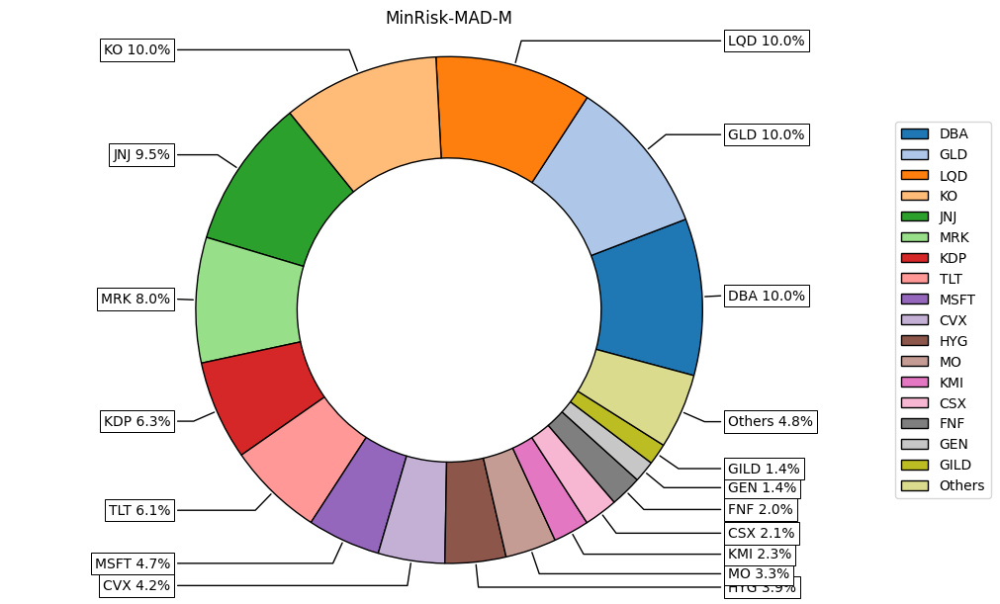

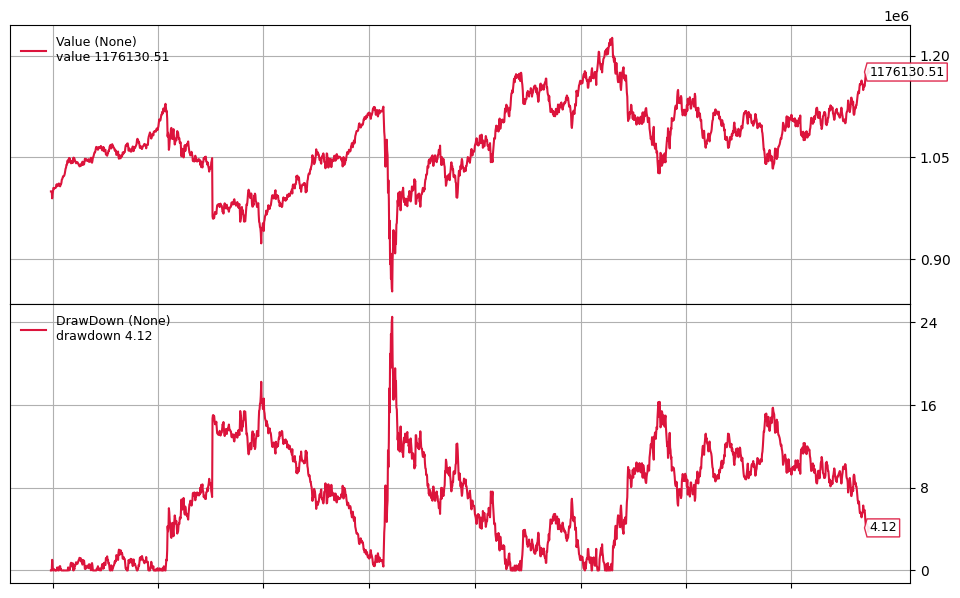

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.3626%
2951 2024-09-24  0.2232%
2952 2024-09-25 -0.4837%
2953 2024-09-26  0.0944%
2954 2024-09-27  0.2819%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,20.0000%
Commodity,20.0000%
Communication Services,2.7111%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,6.3376%
Financial Services,0.0000%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


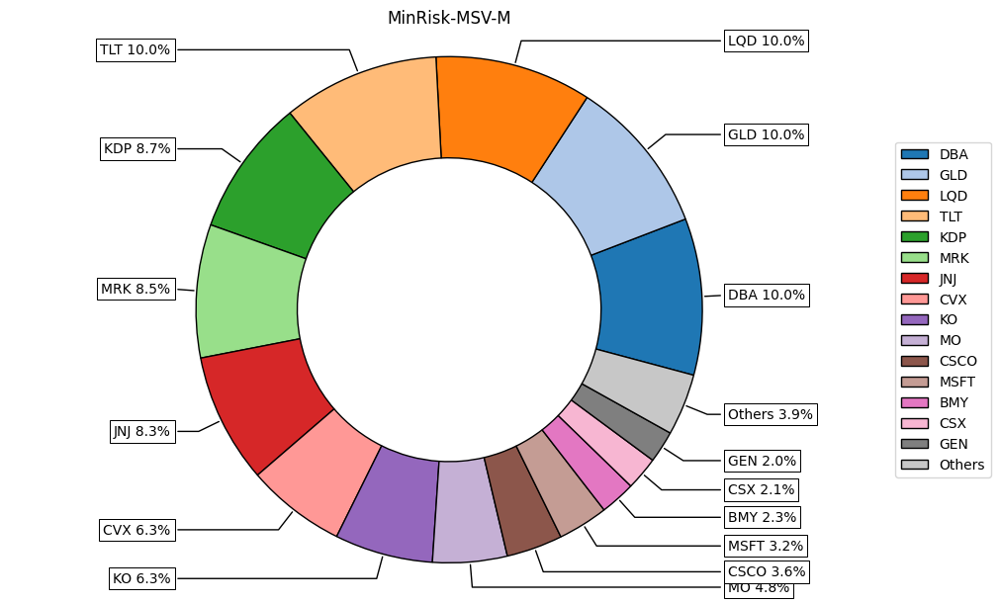

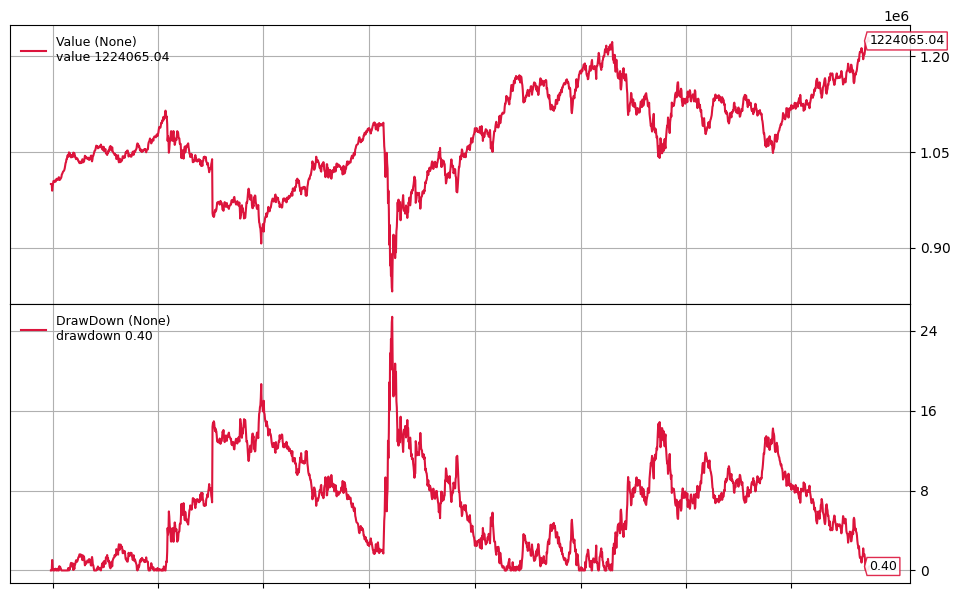

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2734%
2951 2024-09-24  0.0809%
2952 2024-09-25 -0.3721%
2953 2024-09-26 -0.0282%
2954 2024-09-27  0.2047%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,20.0000%
Commodity,20.0000%
Communication Services,0.0484%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,8.3844%
Financial Services,2.1409%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


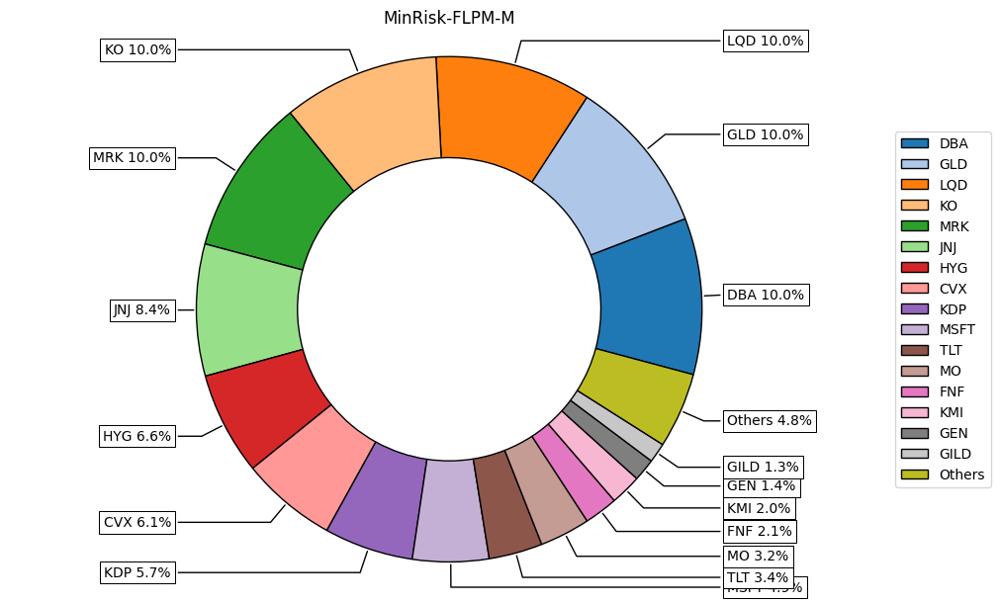

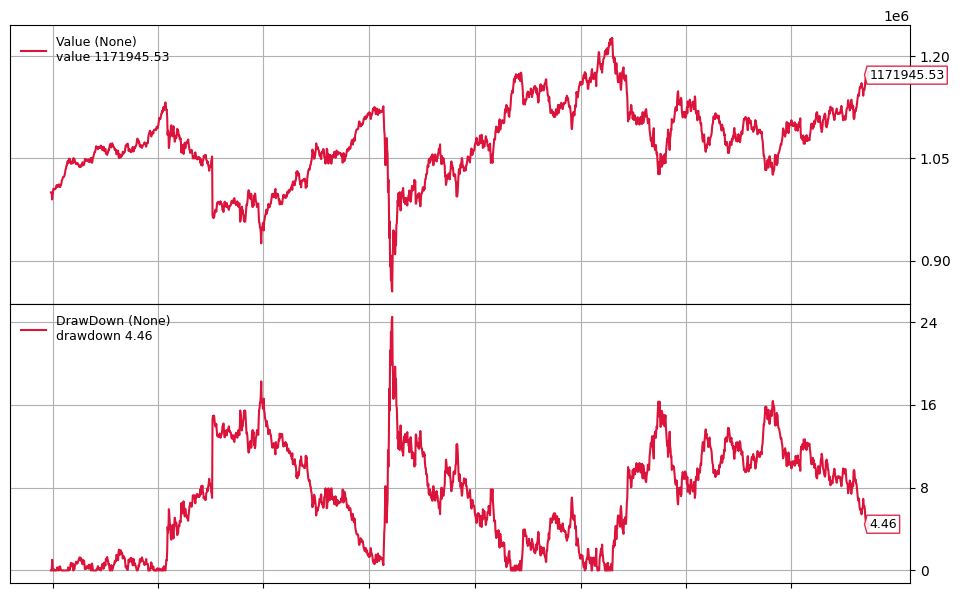

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.3591%
2951 2024-09-24  0.1888%
2952 2024-09-25 -0.4481%
2953 2024-09-26  0.0446%
2954 2024-09-27  0.2164%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,20.0000%
Commodity,20.0000%
Communication Services,0.9582%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,7.1211%
Financial Services,0.3727%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


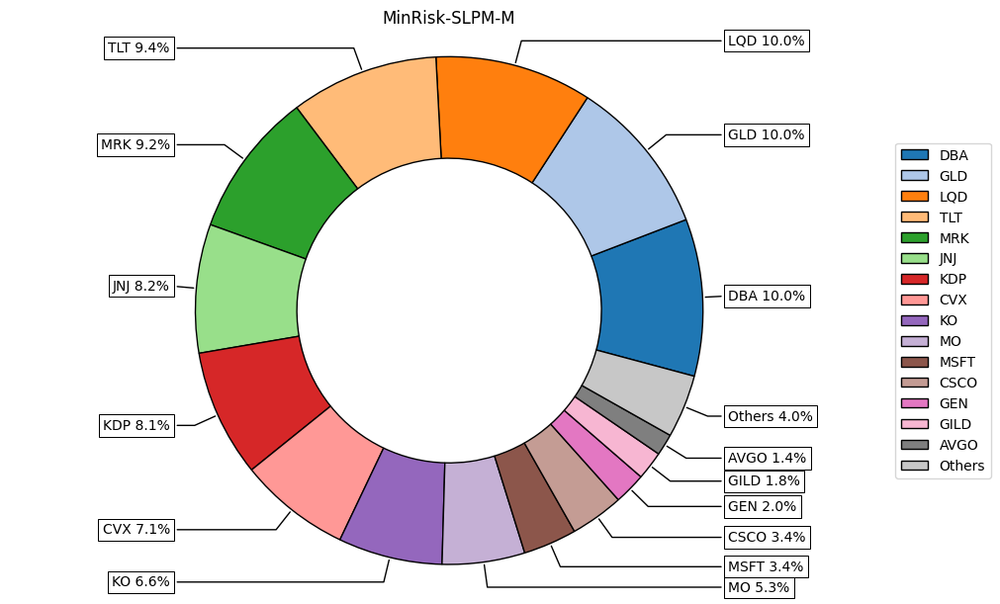

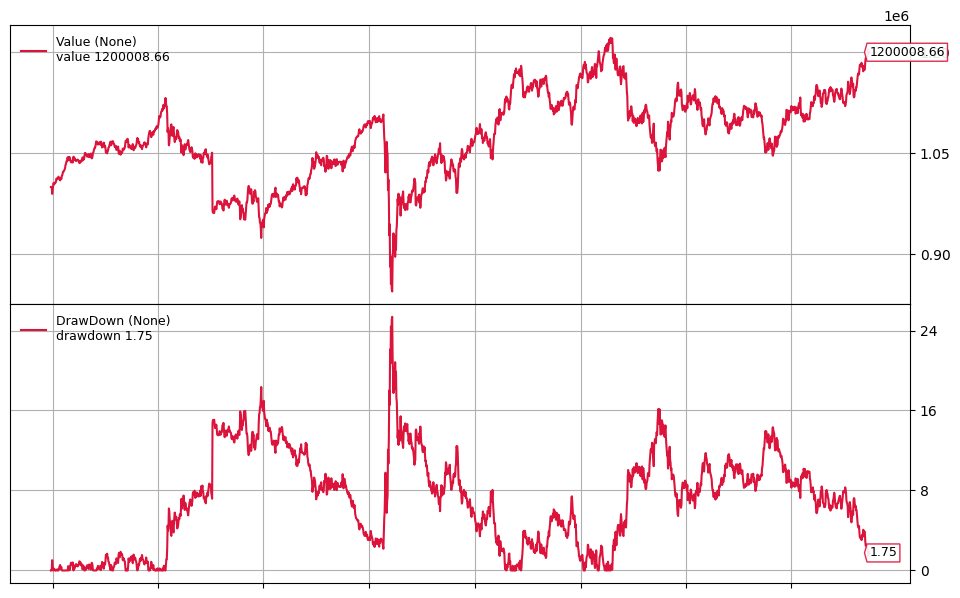

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.5201%
2951 2024-09-24  0.3456%
2952 2024-09-25 -0.4820%
2953 2024-09-26  0.1642%
2954 2024-09-27  0.2356%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,20.0000%
Commodity,20.0000%
Communication Services,5.5589%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,5.6631%
Financial Services,0.9929%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


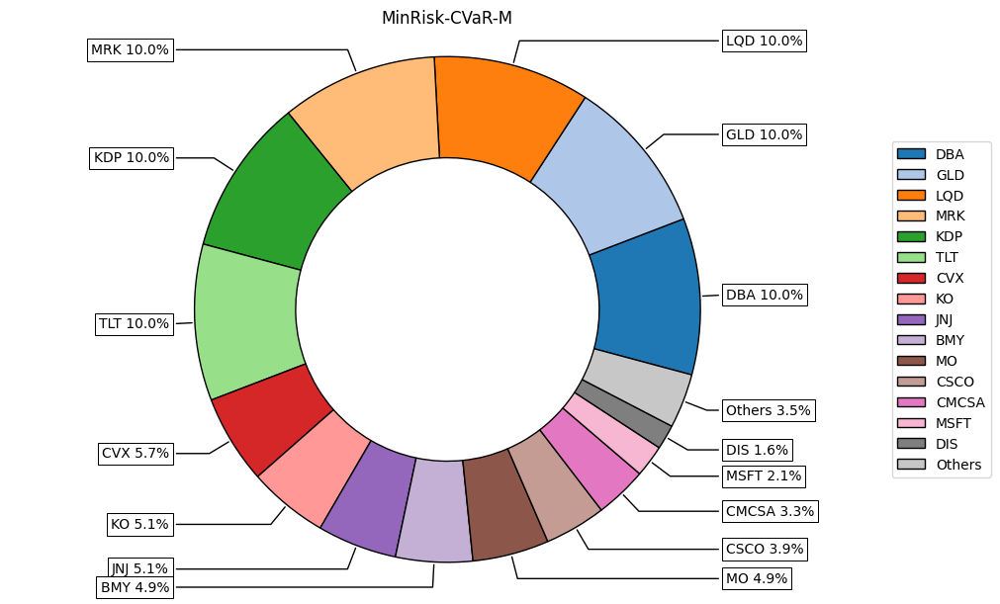

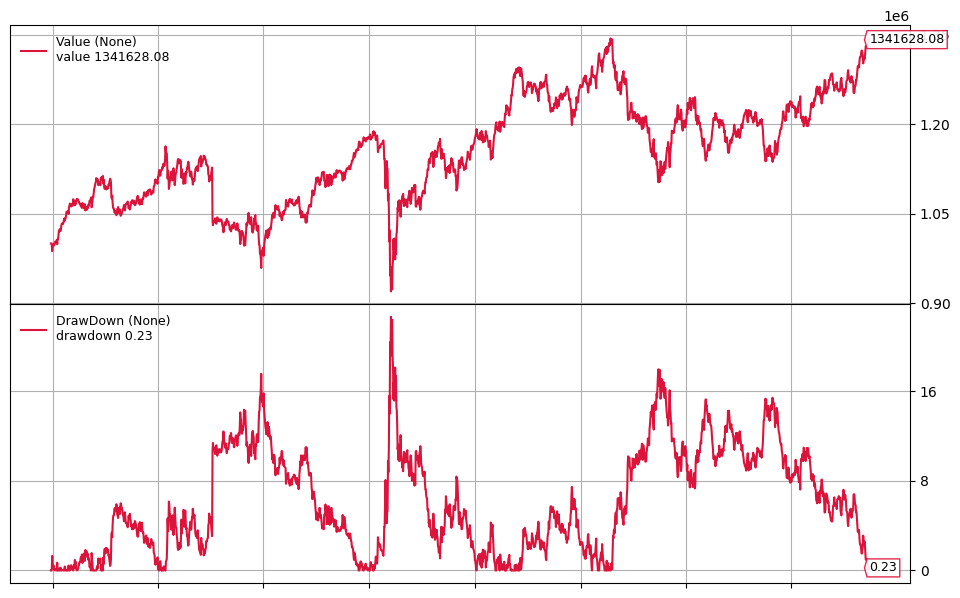

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.3241%
2951 2024-09-24  0.3392%
2952 2024-09-25 -0.4092%
2953 2024-09-26  0.1818%
2954 2024-09-27  0.0272%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,4.8520%
Bond,20.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,0.0000%
Financial Services,9.3715%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


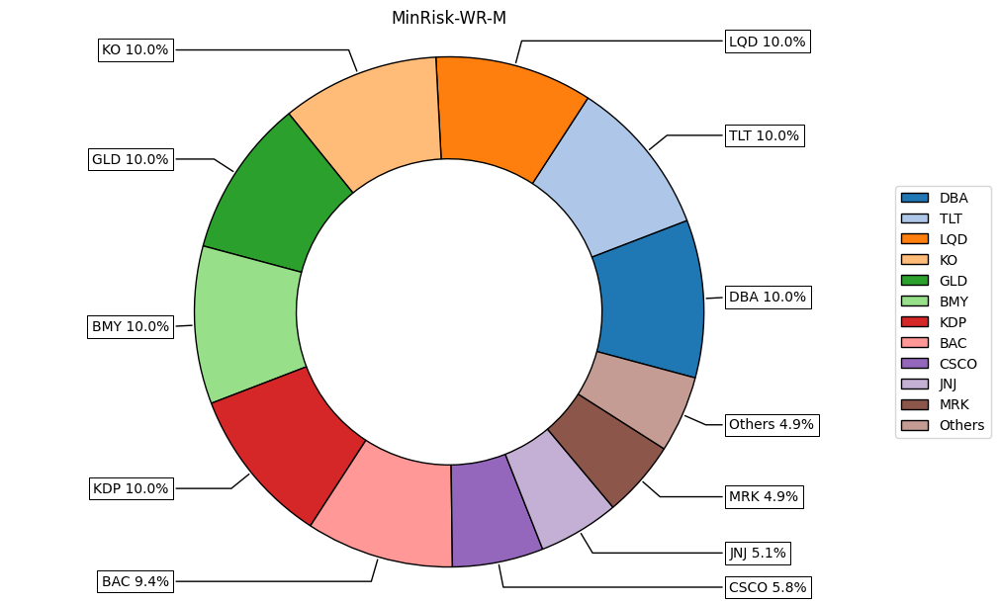

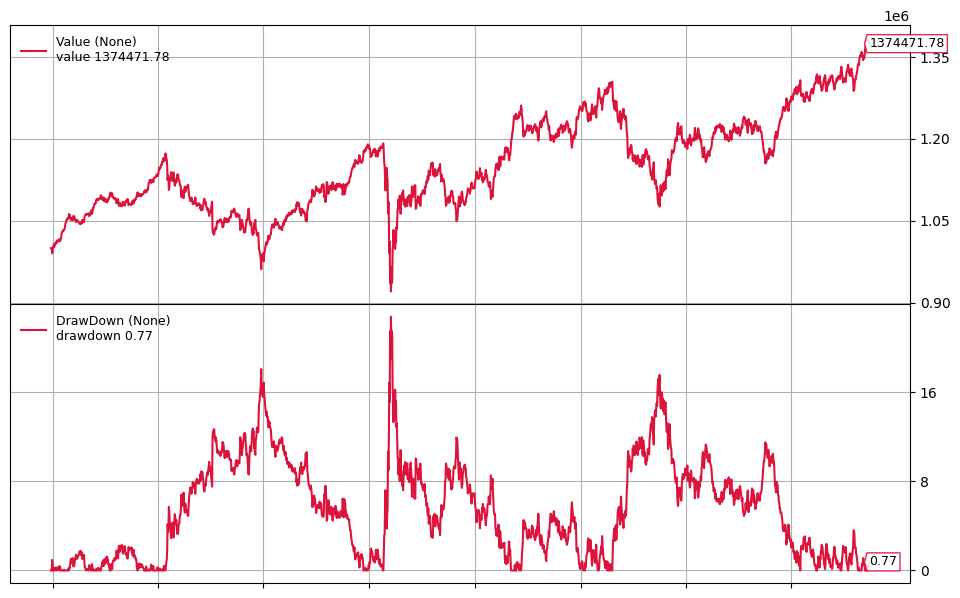

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.1694%
2951 2024-09-24  0.0211%
2952 2024-09-25 -0.6492%
2953 2024-09-26 -0.1231%
2954 2024-09-27  0.3175%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,20.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,5.5249%
Consumer Defensive,20.0000%
Energy,13.2674%
Financial Services,1.2077%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


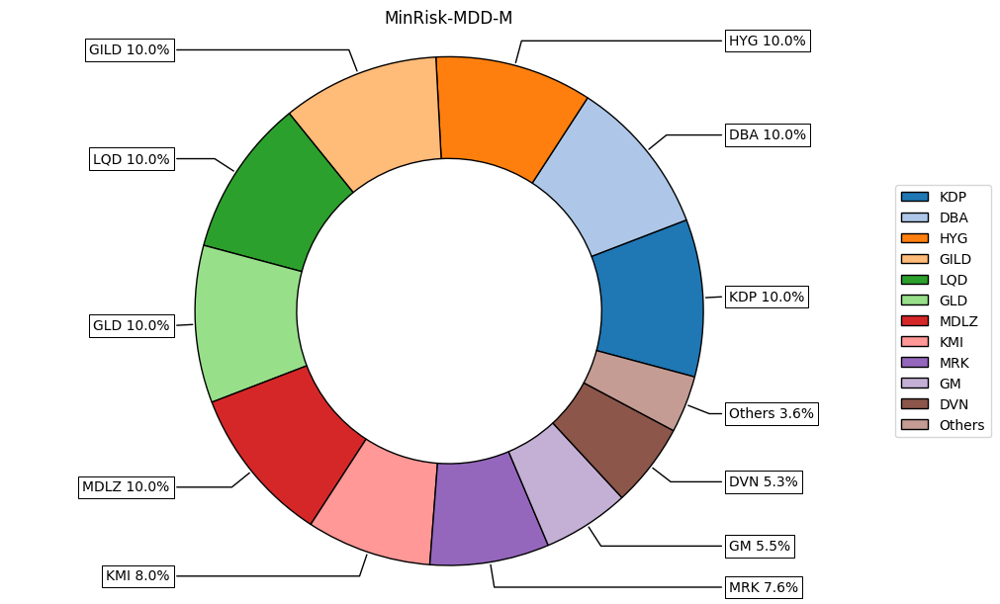

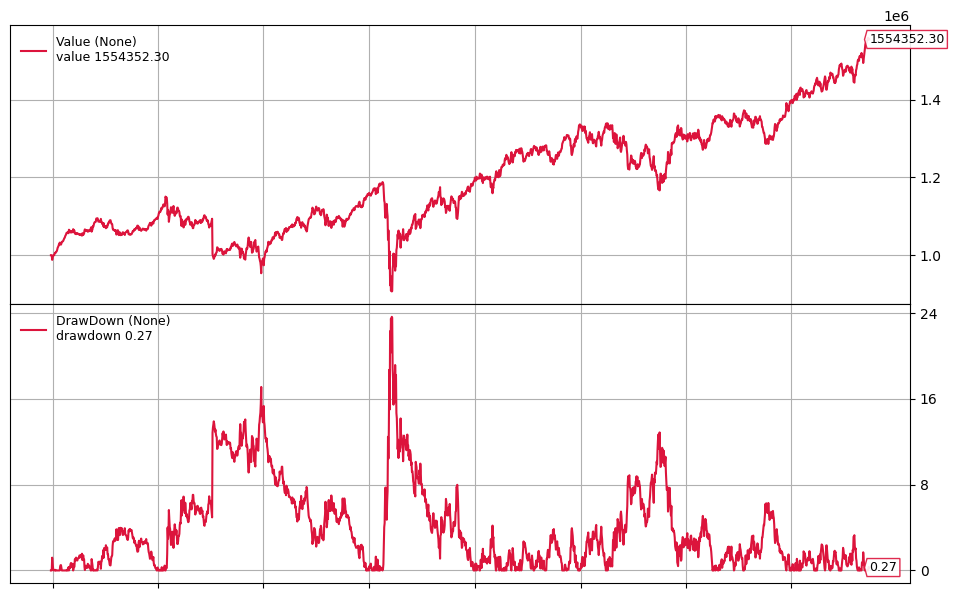

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2947%
2951 2024-09-24 -0.0229%
2952 2024-09-25 -0.3075%
2953 2024-09-26  0.0577%
2954 2024-09-27 -0.0916%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,20.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,5.1681%
Financial Services,0.1023%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


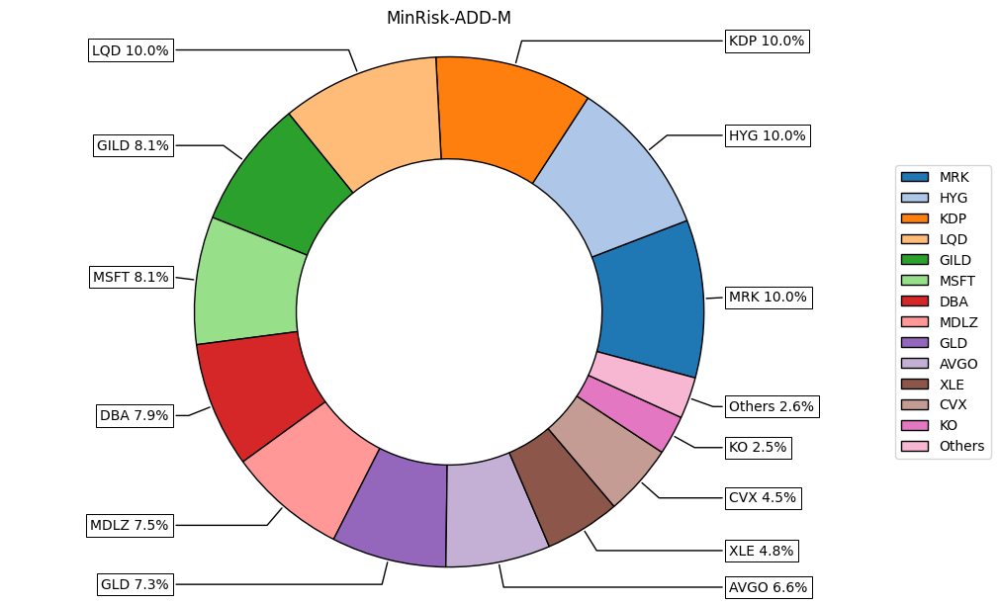

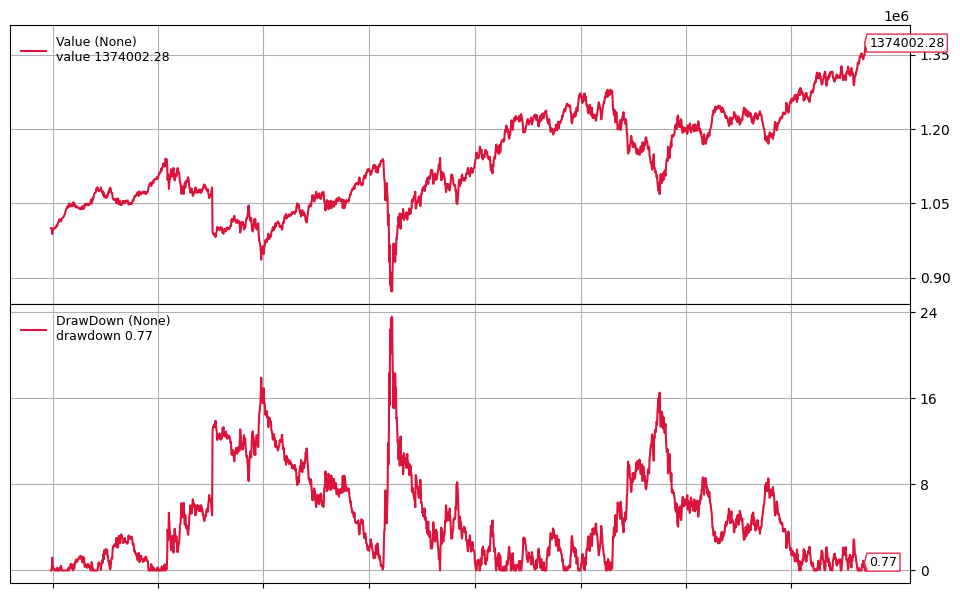

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2892%
2951 2024-09-24 -0.0212%
2952 2024-09-25 -0.5222%
2953 2024-09-26 -0.2277%
2954 2024-09-27  0.2365%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,20.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,5.7890%
Financial Services,7.5987%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


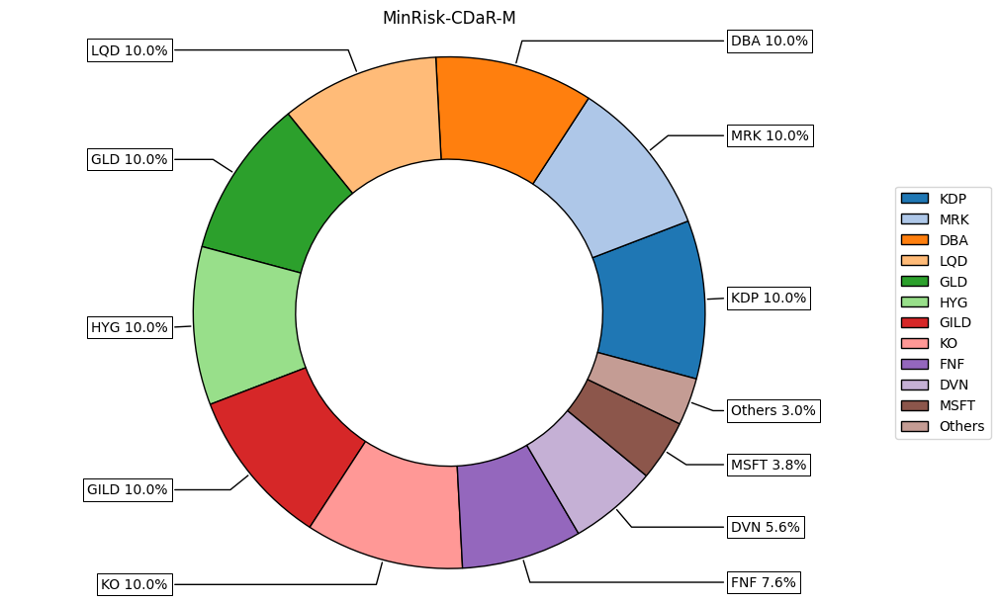

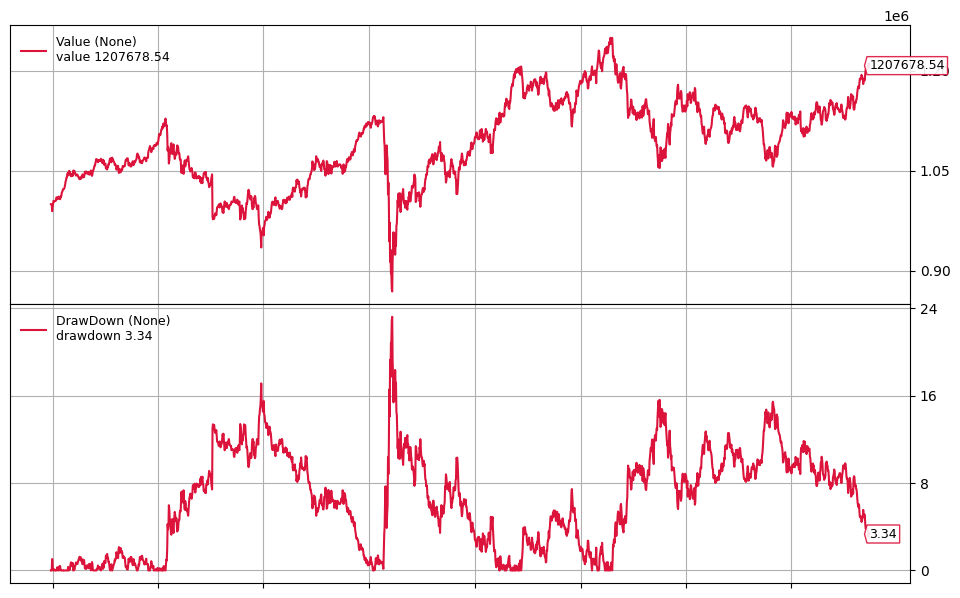

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.4203%
2951 2024-09-24  0.2721%
2952 2024-09-25 -0.5059%
2953 2024-09-26  0.2129%
2954 2024-09-27  0.1860%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,20.0000%
Commodity,20.0000%
Communication Services,3.3738%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,6.4097%
Financial Services,0.0000%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


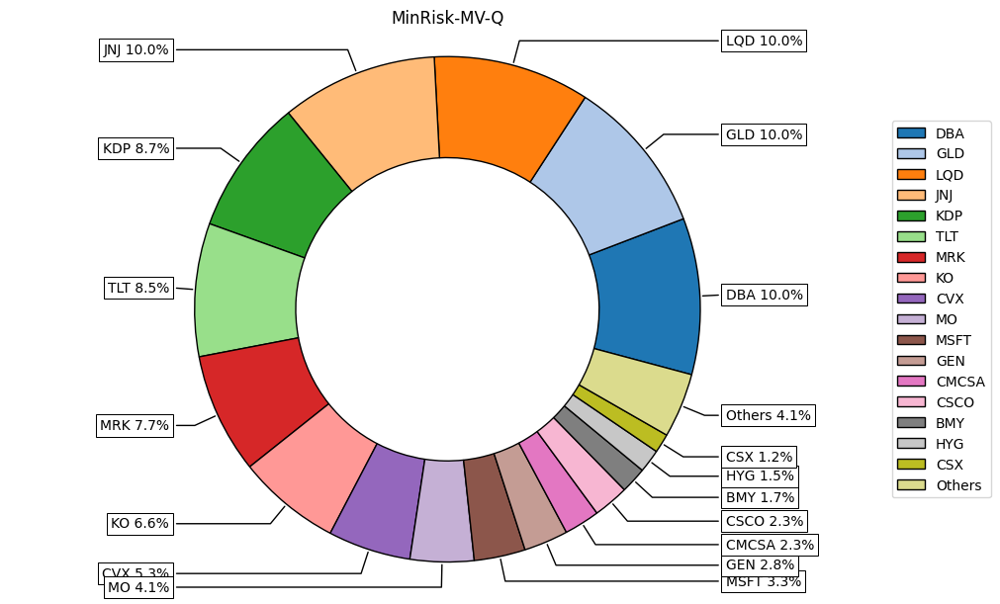

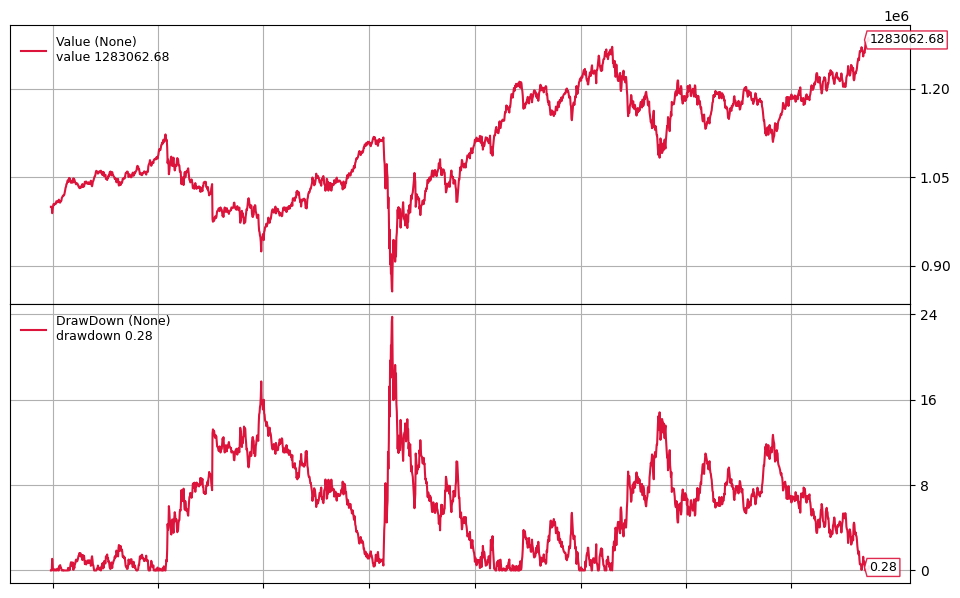

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2780%
2951 2024-09-24  0.1613%
2952 2024-09-25 -0.4127%
2953 2024-09-26  0.1308%
2954 2024-09-27  0.2086%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,20.0000%
Commodity,20.0000%
Communication Services,1.6715%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,6.5342%
Financial Services,2.0846%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


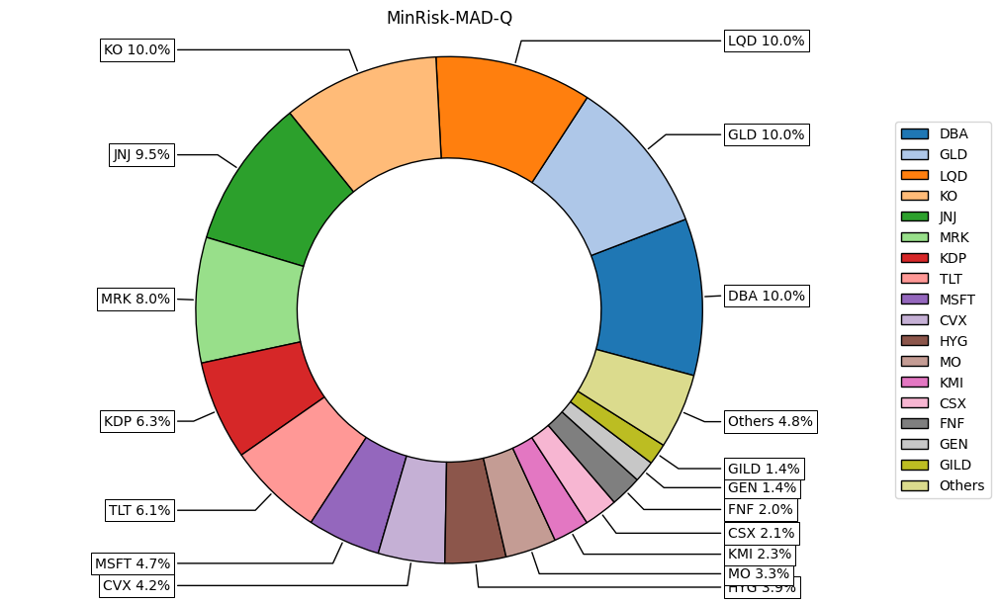

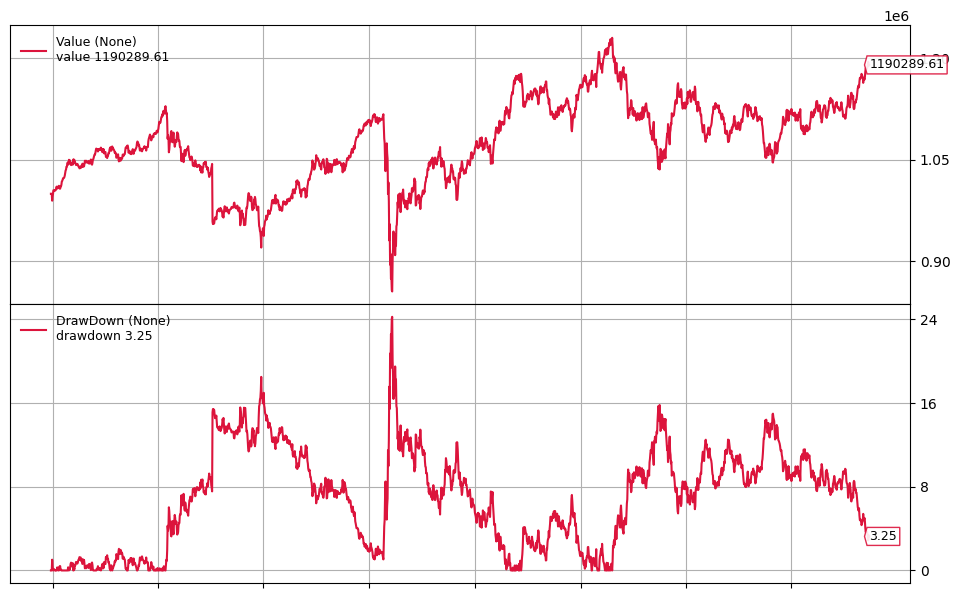

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.3878%
2951 2024-09-24  0.2728%
2952 2024-09-25 -0.5062%
2953 2024-09-26  0.1203%
2954 2024-09-27  0.2360%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,20.0000%
Commodity,20.0000%
Communication Services,2.7111%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,6.3376%
Financial Services,0.0000%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


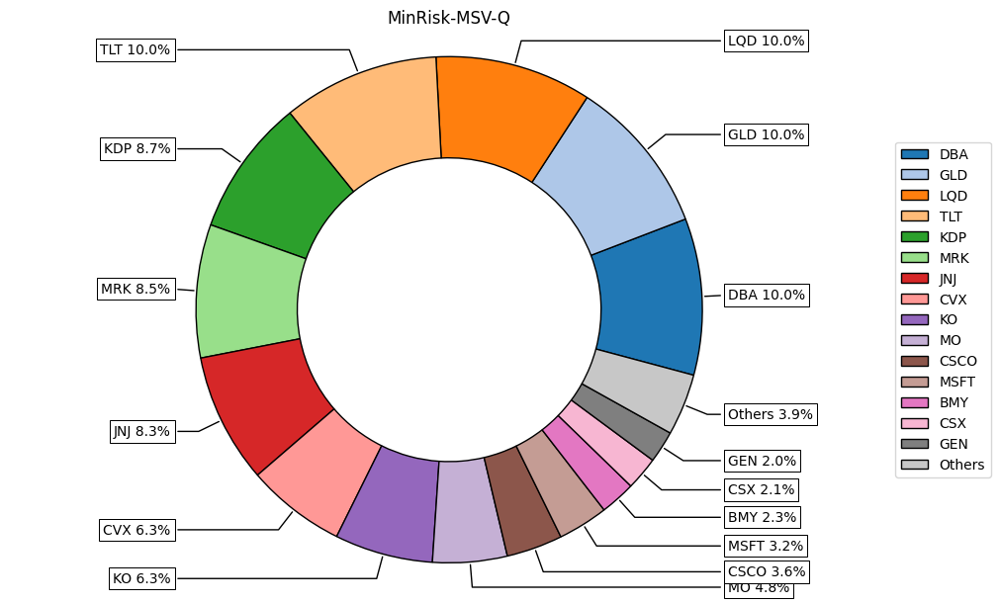

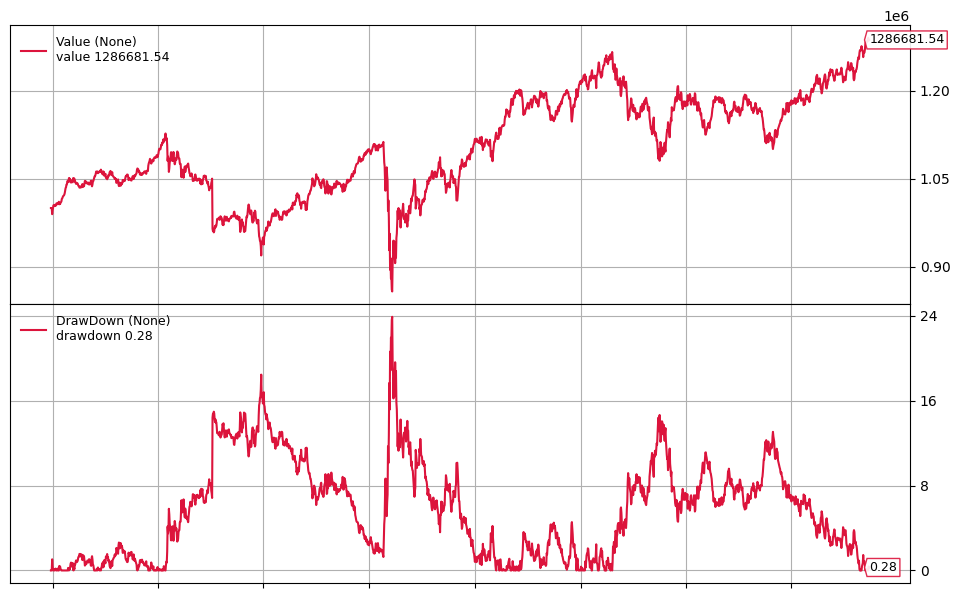

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2425%
2951 2024-09-24  0.1076%
2952 2024-09-25 -0.3736%
2953 2024-09-26  0.0933%
2954 2024-09-27  0.1309%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,20.0000%
Commodity,20.0000%
Communication Services,0.0484%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,8.3844%
Financial Services,2.1409%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


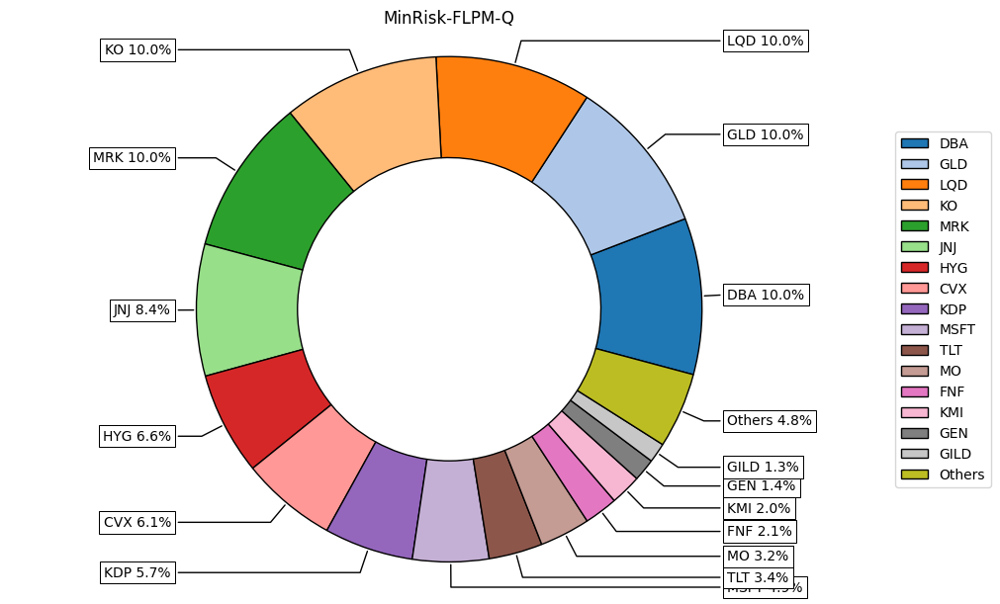

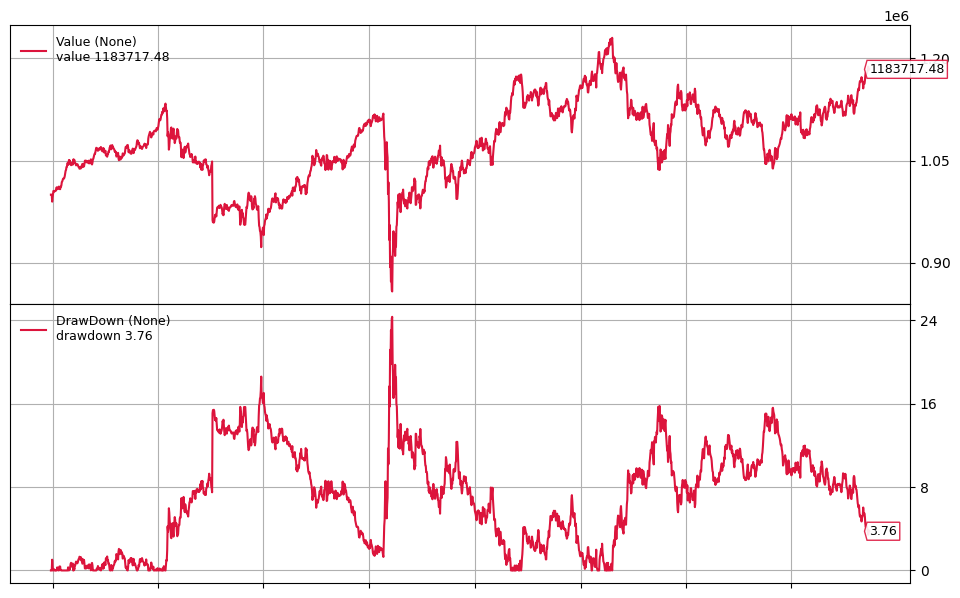

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.3616%
2951 2024-09-24  0.2122%
2952 2024-09-25 -0.4451%
2953 2024-09-26  0.1090%
2954 2024-09-27  0.1600%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,20.0000%
Commodity,20.0000%
Communication Services,0.9582%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,7.1211%
Financial Services,0.3727%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


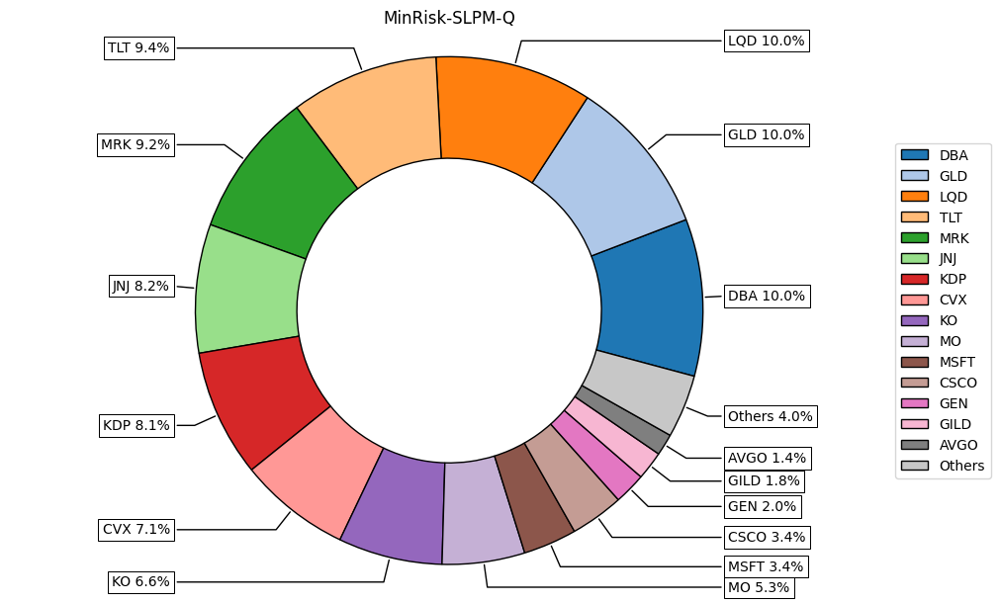

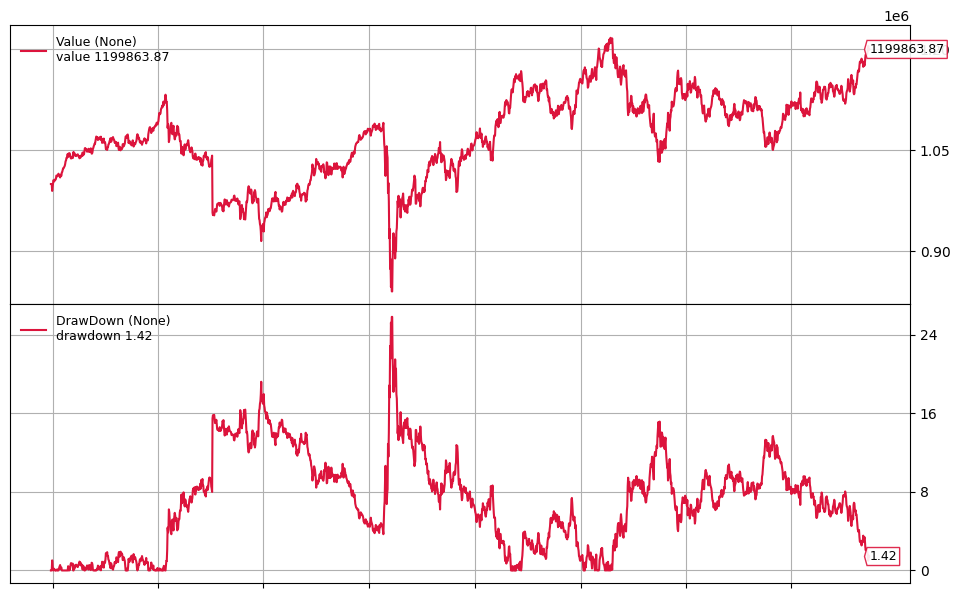

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.5330%
2951 2024-09-24  0.3363%
2952 2024-09-25 -0.5343%
2953 2024-09-26  0.1053%
2954 2024-09-27  0.1395%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,20.0000%
Commodity,20.0000%
Communication Services,5.5589%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,5.6631%
Financial Services,0.9929%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


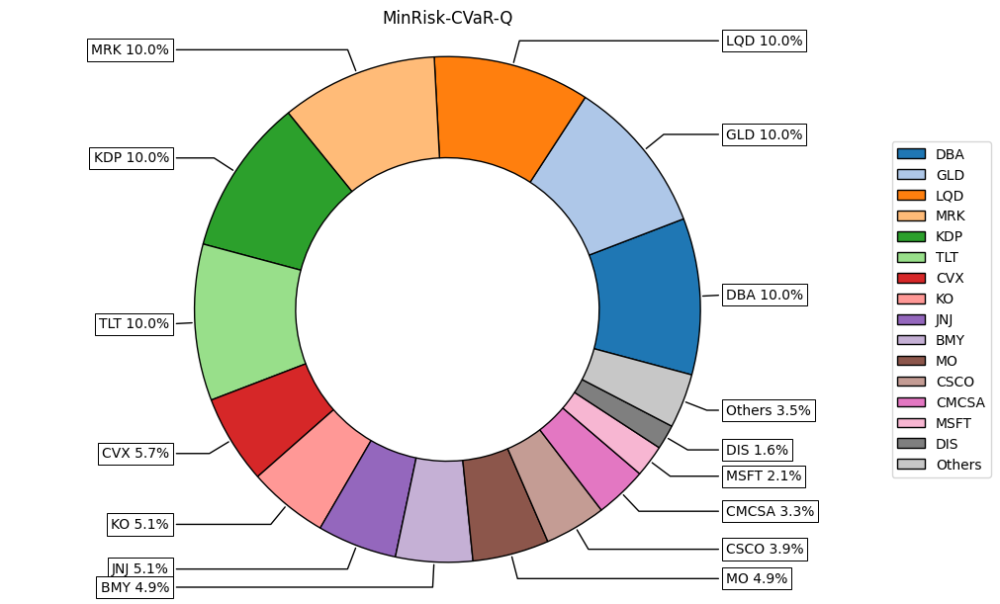

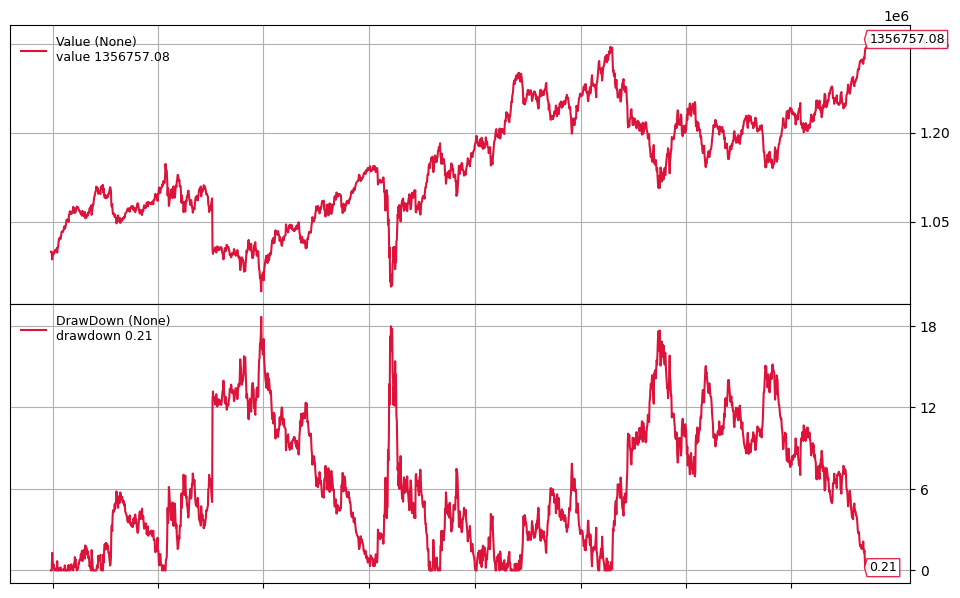

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.4130%
2951 2024-09-24  0.3945%
2952 2024-09-25 -0.5196%
2953 2024-09-26  0.3156%
2954 2024-09-27 -0.7938%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,4.8520%
Bond,20.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,0.0000%
Financial Services,9.3715%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


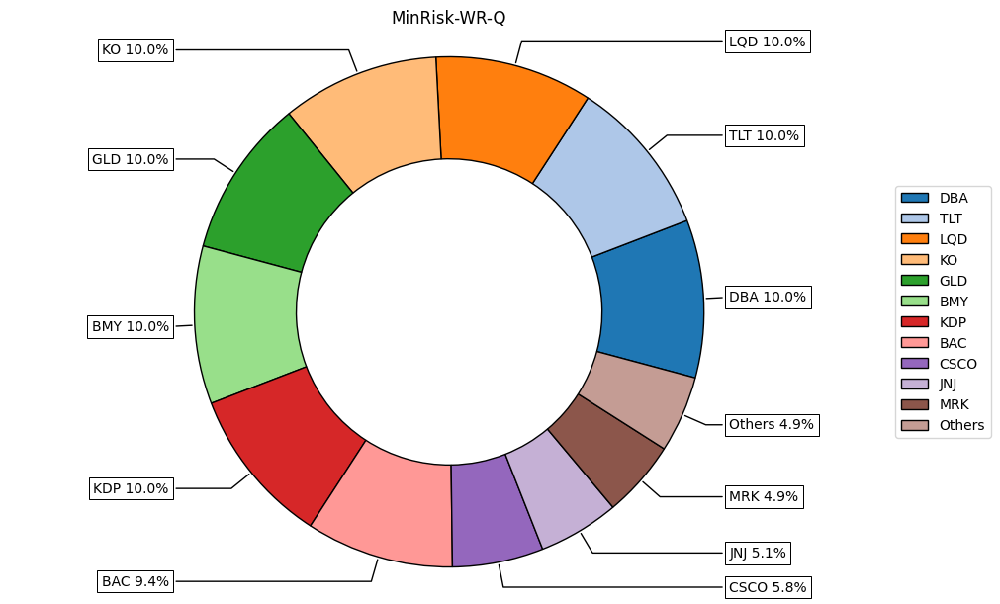

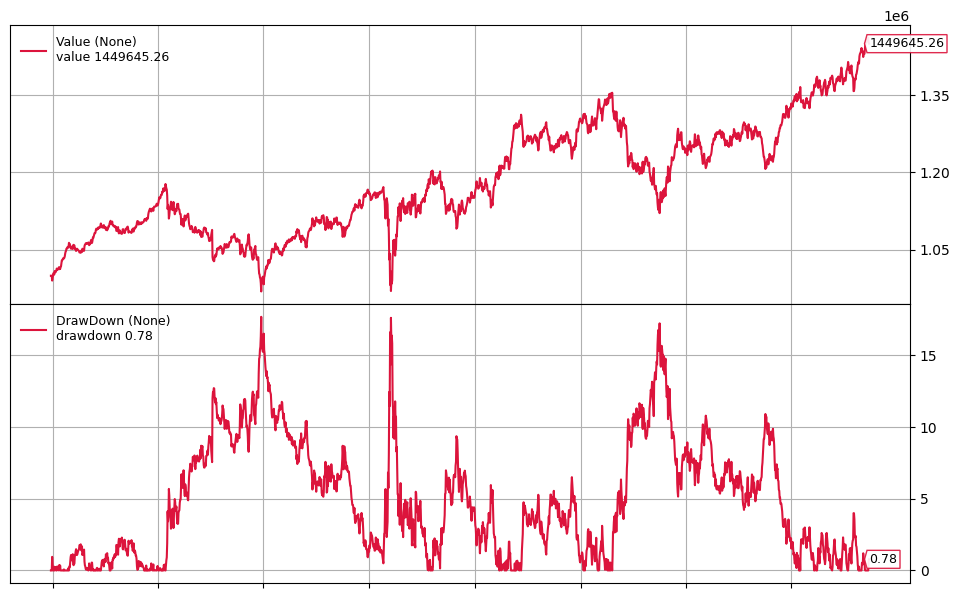

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2296%
2951 2024-09-24  0.0427%
2952 2024-09-25 -0.6590%
2953 2024-09-26 -0.1170%
2954 2024-09-27  0.2716%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,20.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,5.5249%
Consumer Defensive,20.0000%
Energy,13.2674%
Financial Services,1.2077%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


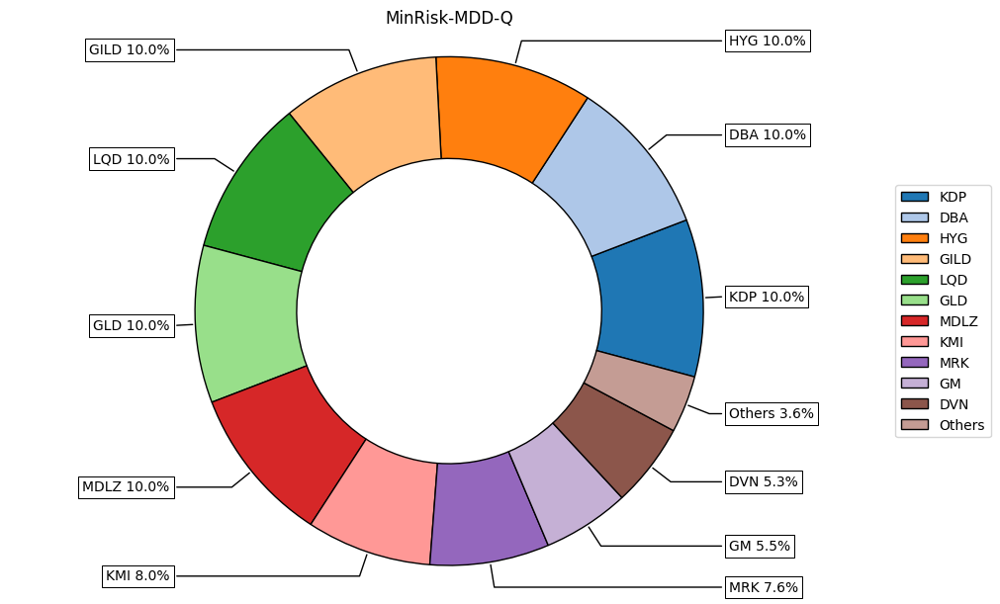

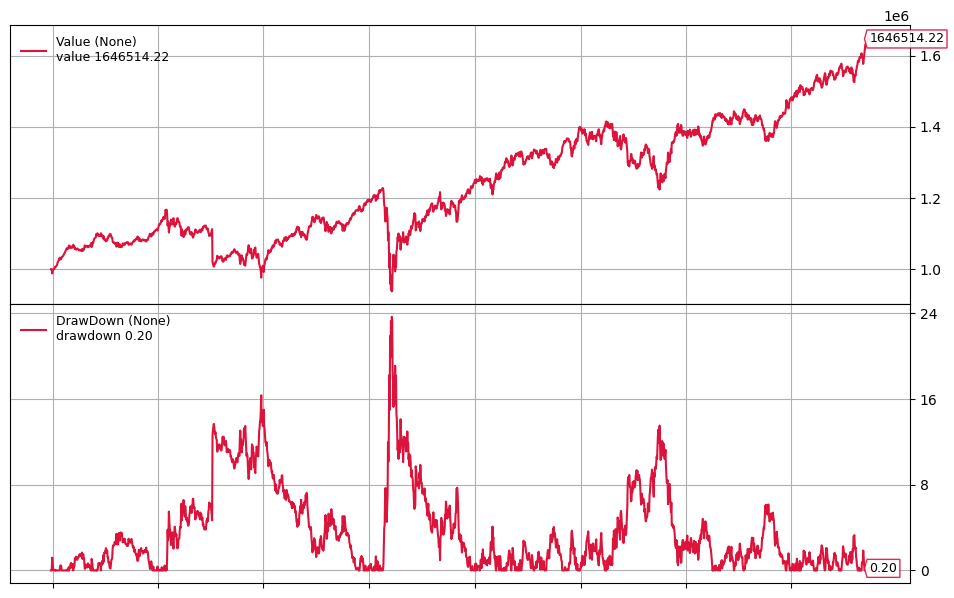

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.3672%
2951 2024-09-24  0.0138%
2952 2024-09-25 -0.3016%
2953 2024-09-26  0.1060%
2954 2024-09-27 -0.1986%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,20.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,5.1681%
Financial Services,0.1023%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


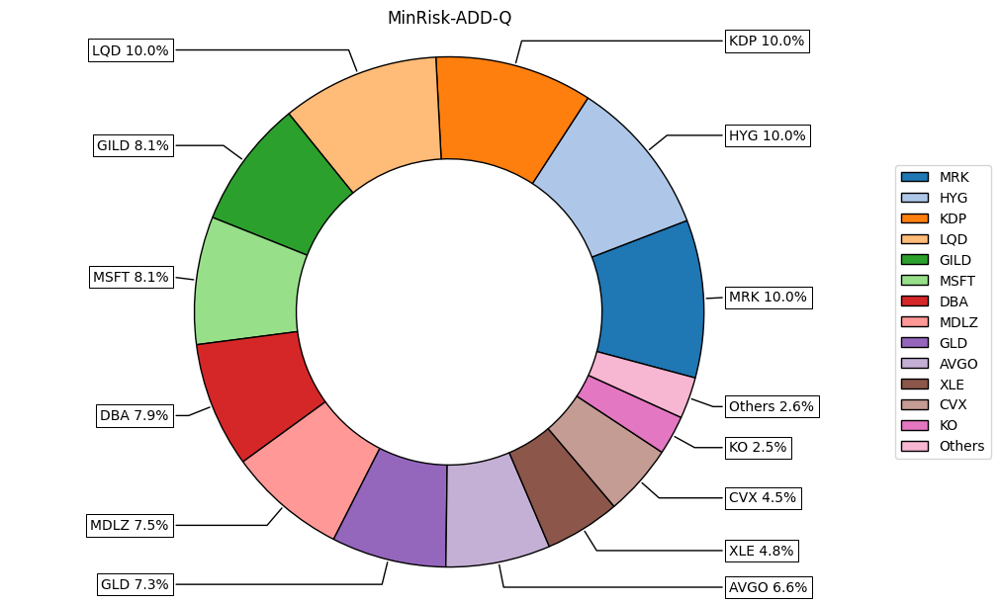

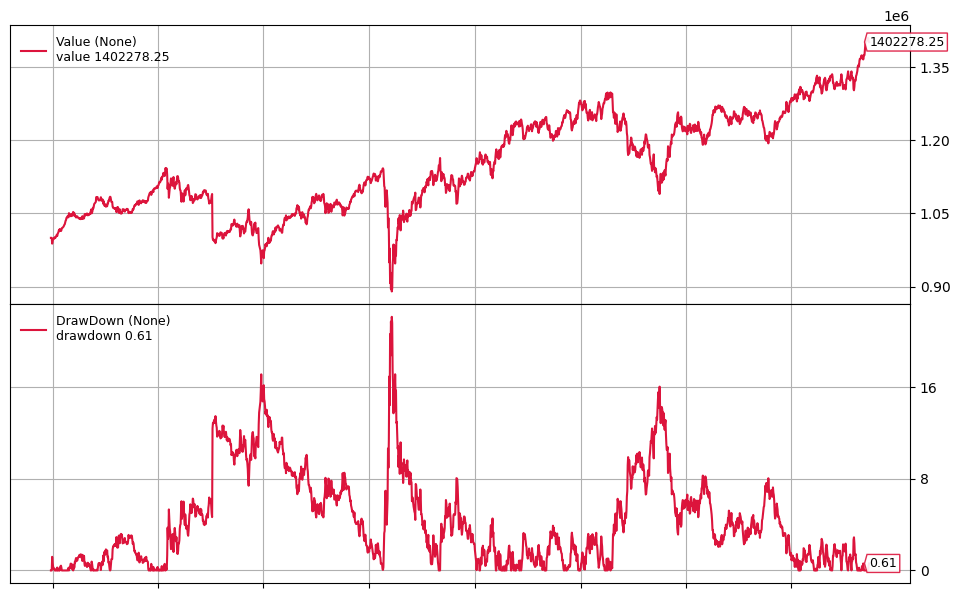

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2869%
2951 2024-09-24 -0.0517%
2952 2024-09-25 -0.4110%
2953 2024-09-26 -0.1513%
2954 2024-09-27  0.2205%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,20.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,5.7890%
Financial Services,7.5987%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


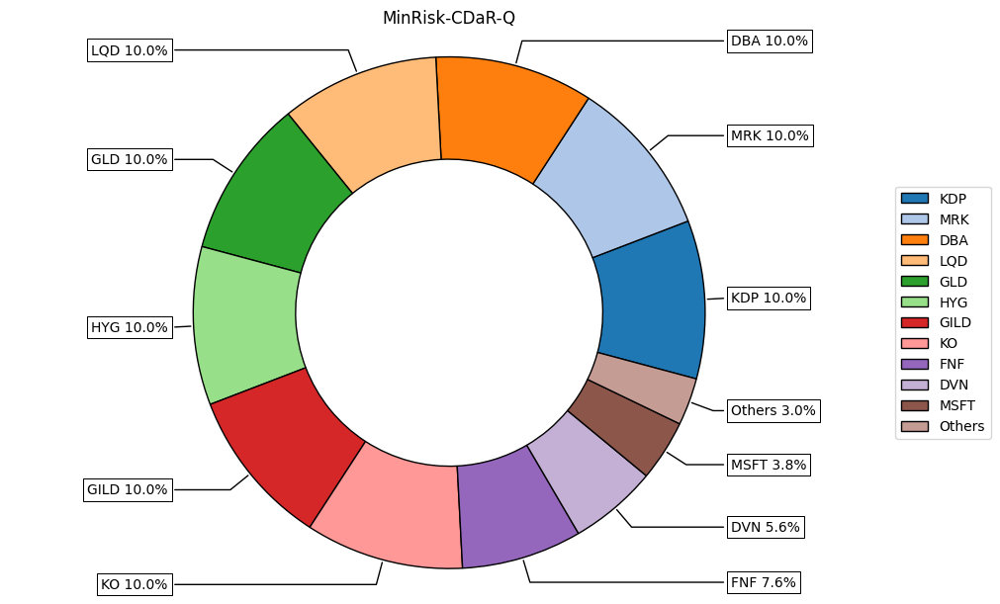

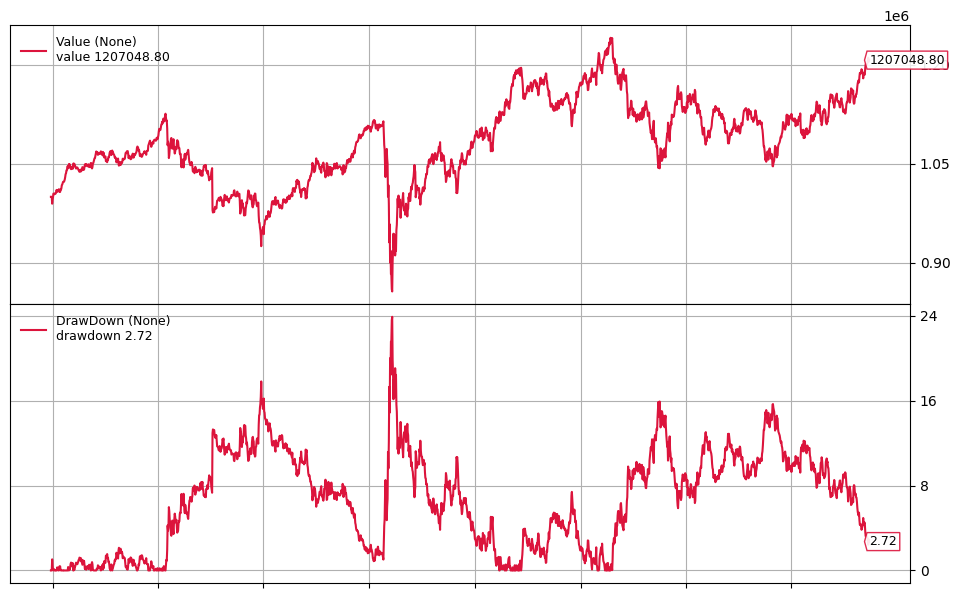

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.4212%
2951 2024-09-24  0.2731%
2952 2024-09-25 -0.5069%
2953 2024-09-26  0.2134%
2954 2024-09-27  0.2893%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,20.0000%
Commodity,20.0000%
Communication Services,4.1709%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,5.0950%
Financial Services,0.3891%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


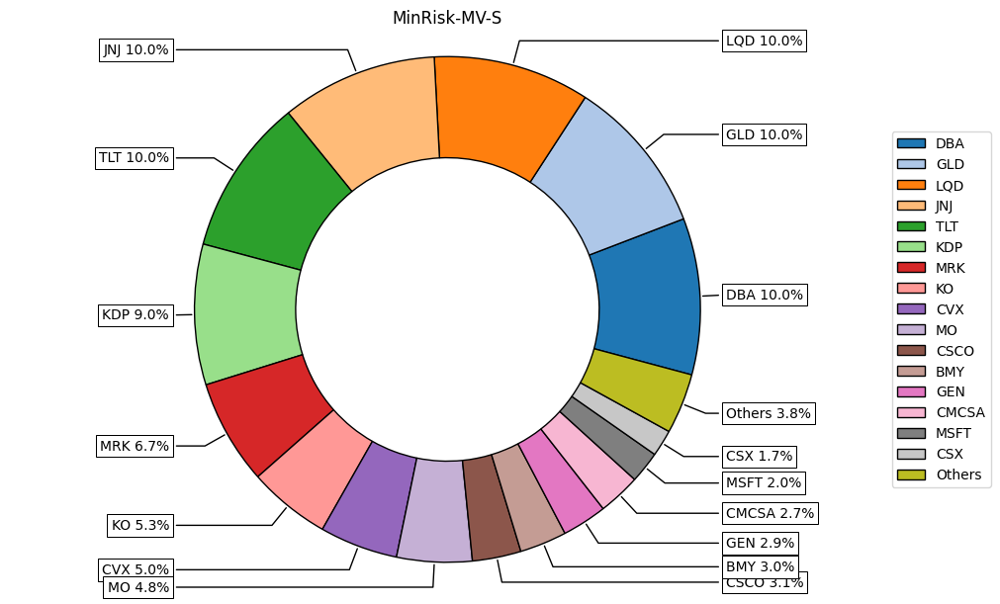

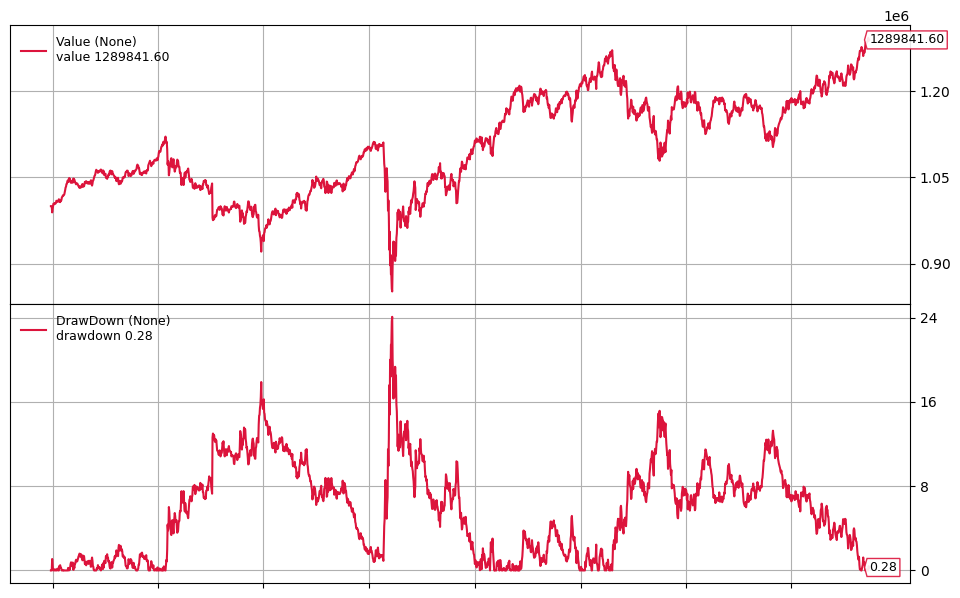

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2778%
2951 2024-09-24  0.1613%
2952 2024-09-25 -0.4124%
2953 2024-09-26  0.1306%
2954 2024-09-27  0.3391%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,20.0000%
Commodity,20.0000%
Communication Services,1.3748%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,5.3796%
Financial Services,2.0642%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


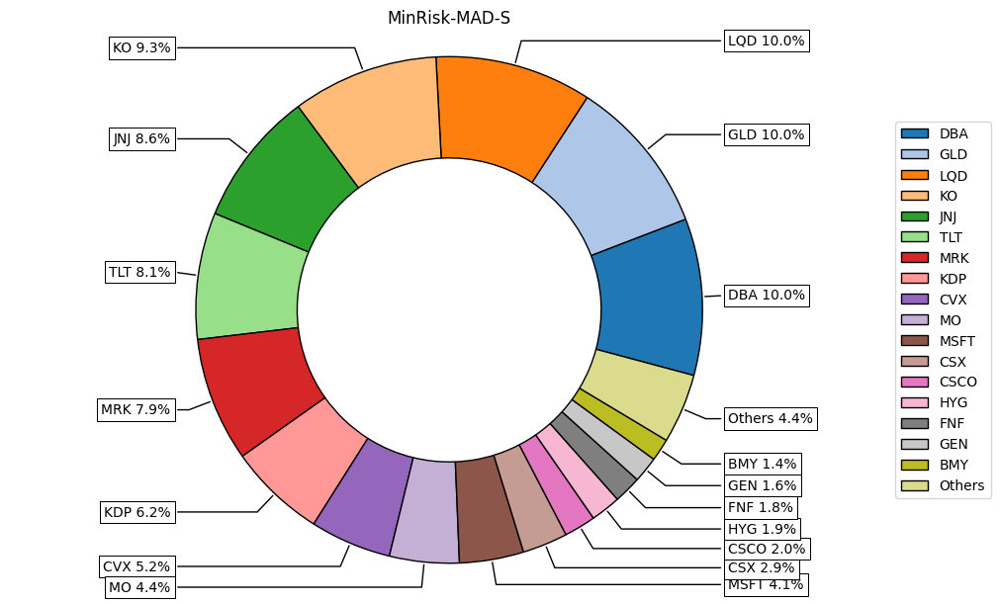

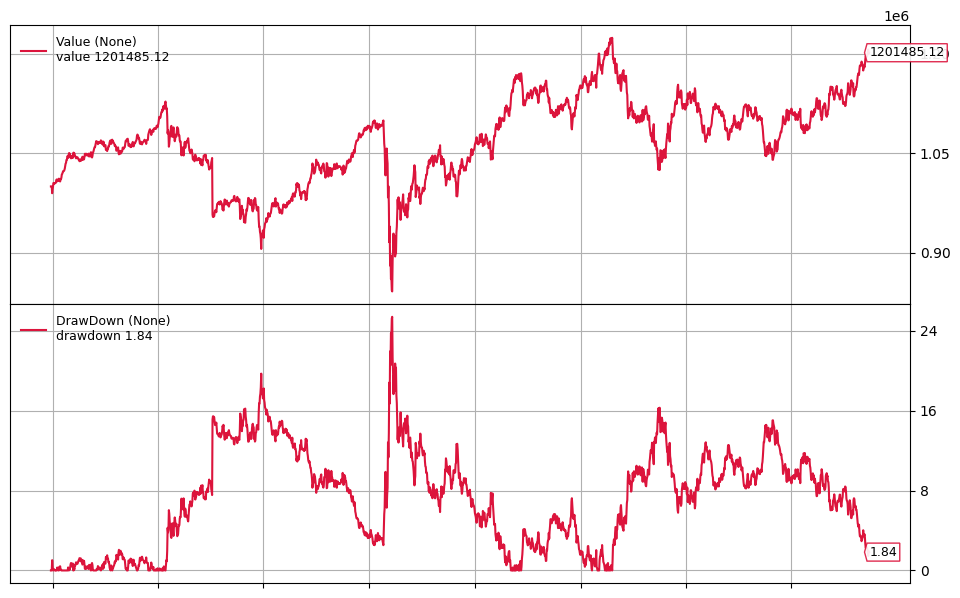

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.3882%
2951 2024-09-24  0.2734%
2952 2024-09-25 -0.5071%
2953 2024-09-26  0.1205%
2954 2024-09-27  0.3204%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,20.0000%
Commodity,20.0000%
Communication Services,3.7727%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,5.4417%
Financial Services,0.0000%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


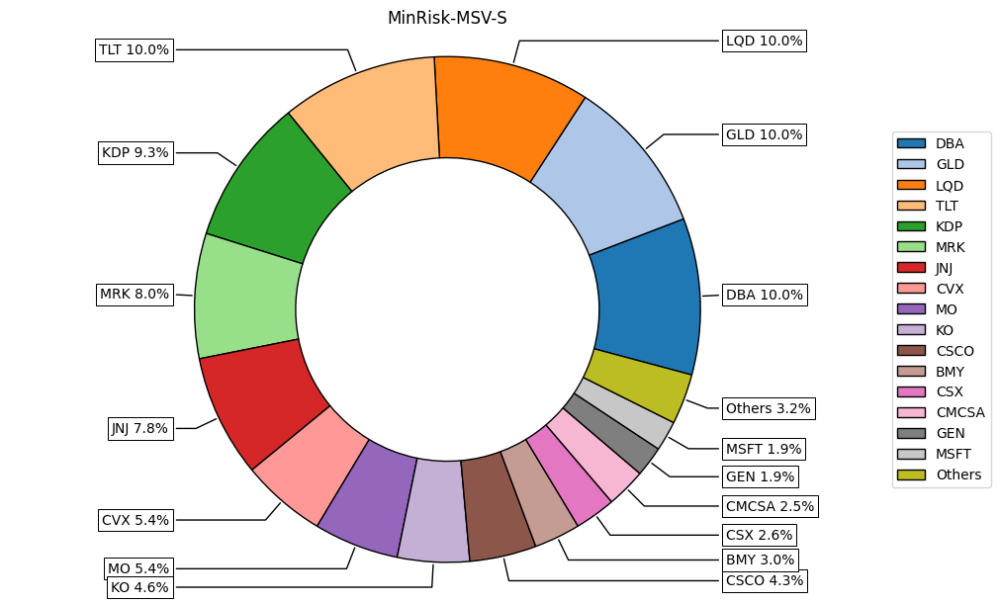

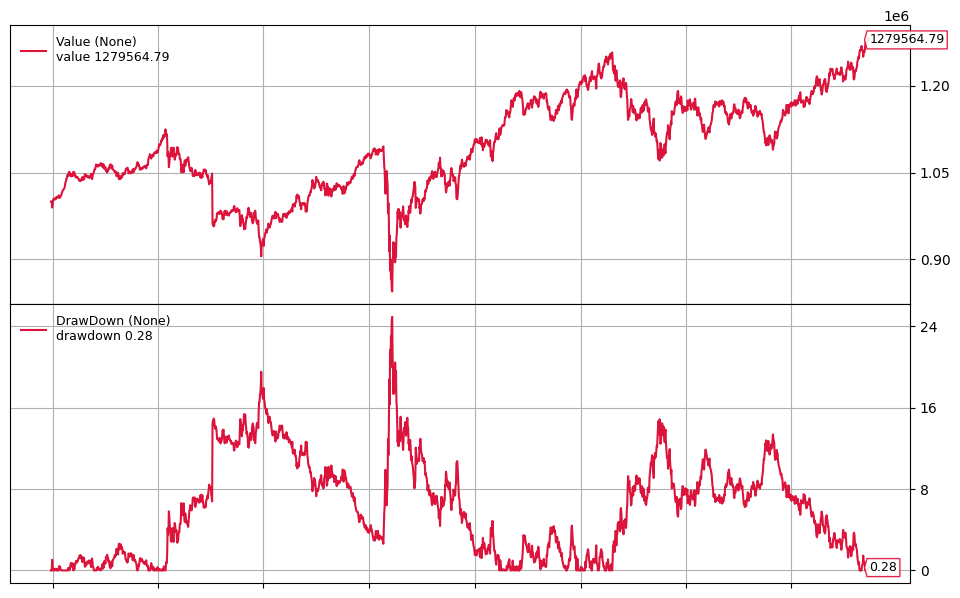

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2429%
2951 2024-09-24  0.1079%
2952 2024-09-25 -0.3744%
2953 2024-09-26  0.0937%
2954 2024-09-27  0.2806%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,20.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,6.8114%
Financial Services,2.0520%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


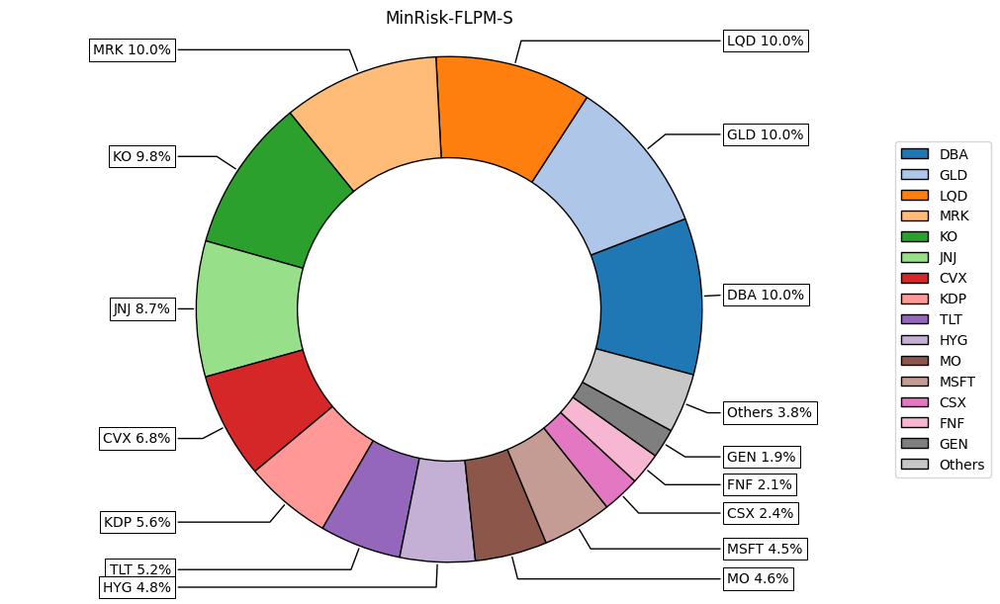

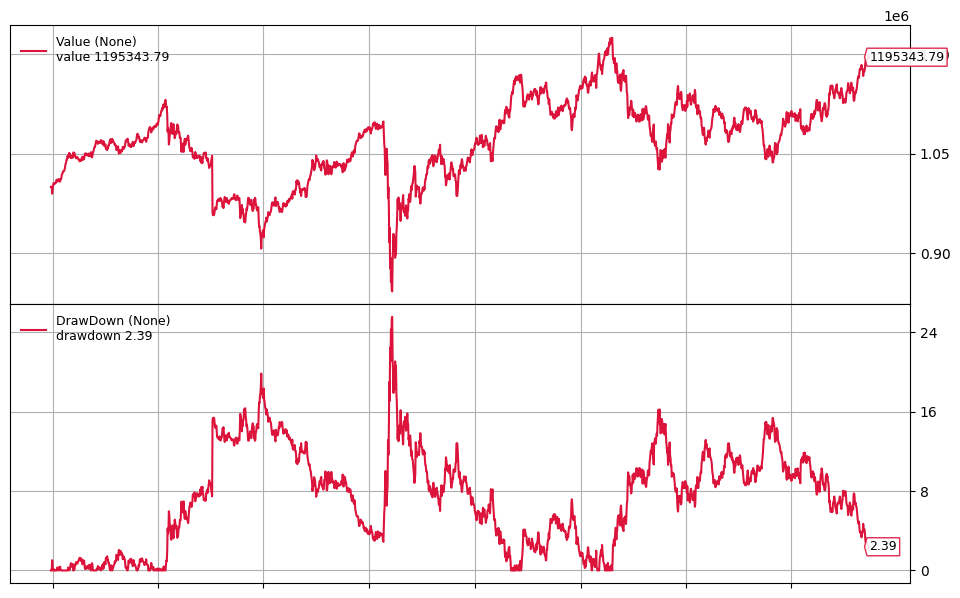

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.3627%
2951 2024-09-24  0.2132%
2952 2024-09-25 -0.4465%
2953 2024-09-26  0.1090%
2954 2024-09-27  0.2281%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,20.0000%
Commodity,20.0000%
Communication Services,1.9454%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,6.2975%
Financial Services,0.0000%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


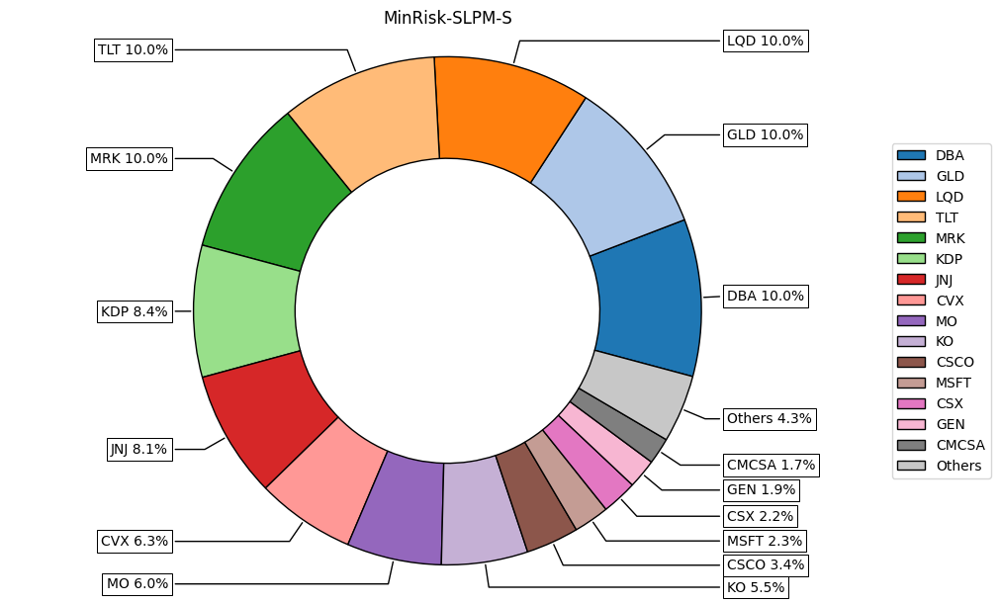

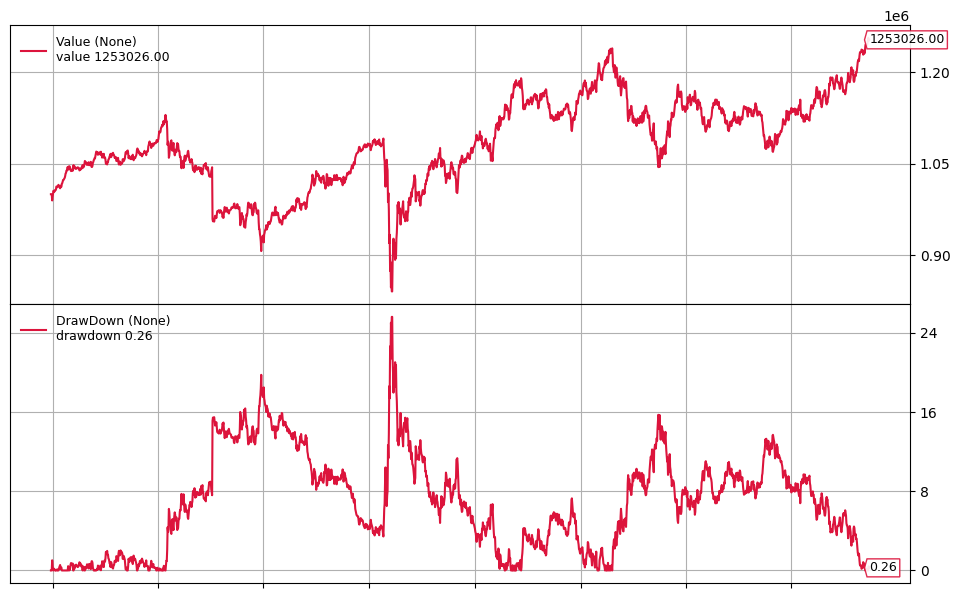

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.4771%
2951 2024-09-24  0.3303%
2952 2024-09-25 -0.4186%
2953 2024-09-26  0.1569%
2954 2024-09-27  0.2243%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,20.0000%
Commodity,20.0000%
Communication Services,8.6575%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,5.5886%
Financial Services,0.4543%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


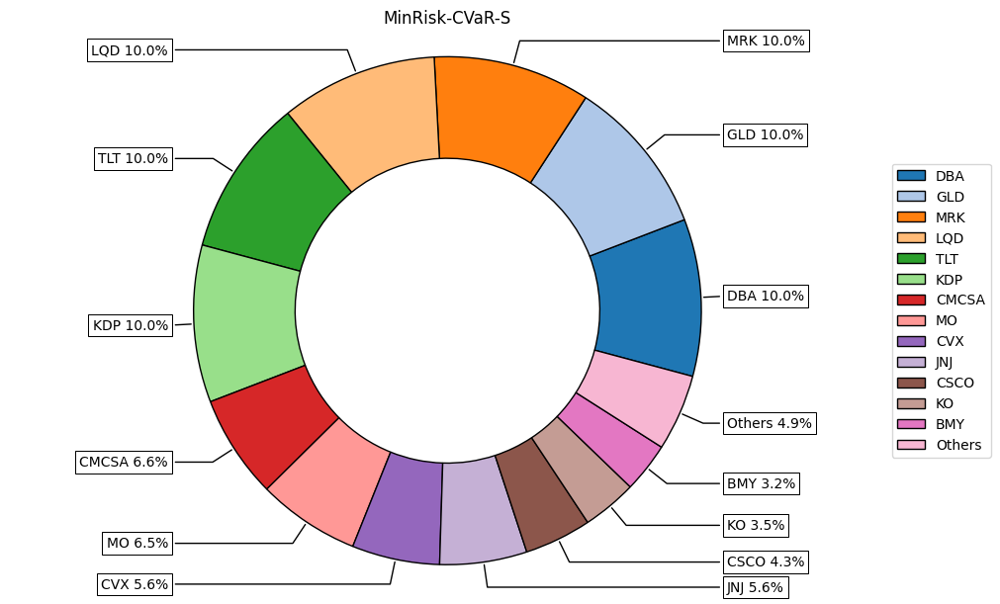

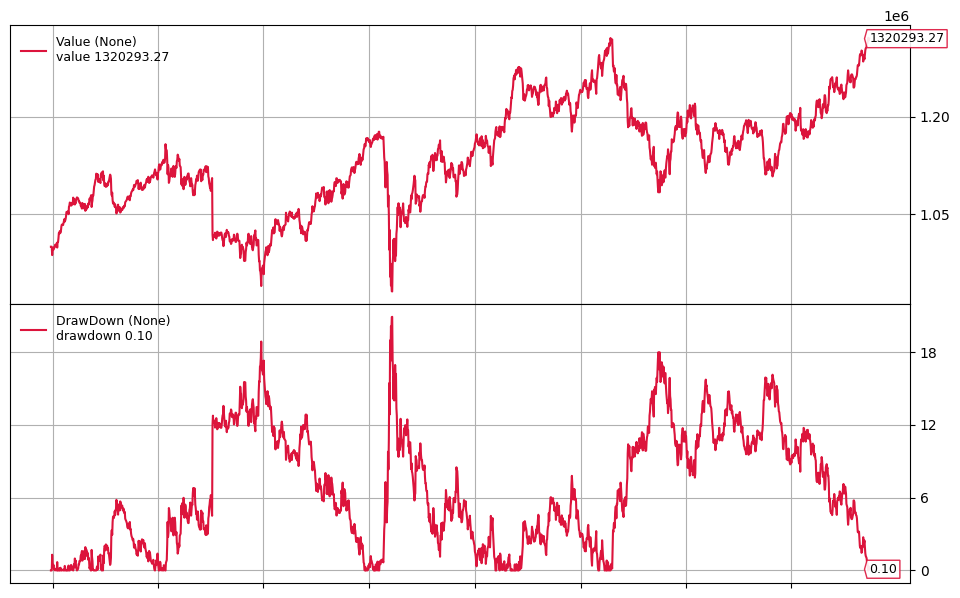

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.3527%
2951 2024-09-24  0.2666%
2952 2024-09-25 -0.3328%
2953 2024-09-26  0.2340%
2954 2024-09-27 -0.0655%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,4.8520%
Bond,20.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,0.0000%
Financial Services,9.3715%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


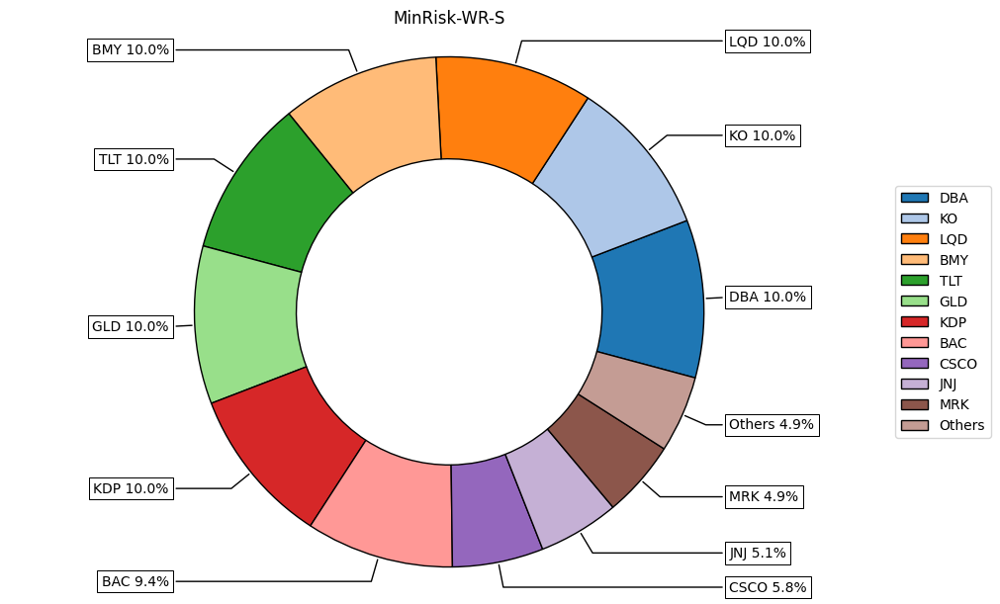

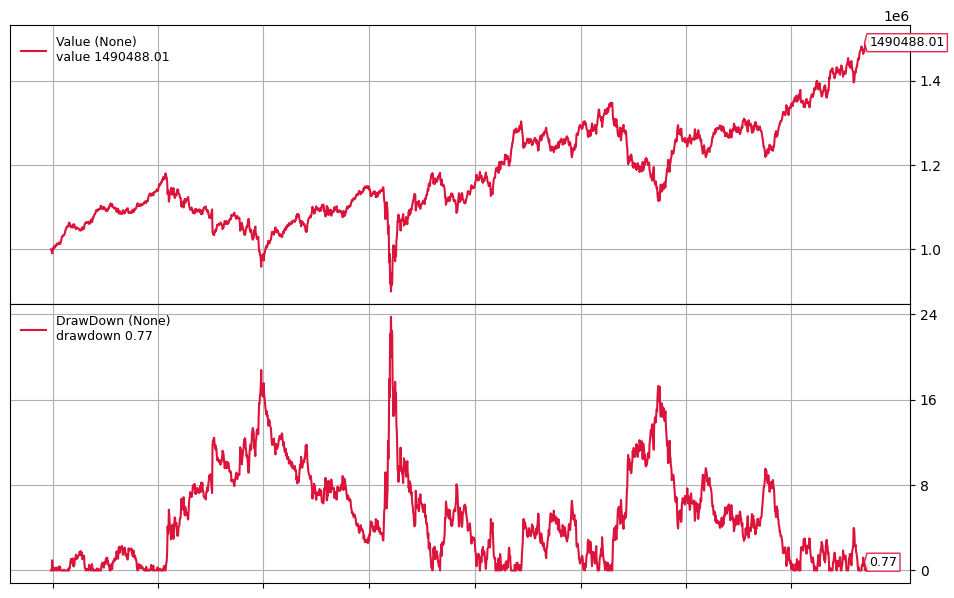

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2293%
2951 2024-09-24  0.0464%
2952 2024-09-25 -0.6587%
2953 2024-09-26 -0.1142%
2954 2024-09-27  0.2980%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,20.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,5.5249%
Consumer Defensive,20.0000%
Energy,13.2674%
Financial Services,1.2077%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


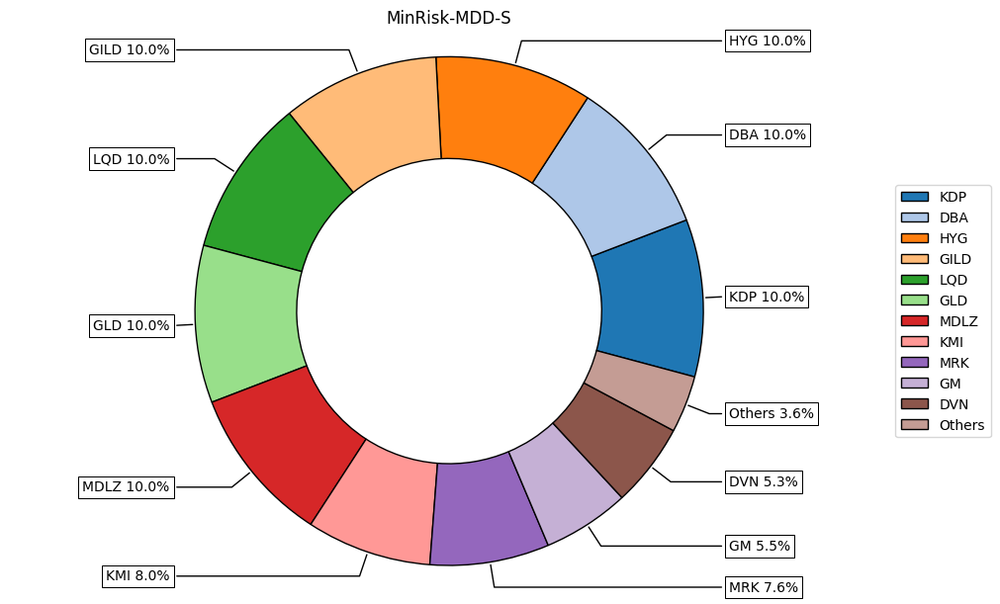

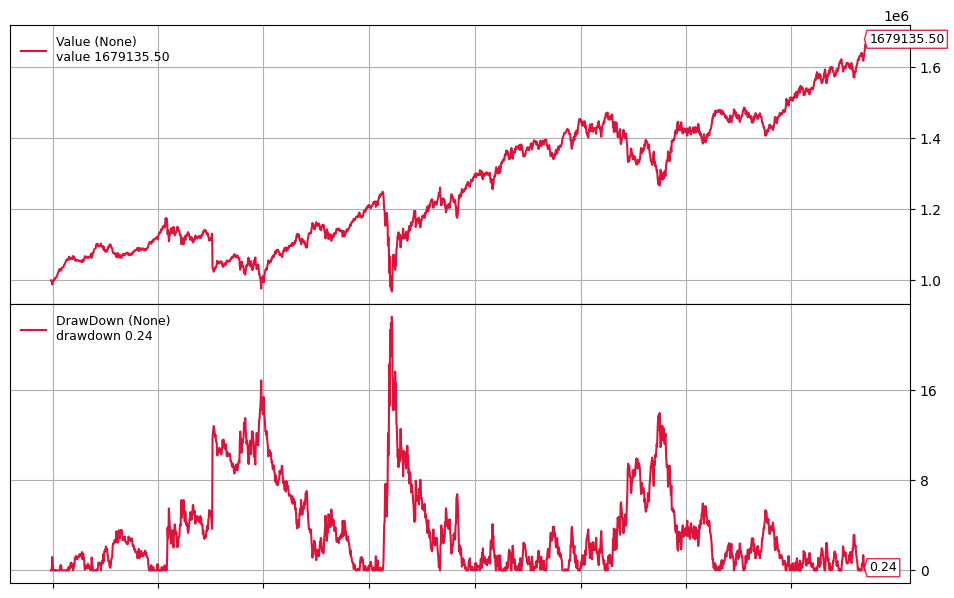

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.3349%
2951 2024-09-24  0.0191%
2952 2024-09-25 -0.3147%
2953 2024-09-26  0.0737%
2954 2024-09-27  0.0181%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,20.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,4.8320%
Financial Services,1.0366%
Healthcare,19.2188%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


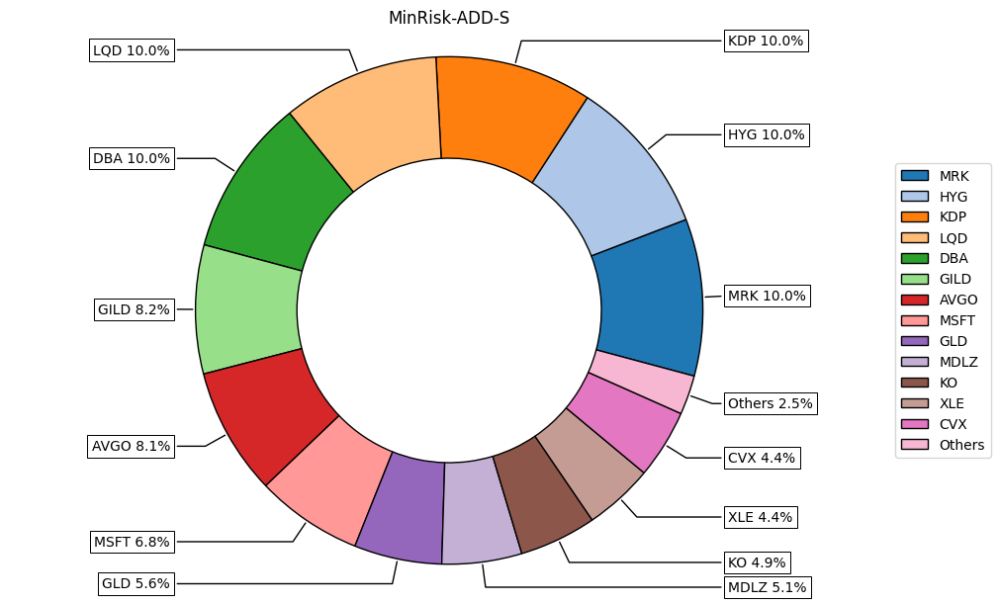

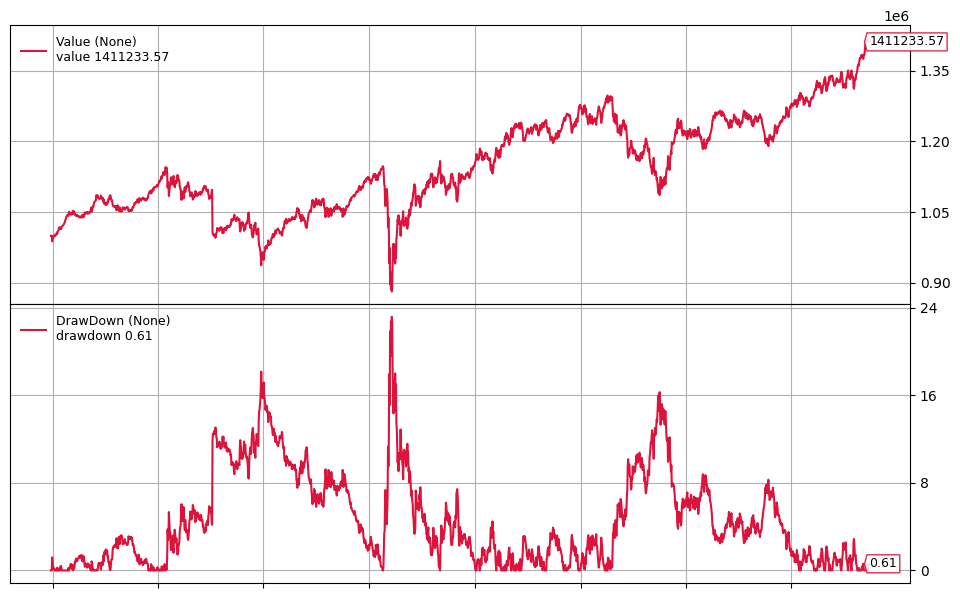

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.2875%
2951 2024-09-24 -0.0485%
2952 2024-09-25 -0.4107%
2953 2024-09-26 -0.1497%
2954 2024-09-27  0.2665%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,0.0000%
Bond,20.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,20.0000%
Energy,5.2831%
Financial Services,8.5920%
Healthcare,20.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


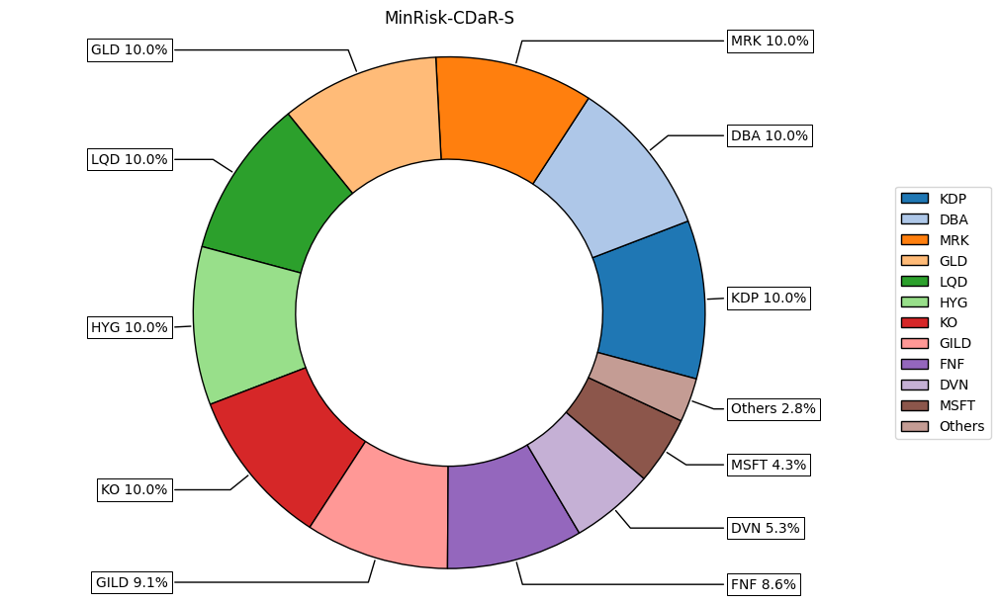

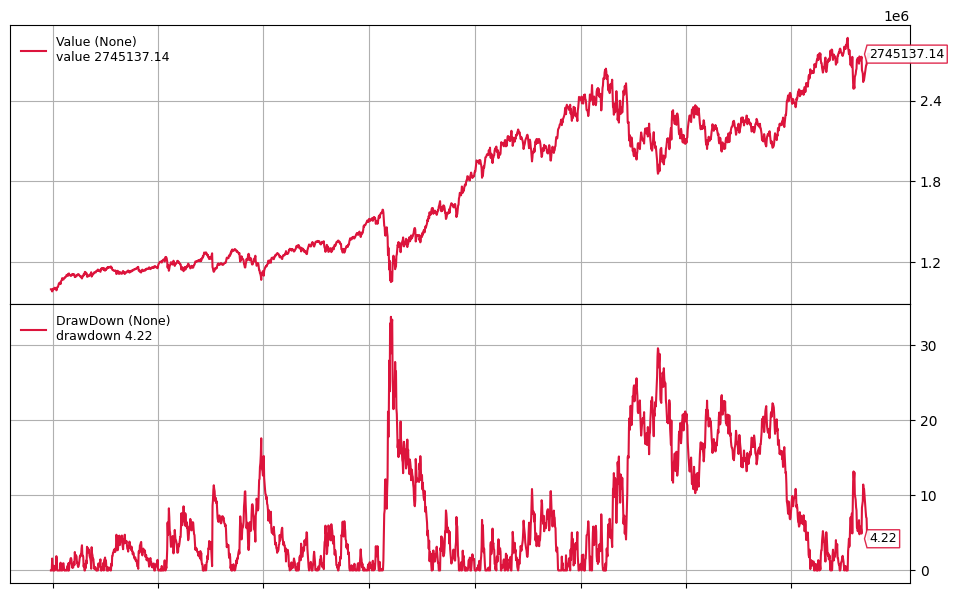

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.4209%
2951 2024-09-24  0.8807%
2952 2024-09-25 -1.0115%
2953 2024-09-26  0.8841%
2954 2024-09-27  0.1974%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,10.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,20.0000%
Healthcare,0.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


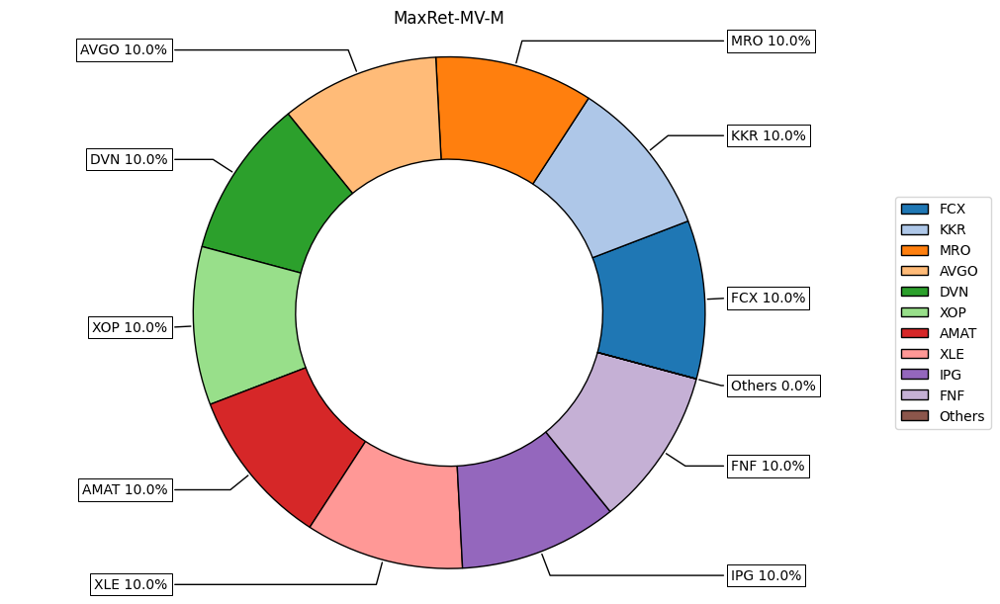

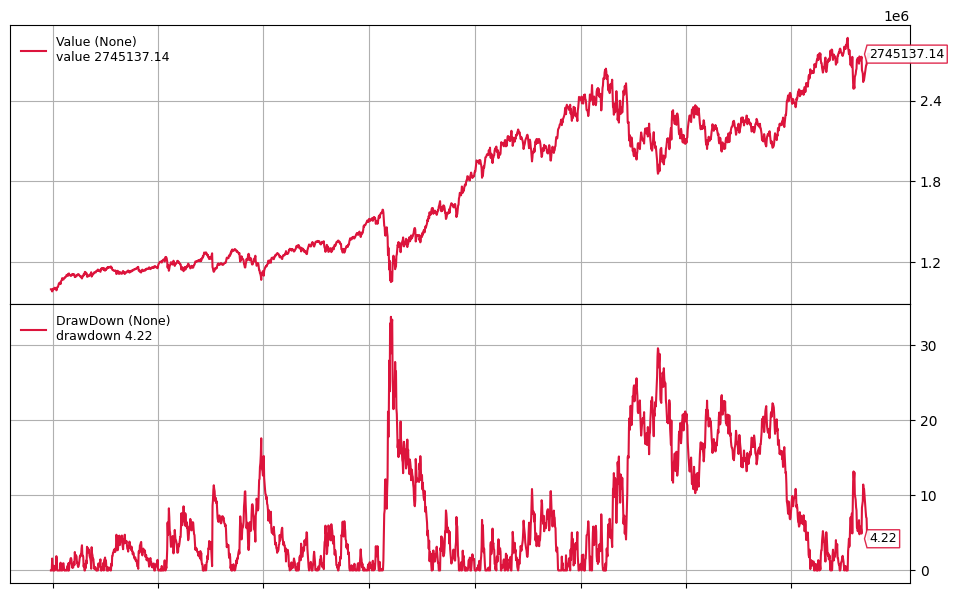

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.4209%
2951 2024-09-24  0.8807%
2952 2024-09-25 -1.0115%
2953 2024-09-26  0.8841%
2954 2024-09-27  0.1974%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,10.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,20.0000%
Healthcare,0.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


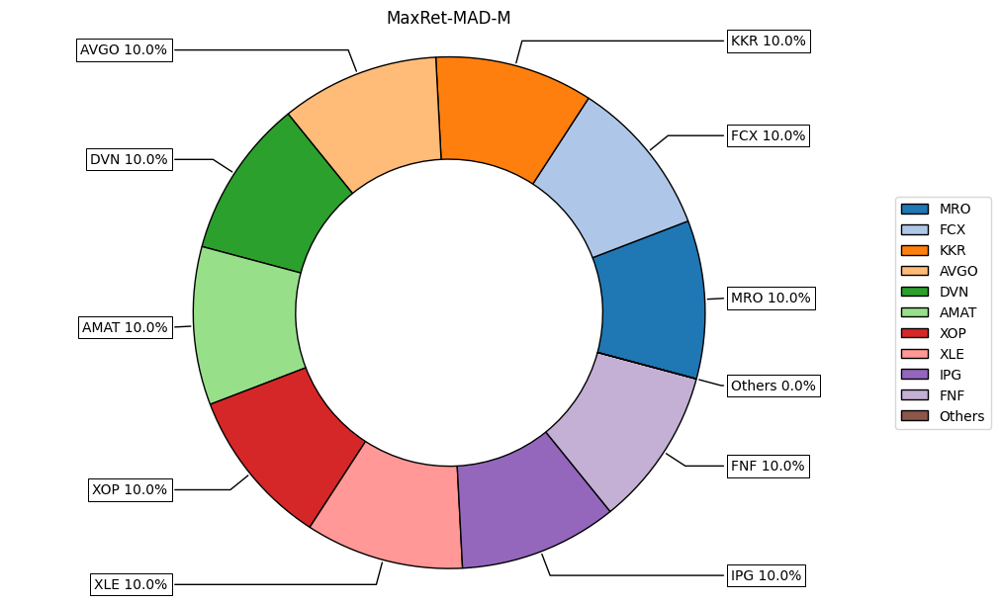

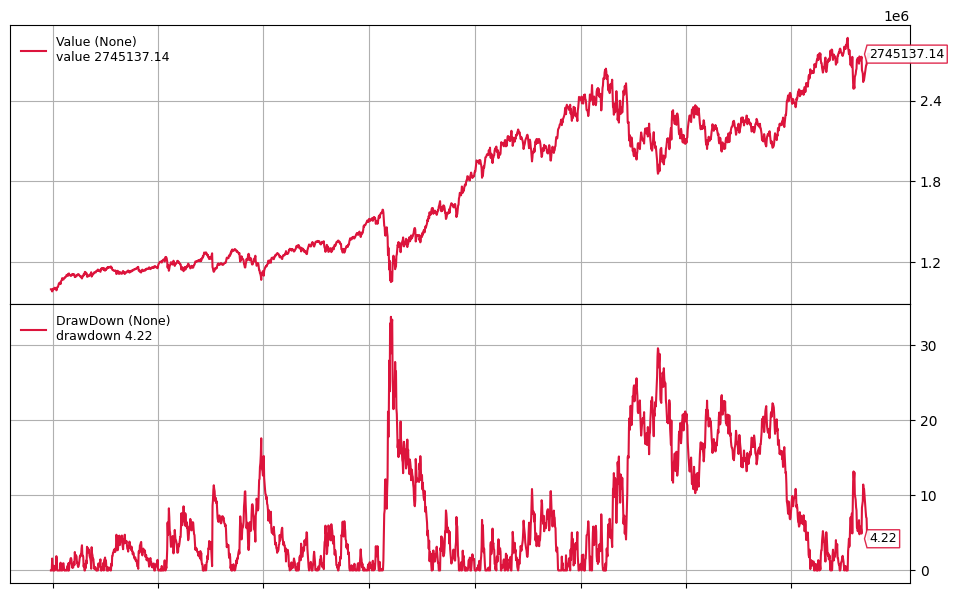

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.4209%
2951 2024-09-24  0.8807%
2952 2024-09-25 -1.0115%
2953 2024-09-26  0.8841%
2954 2024-09-27  0.1974%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,10.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,20.0000%
Healthcare,0.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


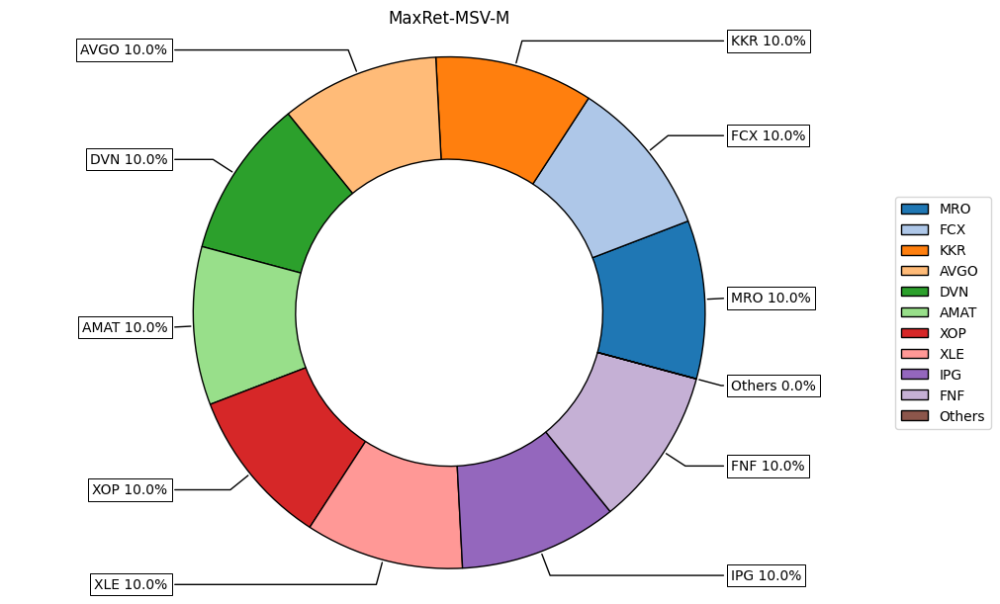

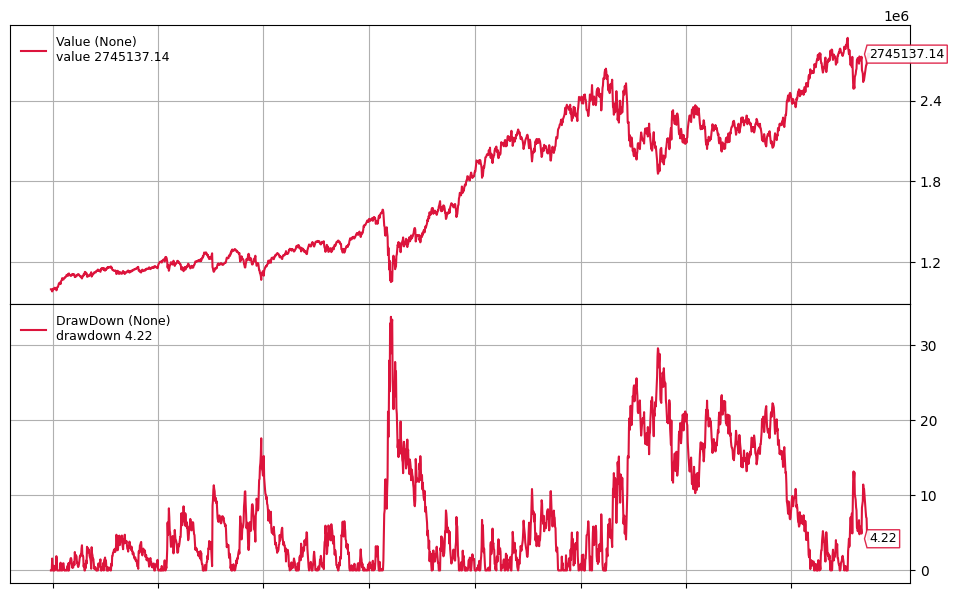

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.4209%
2951 2024-09-24  0.8807%
2952 2024-09-25 -1.0115%
2953 2024-09-26  0.8841%
2954 2024-09-27  0.1974%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,10.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,20.0000%
Healthcare,0.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


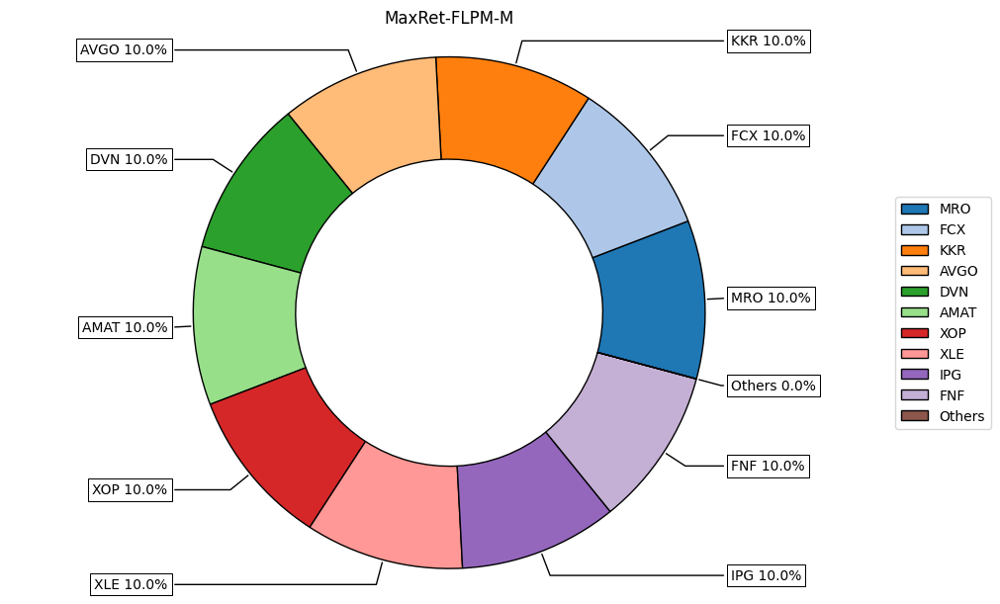

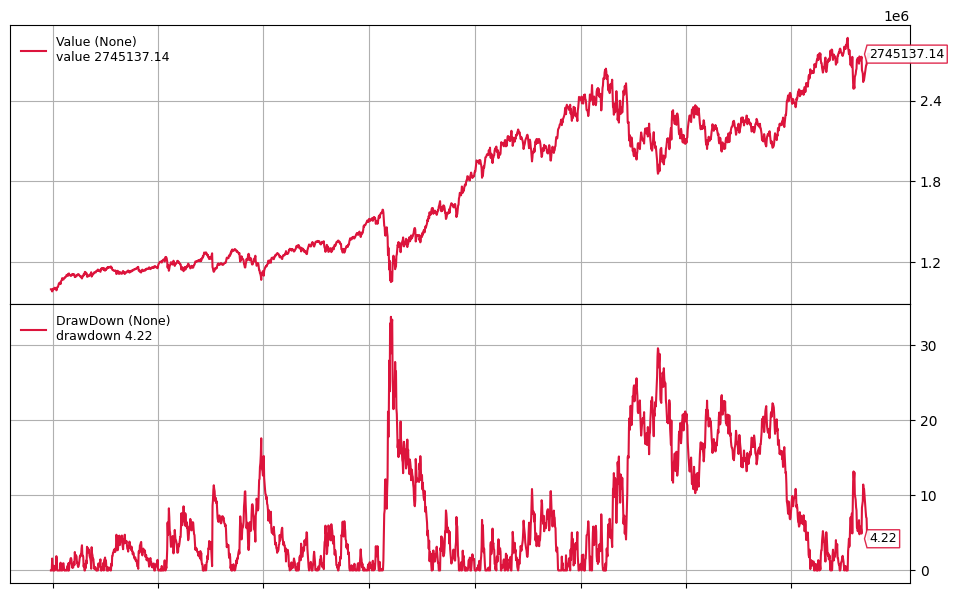

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.4209%
2951 2024-09-24  0.8807%
2952 2024-09-25 -1.0115%
2953 2024-09-26  0.8841%
2954 2024-09-27  0.1974%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,10.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,20.0000%
Healthcare,0.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


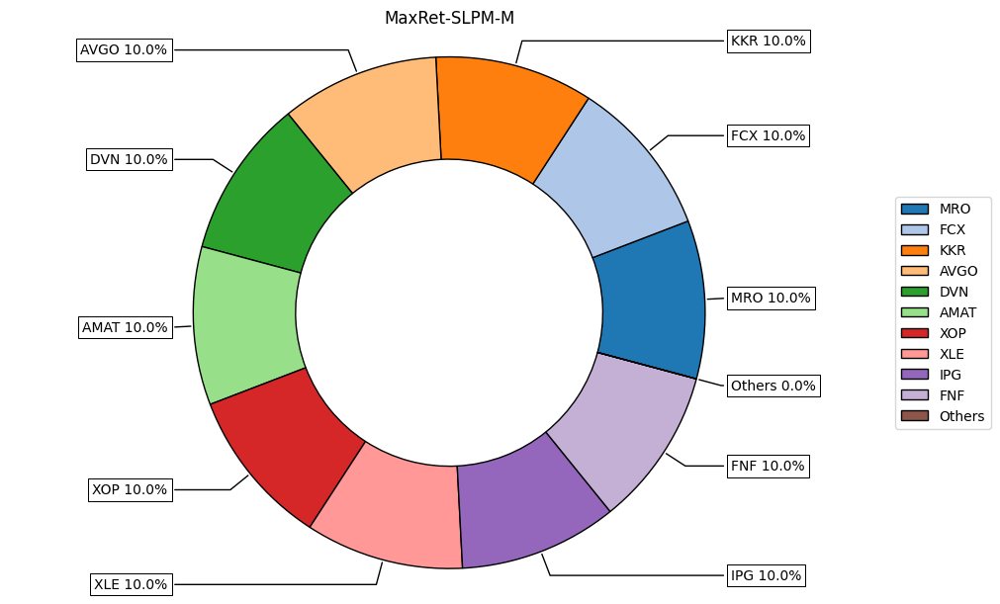

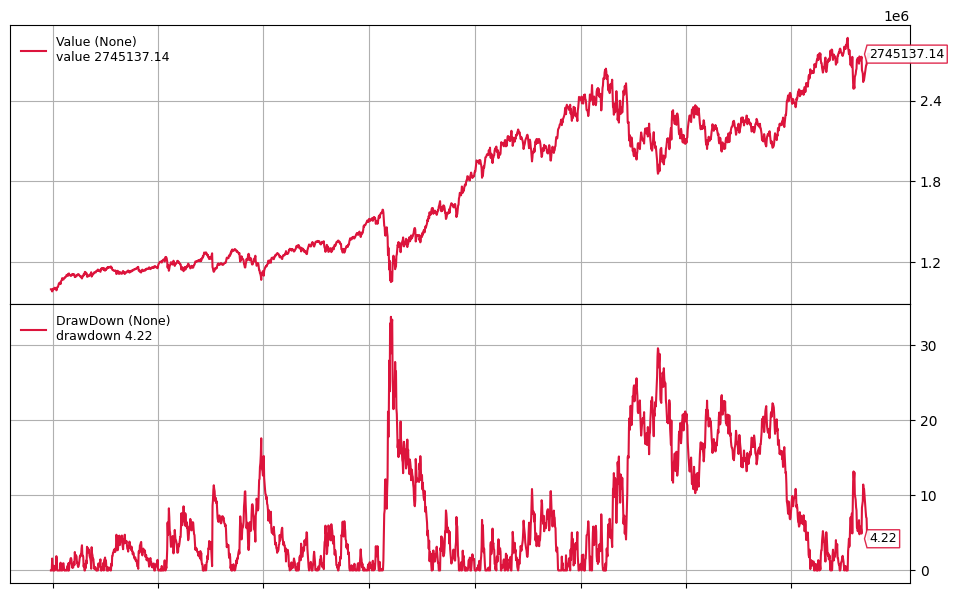

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.4209%
2951 2024-09-24  0.8807%
2952 2024-09-25 -1.0115%
2953 2024-09-26  0.8841%
2954 2024-09-27  0.1974%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,10.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,20.0000%
Healthcare,0.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


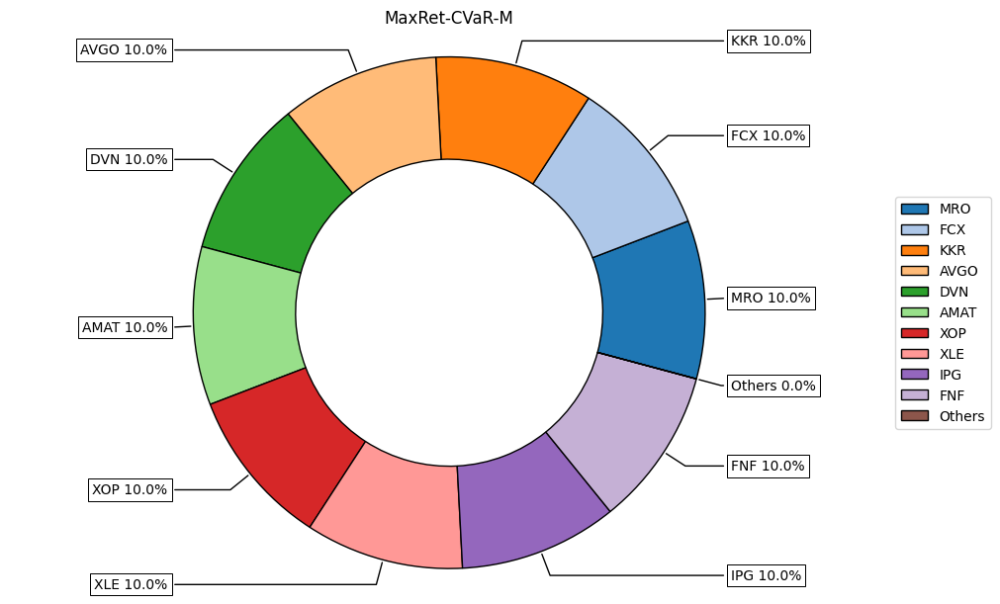

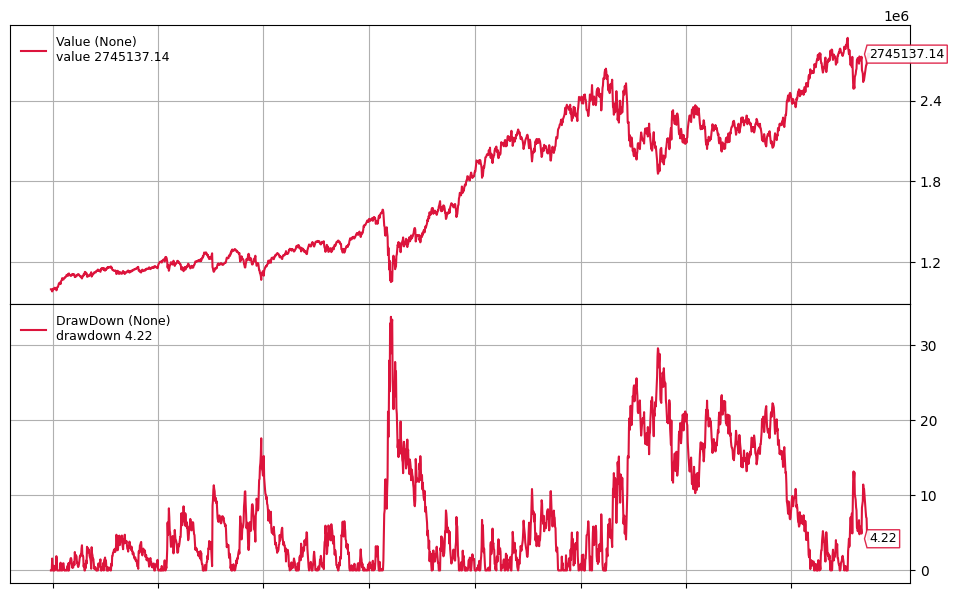

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.4209%
2951 2024-09-24  0.8807%
2952 2024-09-25 -1.0115%
2953 2024-09-26  0.8841%
2954 2024-09-27  0.1974%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,10.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,20.0000%
Healthcare,0.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


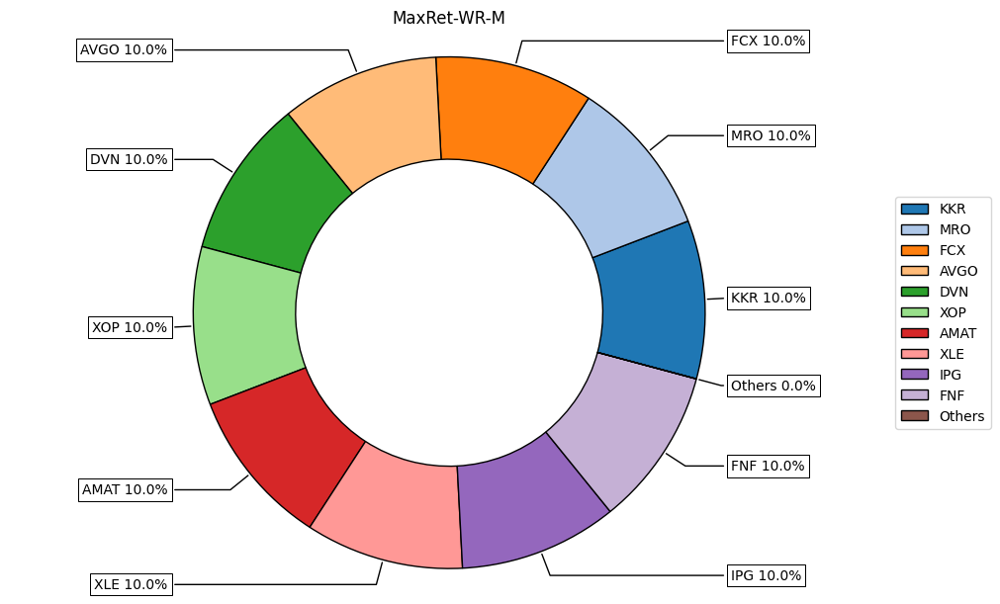

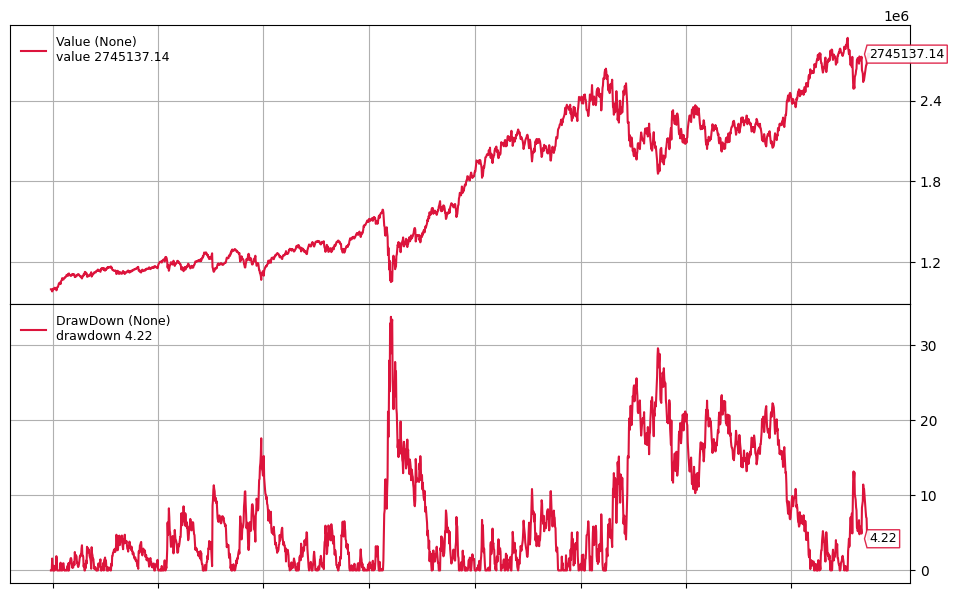

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.4209%
2951 2024-09-24  0.8807%
2952 2024-09-25 -1.0115%
2953 2024-09-26  0.8841%
2954 2024-09-27  0.1974%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,10.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,20.0000%
Healthcare,0.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


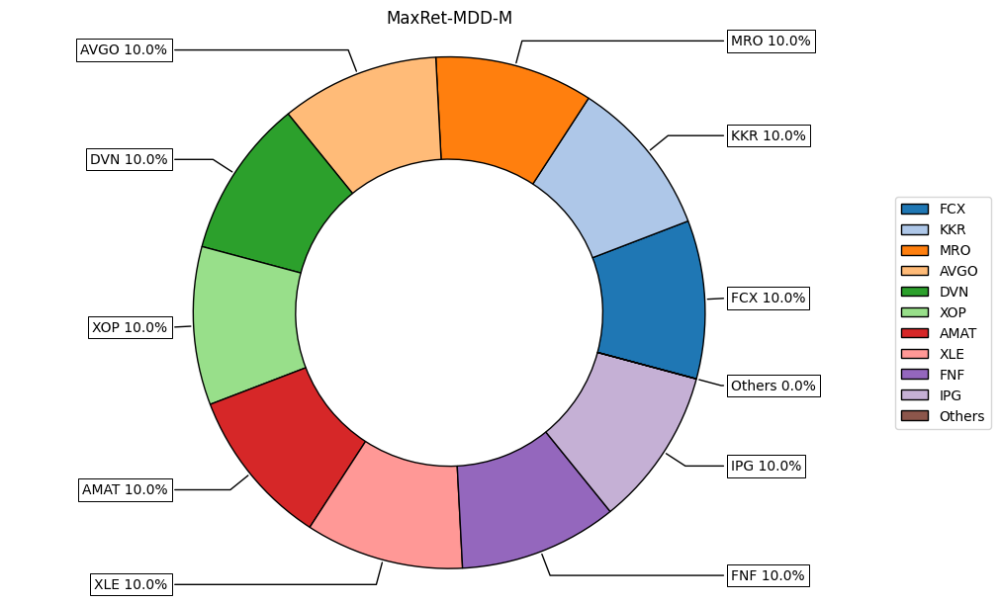

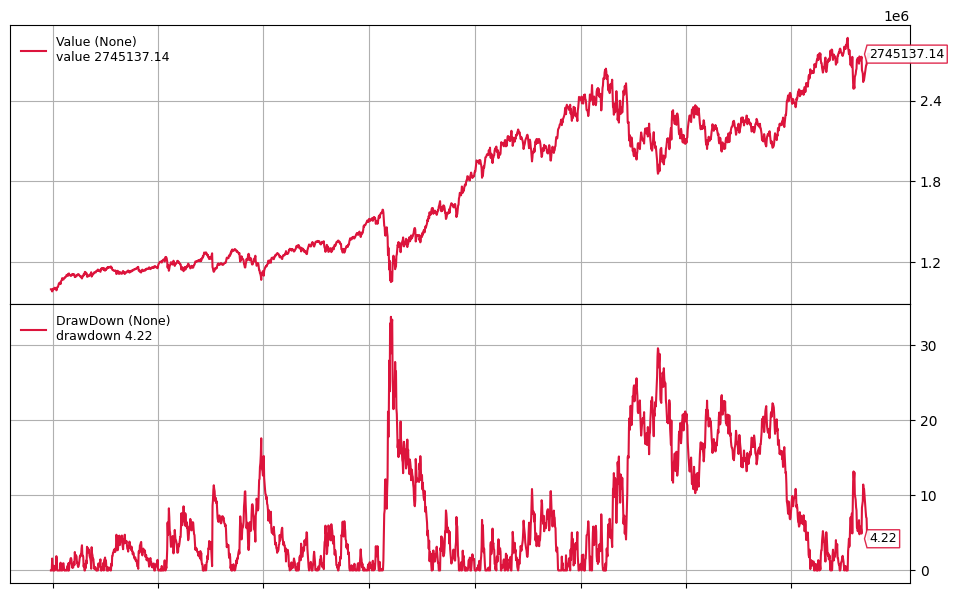

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.4209%
2951 2024-09-24  0.8807%
2952 2024-09-25 -1.0115%
2953 2024-09-26  0.8841%
2954 2024-09-27  0.1974%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,10.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,20.0000%
Healthcare,0.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


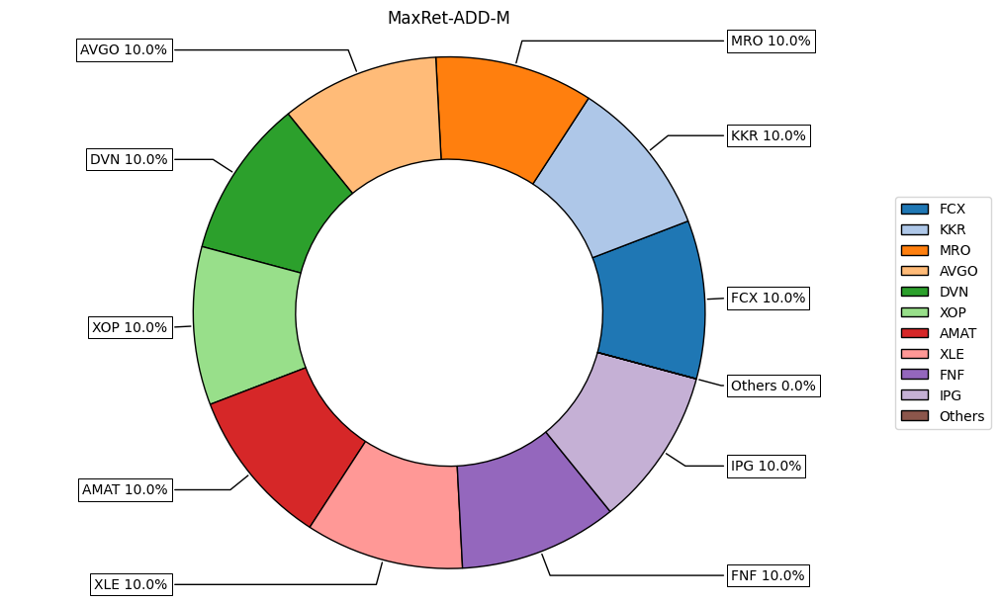

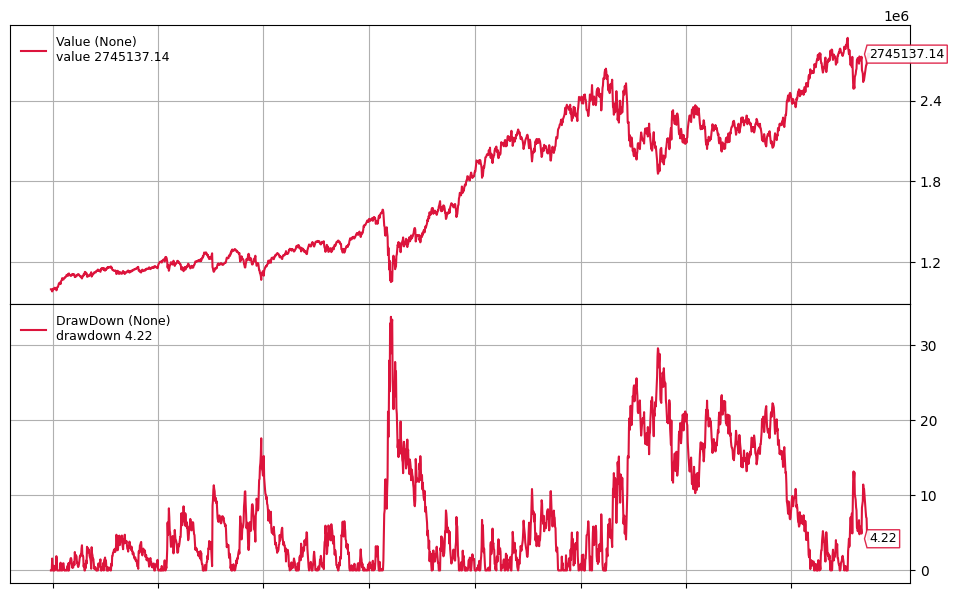

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.4209%
2951 2024-09-24  0.8807%
2952 2024-09-25 -1.0115%
2953 2024-09-26  0.8841%
2954 2024-09-27  0.1974%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,10.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,20.0000%
Healthcare,0.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


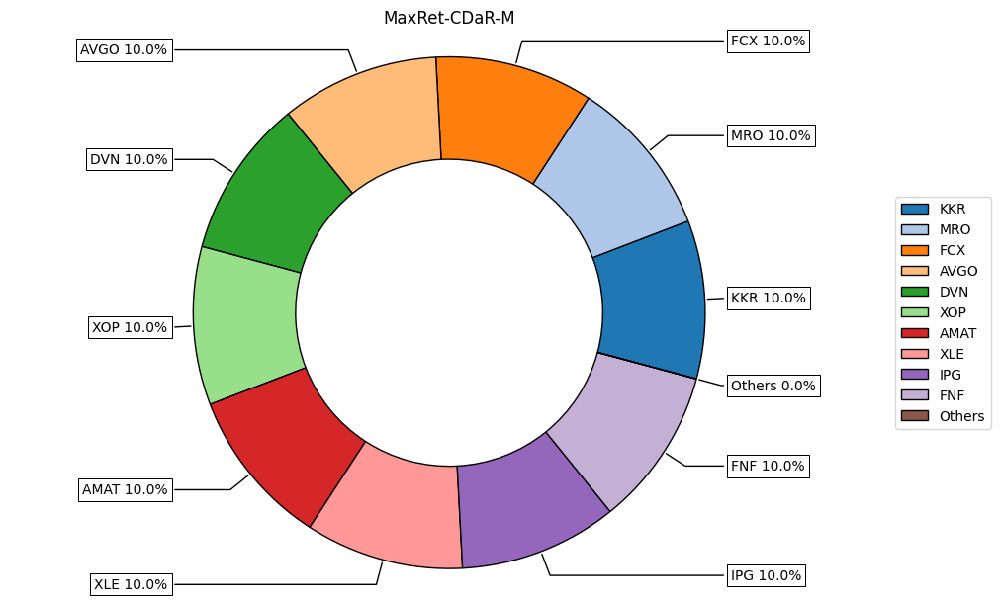

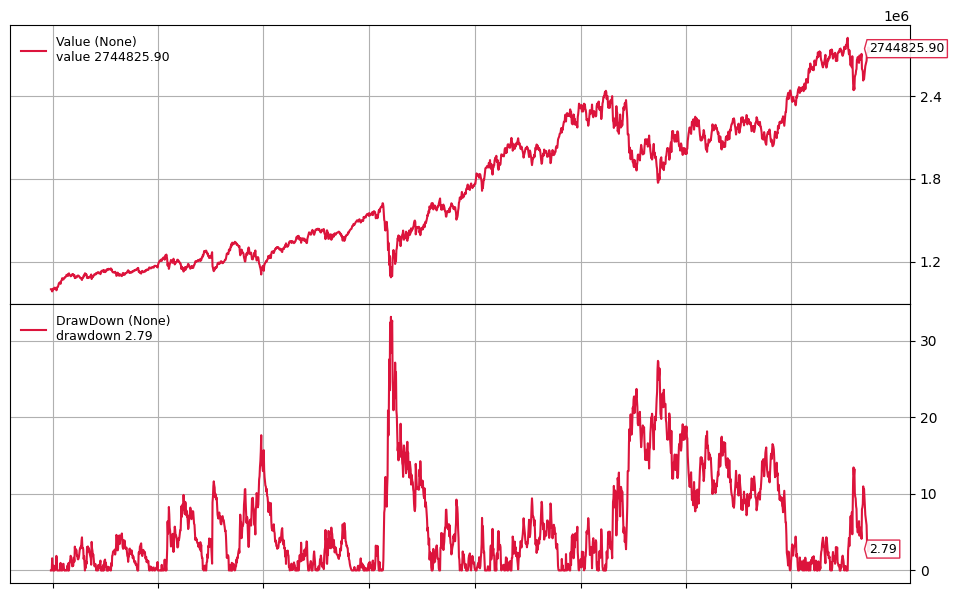

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.1558%
2951 2024-09-24  1.2380%
2952 2024-09-25 -1.1966%
2953 2024-09-26  0.8882%
2954 2024-09-27 -0.4464%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,10.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,20.0000%
Healthcare,0.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


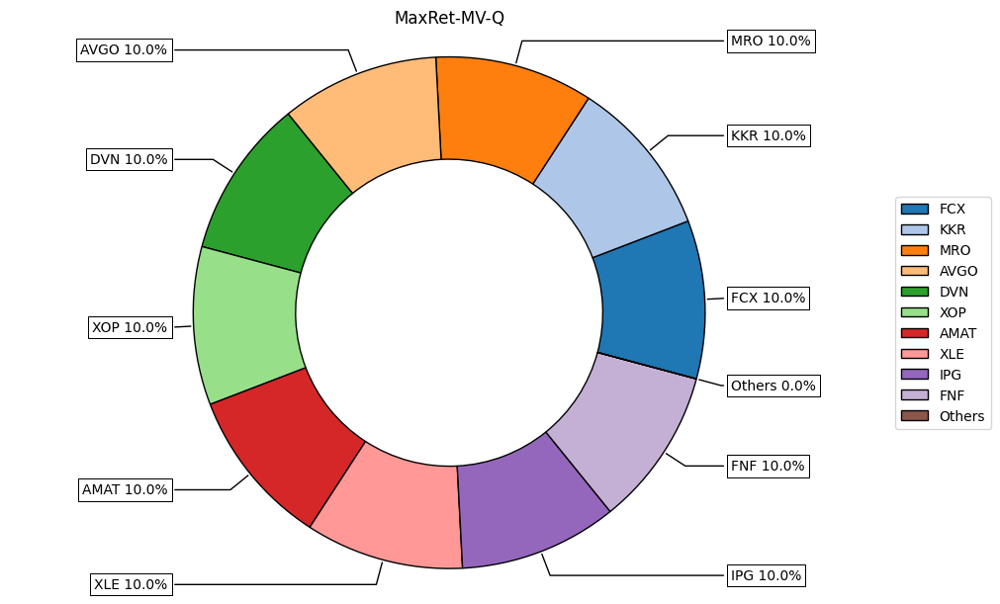

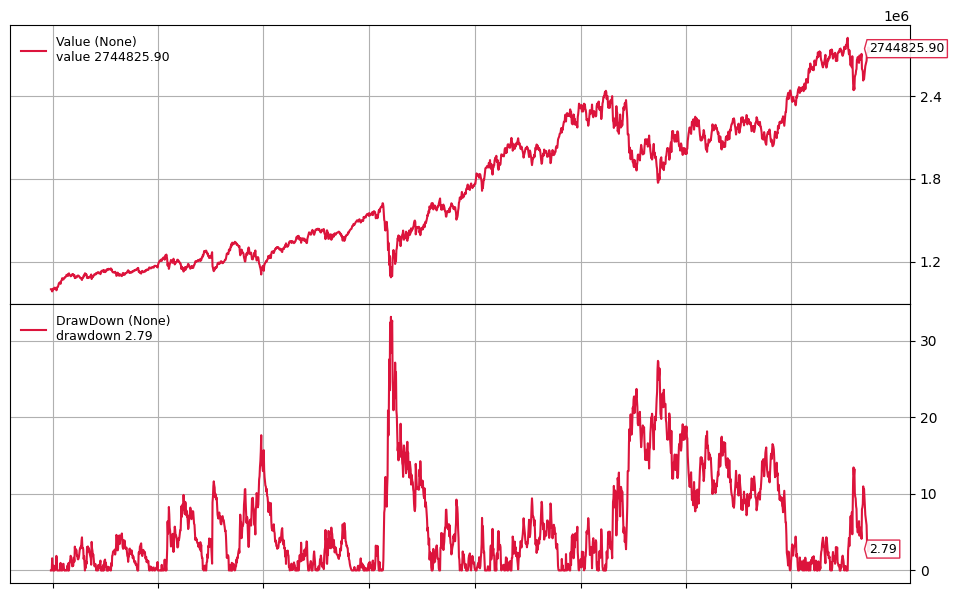

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.1558%
2951 2024-09-24  1.2380%
2952 2024-09-25 -1.1966%
2953 2024-09-26  0.8882%
2954 2024-09-27 -0.4464%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,10.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,20.0000%
Healthcare,0.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


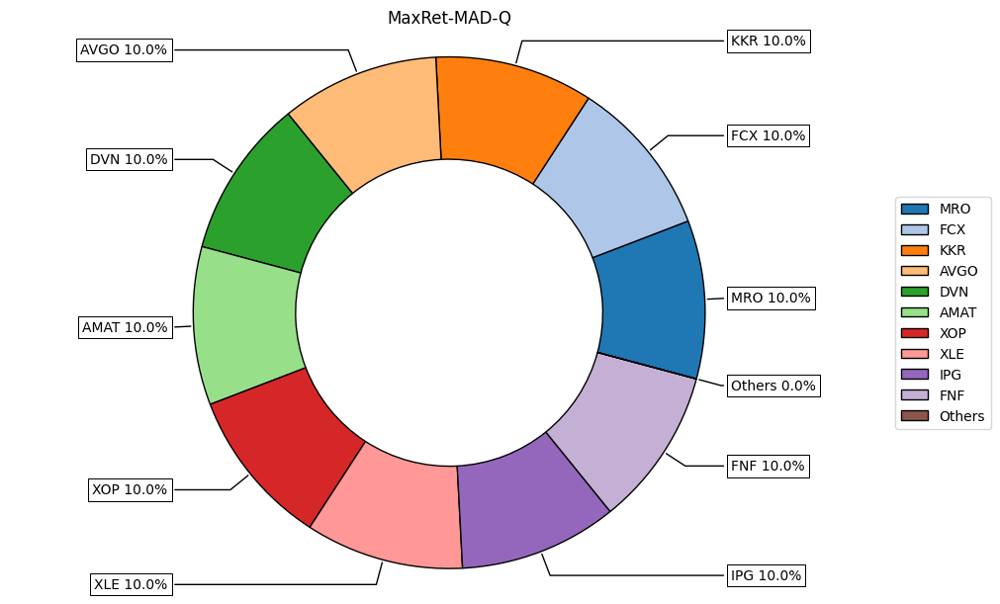

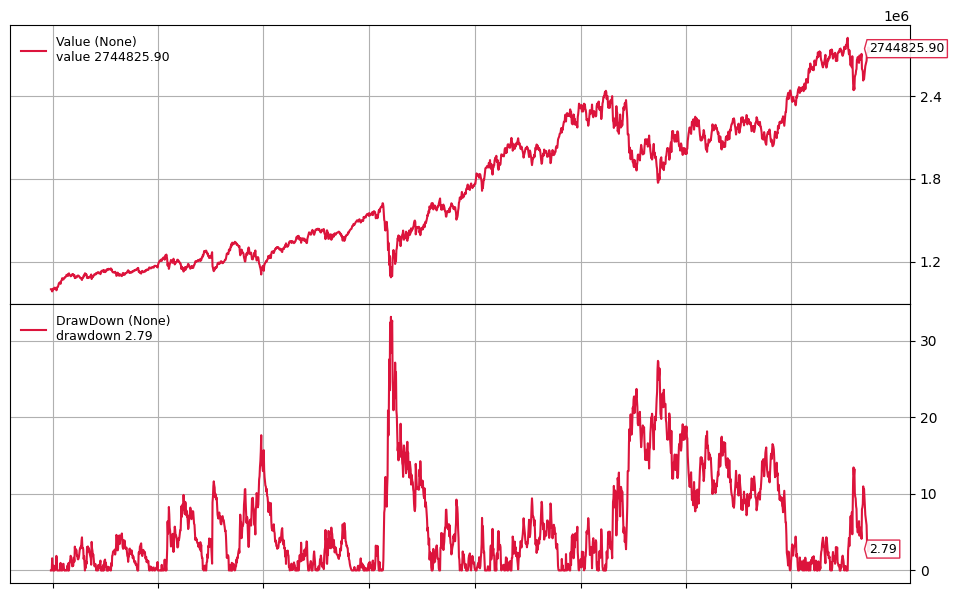

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.1558%
2951 2024-09-24  1.2380%
2952 2024-09-25 -1.1966%
2953 2024-09-26  0.8882%
2954 2024-09-27 -0.4464%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,10.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,20.0000%
Healthcare,0.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


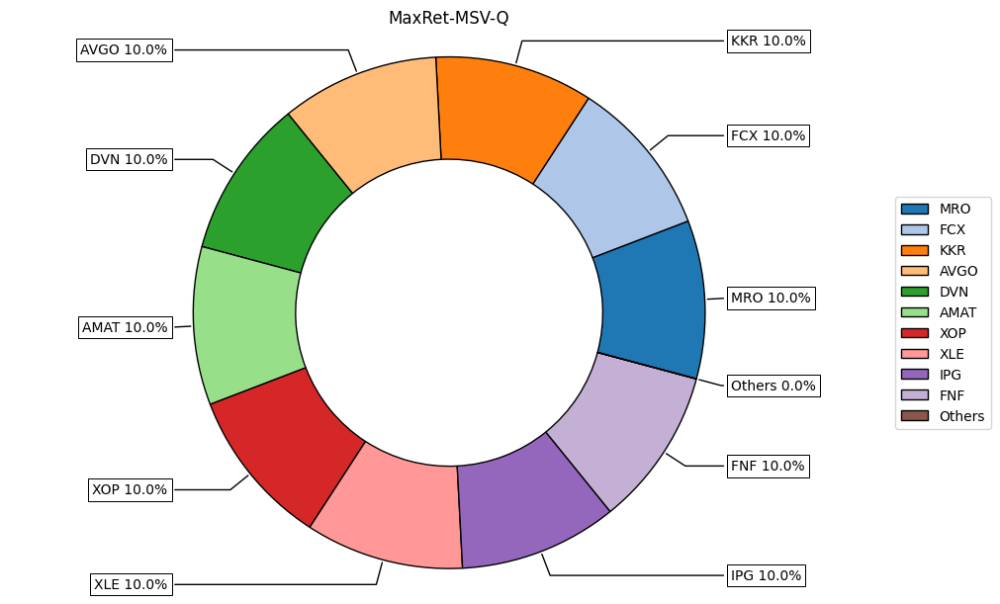

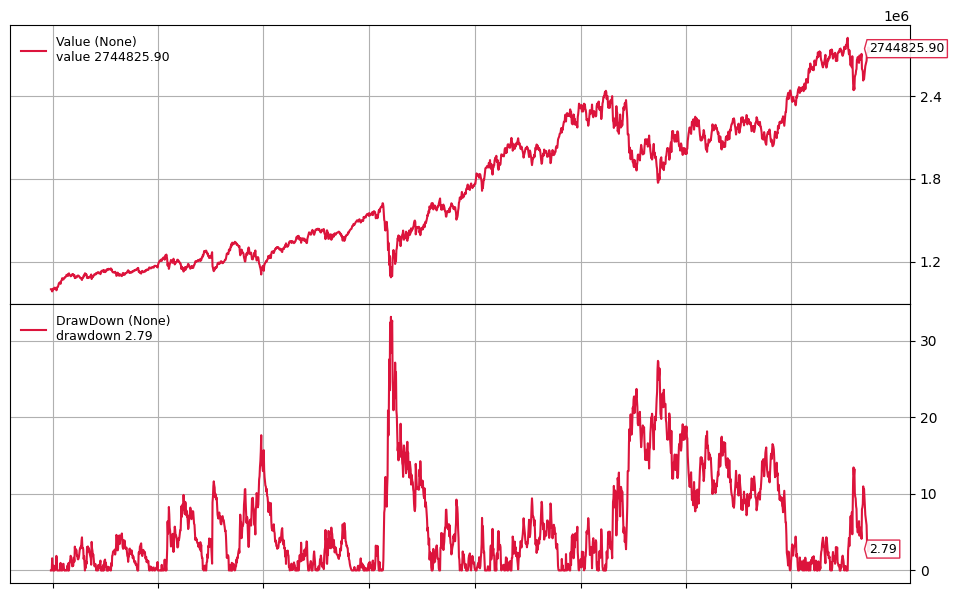

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.1558%
2951 2024-09-24  1.2380%
2952 2024-09-25 -1.1966%
2953 2024-09-26  0.8882%
2954 2024-09-27 -0.4464%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,10.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,20.0000%
Healthcare,0.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


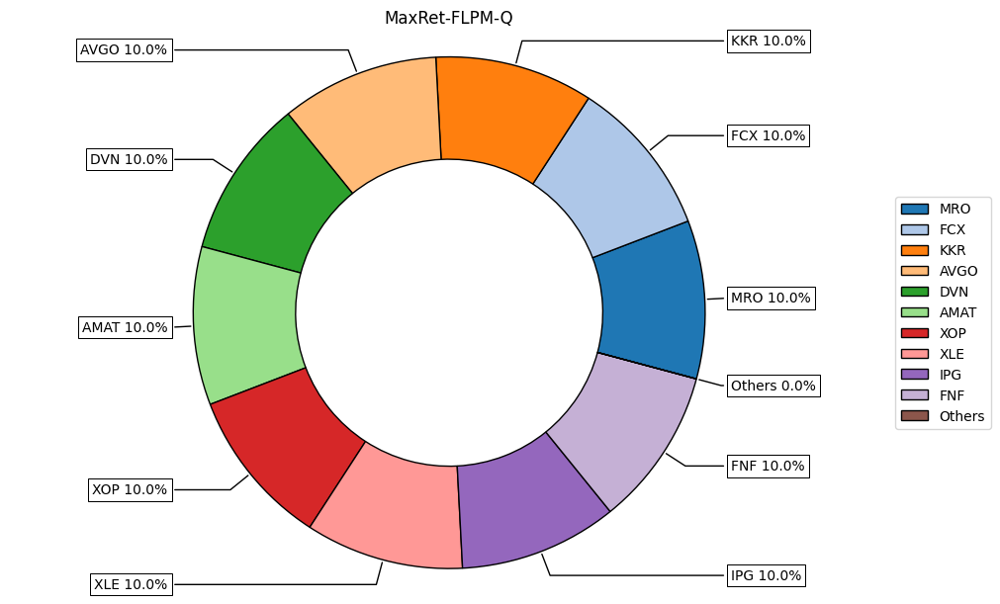

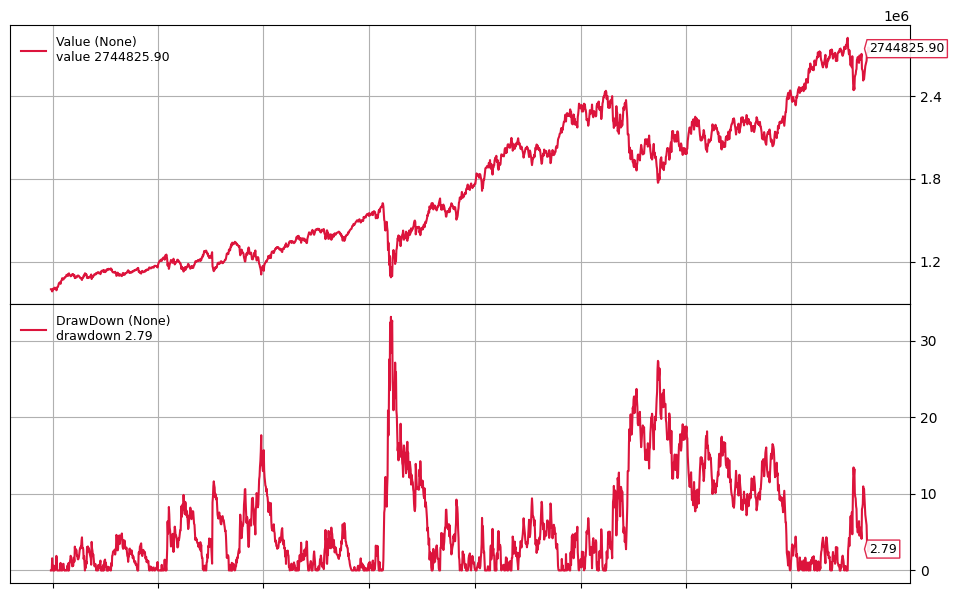

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.1558%
2951 2024-09-24  1.2380%
2952 2024-09-25 -1.1966%
2953 2024-09-26  0.8882%
2954 2024-09-27 -0.4464%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,10.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,20.0000%
Healthcare,0.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


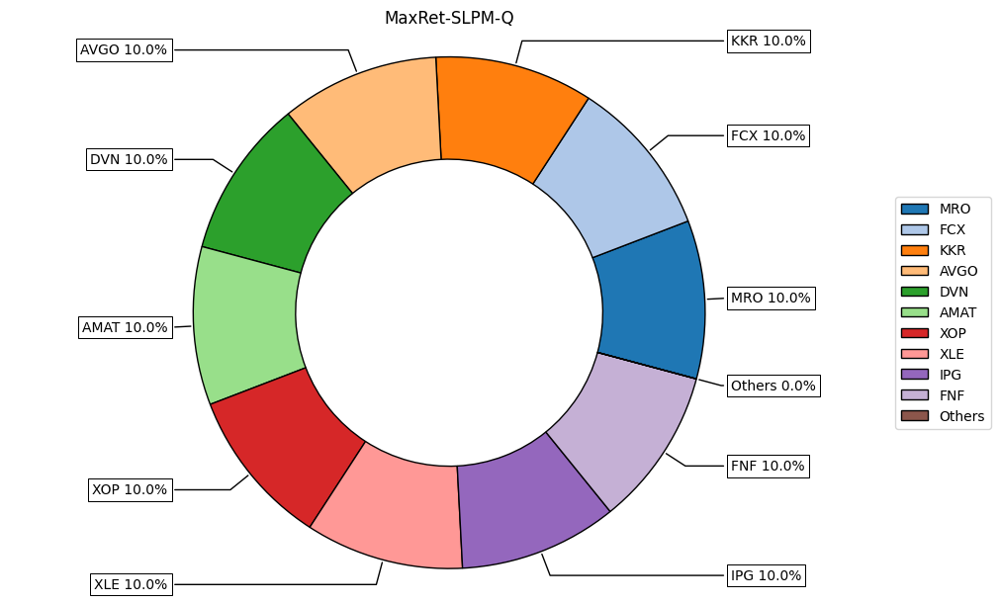

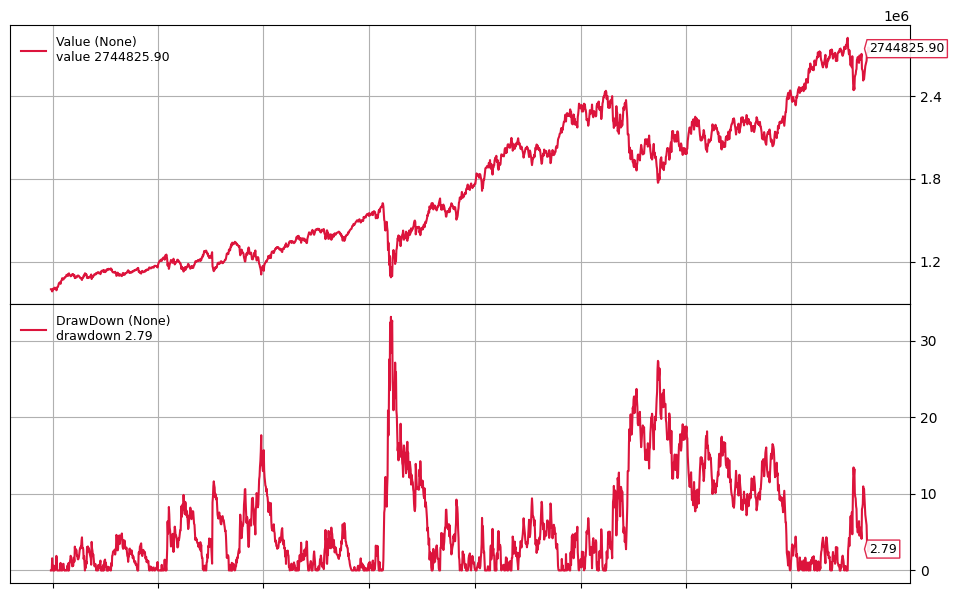

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.1558%
2951 2024-09-24  1.2380%
2952 2024-09-25 -1.1966%
2953 2024-09-26  0.8882%
2954 2024-09-27 -0.4464%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,10.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,20.0000%
Healthcare,0.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


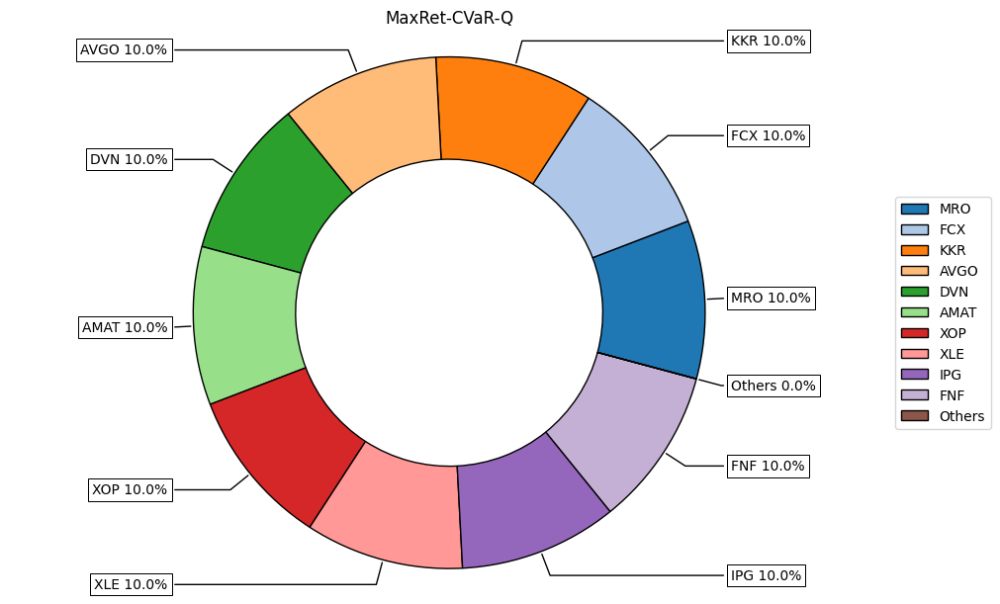

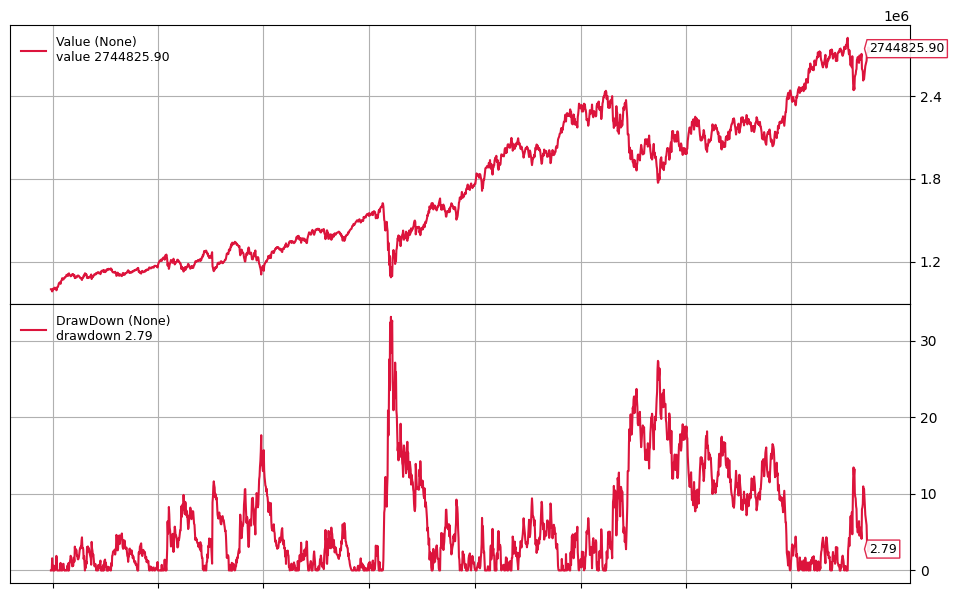

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.1558%
2951 2024-09-24  1.2380%
2952 2024-09-25 -1.1966%
2953 2024-09-26  0.8882%
2954 2024-09-27 -0.4464%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,10.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,20.0000%
Healthcare,0.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


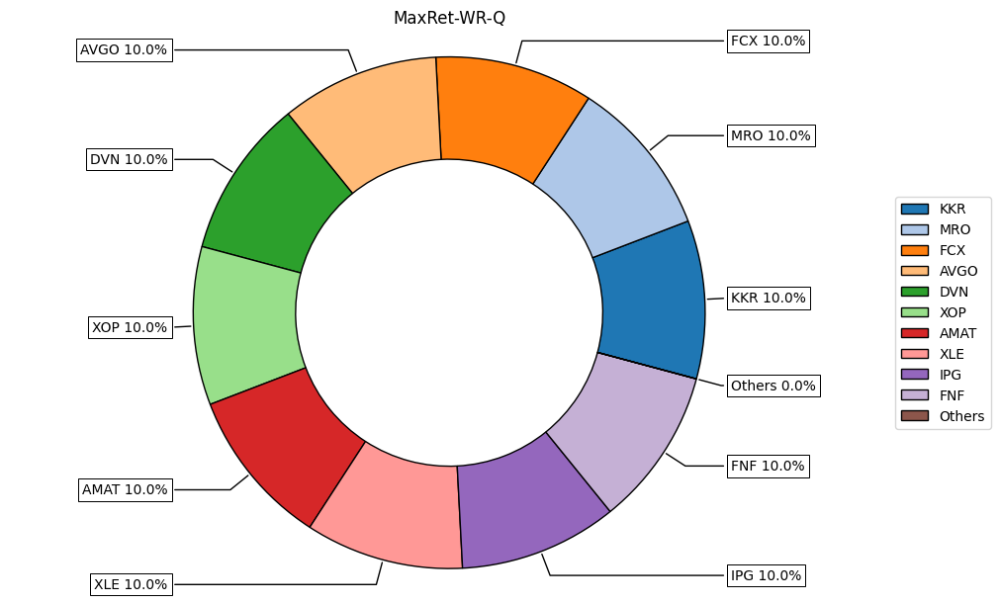

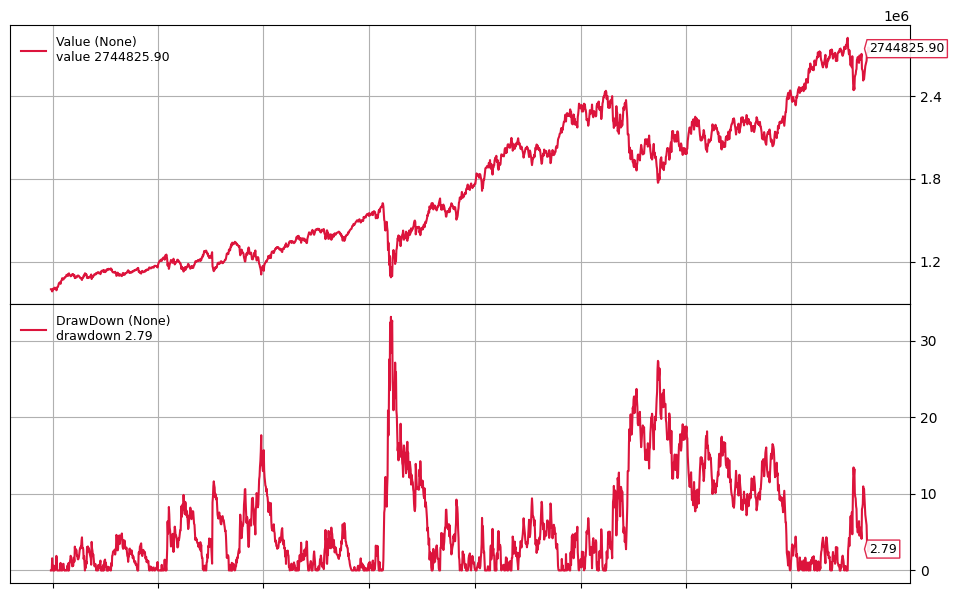

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.1558%
2951 2024-09-24  1.2380%
2952 2024-09-25 -1.1966%
2953 2024-09-26  0.8882%
2954 2024-09-27 -0.4464%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,10.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,20.0000%
Healthcare,0.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


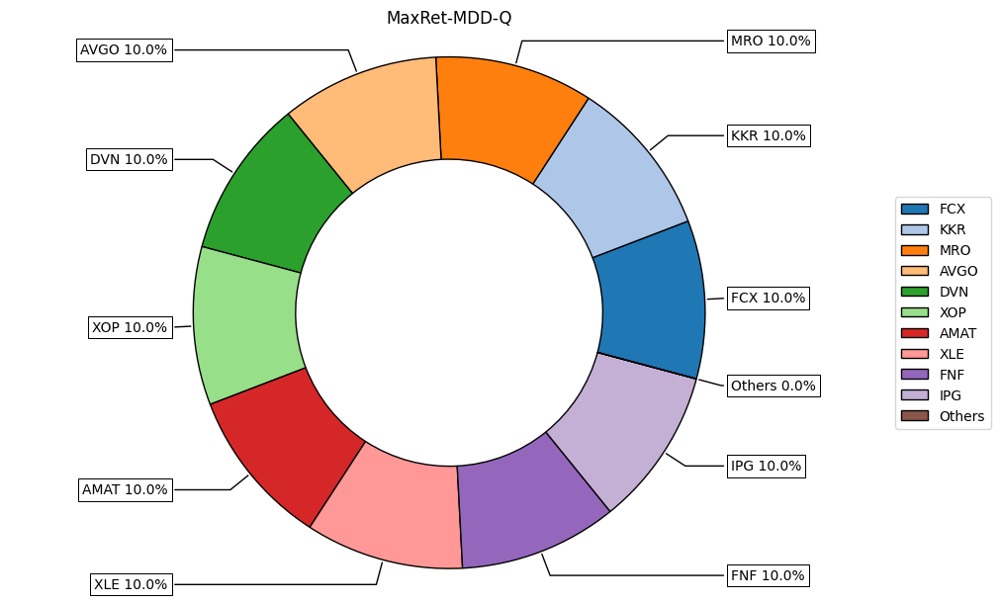

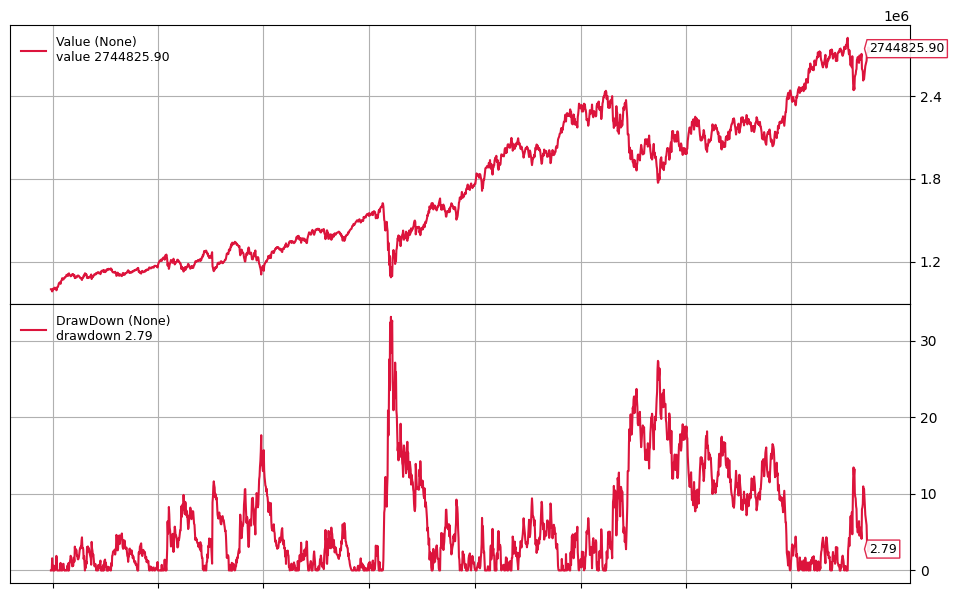

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.1558%
2951 2024-09-24  1.2380%
2952 2024-09-25 -1.1966%
2953 2024-09-26  0.8882%
2954 2024-09-27 -0.4464%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,10.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,20.0000%
Healthcare,0.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


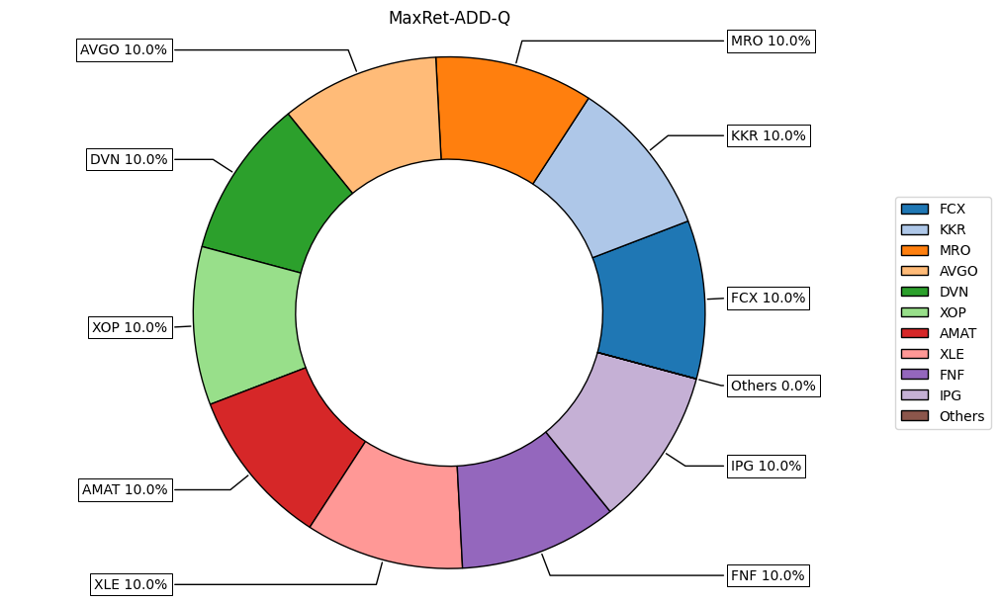

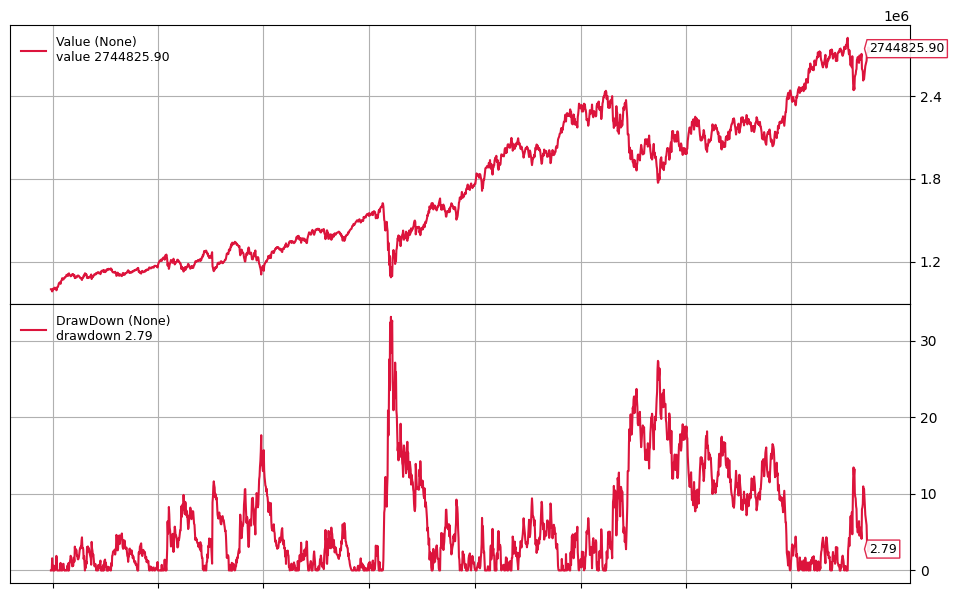

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.1558%
2951 2024-09-24  1.2380%
2952 2024-09-25 -1.1966%
2953 2024-09-26  0.8882%
2954 2024-09-27 -0.4464%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,10.0000%
Consumer Cyclical,0.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,20.0000%
Healthcare,0.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


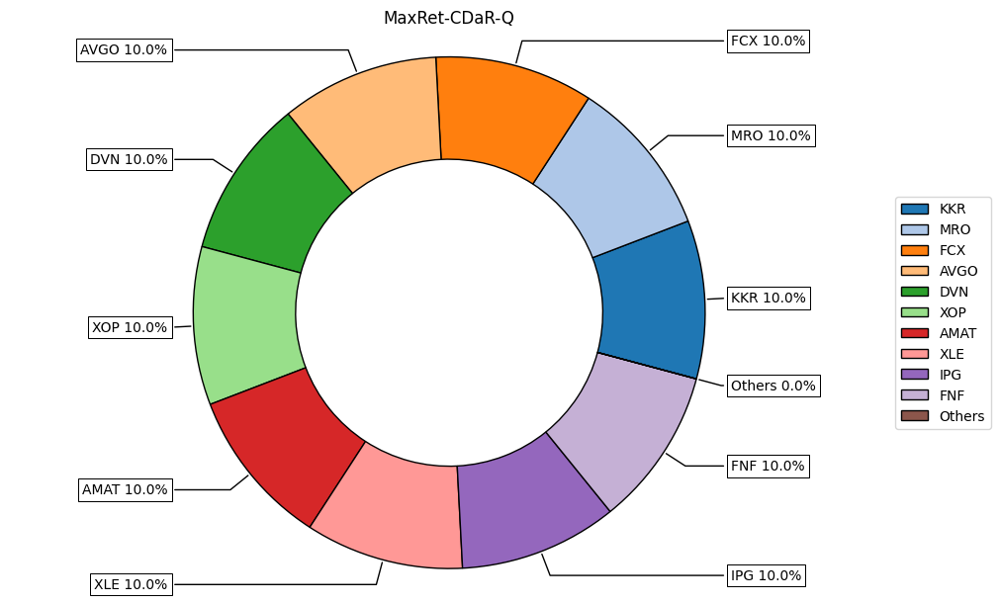

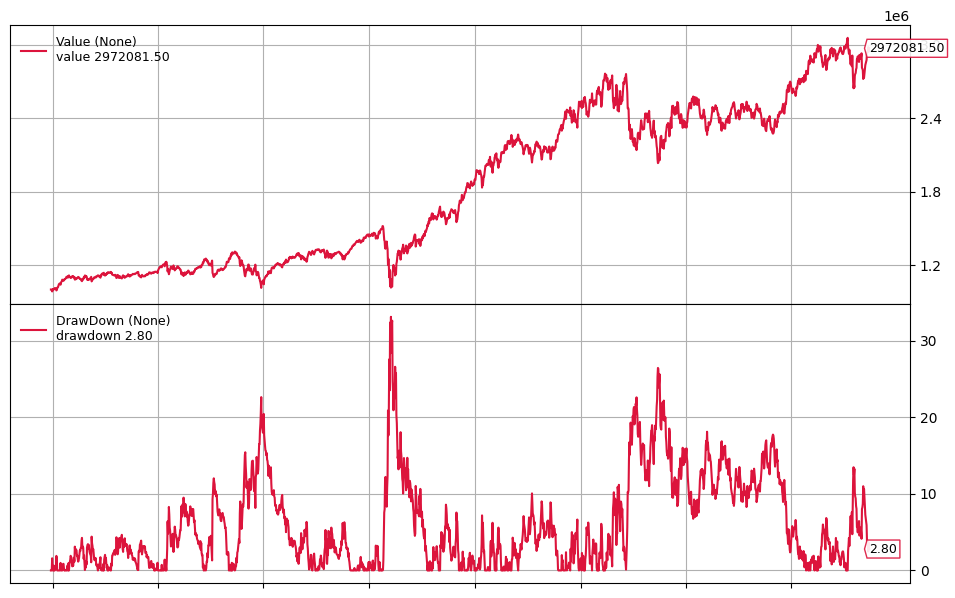

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.1563%
2951 2024-09-24  1.2419%
2952 2024-09-25 -1.2003%
2953 2024-09-26  0.8909%
2954 2024-09-27  0.0317%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,10.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,10.0000%
Healthcare,10.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


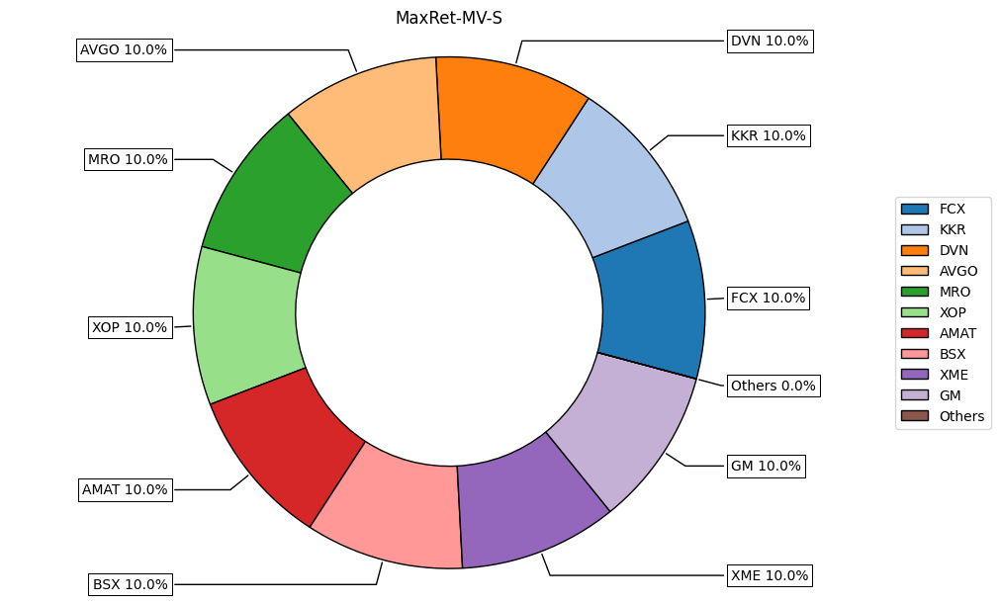

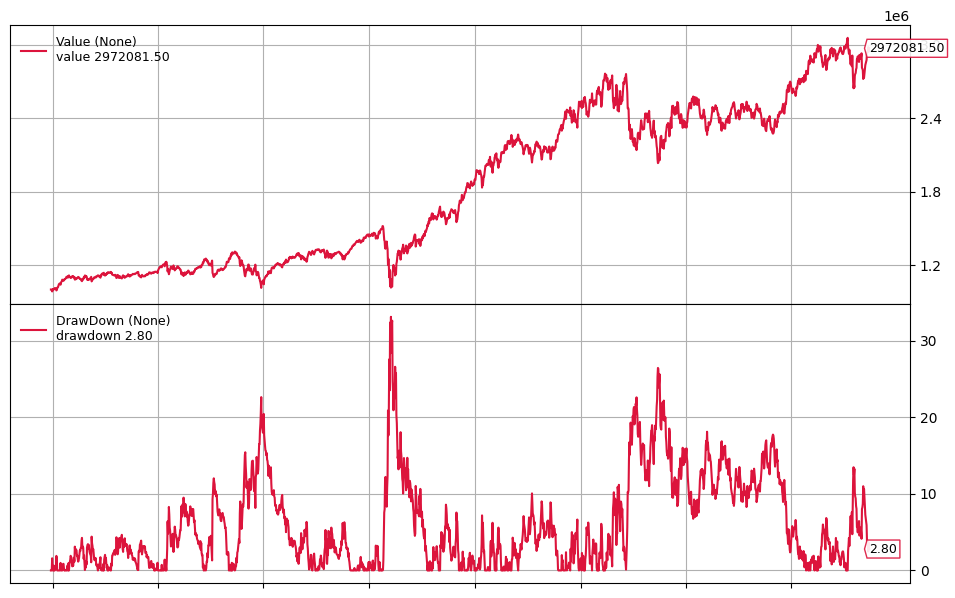

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.1563%
2951 2024-09-24  1.2419%
2952 2024-09-25 -1.2003%
2953 2024-09-26  0.8909%
2954 2024-09-27  0.0317%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,10.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,10.0000%
Healthcare,10.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


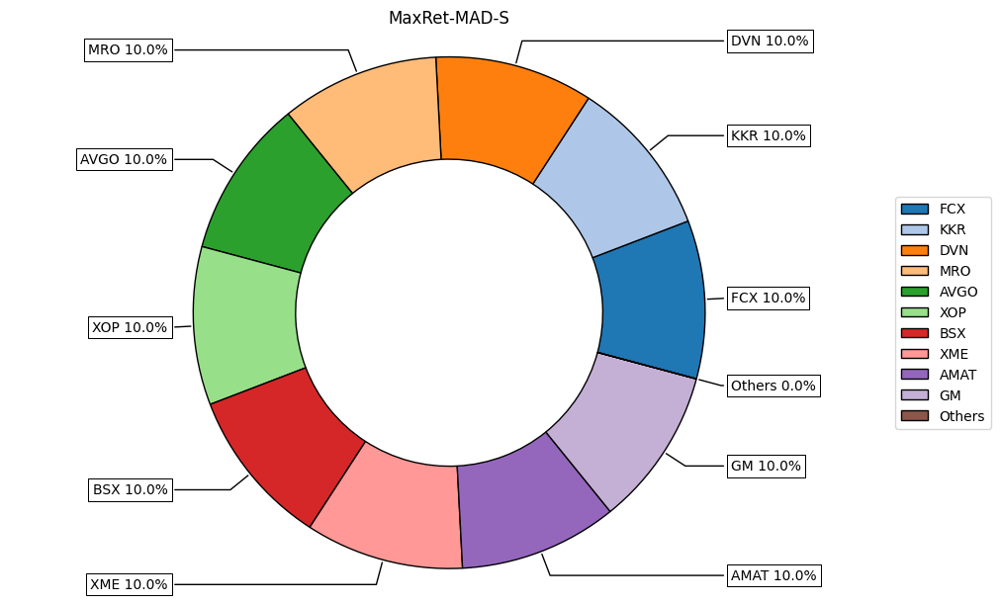

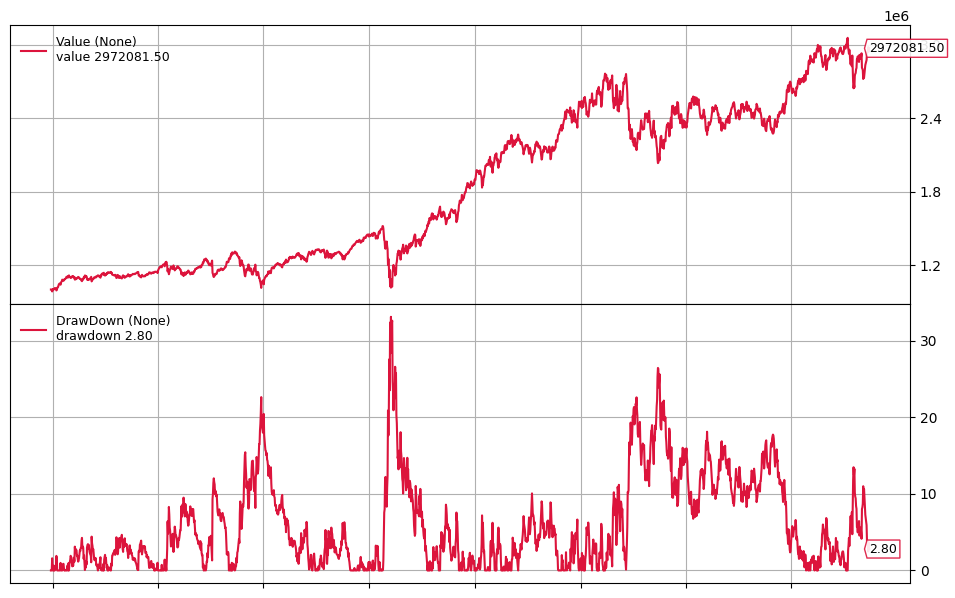

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.1563%
2951 2024-09-24  1.2419%
2952 2024-09-25 -1.2003%
2953 2024-09-26  0.8909%
2954 2024-09-27  0.0317%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,10.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,10.0000%
Healthcare,10.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


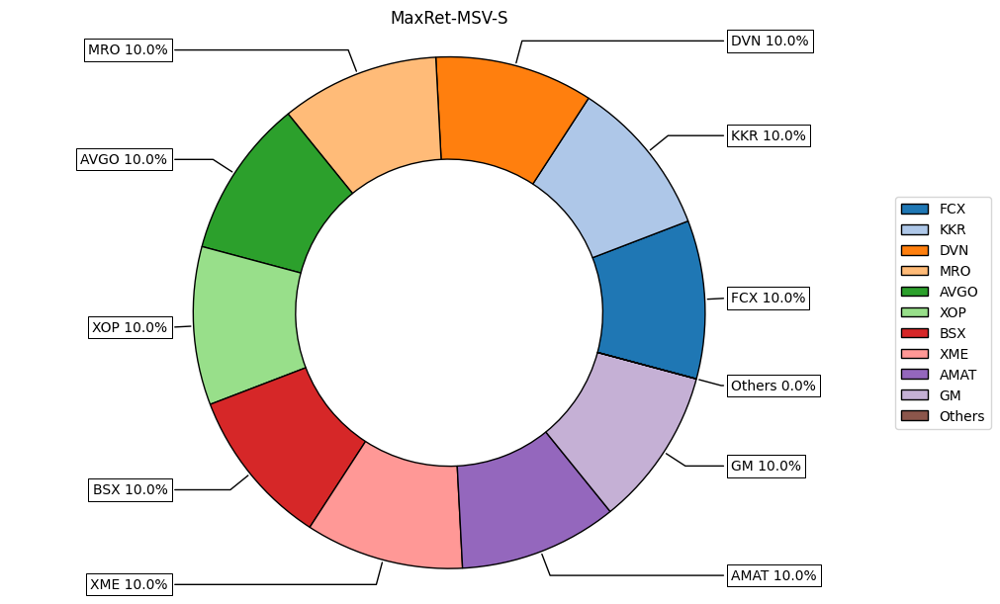

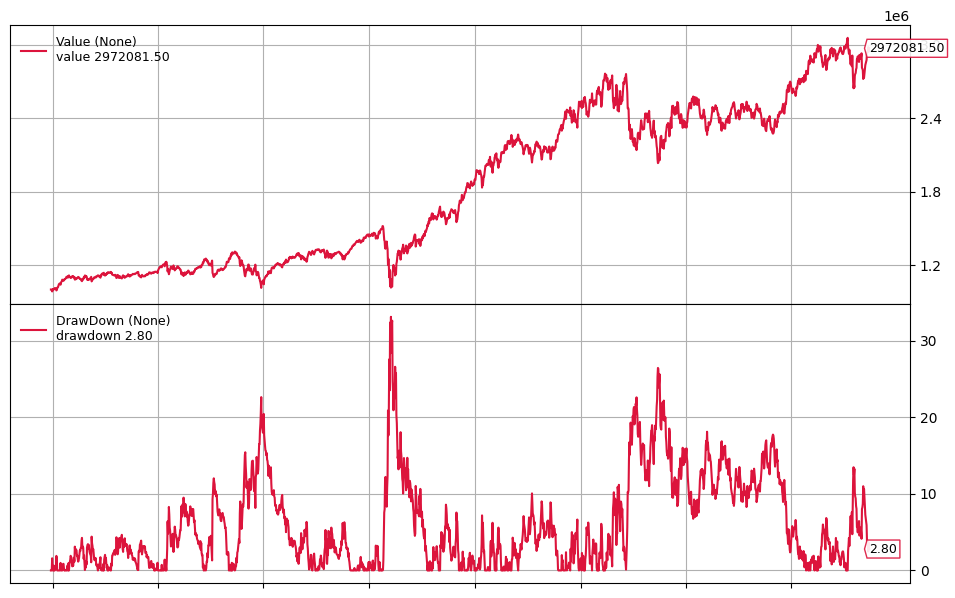

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.1563%
2951 2024-09-24  1.2419%
2952 2024-09-25 -1.2003%
2953 2024-09-26  0.8909%
2954 2024-09-27  0.0317%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,10.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,10.0000%
Healthcare,10.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


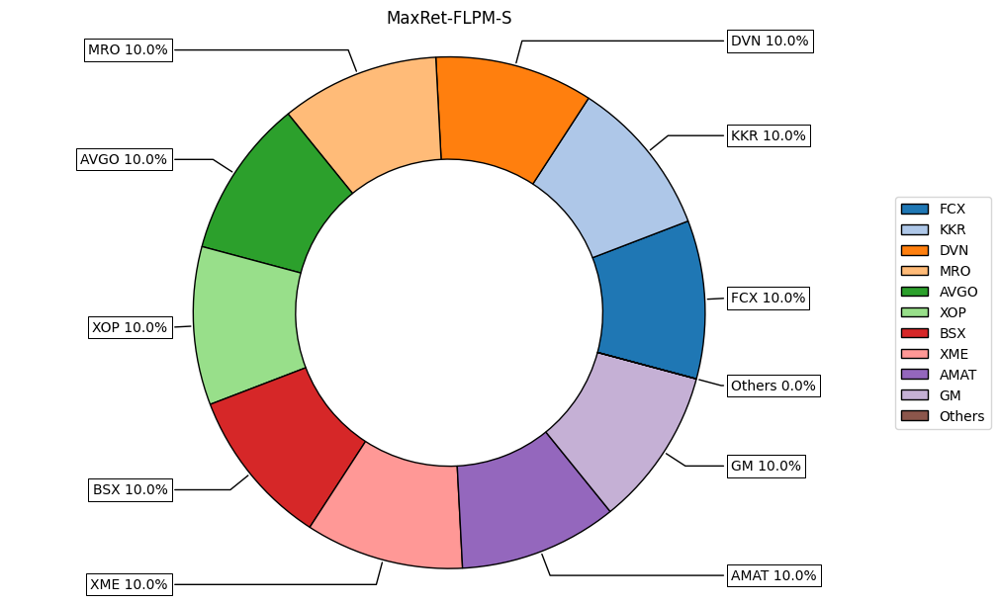

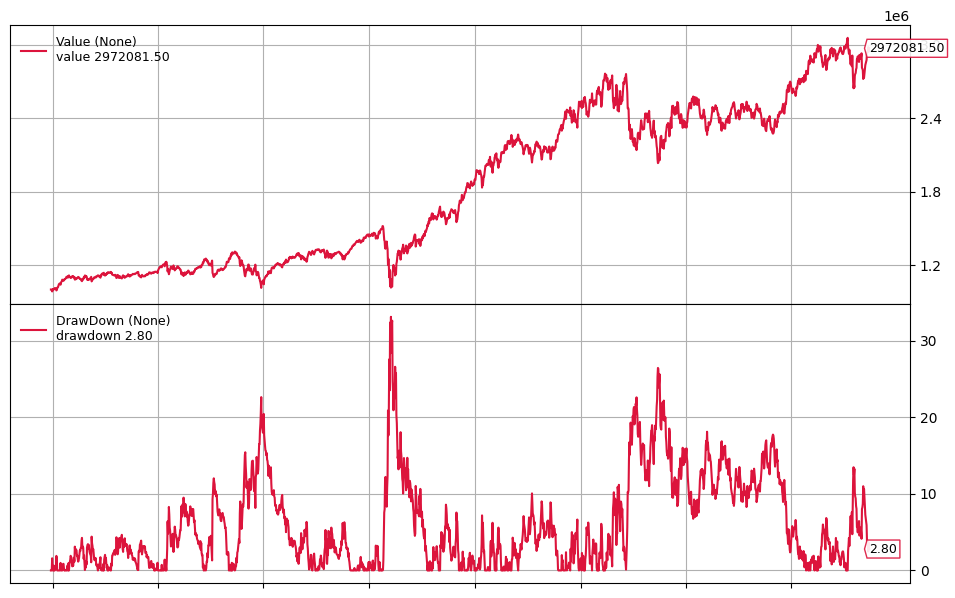

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.1563%
2951 2024-09-24  1.2419%
2952 2024-09-25 -1.2003%
2953 2024-09-26  0.8909%
2954 2024-09-27  0.0317%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,10.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,10.0000%
Healthcare,10.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


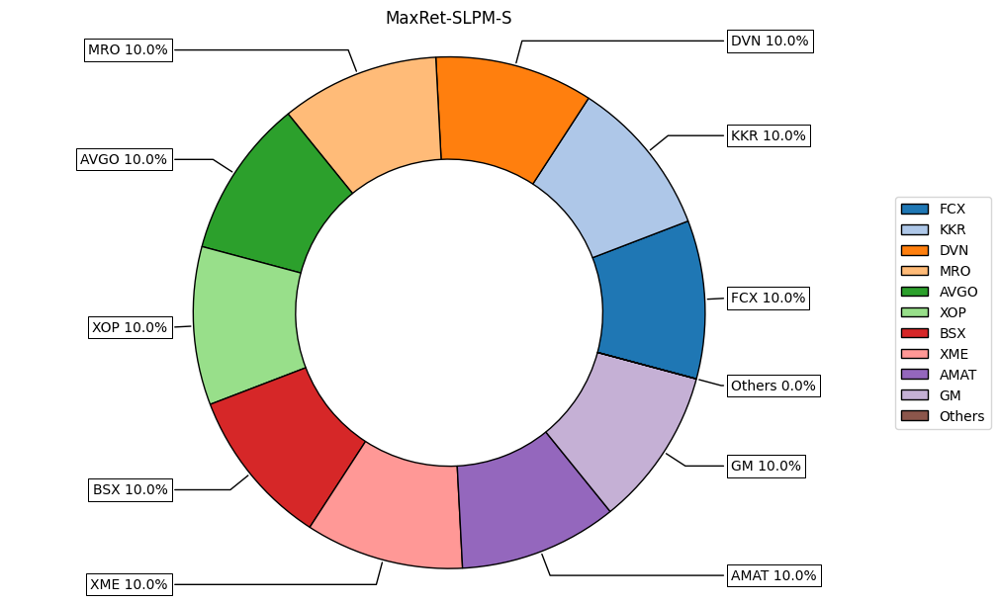

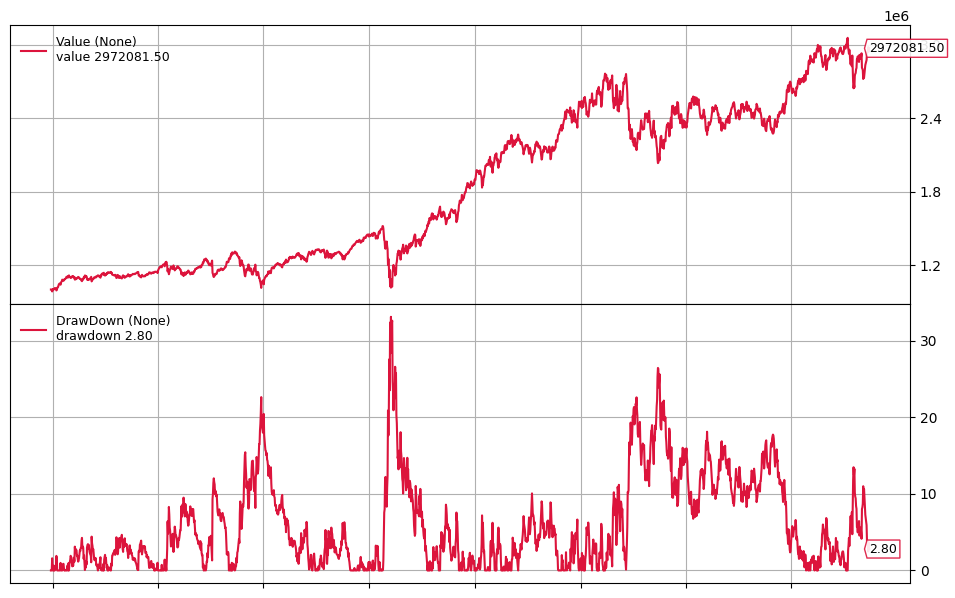

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.1563%
2951 2024-09-24  1.2419%
2952 2024-09-25 -1.2003%
2953 2024-09-26  0.8909%
2954 2024-09-27  0.0317%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,10.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,10.0000%
Healthcare,10.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


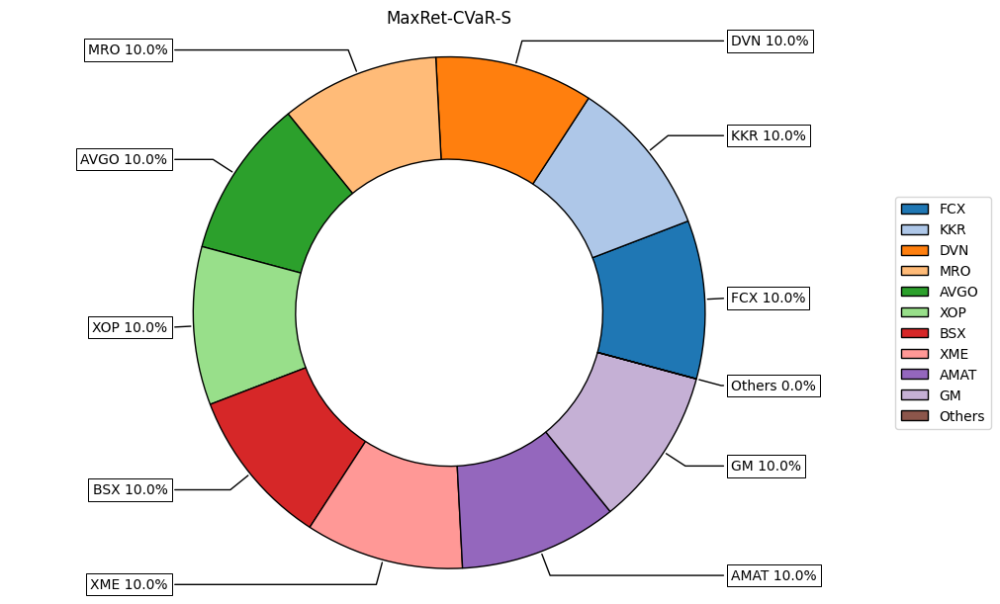

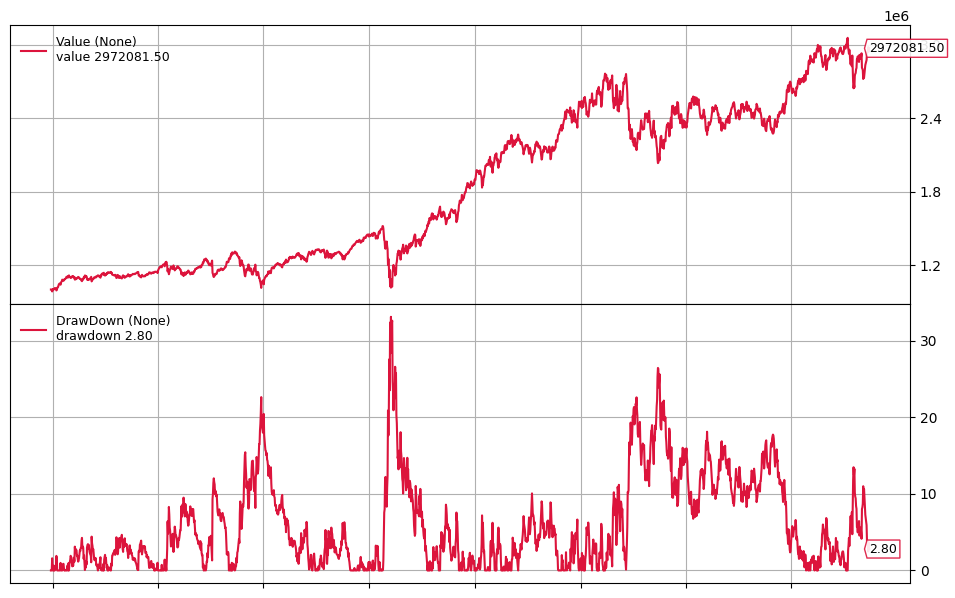

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.1563%
2951 2024-09-24  1.2419%
2952 2024-09-25 -1.2003%
2953 2024-09-26  0.8909%
2954 2024-09-27  0.0317%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,10.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,10.0000%
Healthcare,10.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


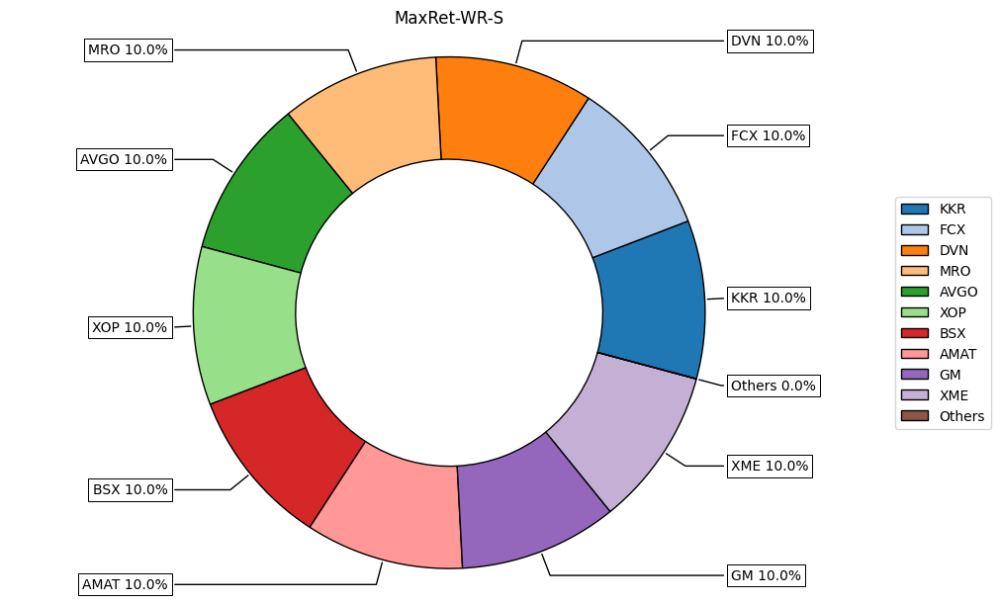

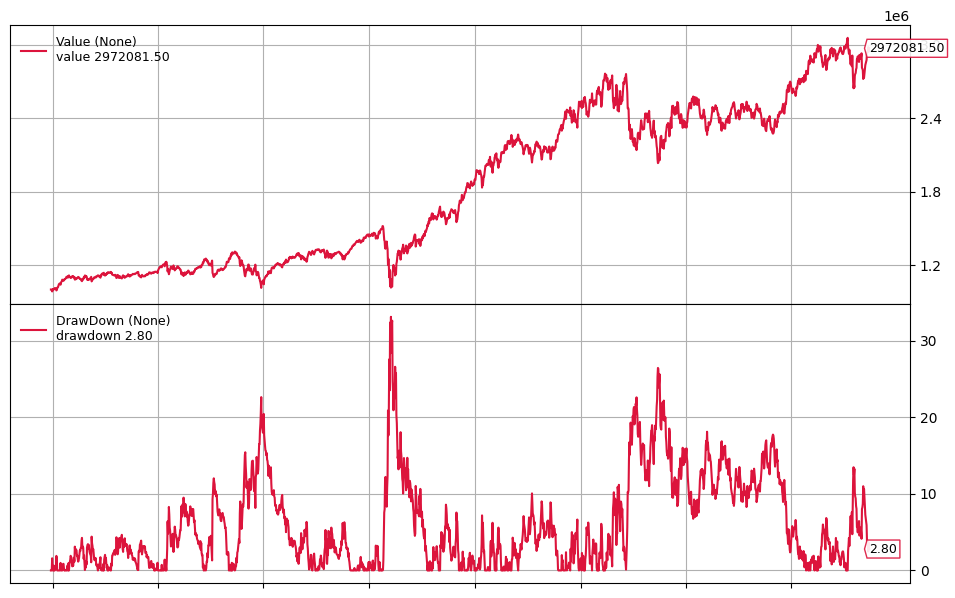

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.1563%
2951 2024-09-24  1.2419%
2952 2024-09-25 -1.2003%
2953 2024-09-26  0.8909%
2954 2024-09-27  0.0317%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,10.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,10.0000%
Healthcare,10.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


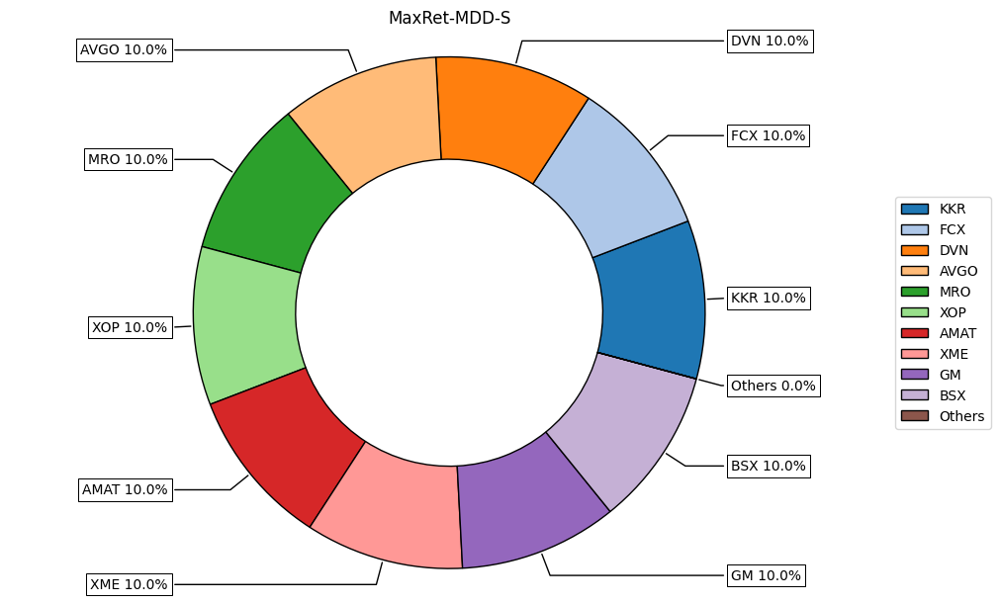

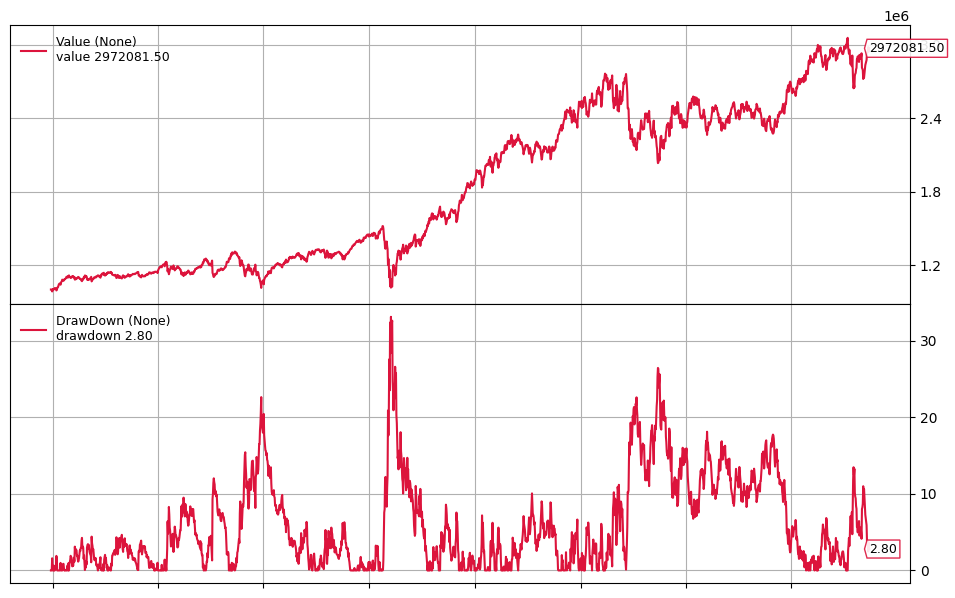

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.1563%
2951 2024-09-24  1.2419%
2952 2024-09-25 -1.2003%
2953 2024-09-26  0.8909%
2954 2024-09-27  0.0317%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,10.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,10.0000%
Healthcare,10.0000%


start=1004 - end=2954
AssetAllocation:  ['AMAT', 'AMD', 'AVGO', 'BAC', 'BKR', 'BMY', 'BSX', 'C', 'CMCSA', 'CSCO', 'CSX', 'CVS', 'CVX', 'DBA', 'DIS', 'DVN', 'FCX', 'FNF', 'GEN', 'GILD', 'GLD', 'GM', 'HAL', 'HPQ', 'HYG', 'INTC', 'IPG', 'JNJ', 'KDP', 'KKR', 'KMI', 'KO', 'LQD', 'MDLZ', 'MO', 'MRK', 'MRO', 'MRVL', 'MSFT', 'MU', 'NEM', 'SLV', 'TLT', 'XLE', 'XME', 'XOP']
backtest.plot: 1004-2954


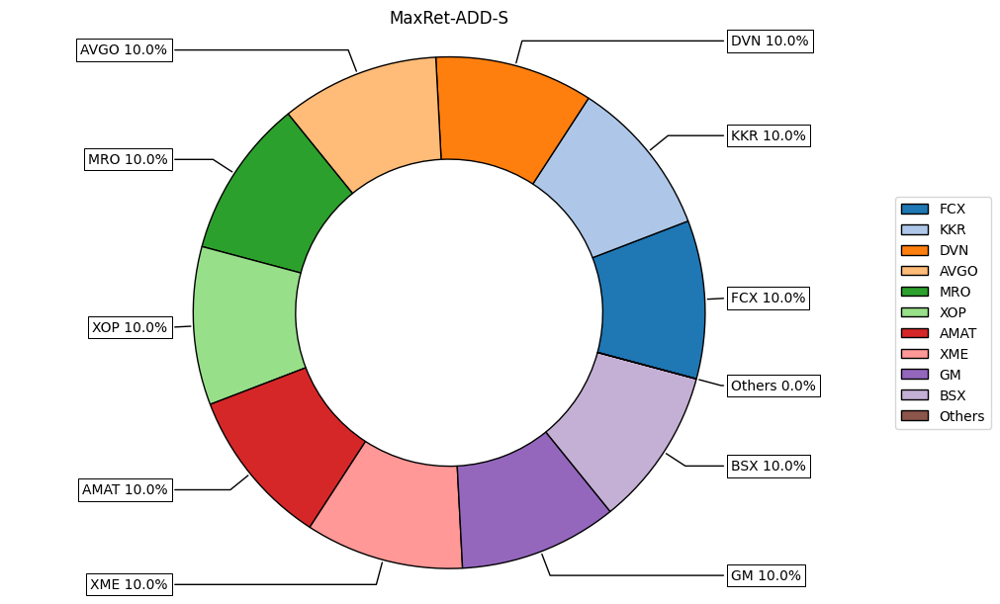

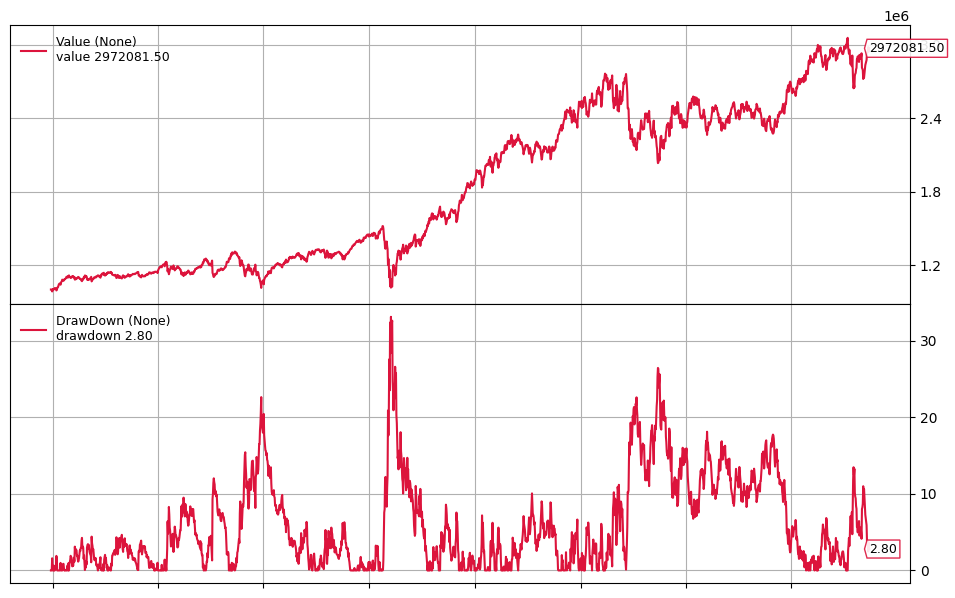

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.340194336403793,
  'CAGR': 0.08141809500835094,
  'Sharpe Ratio': 0.6074804940476343},
 {'Risk_measure': 'MV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24880277521323882,
  'CAGR': 0.042584052254120784,
  'Sharpe Ratio': 0.4207088295640139},
 {'Risk_measure': 'MAD',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24822736300683032,
  'CAGR': 0.03827900274037725,
  'Sharpe Ratio': 0.38948007274232943},
 {'Risk_measure': 'MSV',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.24831553607454016,
  'CAGR': 0.045693661014720624,
  'Sharpe Ratio': 0.437971335133401},
 {'Risk_measure': 'FLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.25254389298110347,
  'CAGR': 0.03983002997699104,
  'Sharpe Ratio': 0.3970750416314412},
 {'Risk_measure': 'SLPM',
  'Objective': 'Sharpe',
  'R_Interval': 'M',
  'Max DrawDown': 0.247464098

           Date   Return
0    2013-01-02  0.0000%
1    2013-01-03  0.0000%
2    2013-01-04  0.0000%
3    2013-01-07  0.0000%
4    2013-01-08  0.0000%
...         ...      ...
2950 2024-09-23  0.1563%
2951 2024-09-24  1.2419%
2952 2024-09-25 -1.2003%
2953 2024-09-26  0.8909%
2954 2024-09-27  0.0317%

[2955 rows x 2 columns]


,weights
Industry,
Basic Materials,10.0000%
Bond,0.0000%
Commodity,20.0000%
Communication Services,0.0000%
Consumer Cyclical,10.0000%
Consumer Defensive,0.0000%
Energy,20.0000%
Financial Services,10.0000%
Healthcare,10.0000%


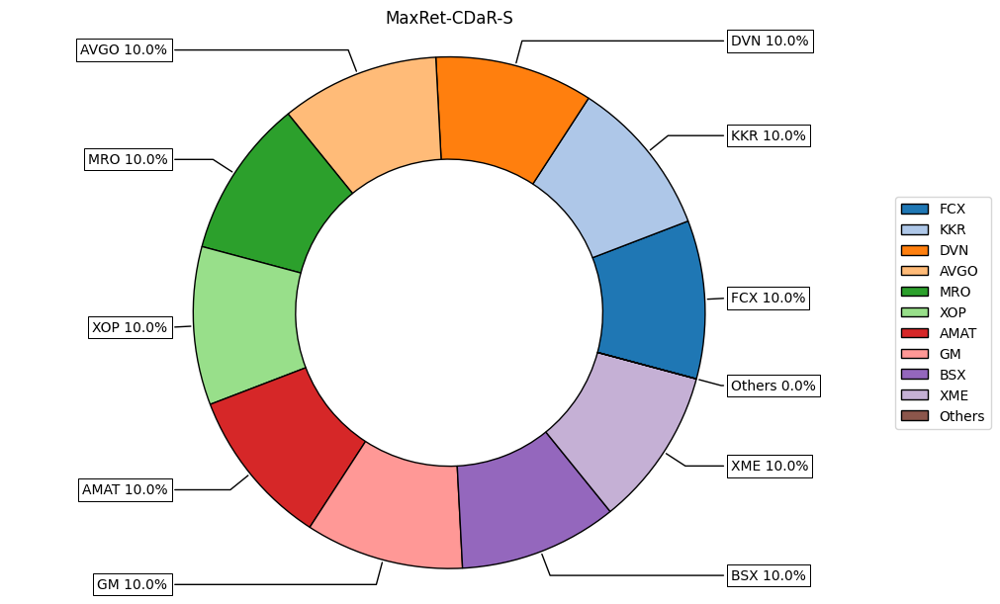

In [31]:
############################################################
# Backtesting All Strategy
############################################################
for obj in objectivves:
    for r in reb_interval:
        for rm in rms:
            
            assets = returns.columns.tolist()
            weights = models[obj][r][rm]
        
            result0 = backtest(assets_prices,
                            AssetAllocation,
                            start=start_test,
                            end=end_test,
                            plot=plotFlag)
           
            metric_list.append(RetreiveStats(result0, rm, obj, r))
            display(metric_list)
        
            Dret = RetreiveDailyReturn(result0, 'Return')
            print(Dret)
            Dret.to_csv(f"{obj}_{r}_{rm}_ret.csv", index=False)
            
            ############################################################
            # Plotting the composition of the last MV portfolio
            ############################################################
        
            w = pd.DataFrame(models[obj][r][rm].iloc[-1,:])

            if plotFlag:
                # We need matplotlib >= 3.3.0 to use this function
                ax = rp.plot_pie(w=w, title=f'{obj}-{rm}-{r}', others=0.05, nrow=25, cmap = "tab20",
                                height=6, width=10, ax=None)
        
                # w.plot.pie(subplots=True, figsize=(8, 8))
            
            ############################################################
            # Composition per Industry
            ############################################################
        
            w_classes = pd.concat([asset_classes.set_index('Assets'), w], axis=1)
            w_classes = w_classes.groupby(['Industry']).sum()
            w_classes.columns = ['weights']
            display(w_classes)

In [32]:
metric_df = pd.DataFrame(metric_list)
display(metric_df)

,Risk_measure,Objective,R_Interval,Max DrawDown,CAGR,Sharpe Ratio
0,SPY,N/A,N/A,34.0194%,8.1418%,60.7480%
1,MV,Sharpe,M,24.8803%,4.2584%,42.0709%
2,MAD,Sharpe,M,24.8227%,3.8279%,38.9480%
3,MSV,Sharpe,M,24.8316%,4.5694%,43.7971%
4,FLPM,Sharpe,M,25.2544%,3.9830%,39.7075%
...,...,...,...,...,...,...
86,CVaR,MaxRet,S,33.1298%,9.7372%,72.3841%
87,WR,MaxRet,S,33.1298%,9.7372%,72.3841%
88,MDD,MaxRet,S,33.1298%,9.7372%,72.3841%
89,ADD,MaxRet,S,33.1298%,9.7372%,72.3841%


In [38]:
display(metric_df[metric_df['R_Interval']=='Q'].sort_values(by=['Sharpe Ratio','CAGR'], ascending=False))

,Risk_measure,Objective,R_Interval,Max DrawDown,CAGR,Sharpe Ratio
71,MV,MaxRet,Q,33.0906%,8.9508%,71.3332%
72,MAD,MaxRet,Q,33.0906%,8.9508%,71.3332%
73,MSV,MaxRet,Q,33.0906%,8.9508%,71.3332%
74,FLPM,MaxRet,Q,33.0906%,8.9508%,71.3332%
75,SLPM,MaxRet,Q,33.0906%,8.9508%,71.3332%
76,CVaR,MaxRet,Q,33.0906%,8.9508%,71.3332%
77,WR,MaxRet,Q,33.0906%,8.9508%,71.3332%
78,MDD,MaxRet,Q,33.0906%,8.9508%,71.3332%
79,ADD,MaxRet,Q,33.0906%,8.9508%,71.3332%
80,CDaR,MaxRet,Q,33.0906%,8.9508%,71.3332%


In [39]:
display(metric_df[metric_df['R_Interval']=='S'].sort_values(by=['Sharpe Ratio','CAGR'], ascending=False))

,Risk_measure,Objective,R_Interval,Max DrawDown,CAGR,Sharpe Ratio
81,MV,MaxRet,S,33.1298%,9.7372%,72.3841%
82,MAD,MaxRet,S,33.1298%,9.7372%,72.3841%
83,MSV,MaxRet,S,33.1298%,9.7372%,72.3841%
84,FLPM,MaxRet,S,33.1298%,9.7372%,72.3841%
85,SLPM,MaxRet,S,33.1298%,9.7372%,72.3841%
86,CVaR,MaxRet,S,33.1298%,9.7372%,72.3841%
87,WR,MaxRet,S,33.1298%,9.7372%,72.3841%
88,MDD,MaxRet,S,33.1298%,9.7372%,72.3841%
89,ADD,MaxRet,S,33.1298%,9.7372%,72.3841%
90,CDaR,MaxRet,S,33.1298%,9.7372%,72.3841%


In [33]:
metric_df.to_csv("Port_Metric.csv", index=False)

In [34]:
for obj in objectivves:
    for r in reb_interval:
        for rm in rms:
            models[obj][r][rm].to_csv(f"weights_{obj}_{r}_{rm}.csv")